In [1]:
# Import all necessary library
import pandas as pd 
import numpy as np

# visualization library
import matplotlib.pyplot as plt

In [2]:
# Loading the dataset

df = pd.read_csv(r'E:\Hochschule Ansbach\Thesis\DATA\SCM_data.csv',date_parser=True)

In [3]:
# droping unwanted columns
df=df.drop(columns='Unnamed: 0')

In [4]:
# printing 1st 5 rows
df.head()

,Actual shipping days,Estimated shipping days,Delivery Status,Late_risk,Category,Customer City,Customer Segment,Department,Orders Date,Order Item Product Price,Quantity,Sales,Order Item Total,Order Status,Product Name,Product Price,Shipping date,Shipping Mode
0,3,4,Advance shipping,0,Sporting Goods,Caguas,Consumer,Fitness,1/31/2018 22:56,327.75,1,327.75,314.640015,COMPLETE,Smart watch,327.75,02-03-18 22:56,Standard Class
1,5,4,Late delivery,1,Sporting Goods,Caguas,Consumer,Fitness,1/13/2018 12:27,327.75,1,327.75,311.359985,PENDING,Smart watch,327.75,1/18/2018 12:27,Standard Class
2,4,4,Shipping on time,0,Sporting Goods,San Jose,Consumer,Fitness,1/13/2018 12:06,327.75,1,327.75,309.720001,CLOSED,Smart watch,327.75,1/17/2018 12:06,Standard Class
3,3,4,Advance shipping,0,Sporting Goods,Los Angeles,Home Office,Fitness,1/13/2018 11:45,327.75,1,327.75,304.809998,COMPLETE,Smart watch,327.75,1/16/2018 11:45,Standard Class
4,2,4,Advance shipping,0,Sporting Goods,Caguas,Corporate,Fitness,1/13/2018 11:24,327.75,1,327.75,298.250000,PENDING_PAYMENT,Smart watch,327.75,1/15/2018 11:24,Standard Class


# EDA

In [5]:
# describe method for numeric columns
df.describe()

,Actual shipping days,Estimated shipping days,Late_risk,Order Item Product Price,Quantity,Sales,Order Item Total,Product Price
count,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000
mean,3.497654,2.931847,0.548291,141.232550,2.127638,203.772096,183.107609,141.232550
std,1.623722,1.374449,0.497664,139.732492,1.453451,132.273077,120.043670,139.732492
min,0.000000,0.000000,0.000000,9.990000,1.000000,9.990000,7.490000,9.990000
25%,2.000000,2.000000,0.000000,50.000000,1.000000,119.980003,104.379997,50.000000
50%,3.000000,4.000000,1.000000,59.990002,1.000000,199.919998,163.990005,59.990002
75%,5.000000,4.000000,1.000000,199.990005,3.000000,299.950012,247.399994,199.990005
max,6.000000,4.000000,1.000000,1999.989990,5.000000,1999.989990,1939.989990,1999.989990


In [6]:
# describe for non numeric columns 
df.describe(exclude='number')

,Delivery Status,Category,Customer City,Customer Segment,Department,Orders Date,Order Status,Product Name,Shipping date,Shipping Mode
count,180519,180519,180519,180519,180519,180519,180519,180519,180519,180519
unique,4,50,563,3,11,65752,9,118,63701,4
top,Late delivery,Cleats,Caguas,Consumer,Fan Shop,3/20/2016 23:33,COMPLETE,Perfect Fitness Perfect Rip Deck,02-11-17 3:28,Standard Class
freq,98977,24551,66770,93504,66861,5,59491,24515,10,107752


In [7]:
# info method 
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 180519 entries, 0 to 180518
Data columns (total 18 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   Actual shipping days      180519 non-null  int64  
 1   Estimated shipping days   180519 non-null  int64  
 2   Delivery Status           180519 non-null  object 
 3   Late_risk                 180519 non-null  int64  
 4   Category                  180519 non-null  object 
 5   Customer City             180519 non-null  object 
 6   Customer Segment          180519 non-null  object 
 7   Department                180519 non-null  object 
 8   Orders Date               180519 non-null  object 
 9   Order Item Product Price  180519 non-null  float64
 10  Quantity                  180519 non-null  int64  
 11  Sales                     180519 non-null  float64
 12  Order Item Total          180519 non-null  float64
 13  Order Status              180519 non-null  o

# Preprocessing 

In [8]:
# Drop non relevant columns 

df.drop(columns=['Actual shipping days','Estimated shipping days','Product Name','Delivery Status','Shipping date', 'Order Status', 'Order Item Product Price', 'Product Price'] ,inplace=True)

In [9]:
df.head()

,Late_risk,Category,Customer City,Customer Segment,Department,Orders Date,Quantity,Sales,Order Item Total,Shipping Mode
0,0,Sporting Goods,Caguas,Consumer,Fitness,1/31/2018 22:56,1,327.75,314.640015,Standard Class
1,1,Sporting Goods,Caguas,Consumer,Fitness,1/13/2018 12:27,1,327.75,311.359985,Standard Class
2,0,Sporting Goods,San Jose,Consumer,Fitness,1/13/2018 12:06,1,327.75,309.720001,Standard Class
3,0,Sporting Goods,Los Angeles,Home Office,Fitness,1/13/2018 11:45,1,327.75,304.809998,Standard Class
4,0,Sporting Goods,Caguas,Corporate,Fitness,1/13/2018 11:24,1,327.75,298.250000,Standard Class


In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 180519 entries, 0 to 180518
Data columns (total 10 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Late_risk         180519 non-null  int64  
 1   Category          180519 non-null  object 
 2   Customer City     180519 non-null  object 
 3   Customer Segment  180519 non-null  object 
 4   Department        180519 non-null  object 
 5   Orders Date       180519 non-null  object 
 6   Quantity          180519 non-null  int64  
 7   Sales             180519 non-null  float64
 8   Order Item Total  180519 non-null  float64
 9   Shipping Mode     180519 non-null  object 
dtypes: float64(2), int64(2), object(6)
memory usage: 13.8+ MB


# Limiting columns Values

In [11]:
# how many times each Category occure 
counts = df['Category'].value_counts()
print(counts)

Cleats                  24551
Men's Footwear          22246
Women's Apparel         21035
Indoor/Outdoor Games    19298
Fishing                 17325
Water Sports            15540
Camping & Hiking        13729
Cardio Equipment        12487
Shop By Sport           10984
Electronics              3156
Accessories              1780
Golf Balls               1475
Girls' Apparel           1201
Golf Gloves              1070
Trade-In                  974
Video Games               838
Children's Clothing       652
Women's Clothing          650
Baseball & Softball       632
Hockey                    614
Cameras                   592
Toys                      529
Golf Shoes                524
Pet Supplies              492
Garden                    484
Crafts                    484
DVDs                      483
Computers                 442
Golf Apparel              441
Hunting & Shooting        440
Music                     434
Consumer Electronics      431
Boxing & MMA              423
Books     

In [12]:
# filtering and restricting the Category
mask = df['Category'].isin(counts[counts >= 1070].index)
df= df[mask]


In [13]:
#  how many times each Category occure  after masking
print(df['Category'].value_counts())

Cleats                  24551
Men's Footwear          22246
Women's Apparel         21035
Indoor/Outdoor Games    19298
Fishing                 17325
Water Sports            15540
Camping & Hiking        13729
Cardio Equipment        12487
Shop By Sport           10984
Electronics              3156
Accessories              1780
Golf Balls               1475
Girls' Apparel           1201
Golf Gloves              1070
Name: Category, dtype: int64


# Approach - Label Encoding on "Customer Segment column"

In [14]:
# Get value counts on DataFrame
df.groupby('Customer Segment').count()

,Late_risk,Category,Customer City,Department,Orders Date,Quantity,Sales,Order Item Total,Shipping Mode
Customer Segment,,,,,,,,,
Consumer,85968,85968,85968,85968,85968,85968,85968,85968,85968
Corporate,50341,50341,50341,50341,50341,50341,50341,50341,50341
Home Office,29568,29568,29568,29568,29568,29568,29568,29568,29568


In [15]:
# see the data type
df['Customer Segment'].dtype

dtype('O')

In [16]:
#Approach  - Label Encoding
# One trick you can use in pandas is to convert a column to a category, then use those category values for your label encoding:
# Then you can assign the encoded variable to a new column using the cat.codes accessor:
# here categorized each of the variables into numbers by using
#  casting to category data.

df["Customer Segment"] = df["Customer Segment"].astype('category')


# assign the encoded variable to a new column using the cat.codes accessor:
# to access ".cat" we have to convert the column intio 'categorical' datatype
df['Customer Segment cat']=df['Customer Segment'].cat.codes

print(df.head())

print('\n','Unique values' ,df['Customer Segment cat'].unique())

    Late_risk         Category Customer City Customer Segment Department  \
48          1           Cleats       Bayamon      Home Office    Apparel   
49          0    Shop By Sport        Caguas      Home Office       Golf   
50          1  Women's Apparel        Caguas      Home Office       Golf   
51          0    Shop By Sport        Caguas      Home Office       Golf   
52          1  Women's Apparel        Caguas      Home Office       Golf   

         Orders Date  Quantity       Sales  Order Item Total Shipping Mode  \
48   2/24/2016 13:57         2  119.980003        115.180000  Second Class   
49  10/25/2016 14:39         2   79.980003         79.180000  Second Class   
50    3/30/2016 4:37         2  100.000000         96.000000  Second Class   
51   10/30/2016 1:31         2   79.980003         75.980003  Second Class   
52   11/28/2016 1:18         2  100.000000         91.000000  Second Class   

    Customer Segment cat  
48                     2  
49                  

In [17]:
# After label encoding , what is the  cat code now.
df['Customer Segment cat'].unique()

array([2, 0, 1], dtype=int8)

In [18]:
#to know the labels assigned by astype('category').cat.codes?


print(df['Customer Segment'].cat.categories[0])
print(df['Customer Segment'].cat.categories[1])
print(df['Customer Segment'].cat.categories[2])

Consumer
Corporate
Home Office


In [19]:
# droping  'Customer Segment' column

df.drop(columns='Customer Segment', inplace=True)

In [20]:
# first 5 rows
df.head()

,Late_risk,Category,Customer City,Department,Orders Date,Quantity,Sales,Order Item Total,Shipping Mode,Customer Segment cat
48,1,Cleats,Bayamon,Apparel,2/24/2016 13:57,2,119.980003,115.180000,Second Class,2
49,0,Shop By Sport,Caguas,Golf,10/25/2016 14:39,2,79.980003,79.180000,Second Class,2
50,1,Women's Apparel,Caguas,Golf,3/30/2016 4:37,2,100.000000,96.000000,Second Class,2
51,0,Shop By Sport,Caguas,Golf,10/30/2016 1:31,2,79.980003,75.980003,Second Class,2
52,1,Women's Apparel,Caguas,Golf,11/28/2016 1:18,2,100.000000,91.000000,Second Class,2


In [21]:
# Randomly any 1o rows
df.sample(10)

,Late_risk,Category,Customer City,Department,Orders Date,Quantity,Sales,Order Item Total,Shipping Mode,Customer Segment cat
64630,1,Women's Apparel,Ontario,Golf,04-02-17 17:04,1,50.000000,42.000000,Second Class,0
126727,0,Camping & Hiking,Caguas,Fan Shop,6/22/2017 20:16,1,299.980011,293.980011,Standard Class,0
139075,1,Fishing,New Orleans,Fan Shop,2/19/2017 17:28,1,399.980011,319.980011,Standard Class,0
158644,1,Women's Apparel,Caguas,Golf,05-01-16 2:49,4,200.000000,164.000000,Second Class,0
64002,1,Cardio Equipment,Tallahassee,Footwear,07-12-17 23:24,1,99.989998,79.989998,Second Class,0
118012,1,Men's Footwear,Augusta,Apparel,09-09-16 5:37,1,129.990005,127.389999,Second Class,0
47617,0,Women's Apparel,Bakersfield,Golf,7/30/2015 18:58,4,200.000000,164.000000,Standard Class,1
20349,0,Men's Footwear,Caguas,Apparel,1/25/2017 20:50,1,129.990005,103.989998,Standard Class,0
150458,0,Cleats,Caguas,Apparel,05-07-16 9:28,5,299.950012,278.950012,Standard Class,2
8199,0,Camping & Hiking,Caguas,Fan Shop,3/20/2017 14:06,1,299.980011,296.980011,Standard Class,1


# Feature Engineering

In [22]:
# Converting the 'Orders Date'  column to date time
df["date_time"]=  pd.to_datetime(df['Orders Date'])

In [23]:
# drop  'Orders Date' columns 
df.drop(columns='Orders Date', inplace=True)

In [24]:
# extracting month
df['Month'] = df["date_time"].dt.month

In [25]:
# drop  'date_time' columns as we extracted month from it.now it is not needed 
df.drop(columns='date_time', inplace=True)

# knowing the Month names

In [26]:
# sanity check
uniq_month=np.sort(df.Month.unique())



print(uniq_month)

[ 1  2  3  4  5  6  7  8  9 10 11 12]


In [27]:
# which integer means which month name 
import calendar
for var in uniq_month :
    print(str(var) + " = " + str(calendar.month_name[var]))

1 = January
2 = February
3 = March
4 = April
5 = May
6 = June
7 = July
8 = August
9 = September
10 = October
11 = November
12 = December


In [28]:
# print 1st 5 rows
df.head()

,Late_risk,Category,Customer City,Department,Quantity,Sales,Order Item Total,Shipping Mode,Customer Segment cat,Month
48,1,Cleats,Bayamon,Apparel,2,119.980003,115.180000,Second Class,2,2
49,0,Shop By Sport,Caguas,Golf,2,79.980003,79.180000,Second Class,2,10
50,1,Women's Apparel,Caguas,Golf,2,100.000000,96.000000,Second Class,2,3
51,0,Shop By Sport,Caguas,Golf,2,79.980003,75.980003,Second Class,2,10
52,1,Women's Apparel,Caguas,Golf,2,100.000000,91.000000,Second Class,2,11


# Approach - Count/Frequency Encoding on "Customer City " Column

In [29]:
# value counts  on column
df['Customer City'].value_counts()

Caguas           61337
Chicago           3570
Brooklyn          3139
Los Angeles       3137
New York          1687
                 ...  
Bartlett            25
National City       24
Ponce               20
Malden              18
Freehold            13
Name: Customer City, Length: 562, dtype: int64

In [30]:
# look for unique values in columns
df['Customer City'].unique()

array(['Bayamon', 'Caguas', 'Guayama', 'Juana Diaz', 'Freeport',
       'Fort Washington', 'Bakersfield', 'Corona', 'Cincinnati',
       'Germantown', 'Carrollton', 'Houston', 'Carlisle', 'Los Angeles',
       'Ewa Beach', 'Rome', 'Vista', 'Fort Worth', 'Fond Du Lac',
       'Philadelphia', 'Ontario', 'Oviedo', 'Buffalo', 'Honolulu',
       'Oceanside', 'North Tonawanda', 'Clovis', 'Jamaica',
       'Granite City', 'Medford', 'Pomona', 'Tempe', 'Santa Ana', 'York',
       'Aurora', 'Simi Valley', 'Silver Spring', 'Saint Paul',
       'San Antonio', 'Bronx', 'Greenville', 'Morristown', 'San Diego',
       'Oxnard', 'Miami', 'Albuquerque', 'Lutz', 'Bend', 'East Brunswick',
       'Lancaster', 'Hampton', 'Porterville', 'Portland', 'Strongsville',
       'El Paso', 'Del Rio', 'Bountiful', 'Kent', 'Chicago', 'Plymouth',
       'Far Rockaway', 'Detroit', 'Santa Clara', 'Union', 'Long Beach',
       'Westminster', 'Azusa', 'Fort Lauderdale', 'Princeton',
       'Perth Amboy', 'Loveland', 'Vir

In [31]:
# how many unique values in column
len(df['Customer City'].unique())

562

In [32]:
# Let's obtain the counts (with sorted   descending order) of each of the labels in variable/column 'Category'

df['Customer City'].value_counts(sort=True)

Caguas           61337
Chicago           3570
Brooklyn          3139
Los Angeles       3137
New York          1687
                 ...  
Bartlett            25
National City       24
Ponce               20
Malden              18
Freehold            13
Name: Customer City, Length: 562, dtype: int64

In [33]:
# checking is there any of labels has same count or not
from collections import Counter
A=df['Customer City'].value_counts(sort=True).unique()


print(type(A))

Counter(A)

<class 'numpy.ndarray'>


Counter({61337: 1,
         3570: 1,
         3139: 1,
         3137: 1,
         1687: 1,
         1466: 1,
         1388: 1,
         1325: 1,
         1213: 1,
         1186: 1,
         1063: 1,
         938: 1,
         918: 1,
         890: 1,
         873: 1,
         858: 1,
         729: 1,
         704: 1,
         664: 1,
         655: 1,
         643: 1,
         597: 1,
         594: 1,
         583: 1,
         576: 1,
         560: 1,
         531: 1,
         530: 1,
         520: 1,
         517: 1,
         504: 1,
         499: 1,
         495: 1,
         489: 1,
         478: 1,
         452: 1,
         430: 1,
         424: 1,
         418: 1,
         417: 1,
         398: 1,
         389: 1,
         383: 1,
         381: 1,
         377: 1,
         373: 1,
         369: 1,
         363: 1,
         362: 1,
         353: 1,
         352: 1,
         332: 1,
         327: 1,
         319: 1,
         317: 1,
         316: 1,
         311: 1,
         310: 1,
  

In [34]:
# convert to dict, that is help for mapping later on.
# that will capture  in a dictonary  that we  can use to re-mapthe label

frequency_map= df['Customer City'].value_counts().to_dict()
print(frequency_map)

{'Caguas': 61337, 'Chicago': 3570, 'Brooklyn': 3139, 'Los Angeles': 3137, 'New York': 1687, 'Philadelphia': 1466, 'Bronx': 1388, 'San Diego': 1325, 'Miami': 1213, 'Houston': 1186, 'Las Vegas': 1063, 'Dallas': 938, 'Aurora': 918, 'Detroit': 890, 'San Jose': 873, 'Phoenix': 858, 'Cleveland': 729, 'Lancaster': 704, 'San Antonio': 664, 'Memphis': 655, 'Virginia Beach': 643, 'Fort Lauderdale': 597, 'El Paso': 594, 'Columbus': 583, 'Washington': 576, 'Honolulu': 560, 'Tucson': 531, 'Bakersfield': 530, 'Baltimore': 520, 'Albuquerque': 517, 'Long Beach': 504, 'Pompano Beach': 499, 'Newark': 495, 'Saint Paul': 489, 'Santa Ana': 478, 'New Orleans': 452, 'Tempe': 430, 'Hialeah': 424, 'Riverside': 418, 'Orlando': 417, 'San Francisco': 398, 'Fresno': 389, 'Corona': 383, 'Saint Louis': 381, 'Escondido': 377, 'Portland': 373, 'Atlanta': 369, 'Fort Worth': 363, 'Sacramento': 362, 'Ontario': 353, 'Tampa': 352, 'Laredo': 332, 'Florissant': 327, 'Elmhurst': 319, 'Antioch': 317, 'Richmond': 316, 'San Juan

In [35]:
df['Customer City_map']= df['Customer City'].map(frequency_map)
# this code somple map for example 'Cleats' label into it's cint wich is '24551

In [36]:
df.drop(columns='Customer City', inplace=True)

In [37]:
# print 1st 5 rows
df.head()

,Late_risk,Category,Department,Quantity,Sales,Order Item Total,Shipping Mode,Customer Segment cat,Month,Customer City_map
48,1,Cleats,Apparel,2,119.980003,115.180000,Second Class,2,2,283
49,0,Shop By Sport,Golf,2,79.980003,79.180000,Second Class,2,10,61337
50,1,Women's Apparel,Golf,2,100.000000,96.000000,Second Class,2,3,61337
51,0,Shop By Sport,Golf,2,79.980003,75.980003,Second Class,2,10,61337
52,1,Women's Apparel,Golf,2,100.000000,91.000000,Second Class,2,11,61337


# Dealing with categorical columns

In [38]:
# unique values in 'Department' column
df.Department.unique()

array(['Apparel', 'Golf', 'Footwear', 'Outdoors', 'Fan Shop'],
      dtype=object)

In [39]:
# unique values in 'Shipping Mode' column
df['Shipping Mode'].unique()

array(['Second Class', 'Standard Class', 'First Class', 'Same Day'],
      dtype=object)

In [40]:
# Counting how many unique values in these two  columns 

from collections import  Counter

d=Counter(df.Department.unique()) # this give us a dictonary .so  extract the values of dict nad make a sum.


print('Total unique values in "Department" : ', sum(d.values()))



e=Counter(df['Shipping Mode'].unique()) # this give us a dictonary .so  extract the values of dict nad make a sum.


print('Total unique values in "Shipping Mode": ',sum(e.values()))

# as we make dummy variable so we add 11+4= 15 columns ad we drop 1st to net 13 cloumns we  added

#print('\nOriginal df shape: ', df.shape)

#print('Dummy var df shape: ',df_dum.shape)
# get_dummy() also drop by default 'Department','Shipping Mode' columns which we made dummy variavle

Total unique values in "Department" :  5
Total unique values in "Shipping Mode":  4


In [41]:
# Checking data types
df.dtypes

Late_risk                 int64
Category                 object
Department               object
Quantity                  int64
Sales                   float64
Order Item Total        float64
Shipping Mode            object
Customer Segment cat       int8
Month                     int64
Customer City_map         int64
dtype: object

# Train/test split

In [42]:
# Import necessary Library
# from xgboost import XGBRegressor
# import xgboost as xgb
#from sklearn.ensemble import XGBRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error as MSE
from sklearn.model_selection import cross_val_score


In [43]:
# "Quantity" is  target/preductive  column here

# https://datascience.stackexchange.com/questions/70272/discrete-values-as-target-variable
# https://www.springboard.com/blog/data-science/regression-vs-classification/

print(df["Quantity"].unique()) # it has 7 discreat valuues are that valeus are integer 

print(df["Quantity"].dtypes)

# So it is a regression problem

[2 3 5 1 4]
int64


In [44]:
X=df.drop("Quantity", axis=1)

y=df["Quantity"]

In [45]:
print(X.shape)

print(y.shape)

(165877, 9)
(165877,)


In [46]:
SEED=1
# Split dataset into 70% train and 30% test
X_train, X_test, y_train, y_test = train_test_split(X, y,
test_size=0.2,
random_state=SEED)

In [47]:
# printing dimension

print(' X_train dimension : ', X_train.shape)
print('\n X_test dimension : ',X_test.shape )


print('\n y_train dimension : ',y_train.shape )
print(' \n y_test dimension : ',   y_test.shape)

 X_train dimension :  (132701, 9)

 X_test dimension :  (33176, 9)

 y_train dimension :  (132701,)
 
 y_test dimension :  (33176,)


In [48]:
# printing X_train
X_train

,Late_risk,Category,Department,Sales,Order Item Total,Shipping Mode,Customer Segment cat,Month,Customer City_map
89361,0,Camping & Hiking,Fan Shop,299.980011,269.980011,Standard Class,0,8,243
64194,1,Shop By Sport,Golf,39.990002,33.590000,Second Class,0,10,120
8673,0,Camping & Hiking,Fan Shop,299.980011,248.979996,Standard Class,1,6,1466
12249,1,Women's Apparel,Golf,250.000000,232.500000,Second Class,0,1,61337
16113,1,Golf Balls,Outdoors,89.949997,79.160004,Same Day,0,11,169
...,...,...,...,...,...,...,...,...,...
81832,1,Men's Footwear,Apparel,129.990005,110.489998,Standard Class,0,9,140
120113,0,Camping & Hiking,Fan Shop,299.980011,245.979996,Standard Class,0,10,938
57404,0,Shop By Sport,Golf,159.960007,134.369995,Standard Class,0,4,61337
6746,0,Cleats,Apparel,239.960007,218.360001,Standard Class,2,6,61337


In [49]:
# printing X_test
X_test

,Late_risk,Category,Department,Sales,Order Item Total,Shipping Mode,Customer Segment cat,Month,Customer City_map
173186,1,Cleats,Apparel,179.970001,143.979996,Second Class,0,9,61337
171709,0,Women's Apparel,Golf,150.000000,126.000000,Standard Class,2,6,62
134175,0,Fishing,Fan Shop,399.980011,331.980011,Standard Class,0,1,65
124456,0,Men's Footwear,Apparel,129.990005,110.489998,Standard Class,1,8,61337
100305,1,Indoor/Outdoor Games,Fan Shop,199.919998,189.919998,First Class,1,6,61337
...,...,...,...,...,...,...,...,...,...
100444,1,Indoor/Outdoor Games,Fan Shop,99.959999,99.959999,Second Class,0,6,430
510,0,Shop By Sport,Golf,159.960007,153.559998,Second Class,2,12,61337
136629,1,Fishing,Fan Shop,399.980011,399.980011,Standard Class,0,7,61337
8682,1,Cardio Equipment,Footwear,199.979996,149.990005,Standard Class,1,10,3139


# Scale Numeric Values

In [50]:
numeric_cols = ['Late_risk', 'Sales', 'Order Item Total','Customer Segment cat',
       'Customer City_map', 'Month']



categorical_cols = [ 'Category', 'Department', 'Shipping Mode']

In [51]:
X_trainN= X_train [numeric_cols]

In [52]:
X_trainN.head()

,Late_risk,Sales,Order Item Total,Customer Segment cat,Customer City_map,Month
89361,0,299.980011,269.980011,0,243,8
64194,1,39.990002,33.590000,0,120,10
8673,0,299.980011,248.979996,1,1466,6
12249,1,250.000000,232.500000,0,61337,1
16113,1,89.949997,79.160004,0,169,11


In [53]:
X_testN= X_test [numeric_cols]

In [54]:
X_testN.head()

,Late_risk,Sales,Order Item Total,Customer Segment cat,Customer City_map,Month
173186,1,179.970001,143.979996,0,61337,9
171709,0,150.000000,126.000000,2,62,6
134175,0,399.980011,331.980011,0,65,1
124456,0,129.990005,110.489998,1,61337,8
100305,1,199.919998,189.919998,1,61337,6


In [55]:
from sklearn.preprocessing import MinMaxScaler

In [56]:
scaler_Train = MinMaxScaler().fit_transform(X_trainN)

In [57]:
scaler_Test = MinMaxScaler().fit_transform(X_testN)

# One Hot Encoding 

In [58]:
from sklearn.preprocessing import OneHotEncoder

In [59]:
# drop 1st dummy variable to avoid dummny variable trap

ohe = OneHotEncoder(drop='first',sparse=False,dtype=np.int32) # then u do not need to use 'to_array()'

X_train_new= ohe.fit_transform(X_train[['Category', 'Department', 'Shipping Mode']])

X_test_new= ohe.fit_transform(X_test[['Category', 'Department', 'Shipping Mode']])

In [60]:
# have a look on X_train_new
X_train_new

array([[1, 0, 0, ..., 0, 0, 1],
       [0, 0, 0, ..., 0, 1, 0],
       [1, 0, 0, ..., 0, 0, 1],
       ...,
       [0, 0, 0, ..., 0, 0, 1],
       [0, 0, 1, ..., 0, 0, 1],
       [1, 0, 0, ..., 0, 0, 0]])

In [61]:
# have a look on X_train_new
X_test_new

array([[0, 0, 1, ..., 0, 1, 0],
       [0, 0, 0, ..., 0, 0, 1],
       [0, 0, 0, ..., 0, 0, 1],
       ...,
       [0, 0, 0, ..., 0, 0, 1],
       [0, 1, 0, ..., 0, 0, 1],
       [0, 0, 0, ..., 0, 1, 0]])

In [62]:
# dimension of X_train_new and X_test_new
print(' X_train_new dimension : ', X_train_new.shape)
print('\n X_test_new dimension : ',X_test_new.shape )

 X_train_new dimension :  (132701, 20)

 X_test_new dimension :  (33176, 20)


# Joining 

In [63]:
# join with others columns and One hot encoded columns
X_train=np.hstack((scaler_Train,X_train_new))

In [64]:
# Dimension of  X_train after joining 
X_train.shape

(132701, 26)

In [65]:
# join with others columns and One hot encoded columns
X_test=np.hstack((scaler_Test,X_test_new))

In [66]:
# Dimension of  X_test after joining 
X_test.shape

(33176, 26)

In [67]:
# sanity check of each column variance, 
from scipy import stats
for i, col in enumerate(X_train):
    print(i,stats.describe(col)) 
   
    
    

0 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18326910678660355, variance=0.12664431630649386, skewness=1.5528622332008102, kurtosis=0.7409615112064705)
1 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18977520642988918, variance=0.1495840858929559, skewness=1.5803566944962355, kurtosis=0.54164099084992)
2 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19463379844504378, variance=0.12252016017529503, skewness=1.4876395506343796, kurtosis=0.6985184865037768)
3 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22872178837232734, variance=0.16354284220797144, skewness=1.2930150055705096, kurtosis=-0.15570043695447966)
4 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20078332412211808, variance=0.1530441529322387, skewness=1.5286359800287908, kurtosis=0.40029222493810135)
5 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19869041669215606, variance=0.15949393511684806, skewness=1.5500942746810416, kurtosis=0.4201479600411826)
6 DescribeResult(nobs=26, minmax=(0.0, 1.0), me

110 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17236253488402598, variance=0.13065148550409006, skewness=1.67377686460047, kurtosis=0.9535979368586953)
111 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23425188687309123, variance=0.16672783079891068, skewness=1.2782082846717184, kurtosis=-0.25773769277722236)
112 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18248862356900483, variance=0.1360726051636751, skewness=1.6887445697492776, kurtosis=1.068662318507755)
113 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.246413834767065, variance=0.1649204828748176, skewness=1.1786085561684092, kurtosis=-0.39569549530982373)
114 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1898969080643176, variance=0.13598972127854347, skewness=1.6524563942044495, kurtosis=0.9492543791844286)
115 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22864738580854146, variance=0.16321393338508514, skewness=1.2973203943573361, kurtosis=-0.14453750692342204)
116 DescribeResult(nobs=26, minmax=(

243 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13858695204063617, variance=0.08817771705955384, skewness=2.085113020617575, kurtosis=3.1352750504031848)
244 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14713953012561634, variance=0.10705744097545118, skewness=2.1063476738923987, kurtosis=2.803350906887709)
245 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15634551314656603, variance=0.11451208838432807, skewness=1.933128145744266, kurtosis=2.027862056852717)
246 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2543621717878303, variance=0.18297078222465576, skewness=1.1502454632115604, kurtosis=-0.5986579268266694)
247 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1809311702733553, variance=0.11856077189162682, skewness=1.6639138859631424, kurtosis=1.2146678475314614)
248 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14590053284475968, variance=0.10688637085268962, skewness=2.1228115923689392, kurtosis=2.8544926299852786)
249 DescribeResult(nobs=26, minmax=(0.0

302 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18585125199986832, variance=0.1339898208911112, skewness=1.6999681273267897, kurtosis=1.1274871331776817)
303 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20760890088844133, variance=0.13359945172552595, skewness=1.33229020054548, kurtosis=0.11913985272019767)
304 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2204508624018667, variance=0.14640661078423048, skewness=1.2335533390204456, kurtosis=-0.26568605583406013)
305 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14788540111486467, variance=0.11432462030993527, skewness=2.013327181273873, kurtosis=2.245846228374205)
306 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14867673635834538, variance=0.10961077256923113, skewness=2.0559681633907716, kurtosis=2.5425161441657638)
307 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18218408358318688, variance=0.1381024454863537, skewness=1.6848692340214044, kurtosis=0.9865641222314592)
308 DescribeResult(nobs=26, minmax=(0.

452 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13337332423344284, variance=0.10441288706772582, skewness=2.303837416793553, kurtosis=3.4810889063780595)
453 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1534263712939641, variance=0.093503648139431, skewness=1.8501975108356088, kurtosis=2.192237725120054)
454 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2281800480047978, variance=0.16785658441926116, skewness=1.3081279680797198, kurtosis=-0.21590432729248388)
455 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2084878321759872, variance=0.158246551845417, skewness=1.4956162758240434, kurtosis=0.3193025514009955)
456 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15506269684538437, variance=0.11156379291037181, skewness=1.9661725007350768, kurtosis=2.227039349942765)
457 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2107038452989392, variance=0.1462567194423638, skewness=1.4120215580064341, kurtosis=0.2333260623074369)
458 DescribeResult(nobs=26, minmax=(0.0, 1.0

509 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19897789581351483, variance=0.14400034056016106, skewness=1.533107479298096, kurtosis=0.5197557376606516)
510 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1905876116888074, variance=0.12396818876884037, skewness=1.5463678689871807, kurtosis=0.8080241550194578)
511 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1566178979139476, variance=0.11390461514393191, skewness=1.905690439745539, kurtosis=1.9828023132766042)
512 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13537525998777047, variance=0.08454244243035176, skewness=2.1867360850230586, kurtosis=3.67812435619724)
513 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13471289176733264, variance=0.08705028328193641, skewness=2.1708552023712246, kurtosis=3.445402346473333)
514 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16147178968350406, variance=0.11709595602326693, skewness=1.835344723970782, kurtosis=1.6826299287981987)
515 DescribeResult(nobs=26, minmax=(0.0, 1

695 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19320401818973398, variance=0.13519467185464001, skewness=1.621996294150769, kurtosis=0.9219742698389402)
696 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17775761013496963, variance=0.13592209098144656, skewness=1.7394500026575885, kurtosis=1.1729565302858154)
697 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1351550048026016, variance=0.08728037202948961, skewness=2.157903592518552, kurtosis=3.3990326752812337)
698 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.250072805288588, variance=0.16811990810862812, skewness=1.1486729984048518, kurtosis=-0.49146146096634835)
699 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19019933524719027, variance=0.14943418504298533, skewness=1.5800630968096958, kurtosis=0.5412489020941318)
700 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18622220478260265, variance=0.133385829521142, skewness=1.704440410491634, kurtosis=1.1556316266168336)
701 DescribeResult(nobs=26, minmax=(0.0,

903 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2286728454124893, variance=0.1585690938012934, skewness=1.3479175300849904, kurtosis=0.011218026996126618)
904 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15342730445461147, variance=0.11411177492366228, skewness=1.9694940180422797, kurtosis=2.13164337980405)
905 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17994303092183264, variance=0.1304504990796328, skewness=1.6814580582868586, kurtosis=1.064471549226771)
906 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.3025565316310218, variance=0.18955678663748526, skewness=0.7816118753557368, kurtosis=-1.2657972467343217)
907 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24282756533981267, variance=0.1809470514714934, skewness=1.2308863989762342, kurtosis=-0.4350612846897204)
908 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10557039320546088, variance=0.08108344738282636, skewness=2.6352975932101814, kurtosis=5.352558750668715)
909 DescribeResult(nobs=26, minmax=(0.0

961 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2484002442530017, variance=0.16692120140879946, skewness=1.1536862597270428, kurtosis=-0.4734029170320575)
962 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2510700820464602, variance=0.17137795724571436, skewness=1.1503883185001307, kurtosis=-0.5236414976472097)
963 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20399736560387177, variance=0.1482167264476257, skewness=1.492631987843649, kurtosis=0.3727811208206848)
964 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22862145779071955, variance=0.18129888399771446, skewness=1.280008616146572, kurtosis=-0.35859250985247515)
965 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23076923076923078, variance=0.1846153846153846, skewness=1.278019300845387, kurtosis=-0.3666666666666676)
966 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1804593541498843, variance=0.1258041189421178, skewness=1.6016354812497495, kurtosis=0.8908848597917354)
967 DescribeResult(nobs=26, minmax=(0.

1153 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23624299297373838, variance=0.1593731637111653, skewness=1.2819689697156402, kurtosis=-0.11947459198466204)
1154 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19026024991078894, variance=0.14030212373929613, skewness=1.5771241416619377, kurtosis=0.7172761119328079)
1155 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2307845022966745, variance=0.15440761798136238, skewness=1.242022919316595, kurtosis=-0.2506874390051155)
1156 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09801072279474586, variance=0.07449166923111492, skewness=2.9140242250512705, kurtosis=6.943395400925846)
1157 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2241914657725834, variance=0.15898134194704977, skewness=1.374480006174657, kurtosis=0.058144181487138624)
1158 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1631396254602544, variance=0.13310897138274363, skewness=1.89841198618585, kurtosis=1.6382338082444035)
1159 DescribeResult(nobs=26, min

1384 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16031329530442393, variance=0.11836398464752966, skewness=1.8798489351329002, kurtosis=1.7745631580882488)
1385 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17376695191130573, variance=0.13433929382521018, skewness=1.7909215246194068, kurtosis=1.340088558377718)
1386 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2654201958863634, variance=0.16293303639113305, skewness=1.0556573485965746, kurtosis=-0.5735835072963749)
1387 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2174979475623231, variance=0.1456948350677976, skewness=1.3836593412429354, kurtosis=0.16282451474358028)
1388 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16751449984584416, variance=0.1339157963650578, skewness=1.84435835980778, kurtosis=1.4925975863208114)
1389 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1675141832961285, variance=0.11087678948462257, skewness=1.8639179692679138, kurtosis=1.972754105610587)
1390 DescribeResult(nobs=26, minmax

1603 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13032940563651035, variance=0.10443454771468147, skewness=2.3321936117990685, kurtosis=3.5672747317926827)
1604 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14249210920067384, variance=0.10873015061989832, skewness=2.1056644461178817, kurtosis=2.753408215739979)
1605 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20725720589283286, variance=0.14279515388515382, skewness=1.4458093652714117, kurtosis=0.36686427989536075)
1606 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18245211737838, variance=0.11665642219253634, skewness=1.6539616563390929, kurtosis=1.2498578962708082)
1607 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18382532483957487, variance=0.13042579771773563, skewness=1.669456444001109, kurtosis=1.0087443681860693)
1608 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2604345799359216, variance=0.16194799312108718, skewness=1.1026662840918604, kurtosis=-0.4872191060295994)
1609 DescribeResult(nobs=26, min

1837 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15375153197319158, variance=0.11420957351418232, skewness=1.9635737221445912, kurtosis=2.115450251710765)
1838 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16783071173334804, variance=0.1198632583811028, skewness=1.7544480781533183, kurtosis=1.3952658691066286)
1839 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20224911385562, variance=0.13515370351771736, skewness=1.5670491523657661, kurtosis=0.7760501996654181)
1840 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2053926458934083, variance=0.1579350983156015, skewness=1.5265116844763587, kurtosis=0.37858490190821925)
1841 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2584078122467792, variance=0.1703836153725909, skewness=1.0626849799746763, kurtosis=-0.6668362234525391)
1842 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25935404052105704, variance=0.16695096024841136, skewness=1.0812073296134095, kurtosis=-0.6029080760780907)
1843 DescribeResult(nobs=26, minma

1894 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1595579760076327, variance=0.11824409078522223, skewness=1.889089618728749, kurtosis=1.8010453923682892)
1895 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16014716062970966, variance=0.11164683429932044, skewness=1.8988543679371332, kurtosis=2.061006925079244)
1896 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2492595159614947, variance=0.17516419844431041, skewness=1.13355754340323, kurtosis=-0.6112910296440748)
1897 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18149537833099733, variance=0.13273621827187948, skewness=1.7552333155416555, kurtosis=1.2878366119778768)
1898 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15907269898745666, variance=0.10915523418496864, skewness=1.977118073675249, kurtosis=2.3277814626664)
1899 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22219520877028387, variance=0.1482394682179529, skewness=1.2944301359481802, kurtosis=-0.05644631433080072)
1900 DescribeResult(nobs=26, minmax=

2031 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19975862075627082, variance=0.13850825969198222, skewness=1.531698159934382, kurtosis=0.6442325038467671)
2032 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23865964755892013, variance=0.15838934981984104, skewness=1.1817248555944297, kurtosis=-0.415309940962699)
2033 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24882319191927232, variance=0.1678050402863553, skewness=1.1603951855745642, kurtosis=-0.4679992508684503)
2034 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2688711434007452, variance=0.18033575121782947, skewness=0.9916946730447951, kurtosis=-0.8887396733646038)
2035 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09494439859676639, variance=0.07474202778348964, skewness=2.9326403541382087, kurtosis=7.010872472102836)
2036 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22831640499516553, variance=0.16335400031397523, skewness=1.2973475574119182, kurtosis=-0.14455666204719586)
2037 DescribeResult(nobs=26,

2087 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21927503868684287, variance=0.15003920035370147, skewness=1.314294506596777, kurtosis=-0.031013628125788895)
2088 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2541092852763018, variance=0.16768555359573575, skewness=1.1019118412278406, kurtosis=-0.5646285826155895)
2089 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10214825603979777, variance=0.0748956222785987, skewness=2.8471398911104377, kurtosis=6.660835621389889)
2090 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20031838511145167, variance=0.14069850588067845, skewness=1.5192257619350757, kurtosis=0.5460155655710155)
2091 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.144846473412638, variance=0.1051027720888429, skewness=2.179667003650055, kurtosis=3.0747470531067904)
2092 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1649060166242546, variance=0.12287231026029662, skewness=1.834644189911867, kurtosis=1.5628441207184718)
2093 DescribeResult(nobs=26, minma

2296 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2372717935412002, variance=0.16871594943845175, skewness=1.2057414721990674, kurtosis=-0.3968227083812206)
2297 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17768645957682108, variance=0.13307353510563977, skewness=1.7803732292675696, kurtosis=1.341387165107144)
2298 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1795435788780767, variance=0.13087516706441624, skewness=1.6955042448640474, kurtosis=1.063119483165245)
2299 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23833211389330675, variance=0.160226484045479, skewness=1.259769535772897, kurtosis=-0.17442396212242395)
2300 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2595042329923843, variance=0.1912570216600814, skewness=1.0595328834568174, kurtosis=-0.8531385052841118)
2301 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13905771734406142, variance=0.11015185275543099, skewness=2.127458828797851, kurtosis=2.735122984721828)
2302 DescribeResult(nobs=26, minmax

2483 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19513378781048812, variance=0.13700721289817241, skewness=1.5882540170368262, kurtosis=0.800748150670088)
2484 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1213803204605772, variance=0.09138427844592435, skewness=2.226307252025564, kurtosis=3.395136707475806)
2485 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11191289588655448, variance=0.07808483618161394, skewness=2.6063034946756867, kurtosis=5.5424890645969285)
2486 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1477859577935191, variance=0.10735837859584028, skewness=2.092866856832562, kurtosis=2.7541815911652163)
2487 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19191793293250436, variance=0.13571588583254818, skewness=1.6281228713813456, kurtosis=0.9214051196390578)
2488 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17945964746138682, variance=0.1370569363999189, skewness=1.7133296112303549, kurtosis=1.0830114641103092)
2489 DescribeResult(nobs=26, minmax

2536 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2228325554482309, variance=0.1400874636883993, skewness=1.3562674452174261, kurtosis=0.22047562021977374)
2537 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.251694888731118, variance=0.17148009726711996, skewness=1.1449194527888147, kurtosis=-0.5336059843164476)
2538 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17461089362173457, variance=0.12018717364212024, skewness=1.6709837205506548, kurtosis=1.1968622672420883)
2539 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22355018850931224, variance=0.15825666275709888, skewness=1.2869276353800816, kurtosis=-0.20999996006285038)
2540 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17020123607042745, variance=0.11692039779948385, skewness=1.736819239073015, kurtosis=1.4611918759447207)
2541 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2159488454102608, variance=0.15461341223317188, skewness=1.3927723194666213, kurtosis=0.10578584875590469)
2542 DescribeResult(nobs=26, 

2747 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2191067340862036, variance=0.15476906102586915, skewness=1.3837392311919796, kurtosis=0.059636768188758627)
2748 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2537270755967283, variance=0.1719526902847439, skewness=1.126384592737606, kurtosis=-0.5693616462840856)
2749 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18660447348431577, variance=0.13548929774698956, skewness=1.6891571957271498, kurtosis=1.039373986212044)
2750 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19696750232449875, variance=0.14026327687650628, skewness=1.419326744933099, kurtosis=0.19326308923023827)
2751 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1988216672671958, variance=0.1594462642882465, skewness=1.5499928547496409, kurtosis=0.41998052978028344)
2752 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14185276584352302, variance=0.1096204412190694, skewness=2.119283436037615, kurtosis=2.7164943296158253)
2753 DescribeResult(nobs=26, minm

2968 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20636739943377613, variance=0.1363968159759234, skewness=1.5174990506329356, kurtosis=0.639976459911348)
2969 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24705956221129383, variance=0.1580820194192485, skewness=1.2303749666675843, kurtosis=-0.21233388183728197)
2970 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10480742329940236, variance=0.07561369277938815, skewness=2.7842291119344966, kurtosis=6.372809539848868)
2971 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23118447276559037, variance=0.15831414503867294, skewness=1.3310093348576844, kurtosis=-0.013892196432031323)
2972 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17051271484480732, variance=0.11716419492878163, skewness=1.7306404520704748, kurtosis=1.4386606000639803)
2973 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14735117736749165, variance=0.10867294888537289, skewness=2.0699498178788254, kurtosis=2.6362750858030743)
2974 DescribeResult(nobs=26

3197 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19890630546915664, variance=0.14146673003791502, skewness=1.4025516943633136, kurtosis=0.13354472353702107)
3198 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16703025117494277, variance=0.11086816855216097, skewness=1.8681209944174075, kurtosis=1.9847506268919668)
3199 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1542991909160401, variance=0.10977444226817062, skewness=1.9880438061757009, kurtosis=2.36692559558459)
3200 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1702888341244258, variance=0.13329759763982507, skewness=1.8359734057368935, kurtosis=1.476315019849653)
3201 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17848175196982924, variance=0.1306218673594807, skewness=1.6877861101752698, kurtosis=1.0821127937558064)
3202 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14636616683443326, variance=0.10694464671108292, skewness=2.1167287728549535, kurtosis=2.8358708385684945)
3203 DescribeResult(nobs=26, minm

3349 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2049773840893402, variance=0.1580665302628307, skewness=1.5272969279108748, kurtosis=0.37975479199705253)
3350 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23674467871333899, variance=0.1682858921256643, skewness=1.2114970786814057, kurtosis=-0.3805043062800384)
3351 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11828327027732805, variance=0.079910230385293, skewness=2.5192819157861357, kurtosis=5.039438320683908)
3352 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2520102975456354, variance=0.1821724706876447, skewness=1.0899461014025482, kurtosis=-0.7512157814278955)
3353 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23177925086833787, variance=0.1464073363194604, skewness=1.2352560955785123, kurtosis=-0.12698714774106312)
3354 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21479721611712227, variance=0.15042381650460437, skewness=1.3827715376629783, kurtosis=0.1160259488227462)
3355 DescribeResult(nobs=26, min

3511 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23906891000992775, variance=0.16626695168000338, skewness=1.2172450808648843, kurtosis=-0.35373865400117577)
3512 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15757828302207982, variance=0.1279453806054799, skewness=1.9067136616945124, kurtosis=1.681574766312802)
3513 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2110544536734678, variance=0.1413251573577411, skewness=1.4198430408788179, kurtosis=0.3364153335354745)
3514 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1887045755569155, variance=0.12157757670756487, skewness=1.5529920010822458, kurtosis=0.8687675030920405)
3515 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18831772573840883, variance=0.134598717986379, skewness=1.6711025171356977, kurtosis=1.0456667128475914)
3516 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23985697784397328, variance=0.17536630630612168, skewness=1.2478972066045342, kurtosis=-0.3898314131717586)
3517 DescribeResult(nobs=26, min

3685 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27742231427044123, variance=0.16912673328166966, skewness=0.9449967462957243, kurtosis=-0.8344179223521904)
3686 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24575234551436126, variance=0.17486665152624323, skewness=1.2106098834201058, kurtosis=-0.445846770666416)
3687 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13206923900923406, variance=0.09383837564136875, skewness=2.160361565304497, kurtosis=3.0697845645937623)
3688 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26587428243663164, variance=0.19950773521845874, skewness=1.0451556237633375, kurtosis=-0.9013055407957178)
3689 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15071080988389227, variance=0.10986628787654168, skewness=2.0303128627137315, kurtosis=2.4659542442842044)
3690 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2046240332760073, variance=0.14465042315277243, skewness=1.4787049903351357, kurtosis=0.397639548065416)
3691 DescribeResult(nobs=26, 

3920 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20042210125807994, variance=0.14089483724432136, skewness=1.5245189344200711, kurtosis=0.565914094456391)
3921 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2705154901351639, variance=0.1857038744334745, skewness=1.0250821735580344, kurtosis=-0.8202464021700755)
3922 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1121356802212061, variance=0.08340925380044181, skewness=2.4541380072110353, kurtosis=4.616887295992668)
3923 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18936725451898614, variance=0.1342676284230653, skewness=1.6653161281756306, kurtosis=1.0445509242657272)
3924 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17411852781325618, variance=0.11328040139687301, skewness=1.764441999801253, kurtosis=1.6387652823099828)
3925 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27113221479767424, variance=0.16695864775776162, skewness=1.0025317929008464, kurtosis=-0.7207822662073906)
3926 DescribeResult(nobs=26, minm

4107 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20963211076192323, variance=0.15835442989869888, skewness=1.4847432414189143, kurtosis=0.29770341662814026)
4108 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21395572350167716, variance=0.15629847020984003, skewness=1.353369378309878, kurtosis=-0.059076619415299625)
4109 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2053753712548521, variance=0.14873678905090057, skewness=1.4400330195625168, kurtosis=0.2376665766304238)
4110 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19608573014420447, variance=0.15355150876490772, skewness=1.5578318356294434, kurtosis=0.4523246216302135)
4111 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17585845326276134, variance=0.1363741565007715, skewness=1.744891130773407, kurtosis=1.1825319954178068)
4112 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26337398595377076, variance=0.1966049237035439, skewness=1.0531611509412868, kurtosis=-0.874853238362717)
4113 DescribeResult(nobs=26, 

4335 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2663380304617157, variance=0.17761401212874184, skewness=1.0094249002688895, kurtosis=-0.8281776804016672)
4336 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23018754039220854, variance=0.17214736855284812, skewness=1.2904610757216737, kurtosis=-0.2956375114713792)
4337 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2565072128572613, variance=0.17735851894148863, skewness=1.086796501283983, kurtosis=-0.7170639493082414)
4338 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19259314598425276, variance=0.12470839558495678, skewness=1.5196521992690966, kurtosis=0.7306337050866869)
4339 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2310375387232489, variance=0.16477010112355384, skewness=1.2683827377905286, kurtosis=-0.2213843139226337)
4340 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25831372216435555, variance=0.16750326461753098, skewness=1.0816680827751648, kurtosis=-0.6065614808443298)
4341 DescribeResult(nobs=26

4578 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18779783090304467, variance=0.13062594958846774, skewness=1.632010119893096, kurtosis=0.922709080268167)
4579 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1778042707614881, variance=0.1226474355771327, skewness=1.6241810291704437, kurtosis=1.0133231246065106)
4580 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17494940934463238, variance=0.11314443804614786, skewness=1.755309493538442, kurtosis=1.6247523873302443)
4581 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18344606746873346, variance=0.13293943268850802, skewness=1.7372408103936927, kurtosis=1.2364242371897118)
4582 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.215107770323553, variance=0.15065540011435885, skewness=1.3774498048397121, kurtosis=0.10265270184669273)
4583 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2142976136716344, variance=0.1530155769940448, skewness=1.366190892450726, kurtosis=0.01990331460569328)
4584 DescribeResult(nobs=26, minmax=

4757 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12789315401317436, variance=0.08251719444393721, skewness=2.3262364575614987, kurtosis=4.238340453779606)
4758 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24474139736260175, variance=0.180345424722951, skewness=1.2359439491195878, kurtosis=-0.42036679672198485)
4759 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23697822155390436, variance=0.168583484827092, skewness=1.2079914178977538, kurtosis=-0.39042286159363826)
4760 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19692077778434036, variance=0.13640765723777093, skewness=1.5734631144502949, kurtosis=0.7902205141011196)
4761 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16848169636690458, variance=0.12352287762936344, skewness=1.7912998180797834, kurtosis=1.4407183134596533)
4762 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17312814587337927, variance=0.12005097197729306, skewness=1.695186507918951, kurtosis=1.2617582022149874)
4763 DescribeResult(nobs=26, m

4998 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24454640022497462, variance=0.15459784626006834, skewness=1.1126015177551796, kurtosis=-0.4799468144559116)
4999 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24770203455016152, variance=0.16643222968323212, skewness=1.1603079670843914, kurtosis=-0.45460516618052305)
5000 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2127077757142703, variance=0.15852903968649862, skewness=1.459290617921397, kurtosis=0.24390713448264467)
5001 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22418598219247243, variance=0.15897965915866594, skewness=1.3745378192413067, kurtosis=0.05828287849698066)
5002 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20987079009356988, variance=0.1569016619527639, skewness=1.3654357977997718, kurtosis=-0.03199232669050556)
5003 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19826630930948883, variance=0.1595981193196509, skewness=1.5515282293077308, kurtosis=0.4225153986980881)
5004 DescribeResult(nobs=

5227 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22221282397207204, variance=0.14966184260714355, skewness=1.3511206589654325, kurtosis=0.04564905605028491)
5228 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17430015434405963, variance=0.1282924204448326, skewness=1.6866005825182357, kurtosis=1.0254480813925282)
5229 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2016219598569475, variance=0.1387612524502009, skewness=1.5123962615607323, kurtosis=0.5998980921390227)
5230 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18256342845236728, variance=0.14760955949434099, skewness=1.608459141017411, kurtosis=0.647090200864501)
5231 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19971594129705889, variance=0.13770559660634313, skewness=1.5370213136994613, kurtosis=0.678808016684413)
5232 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18433443460908822, variance=0.14134020775539788, skewness=1.644165196348018, kurtosis=0.820066723487078)
5233 DescribeResult(nobs=26, minmax

5442 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2698083534277319, variance=0.18127728127699835, skewness=0.9862763764788285, kurtosis=-0.905548822795252)
5443 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2776062616125653, variance=0.1802226644329195, skewness=1.018712464377614, kurtosis=-0.7745853245300873)
5444 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11973034993019628, variance=0.08581006778298654, skewness=2.384600977811647, kurtosis=4.21341304111457)
5445 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10519492926900843, variance=0.07779993429207077, skewness=2.6953361542935728, kurtosis=5.8708558072138235)
5446 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2761704132066425, variance=0.17953112925085304, skewness=1.0320855356916694, kurtosis=-0.7450974684986793)
5447 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19284727117566922, variance=0.13390543590123466, skewness=1.6474334741030887, kurtosis=1.000236348938202)
5448 DescribeResult(nobs=26, minmax

5665 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17073040712106857, variance=0.11158484648277636, skewness=1.8192790990492342, kurtosis=1.8391427579990465)
5666 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22158639252741028, variance=0.15051027123026897, skewness=1.2800140422668491, kurtosis=-0.11284791374236569)
5667 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16283262240494814, variance=0.11312358189224021, skewness=1.854358189938516, kurtosis=1.8894463922229745)
5668 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18497344726437578, variance=0.1360274946230601, skewness=1.673057300548737, kurtosis=1.0253414049810363)
5669 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2211453885710471, variance=0.16559575414449137, skewness=1.3501144201802013, kurtosis=-0.0961723843324842)
5670 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17028840127029587, variance=0.11805401728999394, skewness=1.7341914851244091, kurtosis=1.4172199762676794)
5671 DescribeResult(nobs=26, 

5722 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2508899875392916, variance=0.1620214894844647, skewness=1.0790322759789022, kurtosis=-0.6247032863386828)
5723 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1252662910190231, variance=0.10451228797473185, skewness=2.3769172432698507, kurtosis=3.70791343663128)
5724 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20690179025610475, variance=0.13320619085426666, skewness=1.3387746452403675, kurtosis=0.14164184154637116)
5725 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.30683404348334753, variance=0.1943654797456269, skewness=0.7701978081210966, kurtosis=-1.3017175914713015)
5726 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22171040677154236, variance=0.15992733664027906, skewness=1.3034040733971797, kurtosis=-0.20288031696270492)
5727 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1767793598173353, variance=0.12113773661358135, skewness=1.6452757563089533, kurtosis=1.1030017659014355)
5728 DescribeResult(nobs=26, m

5887 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1885994163507178, variance=0.1334155799705016, skewness=1.5162723375391691, kurtosis=0.5464098755628375)
5888 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1843089420066676, variance=0.13338323674702948, skewness=1.60685194597149, kurtosis=0.8264830232866545)
5889 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14658049658222072, variance=0.10841982792110555, skewness=2.0924097007281115, kurtosis=2.6961774388073767)
5890 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1694435368880414, variance=0.12066191203672377, skewness=1.7589671470704322, kurtosis=1.4097708779439113)
5891 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1730361753248238, variance=0.1218936206272863, skewness=1.708543334738601, kurtosis=1.2539428887488029)
5892 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2122503592719937, variance=0.1443394973195126, skewness=1.3837147740000018, kurtosis=0.21008984404273212)
5893 DescribeResult(nobs=26, minmax=(0

5946 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1360408328764519, variance=0.10510239288433079, skewness=2.2575909316482656, kurtosis=3.3209248201725448)
5947 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19167513427402838, variance=0.1403802808151832, skewness=1.603050284312442, kurtosis=0.7413907196950258)
5948 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24559331198944137, variance=0.16510936937535217, skewness=1.1810992416435488, kurtosis=-0.3979798016539102)
5949 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15577990978863707, variance=0.10903734412689312, skewness=1.9872254749706626, kurtosis=2.389241007810667)
5950 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20817695318555104, variance=0.14113313526901142, skewness=1.4375368302367828, kurtosis=0.38653010506098706)
5951 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2680952992623158, variance=0.17860224724211624, skewness=0.9938002372633048, kurtosis=-0.8643194705309094)
5952 DescribeResult(nobs=26, m

6126 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14673340601489127, variance=0.10700265347210587, skewness=2.1116093432341514, kurtosis=2.8199382065284544)
6127 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25522211437960374, variance=0.16994390548465713, skewness=1.0999583832297124, kurtosis=-0.5974098794059413)
6128 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15091944967717635, variance=0.09665856448459684, skewness=1.9057858442718503, kurtosis=2.2422982458461256)
6129 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18651093566686722, variance=0.13566137182782004, skewness=1.6683522819310261, kurtosis=1.018031606634536)
6130 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2239431069261585, variance=0.14174527760030403, skewness=1.322976752273835, kurtosis=0.13468114318828128)
6131 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1518476486475131, variance=0.11003477729537484, skewness=2.015360977410284, kurtosis=2.4211639565896617)
6132 DescribeResult(nobs=26, mi

6423 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14334829010803946, variance=0.109209240852011, skewness=2.0866723864990266, kurtosis=2.6835459692882084)
6424 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15299008591753452, variance=0.12291570444075284, skewness=1.93595715937008, kurtosis=1.8208796880223614)
6425 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16754384562394137, variance=0.13330450026533197, skewness=1.8553635112825768, kurtosis=1.5336221483575212)
6426 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19897789581351483, variance=0.14400034056016106, skewness=1.533107479298096, kurtosis=0.5197557376606516)
6427 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2249662087745507, variance=0.15920002591884794, skewness=1.366428357277624, kurtosis=0.039236804335776476)
6428 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22879030677422774, variance=0.14688124717136214, skewness=1.2823100921215485, kurtosis=-0.046615460831373134)
6429 DescribeResult(nobs=26, m

6596 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18826309986960602, variance=0.13091652580000163, skewness=1.6215513921487927, kurtosis=0.8976367601657573)
6597 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1777863644731345, variance=0.13595639483207667, skewness=1.7382406315519774, kurtosis=1.1705447147788988)
6598 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24316238480685484, variance=0.15945916159333232, skewness=1.1488496347351858, kurtosis=-0.48022294588917624)
6599 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13782393572178459, variance=0.10539763612035849, skewness=2.2326645075339746, kurtosis=3.2357784068033)
6600 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21109190392524824, variance=0.15842834437774328, skewness=1.472532293242542, kurtosis=0.27251757417014266)
6601 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23561192093522562, variance=0.15918043147471891, skewness=1.2884577394781263, kurtosis=-0.10453712470985321)
6602 DescribeResult(nobs=26,

6855 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1778908490593643, variance=0.13497609623321538, skewness=1.7405138786792191, kurtosis=1.219890537832736)
6856 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19512602610240426, variance=0.13585085477768133, skewness=1.59551676974317, kurtosis=0.8514929073794391)
6857 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1993328075327852, variance=0.14398539216713235, skewness=1.5304538423947498, kurtosis=0.5146366431211509)
6858 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17320022941266278, variance=0.12195079190116415, skewness=1.7064319827697192, kurtosis=1.2470563328234165)
6859 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24938417459161252, variance=0.17498809477922234, skewness=1.18286909773529, kurtosis=-0.4917451483751383)
6860 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2603107395033827, variance=0.17425414820676302, skewness=1.0655099070308363, kurtosis=-0.697854563471441)
6861 DescribeResult(nobs=26, minmax

7035 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23232855038376743, variance=0.1585112514615559, skewness=1.3202194622685013, kurtosis=-0.036654356901403506)
7036 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09945231545098773, variance=0.07585511937080647, skewness=2.8484988040743953, kurtosis=6.559691517182543)
7037 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2009579275577117, variance=0.1377131074680904, skewness=1.5290223855162435, kurtosis=0.6572059214032775)
7038 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23574827557967618, variance=0.14773146068668555, skewness=1.1924167139645436, kurtosis=-0.22762098364763705)
7039 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1516871668338856, variance=0.10905500562581397, skewness=2.0288172471805535, kurtosis=2.5011300488075365)
7040 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19387562697037758, variance=0.13556174808011712, skewness=1.6100323953401627, kurtosis=0.8897640804257434)
7041 DescribeResult(nobs=26,

7296 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16423260430427564, variance=0.11713787865055164, skewness=1.8086969608059218, kurtosis=1.6200988382193913)
7297 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2088658440064135, variance=0.1560784391778141, skewness=1.3746505449911905, kurtosis=-0.0001556056701810249)
7298 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19897789581351483, variance=0.14400034056016106, skewness=1.533107479298096, kurtosis=0.5197557376606516)
7299 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26905737843735245, variance=0.1796283594973582, skewness=0.9861147521489104, kurtosis=-0.890947342671716)
7300 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2158368571778549, variance=0.15684114610452177, skewness=1.4644400167017746, kurtosis=0.2632978950378688)
7301 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17100586784148689, variance=0.13360647980037269, skewness=1.820305817690076, kurtosis=1.4424772581890863)
7302 DescribeResult(nobs=26, m

7513 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19049614643799304, variance=0.13636507048779353, skewness=1.6367341066996541, kurtosis=0.9190103911265921)
7514 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12983206804185196, variance=0.08722537618154773, skewness=2.1773876257511042, kurtosis=3.4845392273188383)
7515 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17196415317378627, variance=0.11286429803971001, skewness=1.7926594317748592, kurtosis=1.7190551354119403)
7516 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.0949296378034877, variance=0.07459303146177254, skewness=2.941203528723095, kurtosis=7.051055582436188)
7517 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.244822026972274, variance=0.1734317083852541, skewness=1.1158283361842067, kurtosis=-0.6688882465368899)
7518 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16504831015749474, variance=0.11219772460331008, skewness=1.8699889963777634, kurtosis=1.929572042585117)
7519 DescribeResult(nobs=26, minma

7668 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20788475349026597, variance=0.1545180561573078, skewness=1.3909422737600647, kurtosis=0.05510652556280471)
7669 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2666147415159057, variance=0.17543477968135973, skewness=0.9765934853911704, kurtosis=-0.9137850198615842)
7670 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1712206783092989, variance=0.12104015039379297, skewness=1.7378832427948978, kurtosis=1.346889053255599)
7671 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2333078507320265, variance=0.15979796553644732, skewness=1.3052691808858277, kurtosis=-0.09033065998625878)
7672 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1872561620140489, variance=0.13586425317381964, skewness=1.6601602703872842, kurtosis=0.9931862666035602)
7673 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19845495431266283, variance=0.14396632409701357, skewness=1.5378288936935907, kurtosis=0.530047527642687)
7674 DescribeResult(nobs=26, mi

7720 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20127795800870346, variance=0.13825822308573346, skewness=1.5177988699297318, kurtosis=0.6251270908939346)
7721 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16187581067708048, variance=0.11849929750002769, skewness=1.8632800515715027, kurtosis=1.7290081391927652)
7722 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20874491754359484, variance=0.13637463238491215, skewness=1.4962876335750452, kurtosis=0.6011770904301406)
7723 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11224698654093547, variance=0.07923218566235692, skewness=2.5849786128543246, kurtosis=5.346805549362072)
7724 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23021481925024417, variance=0.15891991077221182, skewness=1.213418975880179, kurtosis=-0.35011114158696177)
7725 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22781939734572482, variance=0.1575787686159273, skewness=1.3642918630330183, kurtosis=0.05995838415505128)
7726 DescribeResult(nobs=26,

7915 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21072109248887577, variance=0.14253372695285843, skewness=1.4064455082555212, kurtosis=0.2916142704223801)
7916 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10628485502994053, variance=0.0810271217623269, skewness=2.6307051323497634, kurtosis=5.337041507336885)
7917 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1528233954351682, variance=0.10924189893055374, skewness=2.0351521557367556, kurtosis=2.4730462563528848)
7918 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2146054016407093, variance=0.15871917573812014, skewness=1.4424240412897875, kurtosis=0.20799191664197147)
7919 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19054660931605566, variance=0.13542073645394076, skewness=1.4941410949811806, kurtosis=0.4491003283321504)
7920 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2600037163537648, variance=0.1771331899427047, skewness=1.0636837575378995, kurtosis=-0.747771251311173)
7921 DescribeResult(nobs=26, minm

8129 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23186786284890665, variance=0.16065642046973672, skewness=1.312907350602344, kurtosis=-0.09505455947049768)
8130 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13209982117384406, variance=0.08463743937860092, skewness=2.2320765647985237, kurtosis=3.7956432407013407)
8131 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18466535228835096, variance=0.14127712984780663, skewness=1.6427122866951065, kurtosis=0.8175560085845301)
8132 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11280307374383108, variance=0.07943600453787047, skewness=2.599043573513013, kurtosis=5.338678615021301)
8133 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17902590901459414, variance=0.1357335166712524, skewness=1.7328133857072168, kurtosis=1.1602137000995754)
8134 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2042611301333674, variance=0.14749269865596623, skewness=1.3566002443458254, kurtosis=-0.044990421827596716)
8135 DescribeResult(nobs=26,

8351 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21997835200853874, variance=0.1467969907895964, skewness=1.3189961108432788, kurtosis=0.01887146220903535)
8352 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23717881266783403, variance=0.17589647082283716, skewness=1.2606982672778089, kurtosis=-0.37259919638694505)
8353 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2605623157780984, variance=0.1813923183581486, skewness=1.1148841719605962, kurtosis=-0.6266039001048633)
8354 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2176111380982002, variance=0.15755197075097285, skewness=1.4401781391195376, kurtosis=0.20801768603675264)
8355 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15267102280460726, variance=0.10854362702044018, skewness=2.0210959954611956, kurtosis=2.5111072548085343)
8356 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1033205705530794, variance=0.07528778920887691, skewness=2.815952531812529, kurtosis=6.514540480678498)
8357 DescribeResult(nobs=26, m

8405 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19499351015393127, variance=0.12255659711512633, skewness=1.4967234076993021, kurtosis=0.708472477331644)
8406 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13892069675234126, variance=0.10498701674138337, skewness=2.2342958305131284, kurtosis=3.2531857618267432)
8407 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23296889840872353, variance=0.1612909080804817, skewness=1.1879131000183987, kurtosis=-0.43367249958705534)
8408 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20913688156254182, variance=0.1420847947341226, skewness=1.4450796666061643, kurtosis=0.3686413137618323)
8409 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13624410378421092, variance=0.10508573338125647, skewness=2.2560925205600175, kurtosis=3.317003345347328)
8410 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15393130453680978, variance=0.11403496269850034, skewness=1.9673818172515953, kurtosis=2.1263028061746665)
8411 DescribeResult(nobs=26, m

8582 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15059322088280147, variance=0.10878374053130589, skewness=2.046104956759525, kurtosis=2.5557534630932492)
8583 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19050771801533306, variance=0.1339103388849272, skewness=1.5010243566297952, kurtosis=0.4961522341589131)
8584 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21990847034014666, variance=0.16007224474609263, skewness=1.3870081618703005, kurtosis=0.07983573651942644)
8585 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2314128551283001, variance=0.15881047251178082, skewness=1.3271301926434393, kurtosis=-0.03313845620261713)
8586 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2447730384955787, variance=0.18217524470596896, skewness=1.2025632175012266, kurtosis=-0.4898074485376891)
8587 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1529611775749615, variance=0.11128921102147273, skewness=1.9916211094194536, kurtosis=2.303639138077134)
8588 DescribeResult(nobs=26, m

8639 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25357508222705627, variance=0.18016689793377347, skewness=1.1745326684135216, kurtosis=-0.5176852489389208)
8640 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15192180211969966, variance=0.11076164956555855, skewness=1.9957923258332908, kurtosis=2.34067326342515)
8641 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10481362238713035, variance=0.07565523234670435, skewness=2.7818704796805434, kurtosis=6.362419493639324)
8642 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13774594168281545, variance=0.10456679180876144, skewness=2.260658718662524, kurtosis=3.3357177259384754)
8643 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1356094955709361, variance=0.08729678539595344, skewness=2.153223069344839, kurtosis=3.383036645576979)
8644 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2348569975563672, variance=0.16136350363924648, skewness=1.2842403651927752, kurtosis=-0.16575813601464962)
8645 DescribeResult(nobs=26, minm

8796 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1631287189179769, variance=0.11324806092520008, skewness=1.8494525102560702, kurtosis=1.8727333301018358)
8797 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17326102815662411, variance=0.13369920387280898, skewness=1.6471411651559438, kurtosis=0.8336455244288281)
8798 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2205449011343541, variance=0.1589637484234149, skewness=1.3095953362667068, kurtosis=-0.1791497449261561)
8799 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1060322141999035, variance=0.07580625475283503, skewness=2.7622877911702926, kurtosis=6.27594929946695)
8800 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2453590094826947, variance=0.16497665828951244, skewness=1.1834652031903086, kurtosis=-0.3917603136466954)
8801 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22962245605394585, variance=0.15799063425592352, skewness=1.3463392418302633, kurtosis=0.01956341360106162)
8802 DescribeResult(nobs=26, min

9004 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20034678300789002, variance=0.12714324374033814, skewness=1.4034863710032845, kurtosis=0.400828769934515)
9005 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22153172220136938, variance=0.1436764464188258, skewness=1.3348316402009028, kurtosis=0.10720578920617241)
9006 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.0949006964335157, variance=0.07433015391309664, skewness=2.9604973101144965, kurtosis=7.126198204189386)
9007 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2191235447535757, variance=0.1599082789929611, skewness=1.3947545302360962, kurtosis=0.09716369929290103)
9008 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1622046745969272, variance=0.13328772253426874, skewness=1.9019055159395153, kurtosis=1.6458103955903294)
9009 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12111264796660147, variance=0.08375567646511531, skewness=2.3791752347069095, kurtosis=4.297617534354789)
9010 DescribeResult(nobs=26, minma

9212 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14886929107717434, variance=0.109409160251453, skewness=2.0418312391719424, kurtosis=2.5287005994592313)
9213 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15469219287604685, variance=0.11791777514059806, skewness=1.9405346926541145, kurtosis=1.9381512456506016)
9214 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20170360590215675, variance=0.14138195811958726, skewness=1.5075489009300886, kurtosis=0.521361134288274)
9215 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22840215618329746, variance=0.16332793273103172, skewness=1.2972276766683264, kurtosis=-0.14486873449825133)
9216 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26967905006476006, variance=0.18019477843026027, skewness=0.9819572793951911, kurtosis=-0.9030881104395907)
9217 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21232797721715282, variance=0.14511527027942964, skewness=1.3832525550122123, kurtosis=0.18987893739277517)
9218 DescribeResult(nobs=26

9451 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23095974409920067, variance=0.16077054319599754, skewness=1.214236985866241, kurtosis=-0.37436269409607226)
9452 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22434766744374784, variance=0.15902294315278587, skewness=1.3728709683899971, kurtosis=0.05440597446115669)
9453 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1518162726500352, variance=0.11397894541527447, skewness=1.9337682965111167, kurtosis=2.0771904328545556)
9454 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1248982330473962, variance=0.10456539601445612, skewness=2.3783927962275295, kurtosis=3.712213993559578)
9455 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15666205720905602, variance=0.11447650331836218, skewness=1.930928481361669, kurtosis=2.023512025308178)
9456 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1301957420326431, variance=0.0903727649905597, skewness=2.1766330859997023, kurtosis=3.2662975487114343)
9457 DescribeResult(nobs=26, minm

9688 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24270780235834136, variance=0.1619749407229634, skewness=1.2144959693631827, kurtosis=-0.28388436489042457)
9689 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16869127577539486, variance=0.11611701503319001, skewness=1.761233165972194, kurtosis=1.5477067350137501)
9690 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14751370508913997, variance=0.10742188540904396, skewness=2.099788986646015, kurtosis=2.756015785242158)
9691 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20299544513029938, variance=0.14802947424641485, skewness=1.5041060652918086, kurtosis=0.39674986977917204)
9692 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21798560766483727, variance=0.1606374823030875, skewness=1.3212864661786483, kurtosis=-0.17713685828670211)
9693 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17605621777539063, variance=0.12599011917665487, skewness=1.6880500260250644, kurtosis=1.1281430325023445)
9694 DescribeResult(nobs=26,

9883 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16584510852509116, variance=0.11461899452243003, skewness=1.8043926212358896, kurtosis=1.7093887639611127)
9884 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17103110140413597, variance=0.13351503275281457, skewness=1.8223753634576836, kurtosis=1.4477873999219888)
9885 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13281882750809837, variance=0.10552629704816426, skewness=2.271825866815336, kurtosis=3.3621481547431227)
9886 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15842073317047276, variance=0.09914666389727592, skewness=1.7372004883719625, kurtosis=1.6590861869529672)
9887 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2090623123885302, variance=0.1457493518357783, skewness=1.4310989429211938, kurtosis=0.27990792246241236)
9888 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1508053102489859, variance=0.11101042321778945, skewness=2.018686764092792, kurtosis=2.38306712366143)
9889 DescribeResult(nobs=26, minma

10092 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14823692709834618, variance=0.09518765682994491, skewness=1.9087330085136662, kurtosis=2.261161036529092)
10093 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17881112364951035, variance=0.13244698723683526, skewness=1.7829602302667462, kurtosis=1.3597306616161955)
10094 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16892993609483958, variance=0.121978543201406, skewness=1.761737044539539, kurtosis=1.3498584173025208)
10095 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13607736264738765, variance=0.10504439035761555, skewness=2.2589032743504083, kurtosis=3.326642860517656)
10096 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22444337937092468, variance=0.15716660172053637, skewness=1.3088127881930633, kurtosis=-0.10331299060319088)
10097 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21749163132722307, variance=0.16128589545153754, skewness=1.40286001061129, kurtosis=0.07379884344585497)
10098 DescribeResult(nobs=

10315 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16408955759325042, variance=0.11987600808355986, skewness=1.7836150181566421, kurtosis=1.4671840116562676)
10316 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21026612230921188, variance=0.14278029134004905, skewness=1.4091998127957126, kurtosis=0.2929863192351383)
10317 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14424831587610562, variance=0.1111014767415608, skewness=2.0757644582936448, kurtosis=2.5386060416686815)
10318 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19743357993021826, variance=0.13650369128629708, skewness=1.5686198099968816, kurtosis=0.7762950732321761)
10319 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15848150207953632, variance=0.11469663264165819, skewness=1.9098757362118421, kurtosis=1.962307067157238)
10320 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1668818915880297, variance=0.13334995785456263, skewness=1.8597502017069343, kurtosis=1.5443924196886032)
10321 DescribeResult(nobs

10544 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18926911026676038, variance=0.1397769919642996, skewness=1.590226269885421, kurtosis=0.7587945374998948)
10545 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15745200331638548, variance=0.11793134486548365, skewness=1.915734804204636, kurtosis=1.8737607079408285)
10546 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21222868253008215, variance=0.14978650527659013, skewness=1.4094647058278693, kurtosis=0.17955107690525596)
10547 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2142976136716344, variance=0.1530155769940448, skewness=1.366190892450726, kurtosis=0.01990331460569328)
10548 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1478451518115576, variance=0.11169289703854572, skewness=2.003589814263016, kurtosis=2.3530924794457473)
10549 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1156648746656297, variance=0.08209341333359223, skewness=2.4854277492632093, kurtosis=4.7858551837365235)
10550 DescribeResult(nobs=26,

10753 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16032305837043598, variance=0.10931010847182794, skewness=1.9618933627538444, kurtosis=2.2824270359089134)
10754 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21488871368531154, variance=0.13763682390927087, skewness=1.4308407007711366, kurtosis=0.43914533923275645)
10755 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1937532296628378, variance=0.12285341137572602, skewness=1.4871094922406787, kurtosis=0.6952187954540272)
10756 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18969503582104177, variance=0.1351691457616089, skewness=1.65104550291252, kurtosis=0.9879297862654237)
10757 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21326850318326082, variance=0.157176994525429, skewness=1.4783545426031701, kurtosis=0.2885420669211505)
10758 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1794390710070095, variance=0.11546914468367482, skewness=1.6845650028447385, kurtosis=1.371241965748216)
10759 DescribeResult(nobs=26,

10986 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22650603305360606, variance=0.15263544925428416, skewness=1.1922931573909454, kurtosis=-0.4180861241313667)
10987 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15862507027133296, variance=0.10938353667751347, skewness=1.9561039628534695, kurtosis=2.2876878306981627)
10988 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17378455627338452, variance=0.1149163438050528, skewness=1.7582527359667242, kurtosis=1.5540501205662096)
10989 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14609090184055673, variance=0.10818928649648286, skewness=2.0916443137842844, kurtosis=2.7163661804136936)
10990 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2346592079562016, variance=0.1730924878706201, skewness=1.248710922427146, kurtosis=-0.36674725399683306)
10991 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17646089328578712, variance=0.1298962382201825, skewness=1.7144865632241424, kurtosis=1.163817833993062)
10992 DescribeResult(nobs

11199 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09556590958285856, variance=0.07502588011586914, skewness=2.9109322297769573, kurtosis=6.909746124057193)
11200 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12821799879187795, variance=0.10466661605009783, skewness=2.3436979937758946, kurtosis=3.600564065310002)
11201 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22197560991250803, variance=0.1505926227254681, skewness=1.2775640021178845, kurtosis=-0.12016056230590033)
11202 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15541627085783064, variance=0.12820763692477508, skewness=1.9190784311458937, kurtosis=1.7093009817378855)
11203 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1928829963220813, variance=0.12328990449126456, skewness=1.543491303102939, kurtosis=0.8061378442836924)
11204 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20524841404709135, variance=0.1355660130948287, skewness=1.5359264993535324, kurtosis=0.7019363303895076)
11205 DescribeResult(nobs=

11464 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1832416961123753, variance=0.13272624875830194, skewness=1.7415851304966505, kurtosis=1.25386286004193)
11465 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14463231833372342, variance=0.10850318784224161, skewness=2.0955916981487164, kurtosis=2.7216869970350572)
11466 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1604683481610206, variance=0.11694488307383559, skewness=1.8429377840173888, kurtosis=1.7121121940197268)
11467 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2480182907274459, variance=0.16155097068045177, skewness=1.1097990314445885, kurtosis=-0.5658934684540782)
11468 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22563886369921343, variance=0.15966471509806454, skewness=1.3658138115999985, kurtosis=0.018748027533384448)
11469 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2191013446625375, variance=0.13937515321659588, skewness=1.378167996696392, kurtosis=0.29657623212413053)
11470 DescribeResult(nobs

11651 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13674549302737457, variance=0.09023973291502985, skewness=2.1204252371828782, kurtosis=3.1171191596670837)
11652 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20737673303899332, variance=0.15472849574447517, skewness=1.391000443996497, kurtosis=0.05484848168960177)
11653 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19682606576668707, variance=0.15998639633604073, skewness=1.555681004399269, kurtosis=0.42923449729182916)
11654 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1391780507481521, variance=0.10373061430326187, skewness=2.106842623111009, kurtosis=2.6985579306680894)
11655 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16896348787961285, variance=0.12976345431713163, skewness=1.6964755376389244, kurtosis=1.0395609611652938)
11656 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17902173824318493, variance=0.13570773657141227, skewness=1.7335508639248653, kurtosis=1.161716578048929)
11657 DescribeResult(nobs

11907 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18077929845404442, variance=0.12448815856616623, skewness=1.5826889596321378, kurtosis=0.8642080798793002)
11908 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2791525307190535, variance=0.18367248346281598, skewness=0.992843480340288, kurtosis=-0.8609181330710327)
11909 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18410387643500947, variance=0.131661322802589, skewness=1.6374427894604002, kurtosis=0.9240289262016392)
11910 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15072996124074903, variance=0.10881982127272574, skewness=2.062651637987676, kurtosis=2.5691896010221678)
11911 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12234919744956879, variance=0.08862943682495274, skewness=2.2717845095874067, kurtosis=3.6700394428570684)
11912 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17321204850874355, variance=0.1176650318823683, skewness=1.749654558948478, kurtosis=1.4358763872488787)
11913 DescribeResult(nobs=26

12199 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2631532077535304, variance=0.16423472173394, skewness=1.0773934209779732, kurtosis=-0.565883450204522)
12200 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22481241842586033, variance=0.15982985245484327, skewness=1.36942775392381, kurtosis=0.02442952977907442)
12201 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1408278792317176, variance=0.09613380576489827, skewness=1.9471996481781568, kurtosis=2.3432803048168793)
12202 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19721381036159163, variance=0.13998021134500405, skewness=1.464054343728607, kurtosis=0.34760704501751594)
12203 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15397721585858862, variance=0.10901596106649286, skewness=2.0000247871251773, kurtosis=2.434618248518478)
12204 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2213890888261844, variance=0.15376953343910457, skewness=1.303333781790086, kurtosis=-0.10712667585489388)
12205 DescribeResult(nobs=26,

12400 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23391870476719429, variance=0.1766977702676055, skewness=1.2739670888444667, kurtosis=-0.35585602570661656)
12401 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17205244958138902, variance=0.11204044270309406, skewness=1.800288523923404, kurtosis=1.7737193743545223)
12402 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2340807193627679, variance=0.15543276850027196, skewness=1.2624807273379484, kurtosis=-0.16959814156271324)
12403 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1439212388956924, variance=0.10924025895761894, skewness=2.112676421124108, kurtosis=2.701591681780716)
12404 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24976040194625904, variance=0.16803357867689264, skewness=1.1516357445635976, kurtosis=-0.48541857718096715)
12405 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23352452113042632, variance=0.1607638062359002, skewness=1.299048370364047, kurtosis=-0.12092201469908348)
12406 DescribeResult(n

12591 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25627703325561557, variance=0.17086250196035388, skewness=1.1328326929656536, kurtosis=-0.5684811106976961)
12592 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19372592019342424, variance=0.12268186736155347, skewness=1.5026202596294589, kurtosis=0.7289033851873428)
12593 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2558469524357501, variance=0.1684335894870714, skewness=1.0849468182445547, kurtosis=-0.6030154216010848)
12594 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14508327128498844, variance=0.10605217716085946, skewness=2.147362975342764, kurtosis=2.9621329980998237)
12595 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13614797316993157, variance=0.10494230611361578, skewness=2.2641394628911593, kurtosis=3.3372849674775376)
12596 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2758279764988708, variance=0.17556317506887592, skewness=1.003539794179254, kurtosis=-0.7904520242725028)
12597 DescribeResult(nob

12823 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1552716021072211, variance=0.10927614418465734, skewness=2.008590098821632, kurtosis=2.409450042257493)
12824 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19372540126094745, variance=0.13722236828603013, skewness=1.5964739605215315, kurtosis=0.8125077648357881)
12825 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1500286113247828, variance=0.10878448923898577, skewness=2.05078760764729, kurtosis=2.570139709508407)
12826 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15168960281496982, variance=0.10910490531875208, skewness=2.027281077556337, kurtosis=2.4961857152794895)
12827 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16385682262295884, variance=0.1196752665858254, skewness=1.7870887938641837, kurtosis=1.4820752798998909)
12828 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1982924047348291, variance=0.13792240755925014, skewness=1.5602207582183434, kurtosis=0.7087135441148007)
12829 DescribeResult(nobs=26, mi

13036 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12358287603349132, variance=0.08994250392825083, skewness=2.3140042548130104, kurtosis=3.7779615629446104)
13037 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1589225176131174, variance=0.11937114456529171, skewness=1.8167784736638284, kurtosis=1.5855055188556726)
13038 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1511659852190112, variance=0.10997045960975833, skewness=2.023712703012814, kurtosis=2.4444003257277753)
13039 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14992212950198255, variance=0.1073883995826252, skewness=2.073979145668924, kurtosis=2.6959161502017865)
13040 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21719659933749924, variance=0.14845946529169052, skewness=1.3454998451549465, kurtosis=0.05431448183795062)
13041 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2010016450785121, variance=0.13910558542760454, skewness=1.51938408208574, kurtosis=0.6031028703326213)
13042 DescribeResult(nobs=26,

13087 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22738170645619663, variance=0.15950071830942814, skewness=1.2502991516002426, kurtosis=-0.2906082122741642)
13088 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20196039462068327, variance=0.14409525476950433, skewness=1.508788804637899, kurtosis=0.4659274994970808)
13089 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14848442795517525, variance=0.10914481531869402, skewness=2.0506419395424875, kurtosis=2.5628536593894617)
13090 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20203434463046863, variance=0.14031107202728746, skewness=1.5127164722948911, kurtosis=0.5367503181670807)
13091 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2108843850722234, variance=0.1422893230327561, skewness=1.4428483172100521, kurtosis=0.3413706798798746)
13092 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15948432585699132, variance=0.11041764724674202, skewness=1.9483184900267418, kurtosis=2.2024659612651183)
13093 DescribeResult(nob

13251 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2985552492261435, variance=0.19892899303934253, skewness=0.9032630468600086, kurtosis=-1.0764809966598083)
13252 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19004035020417767, variance=0.1352112377265254, skewness=1.6481168430332644, kurtosis=0.9792543629273514)
13253 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2134214079570788, variance=0.16060632903716765, skewness=1.335002836739637, kurtosis=-0.14204181454911247)
13254 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21867382280998998, variance=0.14974462710701736, skewness=1.3778923656210906, kurtosis=0.09317227399974026)
13255 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19037912347387403, variance=0.13464498849495576, skewness=1.652022731166028, kurtosis=1.0047436617839889)
13256 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20977771771388956, variance=0.1583386699510099, skewness=1.4841037611044552, kurtosis=0.29597903885321)
13257 DescribeResult(nobs=

13485 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1551367047629772, variance=0.11154053743343209, skewness=1.9662536793611494, kurtosis=2.2273528349332006)
13486 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23625074862325438, variance=0.14796886761871159, skewness=1.1874359440684383, kurtosis=-0.2412913159706549)
13487 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16634666138843823, variance=0.11476413232371309, skewness=1.8064612285559254, kurtosis=1.7029138115251268)
13488 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1608936040051954, variance=0.11030153323119553, skewness=1.934397032546926, kurtosis=2.1760663680475583)
13489 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.05972465286490136, variance=0.04077254274314807, skewness=4.144278762398727, kurtosis=16.609211717271496)
13490 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19669080034288247, variance=0.13253603623958096, skewness=1.4691896561283873, kurtosis=0.4382999353156607)
13491 DescribeResult(nobs

13697 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14797213002076862, variance=0.10962070488957087, skewness=2.06196098654992, kurtosis=2.559510427329445)
13698 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2724938152029704, variance=0.1830123154220577, skewness=0.9659369728422145, kurtosis=-0.9522375027026784)
13699 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24563909176509774, variance=0.1647166477599029, skewness=1.186049600515597, kurtosis=-0.380282266261029)
13700 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1577034842261262, variance=0.09764477372992683, skewness=1.7821622527836605, kurtosis=1.8246717317458758)
13701 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20840936742754013, variance=0.14168700482485988, skewness=1.4301572827896405, kurtosis=0.3612769302111385)
13702 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2317248648684312, variance=0.15963528982168093, skewness=1.2001190799247592, kurtosis=-0.39191494748096556)
13703 DescribeResult(nobs=26

13853 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21486157424154823, variance=0.1572343698880202, skewness=1.3449625054098566, kurtosis=-0.08908471839550414)
13854 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1631620692958039, variance=0.11359490513623999, skewness=1.8558610910203321, kurtosis=1.8657698831065694)
13855 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21401962704829725, variance=0.15870032210816798, skewness=1.4471632551544378, kurtosis=0.21748191795168914)
13856 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12099216586454956, variance=0.08111940763928359, skewness=2.445167229559106, kurtosis=4.712635686363783)
13857 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20203808205077312, variance=0.1586615244316529, skewness=1.539236399109064, kurtosis=0.4015777333638719)
13858 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.229904826030832, variance=0.1474569531916049, skewness=1.2658152261914257, kurtosis=-0.08321188559054704)
13859 DescribeResult(nobs=

14068 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15331473751263017, variance=0.111341396056224, skewness=1.987046584458484, kurtosis=2.290125926561915)
14069 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2491554460502504, variance=0.15846092440468426, skewness=1.2108168730861297, kurtosis=-0.25144923315353873)
14070 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12975824320127172, variance=0.0874967952168655, skewness=2.1707516205934834, kurtosis=3.451749162901801)
14071 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24848920688216997, variance=0.1729750072608244, skewness=1.1628914711330098, kurtosis=-0.5377040813980805)
14072 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16893079991184373, variance=0.12804753955291967, skewness=1.8088773711977657, kurtosis=1.4338945596455073)
14073 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22100965331289193, variance=0.1462439157727099, skewness=1.3181653772549546, kurtosis=0.024430614987708044)
14074 DescribeResult(nobs=

14327 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20254509480601054, variance=0.1449294223717366, skewness=1.4646815132463296, kurtosis=0.35077640563282886)
14328 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1904687180661767, variance=0.13504925348588, skewness=1.648422576448222, kurtosis=0.9803502253072014)
14329 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11456399290323005, variance=0.0808709870275896, skewness=2.5150416121795764, kurtosis=4.9855199436742454)
14330 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2103465685785896, variance=0.14606510649019325, skewness=1.417371213326851, kurtosis=0.24671108567397626)
14331 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15827877953218042, variance=0.1174965444364694, skewness=1.921066264392568, kurtosis=1.8898960382200407)
14332 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13015911215459536, variance=0.08782784428226108, skewness=2.1601448259084384, kurtosis=3.4000936041367797)
14333 DescribeResult(nobs=26, m

14389 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1677216012271686, variance=0.11711003301822466, skewness=1.7848559176665504, kurtosis=1.5685726347713418)
14390 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18723530596225016, variance=0.1255064053327961, skewness=1.6264075164848772, kurtosis=0.9607312627378248)
14391 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20270284325903146, variance=0.13913496078000034, skewness=1.4992887834282684, kurtosis=0.5639391573926091)
14392 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17952370211582502, variance=0.13348964727749743, skewness=1.7576375698378432, kurtosis=1.2787483882976316)
14393 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22171370644956714, variance=0.1605065727777105, skewness=1.3693000372870192, kurtosis=0.0384431339804463)
14394 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18096829193038724, variance=0.13547584856163639, skewness=1.722163369652544, kurtosis=1.1386360867042864)
14395 DescribeResult(nobs=

14526 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18917713862730084, variance=0.13375744124703187, skewness=1.5097011091024222, kurtosis=0.5139411158941272)
14527 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21324998414246293, variance=0.13907569449893656, skewness=1.2942789653242621, kurtosis=-0.04318859513586215)
14528 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1649266409840558, variance=0.12291229497886612, skewness=1.8334345414552546, kurtosis=1.559543760242133)
14529 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2435924795981756, variance=0.1610226894630294, skewness=1.2268032859121587, kurtosis=-0.26178865273200946)
14530 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27630262186208165, variance=0.1828080039724277, skewness=1.024089742782979, kurtosis=-0.8070232572101359)
14531 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1324920744285431, variance=0.08477881322077307, skewness=2.2228468450412366, kurtosis=3.7612721575026526)
14532 DescribeResult(nob

14757 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19534564146796166, variance=0.1285313597942469, skewness=1.5084976986093357, kurtosis=0.6425573124393904)
14758 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15592052084956462, variance=0.11081035543104313, skewness=1.9805748157391994, kurtosis=2.27577479216745)
14759 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1985681012213899, variance=0.14077466764529756, skewness=1.5406791969918177, kurtosis=0.6031910444223056)
14760 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15823593751884316, variance=0.11458492608125663, skewness=1.9150238409313722, kurtosis=1.977412575375908)
14761 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1823883386928925, variance=0.1363275718807957, skewness=1.684587827119151, kurtosis=1.056141823400381)
14762 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19931346845589887, variance=0.1419717826874808, skewness=1.5138105500625636, kurtosis=0.5142682477933715)
14763 DescribeResult(nobs=26, mi

14929 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1892104403657642, variance=0.1351082652183344, skewness=1.6608105631132952, kurtosis=0.9995334844604038)
14930 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21042786071805802, variance=0.15752491884103273, skewness=1.3595419579977897, kurtosis=-0.052708483687449625)
14931 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16071942000090525, variance=0.11839838096146293, skewness=1.875472245296057, kurtosis=1.7627597409389226)
14932 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1412633653157377, variance=0.10539098640924745, skewness=2.200586198579391, kurtosis=3.1408138522892335)
14933 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24527441012171677, variance=0.16065991538994798, skewness=1.1411307218643156, kurtosis=-0.5092410949198034)
14934 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2367377773212937, variance=0.17078013322980604, skewness=1.2601843841710054, kurtosis=-0.33587318903900787)
14935 DescribeResult(n

15171 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19022543022395702, variance=0.14945939740331757, skewness=1.5792126200191825, kurtosis=0.5398331134000212)
15172 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10537075976367197, variance=0.07636154222661495, skewness=2.756654218378971, kurtosis=6.190274843987597)
15173 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1799756960080291, variance=0.13567769027410095, skewness=1.7137389716106821, kurtosis=1.1392076108781746)
15174 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13381194249069284, variance=0.0870006301328358, skewness=2.1809206851622, kurtosis=3.4799351171373427)
15175 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23661546304695283, variance=0.15988906922444593, skewness=1.2761307033837035, kurtosis=-0.1405043924538183)
15176 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2863536608832627, variance=0.19503414320605408, skewness=0.8817981225426332, kurtosis=-1.1647136948642798)
15177 DescribeResult(nobs=26

15310 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25903253544150073, variance=0.18140330842418098, skewness=1.074594966338723, kurtosis=-0.7835890385892301)
15311 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2438294267287898, variance=0.17998969790820712, skewness=1.249274120065905, kurtosis=-0.40191527040585173)
15312 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22261610324302217, variance=0.16512076878645687, skewness=1.3465406700562423, kurtosis=-0.10027161667540385)
15313 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21723300927746686, variance=0.13880587729159302, skewness=1.3995440556097152, kurtosis=0.35082188795999425)
15314 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2593450234687087, variance=0.170858649215178, skewness=1.053838462106052, kurtosis=-0.687544416896039)
15315 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15286383857741795, variance=0.10931787161797203, skewness=2.012287638946328, kurtosis=2.4460827376687915)
15316 DescribeResult(nob

15531 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24072659065132057, variance=0.1618899157994345, skewness=1.2334444585204691, kurtosis=-0.251899536792926)
15532 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18724390030008278, variance=0.13871673690675854, skewness=1.6171603494343019, kurtosis=0.8446217276191397)
15533 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18474345312393317, variance=0.14126081773443358, skewness=1.6424082466845615, kurtosis=0.817028126820917)
15534 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19792344679391874, variance=0.1272894041549511, skewness=1.4494476139087005, kurtosis=0.5111109248168231)
15535 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17253534128733353, variance=0.13221058699674398, skewness=1.7243013647676706, kurtosis=1.1165698756527247)
15536 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.181916950508069, variance=0.1312669946551561, skewness=1.5980534916995155, kurtosis=0.7652240349291546)
15537 DescribeResult(nobs=26

15772 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18854350902166603, variance=0.13735234389415046, skewness=1.6478328433329528, kurtosis=0.9124188313398545)
15773 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16089605984182834, variance=0.11239695506420955, skewness=1.8835670139057605, kurtosis=1.99208439961183)
15774 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2327464894772349, variance=0.15876453042421015, skewness=1.314893607189167, kurtosis=-0.05119133506850604)
15775 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18959634588190002, variance=0.12017019333797271, skewness=1.542706940736595, kurtosis=0.8960529516906193)
15776 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2671167511230548, variance=0.1673221220925147, skewness=1.046748996442216, kurtosis=-0.6567078080935751)
15777 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22728557151591772, variance=0.1572484989142496, skewness=1.2419515721082672, kurtosis=-0.27672338775753236)
15778 DescribeResult(nobs=

15943 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17429930929043794, variance=0.13267044593606722, skewness=1.8157175089786703, kurtosis=1.4359784712496593)
15944 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22217032630649347, variance=0.15442254920940374, skewness=1.364923941008923, kurtosis=0.029611659380431643)
15945 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17912985977638915, variance=0.12152163576042235, skewness=1.683605695329018, kurtosis=1.1762942479171103)
15946 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20166951053906348, variance=0.13567146159445378, skewness=1.567258111285941, kurtosis=0.7578332846453302)
15947 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10666753315811664, variance=0.07683452535355059, skewness=2.718700927227881, kurtosis=6.027066766089577)
15948 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18136999032220616, variance=0.1327015291701464, skewness=1.7568962332122577, kurtosis=1.2925263355005683)
15949 DescribeResult(nobs=

16076 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1638042480021407, variance=0.12275794927209598, skewness=1.846331770770148, kurtosis=1.594984621633249)
16077 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.29034338238729174, variance=0.18470618356953206, skewness=0.9093742608744152, kurtosis=-0.9836983895051521)
16078 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2590121633864791, variance=0.16170375766156528, skewness=1.1133649765110318, kurtosis=-0.46703566049648915)
16079 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10118304667335229, variance=0.07469430269027166, skewness=2.8676245983921063, kurtosis=6.753275755682772)
16080 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2072446669615191, variance=0.14317006582453806, skewness=1.4398444303202997, kurtosis=0.3413136301224906)
16081 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19092913288454805, variance=0.1387530055108853, skewness=1.595877040684944, kurtosis=0.7815797799933888)
16082 DescribeResult(nobs=2

16327 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26696054945189035, variance=0.16730233351486987, skewness=1.0480761825113676, kurtosis=-0.6545271030309703)
16328 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16700636586781847, variance=0.13280296086783203, skewness=1.873242266180269, kurtosis=1.5775721029479062)
16329 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18695040377529762, variance=0.13419621415306984, skewness=1.6868412116909515, kurtosis=1.093911940771675)
16330 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09851185252702943, variance=0.07427793748402589, skewness=2.924081745116538, kurtosis=6.98100064368464)
16331 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2852270807624186, variance=0.17890261745353173, skewness=0.9054144653723791, kurtosis=-1.0022041918291553)
16332 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11746573491215277, variance=0.08021970789587567, skewness=2.5160944253605706, kurtosis=5.008261760300421)
16333 DescribeResult(nobs=2

16559 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13090434998940237, variance=0.08880151081371025, skewness=2.1462545124311307, kurtosis=3.2985259999207894)
16560 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14212720461451886, variance=0.10649636826302421, skewness=2.168633548362904, kurtosis=2.9986063331182216)
16561 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1714662929731693, variance=0.1274379340423789, skewness=1.803355341907086, kurtosis=1.4221862691610498)
16562 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1583947513525132, variance=0.13418053692172452, skewness=1.9113869617315273, kurtosis=1.666184826130503)
16563 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20252033685563103, variance=0.14425951882546056, skewness=1.501207614590394, kurtosis=0.4493985282461961)
16564 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1884883853240043, variance=0.13533468346182656, skewness=1.6628192072204229, kurtosis=1.0060369734187056)
16565 DescribeResult(nobs=26, 

16720 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20034984304562675, variance=0.1251218507808233, skewness=1.4256718490633404, kurtosis=0.48744861356039904)
16721 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23577739343243354, variance=0.164316350711231, skewness=1.170299544591589, kurtosis=-0.4973438835568649)
16722 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13512541499485248, variance=0.10675147917269523, skewness=2.225558041222475, kurtosis=3.1618412451637328)
16723 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16431745423221192, variance=0.12284583334922498, skewness=1.8401167772776037, kurtosis=1.5774809330634447)
16724 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25613160772679666, variance=0.18131857157383266, skewness=1.0810522029736205, kurtosis=-0.7664342395210624)
16725 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11613284578585009, variance=0.0799856298769105, skewness=2.539292093033953, kurtosis=5.102964195134431)
16726 DescribeResult(nobs=2

16958 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20938224006638556, variance=0.14464876343715233, skewness=1.414909051781744, kurtosis=0.25806323348961824)
16959 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17144409265353813, variance=0.13295399059538343, skewness=1.8350044509152328, kurtosis=1.4747911424776783)
16960 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15463188301762804, variance=0.10874341370133095, skewness=2.0288631016912033, kurtosis=2.4782251161902478)
16961 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24961024062481205, variance=0.15922419541910915, skewness=1.2023077705848293, kurtosis=-0.28105271978884305)
16962 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2101185933044407, variance=0.15722410266909256, skewness=1.3624551552482789, kurtosis=-0.04243949721321805)
16963 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17182262231180773, variance=0.12137750250383078, skewness=1.7266617732695182, kurtosis=1.3119308017506608)
16964 DescribeResul

17014 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16315076444108373, variance=0.11400027560940425, skewness=1.8426012910259757, kurtosis=1.8229991949143844)
17015 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15897154801682836, variance=0.11253335310958214, skewness=1.9167917483650412, kurtosis=2.0394971712198604)
17016 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20351193357630912, variance=0.13595084656204548, skewness=1.545891608227473, kurtosis=0.7116944080606684)
17017 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1871011481084312, variance=0.12631298616564746, skewness=1.6088473128599037, kurtosis=0.9150228852193001)
17018 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23228402499318018, variance=0.1623856697310868, skewness=1.2058165466218138, kurtosis=-0.40611404126441997)
17019 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21810947777914585, variance=0.16604863640206113, skewness=1.3087597641439, kurtosis=-0.2436623513601739)
17020 DescribeResult(nobs

17212 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.07054808833507592, variance=0.044490616964803206, skewness=3.604555550323341, kurtosis=12.881293829996482)
17213 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15218397130505817, variance=0.10886154640012684, skewness=2.030596715304624, kurtosis=2.5075824695588818)
17214 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1829168138978577, variance=0.13284711145122485, skewness=1.7412516828995697, kurtosis=1.2529096017225507)
17215 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16039260322594753, variance=0.10933802334984769, skewness=1.960486481132051, kurtosis=2.2781153055506618)
17216 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15937053447865043, variance=0.11823050510703913, skewness=1.891065270698066, kurtosis=1.8063496919209117)
17217 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2069263351380495, variance=0.14232540003996708, skewness=1.4516078528359213, kurtosis=0.3795499913997089)
17218 DescribeResult(nobs=2

17434 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21868706233804164, variance=0.1553217916647078, skewness=1.3648184737766138, kurtosis=0.039676099168291845)
17435 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18149537833099733, variance=0.13273621827187945, skewness=1.755233315541656, kurtosis=1.2878366119778786)
17436 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2016504280819179, variance=0.13946237435640485, skewness=1.5099985588239806, kurtosis=0.5753898806137139)
17437 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24992396129990105, variance=0.17117435103742853, skewness=1.1610558558533033, kurtosis=-0.504968493652223)
17438 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19657213294452022, variance=0.13570772161621195, skewness=1.588536272614332, kurtosis=0.8332308023209865)
17439 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11710170305079813, variance=0.08071709550583121, skewness=2.4984331891356124, kurtosis=4.924524343674589)
17440 DescribeResult(nobs

17658 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16245945359580313, variance=0.11256802539093634, skewness=1.861489781997746, kurtosis=1.931388661997766)
17659 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18740476633439065, variance=0.11848174007451165, skewness=1.5745212652570082, kurtosis=1.0206350686869925)
17660 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24595540756191372, variance=0.17486341535411043, skewness=1.2091583635207221, kurtosis=-0.4481489018258866)
17661 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20222900735710134, variance=0.13922731458506551, skewness=1.510417503918963, kurtosis=0.5769543090109828)
17662 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22644634117079315, variance=0.14198785701123728, skewness=1.2987740988538752, kurtosis=0.08272651305481027)
17663 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17831050691952022, variance=0.12302703407563129, skewness=1.6179772081196198, kurtosis=0.9878244001212084)
17664 DescribeResult(no

17862 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11433010529412466, variance=0.08011323236637263, skewness=2.556730487384862, kurtosis=5.145623943521802)
17863 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13625995399571475, variance=0.09019642301497598, skewness=2.1267299221485083, kurtosis=3.136996298542833)
17864 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2011177970524431, variance=0.14436982511936, skewness=1.3859713922830241, kurtosis=0.06343879450701939)
17865 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13415557952343463, variance=0.09394820194340162, skewness=2.1048116554853524, kurtosis=2.9473935444643393)
17866 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1816126294224518, variance=0.13596305840807893, skewness=1.696676286244396, kurtosis=1.0914080476333057)
17867 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15444950516557074, variance=0.10999149875397045, skewness=1.995223858532854, kurtosis=2.3605082797241153)
17868 DescribeResult(nobs=26, m

18077 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13040487419604718, variance=0.10508807177579108, skewness=2.3078619895298, kurtosis=3.484571787738221)
18078 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2705374414784592, variance=0.18231619835856527, skewness=0.9935263731846479, kurtosis=-0.8801177953895314)
18079 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23356539872200635, variance=0.16303809283594814, skewness=1.2084743270852416, kurtosis=-0.3817939723861099)
18080 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16327614674972027, variance=0.12265459309978775, skewness=1.8534336219062733, kurtosis=1.6139449207062722)
18081 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2312758390057952, variance=0.16020759767797027, skewness=1.2057729815526377, kurtosis=-0.38548486038324326)
18082 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2485769958372676, variance=0.17887777481164613, skewness=1.1144314884519677, kurtosis=-0.6766255639351719)
18083 DescribeResult(nob

18132 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20209499188416882, variance=0.15881906192023718, skewness=1.5353752812837915, kurtosis=0.3948090657464829)
18133 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14713953012561634, variance=0.10705744097545118, skewness=2.1063476738923987, kurtosis=2.803350906887709)
18134 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15449359348268607, variance=0.11047302651444724, skewness=1.981020269039602, kurtosis=2.3140776595060313)
18135 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20512345342868746, variance=0.1355528001970626, skewness=1.5371689119013199, kurtosis=0.7047817014681863)
18136 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14834111515365195, variance=0.10717543248782795, skewness=2.0926365756233163, kurtosis=2.759177157998227)
18137 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11406006915563174, variance=0.08331591251939725, skewness=2.443418800550892, kurtosis=4.572887865781104)
18138 DescribeResult(nobs=26

18330 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17074882826465582, variance=0.1335430923435341, skewness=1.823592240465503, kurtosis=1.4518810408528458)
18331 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2619358498473075, variance=0.17621438333757433, skewness=1.0471560771340542, kurtosis=-0.7590592179391469)
18332 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1597648419084835, variance=0.12002791165687848, skewness=1.804061125086794, kurtosis=1.5321842395552103)
18333 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12591021619806445, variance=0.08957461064377163, skewness=2.3070688068836054, kurtosis=3.75936027446709)
18334 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17735477773562222, variance=0.13308465997380328, skewness=1.7826651110467482, kurtosis=1.3473990361360908)
18335 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1774219595764625, variance=0.12107915099967125, skewness=1.7091998478493038, kurtosis=1.239837461667057)
18336 DescribeResult(nobs=26, 

18411 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14188292892840523, variance=0.08852633217534972, skewness=2.0387036504210156, kurtosis=2.989807893621591)
18412 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16878547687407172, variance=0.11092898587042493, skewness=1.8486868369520342, kurtosis=1.9372094678474907)
18413 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20737345955039277, variance=0.13579917224915977, skewness=1.4140282571821232, kurtosis=0.33121778485158426)
18414 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21563644206793187, variance=0.15454977194761363, skewness=1.3959073578885106, kurtosis=0.11281219221316618)
18415 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23228402499318018, variance=0.1623856697310868, skewness=1.2058165466218138, kurtosis=-0.40611404126441997)
18416 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15833975810177384, variance=0.11474279317729685, skewness=1.9097188432777688, kurtosis=1.9617529609699877)
18417 DescribeResult

18554 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21151726982399252, variance=0.14358660960494687, skewness=1.3914489688128397, kurtosis=0.24171316184729186)
18555 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16106856380117252, variance=0.12113615486332437, skewness=1.7848429015981702, kurtosis=1.4498538604369884)
18556 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21751314981638845, variance=0.14750796563532875, skewness=1.3229238799983454, kurtosis=0.025443349466066856)
18557 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2205662858979353, variance=0.1408947503871989, skewness=1.356242218324454, kurtosis=0.21519781019341755)
18558 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2506638213263709, variance=0.15925322061926342, skewness=1.1939151582725769, kurtosis=-0.29494430259859516)
18559 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21600810805153745, variance=0.15026534974235334, skewness=1.3777519117550119, kurtosis=0.10421190140735259)
18560 DescribeResul

18801 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10940773407449925, variance=0.08461035532704293, skewness=2.538567886769345, kurtosis=4.776783659128164)
18802 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13175125202626514, variance=0.08463604529290389, skewness=2.235244247045584, kurtosis=3.8068652023466942)
18803 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19829495599268154, variance=0.13773544451166708, skewness=1.5507599103092322, kurtosis=0.7044679984820088)
18804 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2443279239037297, variance=0.17022755306964413, skewness=1.2112775446499173, kurtosis=-0.41224854853132076)
18805 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1523757207905054, variance=0.10888506683141616, skewness=2.045665343214866, kurtosis=2.5207216223030997)
18806 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26055135262250356, variance=0.18138942955454998, skewness=1.1149823126115648, kurtosis=-0.6264141592373433)
18807 DescribeResult(nobs

19022 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24293845972596198, variance=0.15816193138431553, skewness=1.1732732332621085, kurtosis=-0.3691017548957354)
19023 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2130448275384892, variance=0.15667466217346068, skewness=1.48830477836896, kurtosis=0.3127177055686543)
19024 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12334535167680166, variance=0.08685228716783333, skewness=2.3132739514888816, kurtosis=3.930596668014103)
19025 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18872393839723145, variance=0.13747188920269787, skewness=1.6434342367639654, kurtosis=0.9028735108478498)
19026 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1868397110703713, variance=0.12629474461365084, skewness=1.6112853330025236, kurtosis=0.9210287066170899)
19027 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18434577739849395, variance=0.12208840014347189, skewness=1.628226198226904, kurtosis=1.0374047296963003)
19028 DescribeResult(nobs=2

19195 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17155178160305237, variance=0.13363148906257505, skewness=1.815343748946035, kurtosis=1.4297023335078416)
19196 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23505977296948824, variance=0.16325553563285172, skewness=1.2793675202588881, kurtosis=-0.20174100721009403)
19197 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1951490662896784, variance=0.1241345122189371, skewness=1.4717755065165752, kurtosis=0.6285200660799224)
19198 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15527256749007218, variance=0.11800127526332783, skewness=1.9329997200929556, kurtosis=1.9180065595629836)
19199 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18372606883511955, variance=0.13677307716070947, skewness=1.6681446169298317, kurtosis=1.0067756568559432)
19200 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21926140156464016, variance=0.14861465653364428, skewness=1.3033612437047413, kurtosis=-0.03389650040520964)
19201 DescribeResult(

19395 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21320102920965367, variance=0.156662493439668, skewness=1.487282023157049, kurtosis=0.31083567132251)
19396 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2341347356197179, variance=0.16674149294572593, skewness=1.2789116752416776, kurtosis=-0.256687617020547)
19397 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22395902904029993, variance=0.15886369081027382, skewness=1.3777598323218436, kurtosis=0.06569731952337765)
19398 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1661332937224397, variance=0.11083788420922325, skewness=1.7283419911020816, kurtosis=1.4467515872123577)
19399 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17927687690123822, variance=0.13089466608735217, skewness=1.6774022837592975, kurtosis=1.0510503689186699)
19400 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2582377989513032, variance=0.17361913528650041, skewness=1.0836909482824466, kurtosis=-0.660283803925481)
19401 DescribeResult(nobs=26,

19453 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15282983376526982, variance=0.10853538923872151, skewness=2.0208911491987265, kurtosis=2.5090011378415538)
19454 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27511317540337277, variance=0.1761835631879051, skewness=0.9743547863437159, kurtosis=-0.8828233263563492)
19455 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19734517742384872, variance=0.12479037193701378, skewness=1.444716499472647, kurtosis=0.5470216505403513)
19456 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20859965795433066, variance=0.13627440238968488, skewness=1.4990463701881966, kurtosis=0.6086576267422412)
19457 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18297308889223082, variance=0.11650383174136954, skewness=1.6383122144534927, kurtosis=1.230540379395146)
19458 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14875099256256125, variance=0.09628112759580632, skewness=1.932920630448549, kurtosis=2.3359259379116946)
19459 DescribeResult(nobs

19640 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21235999421160076, variance=0.1548746847280425, skewness=1.3685079559766293, kurtosis=-0.0064322417067743665)
19641 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21769552962205743, variance=0.13903113590977437, skewness=1.3936315395363146, kurtosis=0.33373988248384867)
19642 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14724998828480548, variance=0.09574413583418012, skewness=1.9220438788829313, kurtosis=2.258681460335115)
19643 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23049552938590348, variance=0.1602659936486401, skewness=1.2173641193371463, kurtosis=-0.3628635621147147)
19644 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17283563244015435, variance=0.12474081441242094, skewness=1.7337201331834642, kurtosis=1.269697632586257)
19645 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20946001109843224, variance=0.14461564639314442, skewness=1.4149579425069627, kurtosis=0.2582369646676246)
19646 DescribeResult

19811 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21496789927053017, variance=0.144631759220161, skewness=1.3766360775609303, kurtosis=0.1735831892932902)
19812 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24736680133622993, variance=0.16376368780828954, skewness=1.167622500922755, kurtosis=-0.39292613696541867)
19813 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21166361115838525, variance=0.15832477362172154, skewness=1.351162913763054, kurtosis=-0.08248637834742922)
19814 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19137545248185722, variance=0.13563725074798255, skewness=1.6340517219133337, kurtosis=0.9356689648835919)
19815 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2128650212323811, variance=0.1587103145483862, skewness=1.4555025086914661, kurtosis=0.23448123646207497)
19816 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22517760595547134, variance=0.16873969971161334, skewness=1.3174180464896785, kurtosis=-0.20469610118297465)
19817 DescribeResult(

20044 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.29608984309107744, variance=0.18355336099587208, skewness=0.8146992583731557, kurtosis=-1.1756214559640514)
20045 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20773399393368466, variance=0.14195205808003572, skewness=1.4367861136179048, kurtosis=0.3676984227853617)
20046 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16907572882322072, variance=0.116260105714125, skewness=1.752023693876167, kurtosis=1.5231858851014826)
20047 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23410737775981955, variance=0.14690373757521463, skewness=1.2098809650959983, kurtosis=-0.18032237908897342)
20048 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1780006042249884, variance=0.1126978306211371, skewness=1.7411910159552628, kurtosis=1.5931356578407234)
20049 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09439170357346442, variance=0.07483678137014853, skewness=2.932136746288845, kurtosis=7.009518459374368)
20050 DescribeResult(nobs=

20098 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19928248919724686, variance=0.1440041825137736, skewness=1.5305912287745371, kurtosis=0.5145524188254242)
20099 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26637634609116956, variance=0.17509979172097354, skewness=0.9785752903936079, kurtosis=-0.9078162495399642)
20100 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20638144070185394, variance=0.1583162536050882, skewness=1.5106182833150943, kurtosis=0.34895376187133254)
20101 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2317244464971842, variance=0.16163605087087496, skewness=1.2094018823651966, kurtosis=-0.39244672658849966)
20102 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16680041893370473, variance=0.10682808192175183, skewness=1.6311723017533137, kurtosis=1.1467642004356202)
20103 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2254754084662767, variance=0.15960289691692686, skewness=1.3683537310045366, kurtosis=0.022972542516335626)
20104 DescribeResult

20305 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1338360466448828, variance=0.10596542426180186, skewness=2.24875032454235, kurtosis=3.2817361958262614)
20306 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.184273530709024, variance=0.12217647513319357, skewness=1.626725624661737, kurtosis=1.0332892955473367)
20307 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13287675630783338, variance=0.10452353653343378, skewness=2.305042397963048, kurtosis=3.481739564959766)
20308 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1203006916947911, variance=0.08264545355434509, skewness=2.3857007460577275, kurtosis=4.445002587659062)
20309 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16135130020882427, variance=0.11211334766389434, skewness=1.879131811931681, kurtosis=1.993677826558086)
20310 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1797602929215184, variance=0.12981943752581707, skewness=1.6946027153307974, kurtosis=1.1057672123252784)
20311 DescribeResult(nobs=26, minma

20493 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1246227055507976, variance=0.08536803680249098, skewness=2.2854238174001877, kurtosis=3.939381042503933)
20494 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24101223911449948, variance=0.16283057844603033, skewness=1.2368946394094351, kurtosis=-0.2782820485737356)
20495 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17486206171227645, variance=0.1253519436170809, skewness=1.708667256296629, kurtosis=1.1911838556567096)
20496 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15943210645664652, variance=0.11920872141842381, skewness=1.8168619534189996, kurtosis=1.5864852076105507)
20497 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1737659338365452, variance=0.11319866226634734, skewness=1.769805235266084, kurtosis=1.6529632582859994)
20498 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15316749423737266, variance=0.10998743616462255, skewness=2.0059940312107285, kurtosis=2.3926985665512595)
20499 DescribeResult(nobs=2

20577 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1745790585126637, variance=0.12086397288651121, skewness=1.6735883214053258, kurtosis=1.1850985483852243)
20578 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2369039735532776, variance=0.16118279007556324, skewness=1.1861835592526873, kurtosis=-0.4406362927590184)
20579 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20374150842418215, variance=0.13356699955941775, skewness=1.3972145767652064, kurtosis=0.2748552957990209)
20580 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18572835977458982, variance=0.13537759988531278, skewness=1.678593649889407, kurtosis=1.0484540317115583)
20581 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16090940628442893, variance=0.11527545614164733, skewness=1.8758937927577104, kurtosis=1.8587520956902068)
20582 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13764972361700206, variance=0.10534482300443715, skewness=2.235824503787032, kurtosis=3.2468043109478613)
20583 DescribeResult(nobs

20749 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21997575426432722, variance=0.1459107013303647, skewness=1.2460569954020417, kurtosis=-0.22835040519877703)
20750 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15091244294318268, variance=0.11413857301668559, skewness=1.9911699535404113, kurtosis=2.1895701037784754)
20751 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1974888675354944, variance=0.13624962759736417, skewness=1.5859768882056349, kurtosis=0.799155801581747)
20752 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1891160089120403, variance=0.1374668722061061, skewness=1.6402900690524091, kurtosis=0.8960757974132032)
20753 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21237001683220116, variance=0.1593983767233607, skewness=1.3433469977163313, kurtosis=-0.11105595937109669)
20754 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21847806278682702, variance=0.13906091509023288, skewness=1.3943705476571522, kurtosis=0.3232757555862924)
20755 DescribeResult(nob

20941 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19062399340611183, variance=0.13121021173876576, skewness=1.5972233935580653, kurtosis=0.8375427246314664)
20942 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20175620572021075, variance=0.14813276206389925, skewness=1.51165122313484, kurtosis=0.4122937274505314)
20943 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25370925069540873, variance=0.16916442025155434, skewness=1.1183884408113431, kurtosis=-0.5602882795917337)
20944 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1145704108857997, variance=0.08077601258341086, skewness=2.5193906687012997, kurtosis=5.003705641371852)
20945 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24033883673904674, variance=0.16362688687254107, skewness=1.2355289689459867, kurtosis=-0.28118576660614947)
20946 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20490640385735703, variance=0.15219682180046895, skewness=1.5122723446747504, kurtosis=0.3704759983292183)
20947 DescribeResult(no

21152 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19402356848155303, variance=0.13970659033234484, skewness=1.5985930486942912, kurtosis=0.7344285846542453)
21153 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1877651129593188, variance=0.13527872635047467, skewness=1.5606548908411177, kurtosis=0.6759139627988526)
21154 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11322618279620442, variance=0.07970205133834533, skewness=2.5534074211427886, kurtosis=5.214381682041944)
21155 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1859457659589084, variance=0.13325624634199879, skewness=1.7093154647468611, kurtosis=1.168712616468489)
21156 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19733002299974586, variance=0.13782522644895132, skewness=1.5693581668049386, kurtosis=0.7305358222744673)
21157 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22119203311856092, variance=0.14107154477253578, skewness=1.3519018925911948, kurtosis=0.20366767475151537)
21158 DescribeResult(nobs

21371 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13162904017343527, variance=0.10543483051665671, skewness=2.28526417998973, kurtosis=3.4072775505011963)
21372 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24309830653625247, variance=0.162152891166999, skewness=1.2104455300384083, kurtosis=-0.2939589260740756)
21373 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20122991428609674, variance=0.138355464892943, skewness=1.51796012261076, kurtosis=0.6225074515294269)
21374 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1719053851159948, variance=0.11247750057851186, skewness=1.7985366561832385, kurtosis=1.7441000508996938)
21375 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24046043980914966, variance=0.1680915947939505, skewness=1.1332459290644397, kurtosis=-0.6069835684049885)
21376 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13792290848301206, variance=0.10484600145792727, skewness=2.247367400099531, kurtosis=3.2980265533218294)
21377 DescribeResult(nobs=26, m

21578 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11453263361611446, variance=0.08087825874041664, skewness=2.514985857207548, kurtosis=4.985243996609251)
21579 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12257048878490075, variance=0.07995086265464366, skewness=2.4759321995747356, kurtosis=4.876873321651334)
21580 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.220027180745999, variance=0.149480935024368, skewness=1.298199710916367, kurtosis=-0.05965749721326441)
21581 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18661637944972373, variance=0.13384108415290788, skewness=1.6953092600333834, kurtosis=1.121740056345585)
21582 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23488108093522017, variance=0.15895093681202108, skewness=1.2963331766507489, kurtosis=-0.08687988420780357)
21583 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1480335024575785, variance=0.10900891604409367, skewness=2.082398476982926, kurtosis=2.618554665567208)
21584 DescribeResult(nobs=26, 

21629 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23538312695106547, variance=0.1495158531661141, skewness=1.2067844550054494, kurtosis=-0.22699443880480263)
21630 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22815631371252193, variance=0.17288864632938034, skewness=1.2942624711780228, kurtosis=-0.291421733139833)
21631 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15858621833371023, variance=0.11289245092277916, skewness=1.9015301745582474, kurtosis=2.011470233819878)
21632 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22547399723384062, variance=0.1464199129483205, skewness=1.3114637876545143, kurtosis=0.01794288131138355)
21633 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18949023399802967, variance=0.13449769720075622, skewness=1.5031656926479724, kurtosis=0.48690352866245457)
21634 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2077316843327507, variance=0.1395204290305322, skewness=1.4806132057527654, kurtosis=0.4828062121222123)
21635 DescribeResult(no

21805 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16061788868034585, variance=0.11838897780061712, skewness=1.8765827810074966, kurtosis=1.7657718991318578)
21806 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18313034255598354, variance=0.13255735576242897, skewness=1.5845056139728528, kurtosis=0.7075616491338312)
21807 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11696772727285364, variance=0.07999169366276183, skewness=2.5311949115328347, kurtosis=5.071123770378646)
21808 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27439441578743107, variance=0.16779508206622798, skewness=0.9727628616040151, kurtosis=-0.775059126032859)
21809 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21646914693531444, variance=0.14052343599263334, skewness=1.3927415935032832, kurtosis=0.2916309751202757)
21810 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18205237914611866, variance=0.12575937094603445, skewness=1.6618082682845083, kurtosis=1.0445501715115517)
21811 DescribeResult(no

21869 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2048539112163079, variance=0.1375586172405823, skewness=1.395489275552405, kurtosis=0.19852680139315604)
21870 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25365753996804613, variance=0.16296202712912217, skewness=1.0495781543998388, kurtosis=-0.6898463680906612)
21871 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22884758822756224, variance=0.1587143027314447, skewness=1.2288558405512737, kurtosis=-0.3217291789378911)
21872 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24578626330369452, variance=0.15931496717324245, skewness=1.1460100407270002, kurtosis=-0.4359065953178658)
21873 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25644329329142024, variance=0.16887388372764747, skewness=1.079577928828795, kurtosis=-0.6182665933343863)
21874 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1863903780405868, variance=0.1406761516420999, skewness=1.642044891024236, kurtosis=0.8175906145833931)
21875 DescribeResult(nobs

22006 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19537825874233064, variance=0.12858629428459692, skewness=1.5072991746332802, kurtosis=0.6391155134003905)
22007 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13647486577018006, variance=0.08716931577179185, skewness=2.1504350562155103, kurtosis=3.375375382742413)
22008 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18527637969961738, variance=0.1332178578181634, skewness=1.7151438104248924, kurtosis=1.184062086813535)
22009 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.3047995689232542, variance=0.194768508153343, skewness=0.8080899179262333, kurtosis=-1.2164384640082013)
22010 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17438700292173331, variance=0.12038351199243418, skewness=1.681687187040113, kurtosis=1.210122113898759)
22011 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20733738401614454, variance=0.1411236367023212, skewness=1.4420261875020475, kurtosis=0.3996851096219536)
22012 DescribeResult(nobs=26, 

22212 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23143305209560167, variance=0.15889515808770288, skewness=1.3255431746820172, kurtosis=-0.03626901795612936)
22213 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20986777909492133, variance=0.1450042298416895, skewness=1.4095941944551278, kurtosis=0.23971680380658933)
22214 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1563033659320468, variance=0.10930093744046379, skewness=1.9990390375961888, kurtosis=2.3812600915938074)
22215 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1416918059474319, variance=0.1052208061507828, skewness=2.2026775813116983, kurtosis=3.148267324931399)
22216 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1960391840231494, variance=0.12621480918207198, skewness=1.4761898783677387, kurtosis=0.5945785723004557)
22217 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15867952258660678, variance=0.11170075180186463, skewness=1.9174528208851602, kurtosis=2.103563117243831)
22218 DescribeResult(nobs=

22284 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1715214978487845, variance=0.13240367557426072, skewness=1.8445111511586454, kurtosis=1.5107250122714735)
22285 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23774402765878533, variance=0.16652312183953227, skewness=1.2545507972450158, kurtosis=-0.2952653909749072)
22286 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20030671707378003, variance=0.14368656850149836, skewness=1.3896794351486759, kurtosis=0.07939750812890978)
22287 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16728407889058503, variance=0.11090532374981073, skewness=1.8649592098076309, kurtosis=1.9756405526501828)
22288 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18255111390531112, variance=0.1329379819437375, skewness=1.7435161818062375, kurtosis=1.2541859672401765)
22289 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22466007078607675, variance=0.15910995180234175, skewness=1.3696304468511133, kurtosis=0.046815525940583136)
22290 DescribeResult

22426 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22987763993306604, variance=0.16412613810484547, skewness=1.2806748428958818, kurtosis=-0.18815687552466276)
22427 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19011288294622725, variance=0.1354463661739474, skewness=1.6473929063947572, kurtosis=0.9696698003912454)
22428 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18977770136124253, variance=0.12064767990575063, skewness=1.5595974437279827, kurtosis=0.9120465599626142)
22429 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15217585103455442, variance=0.1092661239124977, skewness=2.0196468086424377, kurtosis=2.468416244883975)
22430 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27386349644328123, variance=0.19371935777987365, skewness=1.0125930064019895, kurtosis=-0.9183914108162603)
22431 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.29011064622205734, variance=0.18460502609088494, skewness=0.9113720660701143, kurtosis=-0.9797446799887686)
22432 DescribeResult(

22478 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22381202880777226, variance=0.15589467867983747, skewness=1.2979716332512168, kurtosis=-0.16495595077526115)
22479 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2606014430125084, variance=0.1695438340114338, skewness=1.0597456777333556, kurtosis=-0.6701872406779286)
22480 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13607718835342114, variance=0.08506225489047531, skewness=2.1628932172467126, kurtosis=3.579611808167927)
22481 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10402478612432191, variance=0.07657423811399537, skewness=2.758989374511223, kurtosis=6.190118365377765)
22482 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16905292548986153, variance=0.121986094912106, skewness=1.7602936281470718, kurtosis=1.3469745694229331)
22483 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1714757234214606, variance=0.13245103086547635, skewness=1.843662684899261, kurtosis=1.508601376581714)
22484 DescribeResult(nobs=26,

22682 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22541390891947627, variance=0.14352190240942597, skewness=1.3130514648498008, kurtosis=0.07128355974846956)
22683 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1651256461677147, variance=0.13330771306128214, skewness=1.8756576099385025, kurtosis=1.5837313643112285)
22684 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23566248847722776, variance=0.18256589591523004, skewness=1.2725270353064666, kurtosis=-0.3726049227838888)
22685 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14829176145298695, variance=0.10782841385080089, skewness=2.0849793987879828, kurtosis=2.6967850277836396)
22686 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2415805044597919, variance=0.1666020422247495, skewness=1.224999379426612, kurtosis=-0.3453386518042101)
22687 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18035631334239957, variance=0.12161171679614288, skewness=1.670806195093716, kurtosis=1.1462222708440155)
22688 DescribeResult(nob

22864 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2186258212073614, variance=0.15608626837419948, skewness=1.329478369040342, kurtosis=-0.10582201170820493)
22865 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17437861721196152, variance=0.11504713617653593, skewness=1.7498280147547776, kurtosis=1.5314281169761248)
22866 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17353196520786407, variance=0.11588633535564949, skewness=1.7337764461285345, kurtosis=1.4677562380429752)
22867 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24497569986934842, variance=0.1803151293835499, skewness=1.234604855156809, kurtosis=-0.4222881158848346)
22868 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1544818812283815, variance=0.10919479901828856, skewness=1.9920786129435504, kurtosis=2.405615604542839)
22869 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18230762714601384, variance=0.13278672070501682, skewness=1.7474636145325486, kurtosis=1.26866188158004)
22870 DescribeResult(nobs=2

23106 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27534918890858384, variance=0.17547042999957987, skewness=1.0076532226134136, kurtosis=-0.7834799107598678)
23107 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20270234852483446, variance=0.136956658851996, skewness=1.5368564739245365, kurtosis=0.672443093324699)
23108 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2514756436264372, variance=0.1800488294734472, skewness=1.1907460975240842, kurtosis=-0.4905585495660745)
23109 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15976858636768346, variance=0.11156966669646522, skewness=1.9035247433561049, kurtosis=2.076505051148348)
23110 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23736800317780474, variance=0.15609142004372867, skewness=1.230773449275464, kurtosis=-0.2349863442992315)
23111 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18799944613153594, variance=0.13531061677774697, skewness=1.6672976641740884, kurtosis=1.0164852210221156)
23112 DescribeResult(nobs=

23159 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20549903949641937, variance=0.13489657052528553, skewness=1.4374344798318728, kurtosis=0.4001843104557241)
23160 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21526105243054156, variance=0.14071787953085654, skewness=1.2688185947255315, kurtosis=-0.12447951776734634)
23161 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20973502233590197, variance=0.13658778336234847, skewness=1.486364037778031, kurtosis=0.5743128425255888)
23162 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22345924504492862, variance=0.15181464352474294, skewness=1.2602249813925441, kurtosis=-0.17372209170666775)
23163 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14066391977852113, variance=0.10637645972821677, skewness=2.1862393261150896, kurtosis=3.051840223777023)
23164 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17775562726284397, variance=0.13034847239992228, skewness=1.6981212738318712, kurtosis=1.1123489876815995)
23165 DescribeResult

23357 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17156849196792118, variance=0.1316782815540008, skewness=1.668325477216336, kurtosis=0.9243658983457044)
23358 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21916932233748948, variance=0.1598943951147505, skewness=1.3946818614295975, kurtosis=0.09699079101958086)
23359 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2670851565364378, variance=0.17854080734815544, skewness=1.0040811655099942, kurtosis=-0.8518794419121414)
23360 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2701130487041671, variance=0.17836488859757485, skewness=1.0832530167394157, kurtosis=-0.6546904713653459)
23361 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27635893474279005, variance=0.18501610216972403, skewness=1.0002625960192173, kurtosis=-0.8633446255363686)
23362 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24124070715404458, variance=0.17778805343997867, skewness=1.2061098243675619, kurtosis=-0.4728323631425204)
23363 DescribeResult(n

23554 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2038813277673215, variance=0.13865606140170506, skewness=1.5089959925704268, kurtosis=0.5773348895935841)
23555 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2281595797547687, variance=0.1603657201683377, skewness=1.24528667916001, kurtosis=-0.30960223028065137)
23556 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1917857242770652, variance=0.1349861330973155, skewness=1.6353032404798264, kurtosis=0.9594495915707508)
23557 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21250509706629966, variance=0.1372810456035235, skewness=1.4545790733127784, kurtosis=0.4948065662714001)
23558 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18307054871389303, variance=0.12988908281480488, skewness=1.5850520150978318, kurtosis=0.7704942971755488)
23559 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20513671783608747, variance=0.15802116062740992, skewness=1.5268795549563963, kurtosis=0.37912756152754534)
23560 DescribeResult(nobs=2

23699 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2005086700113431, variance=0.14360984934720158, skewness=1.3896656238281961, kurtosis=0.07948942614014909)
23700 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19228948220423986, variance=0.13759578032231332, skewness=1.6119562833466097, kurtosis=0.8320888466891412)
23701 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26469791171954615, variance=0.1768365337778253, skewness=1.0243923354612054, kurtosis=-0.7955159975520112)
23702 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1609997590592568, variance=0.11128099888066117, skewness=1.9104743738829912, kurtosis=2.0863178922845345)
23703 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20159715642268078, variance=0.1386564573232865, skewness=1.514420974725476, kurtosis=0.60539207653897)
23704 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2804321774538119, variance=0.172296388516972, skewness=0.9268738437882031, kurtosis=-0.9000269000919521)
23705 DescribeResult(nobs=26,

23911 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20713477069606634, variance=0.1322017064660718, skewness=1.34834687514201, kurtosis=0.17600265754495492)
23912 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18692857488592005, variance=0.13687079826698464, skewness=1.5522036724885315, kurtosis=0.5627043315411466)
23913 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21053612376570202, variance=0.13993024896005923, skewness=1.442226925491163, kurtosis=0.406522077544464)
23914 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1799841235644368, variance=0.12413878687047773, skewness=1.5929762614024612, kurtosis=0.8990167215639171)
23915 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.225441079141899, variance=0.15934967648171924, skewness=1.3614117365761227, kurtosis=0.0271989576498628)
23916 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20764767764941525, variance=0.14280612903952478, skewness=1.4432075255107368, kurtosis=0.3601763338810926)
23917 DescribeResult(nobs=26,

23970 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21440100877193208, variance=0.1457690113176856, skewness=1.4072919300644144, kurtosis=0.20577630459941387)
23971 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17419121856214187, variance=0.1321845209896725, skewness=1.8268330910307549, kurtosis=1.470692865403068)
23972 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1620361751591483, variance=0.11550850596435662, skewness=1.860931383935058, kurtosis=1.814272415754563)
23973 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18900013237483948, variance=0.13373728164853613, skewness=1.5101628352138792, kurtosis=0.5259711124371789)
23974 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1291630940092152, variance=0.1057654882960195, skewness=2.3005151870923295, kurtosis=3.438798800568664)
23975 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19643647648872414, variance=0.13619609097346447, skewness=1.5803597068081796, kurtosis=0.8097804070622403)
23976 DescribeResult(nobs=26, 

24165 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16743412241595423, variance=0.11075585910366836, skewness=1.868075118371274, kurtosis=1.9850796482218742)
24166 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12200264643790454, variance=0.08942410173127556, skewness=2.3491912032961864, kurtosis=3.9059660413550183)
24167 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24102528373443893, variance=0.16114070907323239, skewness=1.1661846001547207, kurtosis=-0.4727610720866524)
24168 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22100965331289193, variance=0.1462439157727099, skewness=1.3181653772549546, kurtosis=0.024430614987708044)
24169 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18766768680667875, variance=0.13401557966876035, skewness=1.6838961323590766, kurtosis=1.0913265622738102)
24170 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1951826777349748, variance=0.15396511490177742, skewness=1.5565133681514198, kurtosis=0.4497462964405785)
24171 DescribeResult(n

24348 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24436548538005687, variance=0.17043100516425969, skewness=1.208016911436096, kurtosis=-0.41819770619314856)
24349 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1873203235869221, variance=0.13612376816522612, skewness=1.66791080682264, kurtosis=0.9905738985225523)
24350 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.124976962988848, variance=0.09421449740424599, skewness=2.3044303934392225, kurtosis=3.6017261896758104)
24351 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20033295356241712, variance=0.1591325447655546, skewness=1.5436907556043657, kurtosis=0.40933780083242555)
24352 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22837134344657928, variance=0.14707732183721833, skewness=1.281911894393734, kurtosis=-0.047846296026073265)
24353 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.177181510535825, variance=0.1221852945316371, skewness=1.632124159937455, kurtosis=1.0455540562621382)
24354 DescribeResult(nobs=26

24402 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26583553685184136, variance=0.1785239251872729, skewness=1.1121838777395852, kurtosis=-0.6135571931588069)
24403 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18047061899145717, variance=0.13554767574742432, skewness=1.7110842698851547, kurtosis=1.1362399592418377)
24404 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21501648911989932, variance=0.15716576052248535, skewness=1.3450062008301096, kurtosis=-0.08894926588369234)
24405 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10846371303504888, variance=0.0772037332708605, skewness=2.6826131690522197, kurtosis=5.871596167683663)
24406 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19489789521776485, variance=0.14041512896302355, skewness=1.5760091738499973, kurtosis=0.6839085368235822)
24407 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2247626977401103, variance=0.14975789629428543, skewness=1.3300950716631235, kurtosis=0.005550500451094287)
24408 DescribeResult(

24610 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19924733628356556, variance=0.13756454921006966, skewness=1.5426408792019508, kurtosis=0.6939726898520866)
24611 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2506127817797983, variance=0.16654569995527863, skewness=1.1354122243209133, kurtosis=-0.49415922388375977)
24612 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24038656585018536, variance=0.17529962207941233, skewness=1.24482141426423, kurtosis=-0.39429336495989986)
24613 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16807474169476808, variance=0.12006025321938502, skewness=1.751149918685324, kurtosis=1.3810174739494405)
24614 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16462204760813387, variance=0.1228766519588045, skewness=1.8368198142231755, kurtosis=1.5686798477626027)
24615 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18186706164828695, variance=0.11680634364360898, skewness=1.648641226682615, kurtosis=1.2396597325012593)
24616 DescribeResult(nob

24813 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13249631181687052, variance=0.10454622763652416, skewness=2.307625954955293, kurtosis=3.4901157403250274)
24814 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2767025226721417, variance=0.1950574911632249, skewness=1.0219951735124322, kurtosis=-0.9199595813337851)
24815 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15968217238154203, variance=0.13394483047902017, skewness=1.9062955851266254, kurtosis=1.6550025121000234)
24816 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1268410802062683, variance=0.08945163464262752, skewness=2.21173695592848, kurtosis=3.4404328007271054)
24817 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22344277728174422, variance=0.1528641326777604, skewness=1.2682303582367818, kurtosis=-0.16951415303707895)
24818 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20870095739276068, variance=0.1581401599770382, skewness=1.4980861411879705, kurtosis=0.31870493722616455)
24819 DescribeResult(nobs=

25062 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2409433300639012, variance=0.1675043479436768, skewness=1.1986021666741644, kurtosis=-0.40583813044637207)
25063 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27038341359345286, variance=0.17962108127620674, skewness=0.9726126962878032, kurtosis=-0.913719993754321)
25064 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15118768468061006, variance=0.107925113873939, skewness=2.04769676523883, kurtosis=2.6085085492098807)
25065 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18980319376959956, variance=0.1372897295619465, skewness=1.6235171887231514, kurtosis=0.8746796899745757)
25066 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2158693931709099, variance=0.16179195783924294, skewness=1.4068141355233728, kurtosis=0.0785695187171287)
25067 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12254066763340116, variance=0.1050341110854938, skewness=2.3827143597895275, kurtosis=3.723649328637115)
25068 DescribeResult(nobs=26, 

25121 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15144109803433395, variance=0.11118743568560983, skewness=2.008095181809063, kurtosis=2.3505645060372746)
25122 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26096231114433277, variance=0.1615108798259161, skewness=1.0984126009286364, kurtosis=-0.48452999092358473)
25123 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17234086092264084, variance=0.13370467138387432, skewness=1.8074430741949608, kurtosis=1.4089099150526447)
25124 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17191964797706277, variance=0.13368564428228935, skewness=1.8111513596477449, kurtosis=1.4187320671201533)
25125 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21216564317130276, variance=0.15894282384018688, skewness=1.462277037506483, kurtosis=0.2339700538727052)
25126 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22181910607560434, variance=0.1605801836843419, skewness=1.367617536837025, kurtosis=0.03437893093569899)
25127 DescribeResult(nob

25247 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2628399594287571, variance=0.17391751938425515, skewness=1.0279954959637503, kurtosis=-0.7656113985310329)
25248 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15134675110876683, variance=0.10906117440130741, skewness=2.0313918100867467, kurtosis=2.50916328420284)
25249 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16374073542027212, variance=0.13298423132317944, skewness=1.896460747702569, kurtosis=1.6339869853114122)
25250 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13191949582013598, variance=0.10535669426174335, skewness=2.2892271641126376, kurtosis=3.408710182734781)
25251 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13135633974930283, variance=0.10544544823064182, skewness=2.291308283544968, kurtosis=3.4142502018622833)
25252 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14268939886100812, variance=0.10553954088297139, skewness=2.184483104126644, kurtosis=3.0846060321726894)
25253 DescribeResult(nobs=26

25385 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2150167549315126, variance=0.14226606265117073, skewness=1.409297620913335, kurtosis=0.2791252939329958)
25386 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1971086194862621, variance=0.13633285278296367, skewness=1.573650573034188, kurtosis=0.7907967599698269)
25387 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21043975907684853, variance=0.14384356194560388, skewness=1.4051371566000666, kurtosis=0.2611872630403722)
25388 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16423260430427564, variance=0.11713787865055164, skewness=1.8086969608059218, kurtosis=1.6200988382193913)
25389 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2251271679582706, variance=0.14588098361043972, skewness=1.2953415866670464, kurtosis=-0.015036131848059853)
25390 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2703176576766783, variance=0.18056836120560527, skewness=1.0718002136278952, kurtosis=-0.706689630372701)
25391 DescribeResult(nobs

25546 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20489544351081562, variance=0.1401202020346297, skewness=1.4775060989489084, kurtosis=0.49045227882058784)
25547 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20293671082296194, variance=0.15289877868799162, skewness=1.5140506928124096, kurtosis=0.3725816626400178)
25548 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.182931559021971, variance=0.11745529289663077, skewness=1.6328656307497886, kurtosis=1.1808429447694078)
25549 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2216168114638131, variance=0.15049444381782712, skewness=1.2800513497777002, kurtosis=-0.11272831276296547)
25550 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19736513808512451, variance=0.14010775685780547, skewness=1.4192919092365597, kurtosis=0.19361741958640755)
25551 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16703988945413492, variance=0.11258270811637605, skewness=1.8358461971568978, kurtosis=1.841353232918264)
25552 DescribeResult(no

25723 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22048642690040843, variance=0.1397081098326839, skewness=1.3640469861451976, kurtosis=0.260852680732905)
25724 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15962786425013664, variance=0.11091861252247014, skewness=1.9130643624917505, kurtosis=2.1275143878188016)
25725 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12031010190929749, variance=0.08000563415830232, skewness=2.498924318572277, kurtosis=4.9476684541520735)
25726 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18651484812135427, variance=0.13382934520957193, skewness=1.6963610751134284, kurtosis=1.1243790096932802)
25727 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18442350021652446, variance=0.1351828124251169, skewness=1.6995568249240496, kurtosis=1.0907054433780736)
25728 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18851945759647823, variance=0.13726489009154172, skewness=1.6501511864857377, kurtosis=0.9174833303630043)
25729 DescribeResult(nobs=

25955 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2524768399166704, variance=0.16708468585531772, skewness=1.1195705564193883, kurtosis=-0.5264236865713565)
25956 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16952524655624712, variance=0.11818573239818378, skewness=1.749719215722183, kurtosis=1.4535426843876431)
25957 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19882451104572854, variance=0.1481372583340788, skewness=1.53482878625807, kurtosis=0.45941466239670614)
25958 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24042436988578525, variance=0.16183961468679317, skewness=1.2362248163991512, kurtosis=-0.24643038761237612)
25959 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2020646047178934, variance=0.14427649912783236, skewness=1.5043134080847884, kurtosis=0.4561257811500048)
25960 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1994117866449579, variance=0.14802135317108311, skewness=1.5324809448100716, kurtosis=0.4549268605919399)
25961 DescribeResult(nobs

26158 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17049039128060312, variance=0.11711850381859841, skewness=1.7306910131901234, kurtosis=1.4406169062338856)
26159 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11649386635099816, variance=0.08208970955667053, skewness=2.4782325058895065, kurtosis=4.757453733141151)
26160 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23916581216676402, variance=0.16613325927842, skewness=1.1348123936773855, kurtosis=-0.592903889700771)
26161 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.279234485584534, variance=0.17634842590393873, skewness=0.947882762077492, kurtosis=-0.919516441358768)
26162 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12535329817756566, variance=0.08115870727176575, skewness=2.3958611680027246, kurtosis=4.552530944566298)
26163 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1926075100939276, variance=0.14875205232901792, skewness=1.5743514502562523, kurtosis=0.5321859468323926)
26164 DescribeResult(nobs=26, m

26327 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12849291290230566, variance=0.08272183034243161, skewness=2.3132161562754288, kurtosis=4.182664669412852)
26328 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14431261672686221, variance=0.10961137065916654, skewness=2.0698856900280704, kurtosis=2.6202986579063667)
26329 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1672578035658329, variance=0.1327854104140597, skewness=1.871404422011614, kurtosis=1.5736338680707043)
26330 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1490198057182847, variance=0.1089560131083506, skewness=2.074473613076726, kurtosis=2.5989995003347666)
26331 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19928248919724686, variance=0.1440041825137736, skewness=1.5305912287745373, kurtosis=0.5145524188254238)
26332 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19506533696930883, variance=0.14047391068247256, skewness=1.4684725875503006, kurtosis=0.35768163203343795)
26333 DescribeResult(nobs=26,

26569 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21641745042375415, variance=0.15471838825671835, skewness=1.3879959964178148, kurtosis=0.09492543065900749)
26570 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2250066391709541, variance=0.15506632746303944, skewness=1.265754351802046, kurtosis=-0.19908837782979694)
26571 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2539845979428144, variance=0.16104628615874197, skewness=1.159529558773404, kurtosis=-0.38507079550868806)
26572 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20896006448622856, variance=0.14195316848603498, skewness=1.422686969624426, kurtosis=0.34084087875152935)
26573 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1305316946727096, variance=0.1054184584658388, skewness=2.2955826427674517, kurtosis=3.4410104711626346)
26574 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17832200651609917, variance=0.12246952903663769, skewness=1.624356218976432, kurtosis=1.0145354461280895)
26575 DescribeResult(nob

26790 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20965304952333325, variance=0.1603293867204505, skewness=1.410424971306846, kurtosis=0.08391029664948091)
26791 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2244489789353281, variance=0.15337525253785508, skewness=1.258086765669231, kurtosis=-0.1979590699720135)
26792 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22215596966188342, variance=0.16067342409638402, skewness=1.3643149102988363, kurtosis=0.02635109066165553)
26793 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20442913765458817, variance=0.14822993167456458, skewness=1.3577175551341483, kurtosis=-0.04432880687206309)
26794 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18867193053917322, variance=0.14478454732765408, skewness=1.601435292230107, kurtosis=0.6547051823126786)
26795 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22741108606628244, variance=0.14440598847483513, skewness=1.2860339381579415, kurtosis=0.008263883324199917)
26796 DescribeResult

26990 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23005642026987017, variance=0.16130696792975732, skewness=1.3114175762850957, kurtosis=-0.10090140132513348)
26991 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22828362765764842, variance=0.15715654406231308, skewness=1.228369136564897, kurtosis=-0.30143866977483613)
26992 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23752878023793544, variance=0.1618891701323055, skewness=1.182705301519318, kurtosis=-0.4538345648913178)
26993 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1870679796625261, variance=0.12221522451598027, skewness=1.605239203630613, kurtosis=0.9772169801925341)
26994 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26362638815599, variance=0.17175267990235382, skewness=0.9800935524708961, kurtosis=-0.8950701583368632)
26995 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18789384700062095, variance=0.13115345364407027, skewness=1.5031451112933283, kurtosis=0.5331248161817772)
26996 DescribeResult(nob

27194 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20911204008841824, variance=0.1458387969554016, skewness=1.4292197795831323, kurtosis=0.2753895914647151)
27195 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19300262001626362, variance=0.1278880427203317, skewness=1.5364345796481782, kurtosis=0.7184201062242574)
27196 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17150370789325614, variance=0.11273328153490762, skewness=1.7954399809700605, kurtosis=1.7326646282406841)
27197 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15228464724855686, variance=0.10822499065805252, skewness=2.0336090230141206, kurtosis=2.553189253363045)
27198 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2528068086699407, variance=0.16731265695777975, skewness=1.1158044846324737, kurtosis=-0.5357877885441602)
27199 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18534548456615746, variance=0.13368329878152865, skewness=1.5976144167579722, kurtosis=0.7948895298009107)
27200 DescribeResult(nobs

27406 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23161521133504356, variance=0.16051206983687497, skewness=1.2035120385545781, kurtosis=-0.39349414399183225)
27407 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20989838626623167, variance=0.1568897362508314, skewness=1.365439319384379, kurtosis=-0.031972678189917225)
27408 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22409753384190859, variance=0.1470144707217964, skewness=1.213133784987192, kurtosis=-0.3278840684884714)
27409 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14845751247483446, variance=0.10751268511848223, skewness=1.9340313621461993, kurtosis=2.0984291984466186)
27410 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19315611794117502, variance=0.1389161036595702, skewness=1.579182128971504, kurtosis=0.7364245365375486)
27411 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21723013840274463, variance=0.15538614259898623, skewness=1.3379297880798335, kurtosis=-0.07610229510599797)
27412 DescribeResult

27567 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17889167144707574, variance=0.1352778614220595, skewness=1.6183339098104188, kurtosis=0.7287483776772627)
27568 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19681977001852802, variance=0.14091299471783056, skewness=1.4574005865644037, kurtosis=0.3195865610239439)
27569 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10443885697776462, variance=0.07556689043484073, skewness=2.790393525724521, kurtosis=6.399526147046579)
27570 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14380435140668657, variance=0.10940837314731311, skewness=2.078397975709083, kurtosis=2.6525580902333195)
27571 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20784803703400653, variance=0.1418441084199067, skewness=1.4355811124019213, kurtosis=0.3686892506472432)
27572 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18975752390221554, variance=0.13541020957099836, skewness=1.6509531755748765, kurtosis=0.9782779835421285)
27573 DescribeResult(nobs=2

27756 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26115873898611686, variance=0.17184187164037212, skewness=1.0376798792580153, kurtosis=-0.7271302682082217)
27757 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1411149370979388, variance=0.10974891991781094, skewness=2.1218876500675155, kurtosis=2.7225585762150226)
27758 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15272068443984008, variance=0.10883789454122088, skewness=2.0215353982919324, kurtosis=2.4867060166089985)
27759 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21593308886808263, variance=0.13987956515155506, skewness=1.4083288072169984, kurtosis=0.3362923009726937)
27760 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18051972256418017, variance=0.1357283369701749, skewness=1.7072685760590411, kurtosis=1.1248957591284627)
27761 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19536077827025752, variance=0.1377760953003666, skewness=1.5756602767884833, kurtosis=0.7540490809794842)
27762 DescribeResult(nob

27907 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20408330921414233, variance=0.1521918927893435, skewness=1.5190514914326243, kurtosis=0.3835789185949898)
27908 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27868392570556016, variance=0.1834782525061874, skewness=0.9970156021877242, kurtosis=-0.8524203198836906)
27909 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2159488454102608, variance=0.15461341223317188, skewness=1.3927723194666213, kurtosis=0.10578584875590469)
27910 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17344420915600336, variance=0.13441841165580498, skewness=1.7917338915558016, kurtosis=1.3415512548280812)
27911 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22869817553379457, variance=0.1596242371978558, skewness=1.3425224574104346, kurtosis=-0.021657150125914626)
27912 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22968958033184309, variance=0.1584848291143641, skewness=1.2192615280145154, kurtosis=-0.33296330729525936)
27913 DescribeResult

28147 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22963672472747765, variance=0.1606803712090951, skewness=1.3244301208094036, kurtosis=-0.07416484626624875)
28148 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13184506331277787, variance=0.09387993327813828, skewness=2.1609113696507176, kurtosis=3.0709996606590684)
28149 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2007117083528243, variance=0.13589069455660133, skewness=1.5702446677300879, kurtosis=0.7631431651355598)
28150 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1512728893163206, variance=0.10898649692556762, skewness=2.0343009615465166, kurtosis=2.518373970998373)
28151 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17729721788073421, variance=0.1325733709497331, skewness=1.7935041605330102, kurtosis=1.381865150307858)
28152 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1848360624284554, variance=0.13209232588805334, skewness=1.7435189024795503, kurtosis=1.261817128060052)
28153 DescribeResult(nobs=26

28329 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20863322133259093, variance=0.15816943522878005, skewness=1.4980433402872573, kurtosis=0.3186222887158152)
28330 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2020361833233582, variance=0.14180025790228984, skewness=1.4938813410819685, kurtosis=0.47912176330230505)
28331 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15187662993908713, variance=0.11007281226740537, skewness=2.014267110811477, kurtosis=2.4167967298102786)
28332 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12315433505867299, variance=0.08916371861098295, skewness=2.25565806323022, kurtosis=3.5869327790703593)
28333 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1878608888179082, variance=0.1354396299812738, skewness=1.679675128482838, kurtosis=1.018864307936541)
28334 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2615004108744316, variance=0.17139375661550232, skewness=1.0139569199332477, kurtosis=-0.809447723765194)
28335 DescribeResult(nobs=26, 

28518 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20335846388793324, variance=0.13992160480206187, skewness=1.490374955694067, kurtosis=0.5249228230229721)
28519 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21295326679223375, variance=0.14473225481146, skewness=1.3753734954821812, kurtosis=0.1851325120874323)
28520 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18788863534075567, variance=0.14492378141640067, skewness=1.6051471016990912, kurtosis=0.6611575769882183)
28521 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23394562525349433, variance=0.16368194490143126, skewness=1.2015264677123856, kurtosis=-0.4019489094974067)
28522 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17632993160914212, variance=0.13286912202724088, skewness=1.794942031436474, kurtosis=1.3818114830204618)
28523 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13521045682307067, variance=0.10153987160418143, skewness=2.1639876513076737, kurtosis=2.997779134603161)
28524 DescribeResult(nobs=2

28714 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18095148938529995, variance=0.13357694341640564, skewness=1.7474244687397735, kurtosis=1.2469927635794154)
28715 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18535400129601085, variance=0.13063623574616814, skewness=1.6516839848781915, kurtosis=0.9677968271719726)
28716 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13202427636365027, variance=0.10560873880812195, skewness=2.2764132422323122, kurtosis=3.3753119976661354)
28717 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.155516909376905, variance=0.11121639789208372, skewness=1.7620290021001312, kurtosis=1.3827546312685923)
28718 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1528648260986859, variance=0.09319660290810854, skewness=1.8606445207650821, kurtosis=2.235377952274173)
28719 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1963750593475392, variance=0.138610805835082, skewness=1.5662232066056978, kurtosis=0.6990517689352047)
28720 DescribeResult(nobs=26,

28863 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18846616251853493, variance=0.13093980132382943, skewness=1.6194437922867466, kurtosis=0.8925507716722896)
28864 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12160146389435456, variance=0.08533155802952626, skewness=2.386972371275876, kurtosis=4.230660123145686)
28865 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22679653901775654, variance=0.16087952200165342, skewness=1.3486210060300337, kurtosis=-0.03451088604913588)
28866 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19312943741757824, variance=0.13571578520608735, skewness=1.6190650087165186, kurtosis=0.8991915730183719)
28867 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1246552402060983, variance=0.10522558559627376, skewness=2.3565947077810665, kurtosis=3.636168635848936)
28868 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2716415133809928, variance=0.17919869897521623, skewness=0.9809229509351867, kurtosis=-0.9022328458305018)
28869 DescribeResult(nob

29085 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17199960645036977, variance=0.11186552618311704, skewness=1.8025923594290094, kurtosis=1.7875713412162932)
29086 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1697176909274326, variance=0.11661777336610886, skewness=1.7429300454753152, kurtosis=1.4877197621817064)
29087 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21848492704422995, variance=0.15675812236709266, skewness=1.4453850032101443, kurtosis=0.22704224304980247)
29088 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20695295596515406, variance=0.14269336412429467, skewness=1.4494196803284143, kurtosis=0.3761832137196355)
29089 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18506557550329267, variance=0.13508221894606653, skewness=1.6886817299253722, kurtosis=1.0777254750374556)
29090 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2986338241977006, variance=0.19525132381655166, skewness=0.8756888280979356, kurtosis=-1.1151450746303861)
29091 DescribeResult(n

29138 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15194703930965256, variance=0.11797972920346053, skewness=1.963946909076549, kurtosis=1.9962022539668283)
29139 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12893145278071255, variance=0.10518234274637361, skewness=2.3175584714795647, kurtosis=3.516214591364051)
29140 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15793138859500144, variance=0.1278328874962607, skewness=1.9067851046232396, kurtosis=1.6817950636766854)
29141 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21738698151066677, variance=0.1473639796803937, skewness=1.324121174532724, kurtosis=0.030598801089142924)
29142 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14938903288054853, variance=0.10649009087270088, skewness=1.8550994601443391, kurtosis=1.7933423443000454)
29143 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2292099224269441, variance=0.1464591416656084, skewness=1.2600111952624162, kurtosis=-0.08723639418018392)
29144 DescribeResult(nobs

29297 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17039000520286487, variance=0.11949372893193974, skewness=1.729067524712628, kurtosis=1.3510032749902372)
29298 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22753619702697803, variance=0.14435644787303425, skewness=1.2860369095186253, kurtosis=0.008344015930420667)
29299 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2555313208629703, variance=0.16192921757936432, skewness=1.1372535981595115, kurtosis=-0.43433772628459844)
29300 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10397402837315237, variance=0.0781873539315864, skewness=2.6903022828273744, kurtosis=5.83434512596239)
29301 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20087207156944129, variance=0.13805301907200276, skewness=1.5237032889486082, kurtosis=0.6419213987040324)
29302 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16412178765832944, variance=0.12277828968495488, skewness=1.8432377392315389, kurtosis=1.5866120606912046)
29303 DescribeResult(no

29518 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15454671915744564, variance=0.11367868476912099, skewness=1.9727572887591935, kurtosis=2.142930665438196)
29519 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.28322962745997365, variance=0.1923391848581316, skewness=0.9020080130801241, kurtosis=-1.1130484156254639)
29520 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.261670013236536, variance=0.17334033136944652, skewness=1.0388402851004102, kurtosis=-0.7410873817213219)
29521 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23755339323196759, variance=0.14884782822901144, skewness=1.1726004303077213, kurtosis=-0.2833982260982957)
29522 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2518658569689543, variance=0.16272456391410198, skewness=1.088175097405426, kurtosis=-0.5876100653195686)
29523 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21276474525608619, variance=0.14996123029097239, skewness=1.402934648511731, kurtosis=0.16451118327512848)
29524 DescribeResult(nob

29720 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2106949198631704, variance=0.13744955358186156, skewness=1.4720807453034548, kurtosis=0.5192396235298795)
29721 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19458889409368563, variance=0.138357144555472, skewness=1.4445875696089705, kurtosis=0.28304529306719584)
29722 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19461673232682009, variance=0.14041040275390856, skewness=1.5783832000257076, kurtosis=0.6889841068580247)
29723 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1672385029245268, variance=0.11922246041968233, skewness=1.7648993500991967, kurtosis=1.439936962532431)
29724 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24255771874467782, variance=0.1696949981949273, skewness=1.1126943274204124, kurtosis=-0.6667359792310172)
29725 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2014629227054565, variance=0.1352469838914966, skewness=1.5725341176331065, kurtosis=0.7844171008437892)
29726 DescribeResult(nobs=26

29952 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2609713281966811, variance=0.1746543720538423, skewness=1.0581186793618396, kurtosis=-0.7139543119823633)
29953 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2065696897191006, variance=0.14075787452879265, skewness=1.4514916775879976, kurtosis=0.42746053315779164)
29954 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20095933752946676, variance=0.13771659386114338, skewness=1.546196251514268, kurtosis=0.6674766518440491)
29955 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1540760572662861, variance=0.1089053584760401, skewness=1.9999501688783128, kurtosis=2.4407199845543754)
29956 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20260743800221068, variance=0.13590444994286843, skewness=1.5541356177030914, kurtosis=0.7297401489362314)
29957 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16427378456272587, variance=0.12252540168940836, skewness=1.8486302704267878, kurtosis=1.601597619008439)
29958 DescribeResult(nobs=2

30012 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1828505242440461, variance=0.1364914356730487, skewness=1.678606489605477, kurtosis=1.038384036407443)
30013 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15368101398614037, variance=0.11122808056675726, skewness=1.987417398033452, kurtosis=2.291578724490895)
30014 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24581514422491132, variance=0.15863138776567548, skewness=1.2343582700686762, kurtosis=-0.2155203403459267)
30015 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18025478201403008, variance=0.12160423070306602, skewness=1.6718416989219682, kurtosis=1.148716556899938)
30016 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19149409439795326, variance=0.12201560139037242, skewness=1.5186492891949885, kurtosis=0.7855590691350196)
30017 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17793956792805435, variance=0.13251928897540682, skewness=1.7894069711489582, kurtosis=1.37241563860454)
30018 DescribeResult(nobs=26, 

30167 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17778274677740508, variance=0.13252129699830872, skewness=1.7906940547720065, kurtosis=1.375421280170456)
30168 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18370085255606602, variance=0.13527032524179416, skewness=1.7036488294644392, kurtosis=1.0991942015480074)
30169 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24503279332111144, variance=0.16269453185794222, skewness=1.1913690344458825, kurtosis=-0.3347663745825771)
30170 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18559856711400408, variance=0.13627985201238066, skewness=1.6647180182926669, kurtosis=0.9999939244408935)
30171 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21972771888365042, variance=0.1395615571499592, skewness=1.3710649265020056, kurtosis=0.27879255285195104)
30172 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09820535767255441, variance=0.07381886897130589, skewness=2.9499513166704383, kurtosis=7.114278579002393)
30173 DescribeResult(no

30429 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20588935472315215, variance=0.1584118706017394, skewness=1.5126482116418534, kurtosis=0.3527900016182426)
30430 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23495878041707863, variance=0.15549518319414363, skewness=1.255345070365544, kurtosis=-0.18346825053488347)
30431 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19675515647200859, variance=0.14460213001406083, skewness=1.4961117533181718, kurtosis=0.4426931030513712)
30432 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2575929164895187, variance=0.18084154649995393, skewness=1.1403387017922146, kurtosis=-0.5802644421708152)
30433 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2219638546540939, variance=0.1603197284860302, skewness=1.3014582935103058, kurtosis=-0.21042816822495336)
30434 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14270915946620716, variance=0.11123869179823583, skewness=2.085905779204666, kurtosis=2.5640168651285267)
30435 DescribeResult(no

30651 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13741843821104555, variance=0.10531027251843303, skewness=2.238865767334237, kurtosis=3.2573567969564188)
30652 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.226999264019197, variance=0.15626737547823796, skewness=1.2668562091070001, kurtosis=-0.22561925368076663)
30653 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23402155061261648, variance=0.1627659798346113, skewness=1.1896171714148345, kurtosis=-0.4442892186319498)
30654 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19272136676759682, variance=0.1352698663369068, skewness=1.6236606701240017, kurtosis=0.9266639394284875)
30655 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19561058672948836, variance=0.13675943605573643, skewness=1.5896160373884056, kurtosis=0.8052494065104008)
30656 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24721822728260284, variance=0.18017385577920234, skewness=1.2199993015404218, kurtosis=-0.4447253479954201)
30657 DescribeResult(no

30863 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19675053089522251, variance=0.14053312619726493, skewness=1.5590277597821804, kurtosis=0.6461599498563886)
30864 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20946790346876032, variance=0.14261809445315088, skewness=1.4160271425758688, kurtosis=0.3119395173513655)
30865 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17806985853280566, variance=0.13235914875966576, skewness=1.7908106498977332, kurtosis=1.3803432787504892)
30866 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20965921114419345, variance=0.15721161985508827, skewness=1.5056464796501345, kurtosis=0.3424879243729584)
30867 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23317744891605424, variance=0.15858969219769656, skewness=1.3130729365312874, kurtosis=-0.05112463935056466)
30868 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2132056045986199, variance=0.14584896766104283, skewness=1.3727150511096222, kurtosis=0.1542326748678735)
30869 DescribeResult(

30919 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1925062973588245, variance=0.1356728337653837, skewness=1.624620789501098, kurtosis=0.9129516140159026)
30920 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15762720350998016, variance=0.12792940851155257, skewness=1.9067360944730385, kurtosis=1.681629895758208)
30921 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11324266686421308, variance=0.07866871785690871, skewness=2.570388193279158, kurtosis=5.373663505526913)
30922 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16977827405052717, variance=0.1120441649869559, skewness=1.8223301196388804, kurtosis=1.8249169945572765)
30923 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22094354160609117, variance=0.15688802671320892, skewness=1.4247317157406312, kurtosis=0.18540501121238062)
30924 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25652366278693783, variance=0.1816195096194188, skewness=1.0792727441857566, kurtosis=-0.772211061209759)
30925 DescribeResult(nobs=26,

31115 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17138913506712525, variance=0.11232934876634154, skewness=1.8112881644874286, kurtosis=1.7752410234370926)
31116 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.272988600746951, variance=0.16692990776488068, skewness=0.9851405848444691, kurtosis=-0.7438177595507436)
31117 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2560085744783252, variance=0.1643396589631785, skewness=1.0253858939066098, kurtosis=-0.7507254820567404)
31118 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20036063497639692, variance=0.14344008557624666, skewness=1.4902456690505812, kurtosis=0.43727562664696773)
31119 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1589552877452905, variance=0.11134469761597528, skewness=1.9153642928678645, kurtosis=2.115297748635128)
31120 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19819469165866466, variance=0.13726308537698992, skewness=1.5554515874411299, kurtosis=0.7276276051444577)
31121 DescribeResult(nobs

31173 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15691752700853515, variance=0.12798305123690365, skewness=1.9117132711854103, kurtosis=1.692990870772352)
31174 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19820192445294404, variance=0.14027720052889076, skewness=1.4104621268239552, kurtosis=0.16663070231121635)
31175 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1344151654673197, variance=0.10608439455188026, skewness=2.2401593490158676, kurtosis=3.2516372824932622)
31176 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2209940242651297, variance=0.14967782762832477, skewness=1.3605181380685112, kurtosis=0.062421295954374845)
31177 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1310111029888566, variance=0.09111965866913999, skewness=2.1599925758779164, kurtosis=3.176557099414378)
31178 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2398624952803601, variance=0.1614385412812312, skewness=1.2463144839220746, kurtosis=-0.22680339246239622)
31179 DescribeResult(nob

31335 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21107962851200432, variance=0.14374236999964457, skewness=1.3976974774954973, kurtosis=0.2507592621325698)
31336 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19452918761456506, variance=0.13549559030150518, skewness=1.608216304916089, kurtosis=0.8819125405298935)
31337 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21823395059780978, variance=0.14555433271169907, skewness=1.3801548192206938, kurtosis=0.15775499490093514)
31338 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1829206748998365, variance=0.12548520261812515, skewness=1.6613767764500584, kurtosis=1.0445310944059054)
31339 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16788296987729512, variance=0.1359772467466577, skewness=1.8003080036783348, kurtosis=1.3555587356565466)
31340 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1396439055395016, variance=0.09059179674752882, skewness=2.0814595023333182, kurtosis=2.9878253203867295)
31341 DescribeResult(nobs

31401 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15109788075088507, variance=0.10993757039954163, skewness=2.024699442046606, kurtosis=2.449333980599733)
31402 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19855060815430436, variance=0.1595277076998148, skewness=1.550578686549834, kurtosis=0.42095058293354937)
31403 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15171594461614693, variance=0.10909666664446344, skewness=2.027319310682661, kurtosis=2.4963237390402373)
31404 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14307052958645433, variance=0.10908273844151513, skewness=2.0919608235585714, kurtosis=2.7031367199192866)
31405 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19832860200975228, variance=0.15957263748425843, skewness=1.5515458626234344, kurtosis=0.42253668931841704)
31406 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.262316340968315, variance=0.1666340006981131, skewness=1.0880565125149195, kurtosis=-0.5863202550447033)
31407 DescribeResult(nobs=2

31545 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19355126300438477, variance=0.13584559106229172, skewness=1.6132778430006172, kurtosis=0.884426517182598)
31546 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1056821241060059, variance=0.08108689297078107, skewness=2.6338886886060364, kurtosis=5.3476529317594235)
31547 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1671289968911049, variance=0.13277303014330435, skewness=1.8729661685363304, kurtosis=1.5770029423419727)
31548 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21485543371210963, variance=0.15441287428920586, skewness=1.4035552465004644, kurtosis=0.12960399193971428)
31549 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16749480529403243, variance=0.1174248748289333, skewness=1.7722259252898631, kurtosis=1.5259512199806373)
31550 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18092313455694078, variance=0.13549278917092733, skewness=1.7221219867638335, kurtosis=1.138525422675639)
31551 DescribeResult(nobs=

31601 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.192954775129391, variance=0.13703169589764627, skewness=1.6116427075533908, kurtosis=0.8368649529752008)
31602 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1857355071400682, variance=0.13515380209857353, skewness=1.682864817738358, kurtosis=1.0609841781980407)
31603 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2398250725041723, variance=0.17534225346051052, skewness=1.2487114285823013, kurtosis=-0.3890651893545889)
31604 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23496869376737106, variance=0.1608849223243652, skewness=1.2867270157836235, kurtosis=-0.1442012186000725)
31605 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2935792394737998, variance=0.18803781866601205, skewness=0.8884631656131905, kurtosis=-1.0498390666727295)
31606 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18453610464005596, variance=0.12867036277160804, skewness=1.5493318341426192, kurtosis=0.6955611451050925)
31607 DescribeResult(nobs=

31763 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18789762828538825, variance=0.13487497022244527, skewness=1.5305572006710944, kurtosis=0.5444340192005677)
31764 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19990054560241793, variance=0.14337790534944211, skewness=1.4930335058183324, kurtosis=0.44643773015134247)
31765 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20926824175958267, variance=0.1458760609875583, skewness=1.427538475914051, kurtosis=0.2713818513133921)
31766 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18992369653990135, variance=0.13383641064132326, skewness=1.492534231900775, kurtosis=0.47277796388935167)
31767 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.30898172641410226, variance=0.20252620559725087, skewness=0.8205000302555311, kurtosis=-1.2172651770531444)
31768 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14420100304492883, variance=0.10577552046668005, skewness=2.1633529451099935, kurtosis=3.0166045791871507)
31769 DescribeResult(n

31819 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15971118521144215, variance=0.13387845798098555, skewness=1.908018913433044, kurtosis=1.6585904630723043)
31820 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.184871267780747, variance=0.13365961844736934, skewness=1.5992147862523232, kurtosis=0.8024307579413485)
31821 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23403227674143195, variance=0.1632733590998338, skewness=1.1878343014406765, kurtosis=-0.4511155889182965)
31822 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20978867168953502, variance=0.13950742061672533, skewness=1.4637749338743977, kurtosis=0.4505622264408218)
31823 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24532272913767292, variance=0.1724158494580742, skewness=1.0988608351152378, kurtosis=-0.7137954938744833)
31824 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2549113087502757, variance=0.16795270969687773, skewness=1.0939619813831598, kurtosis=-0.5812712565361533)
31825 DescribeResult(nobs

32006 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22834280931918746, variance=0.1470896999672495, skewness=1.281897104308322, kurtosis=-0.0478909568549617)
32007 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1937387193025957, variance=0.13722915500831953, skewness=1.5962986920021132, kurtosis=0.8119497140548972)
32008 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16068060725457706, variance=0.1183681267267795, skewness=1.8766460720525393, kurtosis=1.7659763036593112)
32009 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25747175344137246, variance=0.17574097668549524, skewness=1.1321383717992466, kurtosis=-0.6041602611605414)
32010 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1965095646219003, variance=0.14445016675073696, skewness=1.4990260510330695, kurtosis=0.45229868471340984)
32011 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20948185423358126, variance=0.15289861218015752, skewness=1.4644337641709408, kurtosis=0.2701423980542943)
32012 DescribeResult(nob

32232 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14145026666694666, variance=0.10533697783142366, skewness=2.200852344742525, kurtosis=3.1417453966513644)
32233 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18277771954070027, variance=0.12256941094836105, skewness=1.5958415571195175, kurtosis=0.9315963002286543)
32234 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1755812746227589, variance=0.11756635919700638, skewness=1.5893702904586855, kurtosis=0.8985458549772347)
32235 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16621940752540645, variance=0.11504380022845544, skewness=1.8013138312365577, kurtosis=1.6843459564680492)
32236 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1707452462342676, variance=0.13234477770235423, skewness=1.8522926104976716, kurtosis=1.5309165877087798)
32237 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2691473728481927, variance=0.1676948294904341, skewness=1.0288618214095235, kurtosis=-0.6878356540012227)
32238 DescribeResult(nobs=

32455 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24534530782439617, variance=0.17240471058684875, skewness=1.0988574159578905, kurtosis=-0.7137876765597042)
32456 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1937418742080417, variance=0.1392275973188317, skewness=1.571433706878525, kurtosis=0.7118400773408067)
32457 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1275851769431411, variance=0.09943670292557456, skewness=2.293467130177661, kurtosis=3.4674727858718866)
32458 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15484325460527038, variance=0.11158411983507452, skewness=1.9673498178384077, kurtosis=2.2305334305589772)
32459 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.178753607865564, variance=0.1372096069029231, skewness=1.715820075915859, kurtosis=1.0874341533325733)
32460 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17838953232305152, variance=0.12299820600927842, skewness=1.6180359073176653, kurtosis=0.9880845393528728)
32461 DescribeResult(nobs=26, 

32675 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20545658934653124, variance=0.1321173353350212, skewness=1.3565110250294201, kurtosis=0.20134202439082083)
32676 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15231349779270323, variance=0.10821644530804506, skewness=2.0336338680757438, kurtosis=2.553307950991769)
32677 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13158024921345565, variance=0.08454362205959662, skewness=2.24068290985031, kurtosis=3.8268244075923272)
32678 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.211370650574068, variance=0.15800207325210325, skewness=1.3538954956665556, kurtosis=-0.07264963254167878)
32679 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24916371823707795, variance=0.16142033091726027, skewness=1.1134105480517056, kurtosis=-0.5250134539067268)
32680 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24057072164460414, variance=0.16486490779847573, skewness=1.1409928303718586, kurtosis=-0.5711871143440277)
32681 DescribeResult(no

32932 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24524629989270347, variance=0.1615663960882297, skewness=1.2194503350868517, kurtosis=-0.2964434160878491)
32933 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23087050188680638, variance=0.15823885552157077, skewness=1.3341636052646704, kurtosis=-0.006841280052491072)
32934 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2155415732715295, variance=0.15784973384581405, skewness=1.339696085717708, kurtosis=-0.10821581417779491)
32935 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26967905006476006, variance=0.18019477843026033, skewness=0.9819572793951908, kurtosis=-0.9030881104395911)
32936 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15762904061512684, variance=0.11464178384009766, skewness=1.9183944212052044, kurtosis=1.986824266063965)
32937 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20751999001133095, variance=0.13679914702879467, skewness=1.5015349152369954, kurtosis=0.6002908999213892)
32938 DescribeResul

33120 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14716445108910098, variance=0.10582501720679151, skewness=2.140023905317123, kurtosis=2.9320902645679023)
33121 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19669197721398396, variance=0.14389482821609653, skewness=1.5048847258395404, kurtosis=0.4721961633909335)
33122 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15550184904145858, variance=0.116670270732503, skewness=1.8783709032580886, kurtosis=1.831678939133389)
33123 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1835983793814963, variance=0.12994990747461496, skewness=1.5806445308004102, kurtosis=0.775471799224742)
33124 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19370138719199456, variance=0.1373405396530912, skewness=1.4528734338485445, kurtosis=0.3174362958750474)
33125 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22953204592562237, variance=0.1504645140684911, skewness=1.2843010991175141, kurtosis=-0.08731298830986045)
33126 DescribeResult(nobs=26

33393 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15724635956036254, variance=0.11284163217949782, skewness=1.9235679389380376, kurtosis=2.052509769095545)
33394 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21471861502116057, variance=0.14120727793630372, skewness=1.2804906714390465, kurtosis=-0.09978021459587705)
33395 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26480989995046944, variance=0.17678358597569463, skewness=1.0206804408391728, kurtosis=-0.805265344967169)
33396 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26859211515346837, variance=0.18358774855090526, skewness=1.0714759145271069, kurtosis=-0.7486874279464697)
33397 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17746707325565508, variance=0.1338800073729933, skewness=1.629741838445697, kurtosis=0.7796575928715588)
33398 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20557806372932455, variance=0.13288497201684307, skewness=1.3963201479352871, kurtosis=0.27707626287805853)
33399 DescribeResult(

33566 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14260239281583403, variance=0.09460220744926189, skewness=2.0328347118623338, kurtosis=2.682226544140515)
33567 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25872322463656205, variance=0.19018540344048, skewness=1.060956233233855, kurtosis=-0.8479208336972119)
33568 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2211802023298149, variance=0.1532866060814695, skewness=1.3098179541220185, kurtosis=-0.07581926376289205)
33569 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12898785001856747, variance=0.0792255934438513, skewness=1.9136161671484586, kurtosis=2.308498437570674)
33570 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20785694313899167, variance=0.145584787394948, skewness=1.4423461967403506, kurtosis=0.30587571056827034)
33571 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13339848359909226, variance=0.1055703383448002, skewness=2.265750178444167, kurtosis=3.3404474271491003)
33572 DescribeResult(nobs=26, m

33621 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19810466042528938, variance=0.15964223701996352, skewness=1.551984435809648, kurtosis=0.4232457025240448)
33622 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13967044580409058, variance=0.1049751609613644, skewness=2.2301677253746703, kurtosis=3.2335912533606503)
33623 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11530571438930523, variance=0.08213613387112907, skewness=2.4872121239207248, kurtosis=4.790864290595117)
33624 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2444371445121978, variance=0.1644294206008196, skewness=1.1977551859295172, kurtosis=-0.35701537434812236)
33625 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16778486186172883, variance=0.1112669705433914, skewness=1.853447985176552, kurtosis=1.9326349105672866)
33626 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16600527358246625, variance=0.1050837342722717, skewness=1.6280133384005682, kurtosis=1.169463059947737)
33627 DescribeResult(nobs=26,

33837 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20649682092403193, variance=0.14857196723496163, skewness=1.4681640579628863, kurtosis=0.3177748045971507)
33838 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25739806641257296, variance=0.16027575074020994, skewness=1.1332614206667329, kurtosis=-0.4081507704107832)
33839 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23466059946865025, variance=0.16207017592464468, skewness=1.1694170205077132, kurtosis=-0.4815841349619059)
33840 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22230214504318058, variance=0.13896534520373297, skewness=1.3642905911451464, kurtosis=0.2655341841963845)
33841 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15225559851018827, variance=0.10889318574176261, skewness=2.0464606211799254, kurtosis=2.5229868941917513)
33842 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16399830179752894, variance=0.11697741174728275, skewness=1.8124970181998474, kurtosis=1.635203244455533)
33843 DescribeResult(

34049 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25644714612637576, variance=0.18166017215143895, skewness=1.0792543180552787, kurtosis=-0.7722507425377065)
34050 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18476723950979693, variance=0.13299770167531877, skewness=1.7241168364023465, kurtosis=1.2072410794963035)
34051 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1875537521173619, variance=0.12053927974988662, skewness=1.5760462798092363, kurtosis=0.959512585263222)
34052 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2522738784352583, variance=0.17151244414310626, skewness=1.140807892267062, kurtosis=-0.5412540705456292)
34053 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24476427343153176, variance=0.1803050355350998, skewness=1.23642892393505, kurtosis=-0.4196735505324414)
34054 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13390377517524327, variance=0.1049303812264207, skewness=2.2864536637730875, kurtosis=3.4026160469493165)
34055 DescribeResult(nobs=2

34306 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17297955308631055, variance=0.12502263396083615, skewness=1.7289971247693887, kurtosis=1.250007393512326)
34307 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19438084559161264, variance=0.1355601700563354, skewness=1.6079894618416795, kurtosis=0.8810999984270049)
34308 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1633284553292546, variance=0.11413471369576542, skewness=1.8393148899544443, kurtosis=1.809778493791872)
34309 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2387627219990098, variance=0.17026110807655798, skewness=1.1886703116177515, kurtosis=-0.46302452529671045)
34310 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21129496657417712, variance=0.15844309267181442, skewness=1.4707785417649866, kurtosis=0.26884758534100595)
34311 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26154974262362507, variance=0.1790335191565904, skewness=1.066295454243922, kurtosis=-0.7759014664202089)
34312 DescribeResult(nobs

34523 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24173114578915036, variance=0.16583221160613565, skewness=1.2093086076208757, kurtosis=-0.37232714804744393)
34524 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.241894653729739, variance=0.1690248002950286, skewness=1.1161127285861112, kurtosis=-0.6548843824455592)
34525 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23356702238682311, variance=0.1606192105924301, skewness=1.2947211442236604, kurtosis=-0.12333036894439653)
34526 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24499270338566645, variance=0.1691496522237818, skewness=1.1845128245622316, kurtosis=-0.46119274436950475)
34527 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19168086420303976, variance=0.13489675691030867, skewness=1.6599830771848543, kurtosis=0.9790270657702678)
34528 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13358839794039065, variance=0.09678636265807374, skewness=2.1493251053009015, kurtosis=3.02307328670497)
34529 DescribeResult(n

34679 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15291375886701875, variance=0.1141642562811574, skewness=1.9723583437350092, kurtosis=2.1393841545052714)
34680 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20827096500171044, variance=0.14321356976136015, skewness=1.432930240582538, kurtosis=0.3327934507594006)
34681 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14806278392237543, variance=0.10908013323772742, skewness=2.0794270705947815, kurtosis=2.610919213880302)
34682 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14232312238749795, variance=0.1056444823547836, skewness=2.184030716194413, kurtosis=3.0829285913855813)
34683 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15041482543781357, variance=0.10838065695320803, skewness=2.048556946333127, kurtosis=2.587022547141302)
34684 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1741681016973864, variance=0.11497194123828489, skewness=1.7535690235721255, kurtosis=1.54160857146708)
34685 DescribeResult(nobs=26, mi

34849 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2267523243825726, variance=0.15811415587018118, skewness=1.3669701069698692, kurtosis=0.05484934832735133)
34850 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2276633452758235, variance=0.15961294885201668, skewness=1.2493073114175661, kurtosis=-0.29437585064289573)
34851 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17012756599654433, variance=0.11254045642261101, skewness=1.8158479961994893, kurtosis=1.7861996195969505)
34852 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2059563437555709, variance=0.14248682886694913, skewness=1.4541694647524364, kurtosis=0.3871328585972975)
34853 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15881647501857415, variance=0.11914383063464079, skewness=1.820567036325386, kurtosis=1.6012867945623457)
34854 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2045996863993834, variance=0.1474032018282593, skewness=1.5036710005095044, kurtosis=0.3982006402557876)
34855 DescribeResult(nobs

35040 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1987253880606469, variance=0.13735202911951913, skewness=1.5501148321346887, kurtosis=0.7138013913625305)
35041 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25074762671439543, variance=0.16647588147987466, skewness=1.135506662126346, kurtosis=-0.49391288260517996)
35042 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15291043856028888, variance=0.11417207538049495, skewness=1.9722413495343143, kurtosis=2.1387384137815886)
35043 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22353662572248284, variance=0.14168548108438725, skewness=1.3263694819254694, kurtosis=0.1431171644777156)
35044 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16542138358879316, variance=0.11825732738012677, skewness=1.8044132673019395, kurtosis=1.5554298640776834)
35045 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15457595376654412, variance=0.10950106289105689, skewness=1.785835845039085, kurtosis=1.500340870656422)
35046 DescribeResult(nob

35192 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20356546381110496, variance=0.14725318276387012, skewness=1.3659585317605238, kurtosis=-0.013757560556276527)
35193 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17013912146324242, variance=0.11668305027084973, skewness=1.7477226825693444, kurtosis=1.4896839500354702)
35194 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19621376363027093, variance=0.14387660850467665, skewness=1.5575570104544108, kurtosis=0.5715935645836661)
35195 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15001477718313083, variance=0.1082841086090902, skewness=2.053891882176787, kurtosis=2.606530901781941)
35196 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22279112251272293, variance=0.1589316362086822, skewness=1.3909918009443478, kurtosis=0.08239617313498515)
35197 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21332556477229314, variance=0.14496796625506517, skewness=1.3808164856850371, kurtosis=0.18243104515862774)
35198 DescribeResult(

35417 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17713945634553876, variance=0.1330465829842195, skewness=1.7852437550845646, kurtosis=1.3541364140024106)
35418 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17396568718978722, variance=0.11971794405645951, skewness=1.681573813535262, kurtosis=1.2363860133384286)
35419 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19832696881853645, variance=0.13817334697400344, skewness=1.5589628653093395, kurtosis=0.6884367547589347)
35420 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22013366004342794, variance=0.1593193678438478, skewness=1.4055256097652589, kurtosis=0.10555613800324792)
35421 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2721587379633354, variance=0.18635918912170563, skewness=1.0104546640138867, kurtosis=-0.8498480486753257)
35422 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1304370308741141, variance=0.09221351701694136, skewness=2.1814700257429216, kurtosis=3.260820749877843)
35423 DescribeResult(nobs=

35496 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18155387068452156, variance=0.13638176977883107, skewness=1.711867510345113, kurtosis=1.0819334927259847)
35497 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13720844850046257, variance=0.10654060615511993, skewness=2.2130924335752677, kurtosis=3.1282954539600833)
35498 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1828530426281755, variance=0.13772026933994314, skewness=1.6886304170026392, kurtosis=0.9948151184230203)
35499 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17747707895537304, variance=0.13303993220335739, skewness=1.782786089053845, kurtosis=1.3477212003343686)
35500 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09923839010719761, variance=0.0744024243032551, skewness=2.907490929912659, kurtosis=6.913992733026648)
35501 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20540643134436964, variance=0.14170629221692682, skewness=1.4772485059154292, kurtosis=0.4456661036752778)
35502 DescribeResult(nobs=26

35664 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14785024761226334, variance=0.10717395687599542, skewness=2.096677646400008, kurtosis=2.7722767974743503)
35665 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21208754233572055, variance=0.15896590639655067, skewness=1.4624786477604355, kurtosis=0.2342377124694539)
35666 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23039361449742252, variance=0.15944000958753188, skewness=1.243532447526426, kurtosis=-0.30981762597751406)
35667 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15697309544741203, variance=0.10992767055503194, skewness=1.954469824594774, kurtosis=2.276799298167963)
35668 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1764809245704546, variance=0.12151120655640625, skewness=1.643641573571503, kurtosis=1.091480797843797)
35669 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17575637478647305, variance=0.12592019223691073, skewness=1.6913003011346592, kurtosis=1.138208065618679)
35670 DescribeResult(nobs=26

35849 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21926140156464016, variance=0.14861465653364428, skewness=1.3033612437047413, kurtosis=-0.03389650040520964)
35850 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20015792764679705, variance=0.13591248489566954, skewness=1.5745755115252722, kurtosis=0.7714522191530646)
35851 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16339334407694, variance=0.12269303199698534, skewness=1.8514249055644747, kurtosis=1.6086138136478514)
35852 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18673205780554242, variance=0.1334902824018494, skewness=1.5423513583336441, kurtosis=0.5955861721148024)
35853 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13232831276021306, variance=0.09956936044294634, skewness=2.2471303641852156, kurtosis=3.3111826515548026)
35854 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19710924476278746, variance=0.14041355904686936, skewness=1.5587872045902464, kurtosis=0.6457960072146935)
35855 DescribeResult(nob

35913 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18765420035356997, variance=0.14499752442920538, skewness=1.605480249275964, kurtosis=0.661658342487156)
35914 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22757267633938275, variance=0.17916559734798013, skewness=1.2832651792970928, kurtosis=-0.34549164544882904)
35915 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12200264643790454, variance=0.08942410173127556, skewness=2.3491912032961864, kurtosis=3.9059660413550183)
35916 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15573588532321025, variance=0.11803307768879892, skewness=1.9279624768396457, kurtosis=1.9048328346833738)
35917 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21482768804114996, variance=0.1459052147860765, skewness=1.3535758012232337, kurtosis=0.11741984860443067)
35918 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15590271673066525, variance=0.11798017827266394, skewness=1.9280774193482975, kurtosis=1.9052272262519834)
35919 DescribeResult(n

36057 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13183361189798745, variance=0.10566007648087318, skewness=2.2762524342211345, kurtosis=3.3747232543991545)
36058 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1830144321703637, variance=0.13667452192574053, skewness=1.6742394993170069, kurtosis=1.0252256251081393)
36059 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2420826272231967, variance=0.1557894754609565, skewness=1.1512936701370557, kurtosis=-0.42172301907815823)
36060 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2143510584623676, variance=0.16143723467324517, skewness=1.3295467863329846, kurtosis=-0.1626344409167335)
36061 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2024375769671788, variance=0.1457914611539935, skewness=1.3667921475706342, kurtosis=-0.0034830826600686926)
36062 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24020143305612082, variance=0.1508044919891368, skewness=1.1488489317949087, kurtosis=-0.36038571002426956)
36063 DescribeResult

36122 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19540221147426381, variance=0.16042019285861717, skewness=1.5587215827575756, kurtosis=0.43400493247953964)
36123 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19104806563603807, variance=0.13901724939808163, skewness=1.5913158681179849, kurtosis=0.7663710742528989)
36124 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2160917012635085, variance=0.1602378846495483, skewness=1.4218153165546046, kurtosis=0.12898031749536365)
36125 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1992991612000245, variance=0.13504457714080975, skewness=1.593402166815444, kurtosis=0.8339183309054845)
36126 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.252667717017432, variance=0.1828260532202433, skewness=1.0861938906484832, kurtosis=-0.7632058240725561)
36127 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2164713189748751, variance=0.15659885186685446, skewness=1.4629649433529255, kurtosis=0.26378043656787487)
36128 DescribeResult(nobs=

36298 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1600699673442176, variance=0.11993181822521909, skewness=1.8041080388049449, kurtosis=1.5326601483856912)
36299 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2323132133761786, variance=0.18024421440335345, skewness=1.2738192926546013, kurtosis=-0.3666567058093051)
36300 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19369785971276152, variance=0.13064929253240895, skewness=1.5856386127905941, kurtosis=0.8129482227157179)
36301 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25781413027853556, variance=0.17764462180858448, skewness=1.1774518418123041, kurtosis=-0.5010600081167431)
36302 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19249254425179232, variance=0.13760397547621175, skewness=1.6101423725819868, kurtosis=0.8280354346492032)
36303 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19707408084987493, variance=0.144474424081792, skewness=1.4961850251778313, kurtosis=0.4431877058989726)
36304 DescribeResult(nob

36537 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24657401409760132, variance=0.1613415719311611, skewness=1.2123188064662875, kurtosis=-0.3054396970111055)
36538 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19881385367164167, variance=0.13742043090144734, skewness=1.548216265531915, kurtosis=0.7087863746135428)
36539 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22239224235735613, variance=0.1486905668574722, skewness=1.2900338866577772, kurtosis=-0.07223509691634655)
36540 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18398950107240247, variance=0.13587047661385843, skewness=1.702880798519788, kurtosis=1.0659535280186834)
36541 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2145761320085078, variance=0.1458308945068427, skewness=1.3565798441252284, kurtosis=0.12470318140640035)
36542 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16051635735197636, variance=0.11838011068678071, skewness=1.8776824907926521, kurtosis=1.76874328254977)
36543 DescribeResult(nobs=

36755 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2990299947690755, variance=0.1990771786427123, skewness=0.8526303593833441, kurtosis=-1.2080246456304922)
36756 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2647136994194147, variance=0.17559420352064647, skewness=1.014377691925429, kurtosis=-0.8065424484012493)
36757 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20266534456603807, variance=0.13697210782928815, skewness=1.5368087735383795, kurtosis=0.6723104767616523)
36758 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22353185702240877, variance=0.15560777994623162, skewness=1.2818304432868244, kurtosis=-0.17826781845095585)
36759 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1288726267024435, variance=0.09951125793068634, skewness=2.279234908272763, kurtosis=3.4196726160132505)
36760 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24637153996939312, variance=0.15941344259711976, skewness=1.1204489470335177, kurtosis=-0.526153612011973)
36761 DescribeResult(nob

36939 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20642729847120778, variance=0.14277145951883585, skewness=1.4483599144934463, kurtosis=0.36872949624124063)
36940 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1740565689052063, variance=0.11323356757734021, skewness=1.7661180949088444, kurtosis=1.64377960948336)
36941 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23726066040366714, variance=0.15578629932498406, skewness=1.2358228305542094, kurtosis=-0.22378289632994086)
36942 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1743125850820787, variance=0.13213926610338617, skewness=1.8269987975203175, kurtosis=1.4711061631950768)
36943 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14465052874478176, variance=0.09895159786294926, skewness=2.021768454938831, kurtosis=2.527978242782644)
36944 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1716859265900221, variance=0.13362926388863866, skewness=1.8143408116775788, kurtosis=1.4270962995804153)
36945 DescribeResult(nobs=

37176 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1136274223597641, variance=0.0790027461013782, skewness=2.5824844528513897, kurtosis=5.342968891962965)
37177 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17630115382688086, variance=0.13282756519812283, skewness=1.796139376529486, kurtosis=1.385027022224989)
37178 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24741737687879228, variance=0.16754787305743096, skewness=1.1730715977993607, kurtosis=-0.4440097768893727)
37179 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10666337311729199, variance=0.07665346231407417, skewness=2.7311285109514505, kurtosis=6.067275933438657)
37180 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20534343004956818, variance=0.15846094498905872, skewness=1.5160887845131679, kurtosis=0.3591913577457859)
37181 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2386460847720907, variance=0.16030483747356178, skewness=1.256671655482438, kurtosis=-0.18111737334101718)
37182 DescribeResult(nobs=2

37361 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23326571291871723, variance=0.16329030132066816, skewness=1.2925223471043918, kurtosis=-0.17964558505082007)
37362 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1599164748882887, variance=0.13390258868915214, skewness=1.9053528224232725, kurtosis=1.652924080054694)
37363 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18202420018517895, variance=0.1250325494923677, skewness=1.6043791607943736, kurtosis=0.9061243248892876)
37364 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13030916257029188, variance=0.10451324126144602, skewness=2.329202389638484, kurtosis=3.558286730612574)
37365 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1640398172774294, variance=0.11893384051277436, skewness=1.835490295260848, kurtosis=1.6479410049086445)
37366 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19672944357660954, variance=0.13630426278578386, skewness=1.5765249725834656, kurtosis=0.7989523700967829)
37367 DescribeResult(nobs=2

37564 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1726772562660468, variance=0.11222943992360936, skewness=1.7911611055255392, kurtosis=1.7446723825367974)
37565 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1336617426661563, variance=0.10438906975211175, skewness=2.3020523751109256, kurtosis=3.4755747098584333)
37566 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2480737820693652, variance=0.15833847861801362, skewness=1.220378120085719, kurtosis=-0.23373977742676333)
37567 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19529581852124261, variance=0.15392955327845478, skewness=1.5563154629654885, kurtosis=0.44942385732816836)
37568 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1585428201493263, variance=0.11477647737744631, skewness=1.907150454738121, kurtosis=1.9542098391662162)
37569 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2409432818598087, variance=0.16722194011316172, skewness=1.201008717058558, kurtosis=-0.39896597635445064)
37570 DescribeResult(nobs

37780 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18565056215458703, variance=0.13408594840025534, skewness=1.5893935932986125, kurtosis=0.7690068668010723)
37781 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2402138749257001, variance=0.16361013264150248, skewness=1.2366390076693627, kurtosis=-0.2790764528246794)
37782 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20485097816576897, variance=0.1403855938855396, skewness=1.4734583270701926, kurtosis=0.4790050556208403)
37783 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11570034685905281, variance=0.07986024108318275, skewness=2.5496802823026403, kurtosis=5.14399876628174)
37784 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14515007179949255, variance=0.10996488726265749, skewness=2.055839257617796, kurtosis=2.5662761693704352)
37785 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15934051310755107, variance=0.11151009896493994, skewness=1.9156484948137722, kurtosis=2.1014747526203053)
37786 DescribeResult(nobs=

37976 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1545838345849926, variance=0.11266077698268724, skewness=1.9392161904104832, kurtosis=2.120030203740419)
37977 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22518338967716967, variance=0.16441657470653254, skewness=1.3379329925122554, kurtosis=-0.11111750536846099)
37978 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18887158411862912, variance=0.13627869787213073, skewness=1.6516657987158647, kurtosis=0.9534819072314966)
37979 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26599944658889957, variance=0.17993041231616685, skewness=1.018780389957686, kurtosis=-0.8435898590244437)
37980 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15317235605482796, variance=0.10943601664802038, skewness=2.024686046342359, kurtosis=2.4461089054529443)
37981 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09435672555622009, variance=0.07484613390568082, skewness=2.9324269592518784, kurtosis=7.008995032748601)
37982 DescribeResult(nob

38190 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.218471742329248, variance=0.1609224687746629, skewness=1.3193725037290818, kurtosis=-0.18454768273290334)
38191 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21020701692704177, variance=0.14612680609976234, skewness=1.4172432926966225, kurtosis=0.24634016567306372)
38192 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17002328818236115, variance=0.11444395574548452, skewness=1.8036554613545346, kurtosis=1.6719826733233187)
38193 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24770588738511704, variance=0.1612020592329484, skewness=1.111359147607021, kurtosis=-0.5598670027254373)
38194 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14974518805452097, variance=0.10440614825847977, skewness=1.988653387652605, kurtosis=2.3541509603587283)
38195 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17487389358574001, variance=0.12132020464614637, skewness=1.6684133061867699, kurtosis=1.154249496683014)
38196 DescribeResult(nobs

38408 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2662934876666581, variance=0.17985335438221545, skewness=1.1023522131855397, kurtosis=-0.6500658186470702)
38409 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2040822003598225, variance=0.14009285995453832, skewness=1.4829266977143911, kurtosis=0.5049908084949322)
38410 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.139930919103222, variance=0.10506181012064898, skewness=2.222525201607252, kurtosis=3.2158838838350574)
38411 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17580772921537038, variance=0.11320065582529291, skewness=1.7453680886442065, kurtosis=1.6005586852370577)
38412 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1752692673656808, variance=0.1257518425776859, skewness=1.6977698160945585, kurtosis=1.1580733061183066)
38413 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17312579133578618, variance=0.11239161545915653, skewness=1.7841486188144837, kurtosis=1.721924908407395)
38414 DescribeResult(nobs=26,

38606 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2085156169438518, variance=0.132212182551931, skewness=1.3418305308054024, kurtosis=0.15804957912669781)
38607 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20472249660994513, variance=0.15149748682256703, skewness=1.4463124904058116, kurtosis=0.2238610807939141)
38608 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1552716021072211, variance=0.10927614418465734, skewness=2.008590098821632, kurtosis=2.409450042257493)
38609 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23435319496003823, variance=0.16079399727597138, skewness=1.292375017907554, kurtosis=-0.13292323106050885)
38610 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1742805956864957, variance=0.12534739828202834, skewness=1.7127298177473806, kurtosis=1.2029995207850002)
38611 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2142976136716344, variance=0.1530155769940448, skewness=1.366190892450726, kurtosis=0.01990331460569328)
38612 DescribeResult(nobs=26,

38828 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24008193317801357, variance=0.16109260753930582, skewness=1.24121320976869, kurtosis=-0.2229058517949576)
38829 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18980181861829812, variance=0.14958402785426053, skewness=1.5801101170911367, kurtosis=0.5412425273549082)
38830 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20903677170015778, variance=0.15994890616484558, skewness=1.468617120264775, kurtosis=0.2419569098814458)
38831 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20026914483557617, variance=0.1383428619005118, skewness=1.528942329710668, kurtosis=0.6434188761545552)
38832 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20398622430268368, variance=0.14007470591012483, skewness=1.4838245056909574, kurtosis=0.5074102929365494)
38833 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15327751544750515, variance=0.10535126042809825, skewness=1.8309787515345972, kurtosis=1.7292607869125014)
38834 DescribeResult(nobs=

39073 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16891394020597023, variance=0.12978060871264843, skewness=1.6964665177578324, kurtosis=1.0395035254111766)
39074 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2408205578642366, variance=0.16113521176610898, skewness=1.2360210322756615, kurtosis=-0.23393832039244877)
39075 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.197158750780297, variance=0.1368683957880986, skewness=1.5683251297789387, kurtosis=0.7655378384647311)
39076 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14136489664410717, variance=0.10541339677364006, skewness=2.1990341525054093, kurtosis=3.135444639315817)
39077 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1467745470657083, variance=0.10261936944871067, skewness=1.8643431755693565, kurtosis=1.888201701955066)
39078 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17023177371127074, variance=0.11941084131683351, skewness=1.7307772447981495, kurtosis=1.3581690691884418)
39079 DescribeResult(nobs=2

39152 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1797738242651765, variance=0.13253323003073472, skewness=1.773420164531209, kurtosis=1.3348567121680928)
39153 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19198488882050785, variance=0.13758750791948288, skewness=1.6146106867805428, kurtosis=0.8379537779761494)
39154 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25293823674657867, variance=0.171743632131787, skewness=1.1336952395008202, kurtosis=-0.5548990202583246)
39155 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20260451234615073, variance=0.1388671369477707, skewness=1.4187922175115824, kurtosis=0.22455607969687952)
39156 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17912373771521586, variance=0.12334382951031377, skewness=1.6053433062149984, kurtosis=0.9488911754995302)
39157 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2111640046883257, variance=0.13999216783009344, skewness=1.4375717531877366, kurtosis=0.3938222338275672)
39158 DescribeResult(nobs=

39332 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2428795298731414, variance=0.17004255382890165, skewness=1.1110900430488824, kurtosis=-0.6723710245307832)
39333 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16131156536956995, variance=0.11921065984519555, skewness=1.807339171457557, kurtosis=1.5533503863360547)
39334 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1265509333317468, variance=0.10481465126116406, skewness=2.353012678779649, kurtosis=3.6317061004867144)
39335 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2578231991884929, variance=0.1687253482567516, skewness=1.0755079732672057, kurtosis=-0.628458941905818)
39336 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24411887716973768, variance=0.15979640170848702, skewness=1.2325615122586029, kurtosis=-0.23352410199701135)
39337 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14802361994136176, variance=0.10861559159226769, skewness=2.073750337735177, kurtosis=2.6386752186884896)
39338 DescribeResult(nobs=

39531 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20687324283484718, variance=0.1484108592603419, skewness=1.4679354682716799, kurtosis=0.31861235573274405)
39532 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1986777219442312, variance=0.1373715257785535, skewness=1.5500630820917205, kurtosis=0.7136435024173702)
39533 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17228314588615617, variance=0.1176686715748146, skewness=1.7578708610672507, kurtosis=1.4549625263914967)
39534 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16132860616699288, variance=0.11846605670457334, skewness=1.8685886171491992, kurtosis=1.7438388924714445)
39535 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13878564652149578, variance=0.09661981887102947, skewness=2.0117518479499745, kurtosis=2.548614370556174)
39536 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19086426066029208, variance=0.13520575105481755, skewness=1.6593632703272154, kurtosis=0.9770210606263117)
39537 DescribeResult(nobs=

39784 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23272461430997463, variance=0.1470847354925498, skewness=1.225692893694035, kurtosis=-0.15772825965800363)
39785 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15752856136843618, variance=0.1089656963778285, skewness=1.9960795962487639, kurtosis=2.3841390786286194)
39786 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18295615095789033, variance=0.13606963928170002, skewness=1.7071432249831326, kurtosis=1.0737161633591725)
39787 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15755588361006007, variance=0.11803908790891057, skewness=1.9116825653586267, kurtosis=1.8628223155878185)
39788 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21284879173414564, variance=0.1445414763415797, skewness=1.3782523089947958, kurtosis=0.19383474716443638)
39789 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1968813247777303, variance=0.12494057056224696, skewness=1.4480662371593802, kurtosis=0.5523969545207619)
39790 DescribeResult(nob

39963 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17029515035952592, variance=0.13357492599057266, skewness=1.8268785326730865, kurtosis=1.459042611018483)
39964 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1937567534072924, variance=0.13923627678508158, skewness=1.571236696166943, kurtosis=0.711195740696962)
39965 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20060737154838928, variance=0.14385400294233605, skewness=1.4842599227805027, kurtosis=0.4173989716136237)
39966 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15967649914166118, variance=0.13392476402396383, skewness=1.9069328460143544, kurtosis=1.656402309207861)
39967 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23011359346414453, variance=0.1722248407937737, skewness=1.289624505050286, kurtosis=-0.2966889811208544)
39968 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1027593578103984, variance=0.07955155056099864, skewness=2.6993686430828503, kurtosis=5.699292611924758)
39969 DescribeResult(nobs=26, 

40016 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2464223878154031, variance=0.15583867833632697, skewness=1.0946892956000343, kurtosis=-0.5303741847781089)
40017 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17614990842785944, variance=0.1323999290854539, skewness=1.8078693182786614, kurtosis=1.415765710142268)
40018 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18531181117770837, variance=0.13520294964911628, skewness=1.6846738961361043, kurtosis=1.0661773250286597)
40019 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22980453686301902, variance=0.15856494292929696, skewness=1.218094909480356, kurtosis=-0.33636327840271774)
40020 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16743794281479968, variance=0.11059659279393613, skewness=1.660285868217402, kurtosis=1.155247680516263)
40021 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1709389119534834, variance=0.12842615087799453, skewness=1.78493274457746, kurtosis=1.367227216154225)
40022 DescribeResult(nobs=26,

40200 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1994538931193526, variance=0.1467494468768656, skewness=1.4623641142784205, kurtosis=0.327278450426411)
40201 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18964538776447185, variance=0.12081293074831506, skewness=1.5444865349091772, kurtosis=0.8787250574085492)
40202 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1601780034635712, variance=0.11827667912368021, skewness=1.8829949548123104, kurtosis=1.7844761075580848)
40203 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13100436988162317, variance=0.08447449025312846, skewness=2.24848359272316, kurtosis=3.8559478484843757)
40204 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21844807214889203, variance=0.1553052339456523, skewness=1.3664641893379312, kurtosis=0.04372691427525233)
40205 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13360809713161326, variance=0.10519295723099828, skewness=2.2790068652241287, kurtosis=3.380017112633695)
40206 DescribeResult(nobs=26,

40261 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17440348277084267, variance=0.1342010547085151, skewness=1.7816903323028461, kurtosis=1.3359793323867253)
40262 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2256454701437045, variance=0.14383422327193013, skewness=1.3062402586765582, kurtosis=0.05568123166271155)
40263 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.183157148213619, variance=0.12808338974181846, skewness=1.5652776956339516, kurtosis=0.7480869379805455)
40264 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2142400223286172, variance=0.13811158210646313, skewness=1.4324806110896144, kurtosis=0.43031888187972145)
40265 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23682735292119858, variance=0.1641710482649731, skewness=1.152868483571651, kurtosis=-0.5364347800004108)
40266 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18117388014647512, variance=0.13602182845918376, skewness=1.6984541016363752, kurtosis=1.0963724331420401)
40267 DescribeResult(nobs=

40420 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24327217386162683, variance=0.1596536919400388, skewness=1.147844650738274, kurtosis=-0.48390490847778844)
40421 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15338148060829854, variance=0.1102526635355855, skewness=1.9962673192138976, kurtosis=2.36219221999444)
40422 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1707628135071812, variance=0.11226400841382635, skewness=1.810650321117834, kurtosis=1.7855703544371666)
40423 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18573898747037243, variance=0.11983705290488125, skewness=1.601601090233845, kurtosis=1.0369142271664726)
40424 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10180966053705288, variance=0.07820520736570177, skewness=2.743783676830388, kurtosis=5.974267283122687)
40425 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2342123712486005, variance=0.15882717141551153, skewness=1.3024710210693085, kurtosis=-0.07349246859052183)
40426 DescribeResult(nobs=26,

40678 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18100951504510018, variance=0.13834301046965738, skewness=1.6893849735287356, kurtosis=0.9947236256911114)
40679 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21378778741003368, variance=0.158417521549448, skewness=1.4533859746553888, kurtosis=0.23178635787554658)
40680 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1706790516600955, variance=0.11263667866576409, skewness=1.808541600582575, kurtosis=1.7660277338338801)
40681 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19942139946044657, variance=0.1480863545704757, skewness=1.5310167510208903, kurtosis=0.45200308496041774)
40682 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16976961684541708, variance=0.11126394318409115, skewness=1.8353818544611622, kurtosis=1.8878210689826176)
40683 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2927218611916119, variance=0.19752036464255776, skewness=0.8809748591154807, kurtosis=-1.1589376466007246)
40684 DescribeResult(nobs

40882 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17512668331734488, variance=0.13267348088103953, skewness=1.8089810904306316, kurtosis=1.4188392347472067)
40883 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.194128749344532, variance=0.1357825440145551, skewness=1.6055657400861625, kurtosis=0.8737771273348538)
40884 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11417285992327751, variance=0.08014020445827595, skewness=2.5569596649483324, kurtosis=5.146023504829749)
40885 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14599398352036416, variance=0.1068586470330502, skewness=2.122936212581967, kurtosis=2.8549520372592436)
40886 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22325425574559668, variance=0.1587583783792185, skewness=1.3839588287062987, kurtosis=0.07974414329687196)
40887 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2500789458180266, variance=0.1787673528081384, skewness=1.0806107325745884, kurtosis=-0.7788921050408981)
40888 DescribeResult(nobs=26,

41155 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2072332912688764, variance=0.14701076864456553, skewness=1.4433320879438278, kurtosis=0.2609599894798307)
41156 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17017707053520714, variance=0.11688636682531885, skewness=1.7364473839910717, kurtosis=1.4621113909464407)
41157 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1741758417988405, variance=0.13428267014693968, skewness=1.788669667007535, kurtosis=1.3356807665519739)
41158 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19652798711150346, variance=0.13509686684988836, skewness=1.615450454515953, kurtosis=0.8802890579772411)
41159 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17094698526364718, variance=0.1350286493028708, skewness=1.798091302388321, kurtosis=1.3530102138040396)
41160 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19071747155879473, variance=0.12402710228611015, skewness=1.544324144220921, kurtosis=0.802280405477906)
41161 DescribeResult(nobs=26, 

41312 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22695507229579598, variance=0.15485710480557535, skewness=1.233625961774027, kurtosis=-0.2698697414529061)
41313 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18850260622298012, variance=0.12304873265439975, skewness=1.5778895241651634, kurtosis=0.8995651317372082)
41314 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17949165275864198, variance=0.1215162581412681, skewness=1.6801801358399029, kurtosis=1.1696618330340662)
41315 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14736421375779019, variance=0.10721746716871, skewness=2.0999505389706803, kurtosis=2.7796832913474985)
41316 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19552607840687422, variance=0.13947007958678934, skewness=1.4495790741088703, kurtosis=0.282429255362294)
41317 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14934086991273537, variance=0.10902980969760076, skewness=2.0478793485506013, kurtosis=2.5530154635531437)
41318 DescribeResult(nobs=2

41551 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14564126825777257, variance=0.1067930354129315, skewness=2.1275305045291106, kurtosis=2.8714292761852613)
41552 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18068378706842989, variance=0.13320610097637167, skewness=1.6097542185069467, kurtosis=0.7473119849863252)
41553 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1889757759488699, variance=0.13937909674412735, skewness=1.5980909449080616, kurtosis=0.7833086307774515)
41554 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21774717001441665, variance=0.13912076722514494, skewness=1.3929037657095305, kurtosis=0.3292274135529034)
41555 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21498316715830368, variance=0.13781153280324687, skewness=1.4270065473765605, kurtosis=0.4295480710539188)
41556 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1864289807999041, variance=0.13627249531184152, skewness=1.6718322154606964, kurtosis=0.9987882239225927)
41557 DescribeResult(nobs

41792 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19218638595790127, variance=0.13828097496000696, skewness=1.5945920848758302, kurtosis=0.7841440549511285)
41793 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10619938053499764, variance=0.07596544807185271, skewness=2.7524248441360135, kurtosis=6.231143723951467)
41794 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20998656294742848, variance=0.14567397496207385, skewness=1.4261948726643556, kurtosis=0.26858851307926335)
41795 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2759036672115363, variance=0.18837612453601504, skewness=0.9778993678557162, kurtosis=-0.9221469440053434)
41796 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17092873580889828, variance=0.1329833855545826, skewness=1.8389592057576778, kurtosis=1.4831421879462647)
41797 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17857830852395676, variance=0.12299772600367836, skewness=1.611713586267713, kurtosis=0.9741356885788628)
41798 DescribeResult(nob

41934 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2523196954157758, variance=0.17160253722497162, skewness=1.1393303302442428, kurtosis=-0.5440702813567442)
41935 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.217879705444273, variance=0.13729426113664556, skewness=1.4166661003701548, kurtosis=0.4073041618128346)
41936 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21308743791094567, variance=0.1561281425610915, skewness=1.4084366066592846, kurtosis=0.09412581480855309)
41937 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12532920306322207, variance=0.1045265372914801, skewness=2.375696506036329, kurtosis=3.704280599887994)
41938 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13509487086602398, variance=0.10422263880802302, skewness=2.295045647869999, kurtosis=3.4540844563826836)
41939 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15505564583876844, variance=0.10912845569345837, skewness=1.9867567131425878, kurtosis=2.395323489326806)
41940 DescribeResult(nobs=26,

42161 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20338817944559426, variance=0.1481797021616801, skewness=1.4980039832045957, kurtosis=0.3841184542927949)
42162 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24754717422593478, variance=0.16383672872955324, skewness=1.1658059489613601, kurtosis=-0.3971574755156202)
42163 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19158409119634326, variance=0.12425411375193651, skewness=1.5342760537835627, kurtosis=0.7737365752854766)
42164 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18248450980858552, variance=0.12617181054082635, skewness=1.562340268677409, kurtosis=0.7755911615678808)
42165 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13568202467713047, variance=0.08660188188915695, skewness=2.1460421232993396, kurtosis=3.413103341549821)
42166 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2418744869652399, variance=0.18071237727515477, skewness=1.2532645381462584, kurtosis=-0.39778502018629336)
42167 DescribeResult(no

42409 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22903382326416943, variance=0.15815436447745937, skewness=1.2233892995288422, kurtosis=-0.3251262415803611)
42410 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1749747951883752, variance=0.13392425637447614, skewness=1.7828913665644457, kurtosis=1.3416532752414705)
42411 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21129496657417712, variance=0.15844309267181442, skewness=1.4707785417649866, kurtosis=0.26884758534100595)
42412 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1711582884223129, variance=0.1333433415450715, skewness=1.8252069350931344, kurtosis=1.4562828035479107)
42413 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17071525664454526, variance=0.1332161514689367, skewness=1.834317507050756, kurtosis=1.4729593974303583)
42414 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19773168639282404, variance=0.13592284811123334, skewness=1.5769706850278167, kurtosis=0.8013363088943168)
42415 DescribeResult(nobs

42585 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13770979896391694, variance=0.10532134952392207, skewness=2.2361151322899007, kurtosis=3.2478245398065386)
42586 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19135347926319451, variance=0.1364396090814447, skewness=1.628211347491792, kurtosis=0.8993752100654726)
42587 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17405948703418345, variance=0.13027106371894961, skewness=1.6681767028878933, kurtosis=0.9440835549367756)
42588 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15459578474700886, variance=0.10964442419784627, skewness=1.9888141839211615, kurtosis=2.3716302383553467)
42589 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17738080475166537, variance=0.12413310293626642, skewness=1.6464275792272618, kurtosis=1.0401327214630198)
42590 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11720309021908068, variance=0.08019397168668173, skewness=2.5197807869454154, kurtosis=5.022875735834495)
42591 DescribeResult(nobs

42824 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13786839314760369, variance=0.10543705501751072, skewness=2.23100737739656, kurtosis=3.22997975661729)
42825 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24372915037166112, variance=0.15326482363758248, skewness=1.1294171587663633, kurtosis=-0.43447026728330673)
42826 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21133118454464647, variance=0.14447967680209095, skewness=1.3940173376523515, kurtosis=0.22541789196673756)
42827 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19285474096314129, variance=0.1366734913848014, skewness=1.6121587662936159, kurtosis=0.8593904205015974)
42828 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18048956897006277, variance=0.12139066507900743, skewness=1.6753914203570783, kurtosis=1.1578917020334787)
42829 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14948569207330006, variance=0.1061791043922973, skewness=2.1078160791866942, kurtosis=2.8309203021372458)
42830 DescribeResult(nobs

43025 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22810908225570334, variance=0.18040134903386065, skewness=1.2812312487686164, kurtosis=-0.3536926768699913)
43026 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1412633653157377, variance=0.10539098640924745, skewness=2.200586198579391, kurtosis=3.1408138522892335)
43027 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12085765319517802, variance=0.08938123917832382, skewness=2.360706836547293, kurtosis=3.949183558756233)
43028 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21182484481093103, variance=0.1395204987276537, skewness=1.4469356660300237, kurtosis=0.4175570148234238)
43029 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18095154039443997, variance=0.11811558779187074, skewness=1.67450630584904, kurtosis=1.244669097323622)
43030 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24533282895220748, variance=0.1729023626136117, skewness=1.097040933096802, kurtosis=-0.7199561761318294)
43031 DescribeResult(nobs=26, 

43283 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23165307777908373, variance=0.1584359388210414, skewness=1.326243901583235, kurtosis=-0.024700367048275496)
43284 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19177627597416866, variance=0.13753775551675207, skewness=1.6171274398281579, kurtosis=0.8444255537205567)
43285 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25849937299303466, variance=0.17835042393345804, skewness=1.1658396878959028, kurtosis=-0.5283070144527948)
43286 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17680905225284904, variance=0.13125763389998135, skewness=1.7102415487084268, kurtosis=1.092084163977895)
43287 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18128487815417518, variance=0.13826654192105398, skewness=1.688850590872824, kurtosis=0.9938505877145936)
43288 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13411171801106614, variance=0.09342674113925543, skewness=2.156473653740631, kurtosis=3.0632481966890808)
43289 DescribeResult(no

43415 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19539984423364165, variance=0.14394659574738378, skewness=1.5627253210103336, kurtosis=0.581940337926854)
43416 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17065381226695242, variance=0.11153021609603318, skewness=1.820531208901525, kurtosis=1.8448739907313225)
43417 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20607918572026676, variance=0.13683971401465772, skewness=1.4076018362600808, kurtosis=0.30627738063923626)
43418 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22818660764802304, variance=0.14705995274796732, skewness=1.2834584805264686, kurtosis=-0.04458896413707425)
43419 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18555031099410776, variance=0.14110395373823215, skewness=1.638997438850205, kurtosis=0.8109868251529675)
43420 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15857974065404837, variance=0.10903417720952684, skewness=1.9847839894002082, kurtosis=2.351481261078413)
43421 DescribeResult(no

43665 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16417204628162352, variance=0.11243624157814296, skewness=1.8607909884604072, kurtosis=1.9165301877553915)
43666 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.251901445566905, variance=0.1674193209650532, skewness=1.1232902271231247, kurtosis=-0.5277900270039906)
43667 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.212362347502917, variance=0.15487727881199506, skewness=1.3684904923638508, kurtosis=-0.006498957385264514)
43668 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1867928155390161, variance=0.13455172766834214, skewness=1.6947237842674812, kurtosis=1.082515463125425)
43669 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14680761036985268, variance=0.10846063897102351, skewness=2.0889922093251077, kurtosis=2.6861017373772924)
43670 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16420960489247527, variance=0.11164773814916348, skewness=1.8786639572916413, kurtosis=1.983130617003816)
43671 DescribeResult(nobs=

43895 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1673630756838161, variance=0.13305446961398268, skewness=1.8632827629066524, kurtosis=1.5537624562867007)
43896 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19239701398947404, variance=0.1350112438601545, skewness=1.6292107721572653, kurtosis=0.9462389624899497)
43897 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20171628956013565, variance=0.13942795165206917, skewness=1.510188975783181, kurtosis=0.5759244120263154)
43898 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16677024741388868, variance=0.1150375736286098, skewness=1.789363207855624, kurtosis=1.6578372096347893)
43899 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16206134162323566, variance=0.1151437320557469, skewness=1.8565666273289367, kurtosis=1.7907072514922469)
43900 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20926824175958267, variance=0.1458760609875583, skewness=1.427538475914051, kurtosis=0.2713818513133921)
43901 DescribeResult(nobs=26, 

44087 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18739779598331013, variance=0.13505027271597342, skewness=1.56568295246263, kurtosis=0.6925783373792118)
44088 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17783051394261273, variance=0.11390929252427334, skewness=1.7155540136475758, kurtosis=1.5046493673305417)
44089 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18701245877230216, variance=0.12291937118856625, skewness=1.591382677533389, kurtosis=0.935419271246424)
44090 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18923425631715768, variance=0.14466115694545256, skewness=1.5993219810961867, kurtosis=0.6511472944778793)
44091 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15711481451809178, variance=0.10817708544913306, skewness=2.0247858285704465, kurtosis=2.471392495049523)
44092 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21088884186988568, variance=0.15841574030822936, skewness=1.4742598219625778, kurtosis=0.2761039630395974)
44093 DescribeResult(nobs=2

44295 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20033689395033588, variance=0.135941091150039, skewness=1.572287042185358, kurtosis=0.7669956927796542)
44296 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1889524861159728, variance=0.12668503533271194, skewness=1.5870413032452666, kurtosis=0.8587060803028446)
44297 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14468460271471073, variance=0.10973806504043533, skewness=2.0643216828096738, kurtosis=2.5990360340744774)
44298 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15015667431112448, variance=0.10883521756987485, skewness=2.0484781590570047, kurtosis=2.5618114174317643)
44299 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1904170238744292, variance=0.13524470075076173, skewness=1.6451785079941859, kurtosis=0.9705226590808373)
44300 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2271712291828443, variance=0.15606011143673648, skewness=1.2505316558128, kurtosis=-0.2473995485857401)
44301 DescribeResult(nobs=26, 

44349 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10684892667056758, variance=0.07598177671234468, skewness=2.745731416053899, kurtosis=6.2011055732919775)
44350 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2253953384951021, variance=0.14603767659097575, skewness=1.2928745917707658, kurtosis=-0.023114893401372072)
44351 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21290535074977956, variance=0.13890179670729913, skewness=1.4359388349973656, kurtosis=0.4157169686797322)
44352 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22985904625517567, variance=0.14520354846067732, skewness=1.2553154698565456, kurtosis=-0.06530511836908692)
44353 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23619829903672104, variance=0.164630464600091, skewness=1.1687195319434804, kurtosis=-0.5033419717118095)
44354 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27576494319731903, variance=0.16892489220035617, skewness=0.9619027471088597, kurtosis=-0.8073162282048814)
44355 DescribeResul

44492 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19832696881853645, variance=0.13817334697400344, skewness=1.5589628653093397, kurtosis=0.6884367547589347)
44493 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17066327309774282, variance=0.13233343249242527, skewness=1.8536047892158154, kurtosis=1.5330639031886832)
44494 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22672463833114448, variance=0.15431701627197156, skewness=1.330942383736143, kurtosis=-0.030032562972056365)
44495 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09917919256650583, variance=0.07423166491026556, skewness=2.913453917517833, kurtosis=6.960153530327428)
44496 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2501299678226374, variance=0.1658460179385509, skewness=1.1552675278297782, kurtosis=-0.46557516985191283)
44497 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21591210708288872, variance=0.14661929809970636, skewness=1.3452573637125318, kurtosis=0.08633241915986023)
44498 DescribeResult(

44558 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16528199942669103, variance=0.12295997594994905, skewness=1.8293776776384323, kurtosis=1.5484670446218889)
44559 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.3068309084260974, variance=0.19436236617668004, skewness=0.7702115157917687, kurtosis=-1.3016799916128994)
44560 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25423387695737937, variance=0.16255435603855362, skewness=1.0381869588039712, kurtosis=-0.7096531448143408)
44561 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12057598570689178, variance=0.08590276019906834, skewness=2.373394045138342, kurtosis=4.170253013570755)
44562 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19875678339307373, variance=0.13642012944845816, skewness=1.5694999656290178, kurtosis=0.7631872559594877)
44563 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.273364923655121, variance=0.18205682915313542, skewness=0.9483986574284693, kurtosis=-0.9762161163873362)
44564 DescribeResult(nob

44763 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2020930678800135, variance=0.15882166013538662, skewness=1.535343512807888, kurtosis=0.3947315596726839)
44764 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2051046175705195, variance=0.14795190491498503, skewness=1.3575523448031217, kurtosis=-0.0440390750687536)
44765 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21321175987717259, variance=0.15706786384677127, skewness=1.480716868737989, kurtosis=0.2936851651865853)
44766 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2400236519655402, variance=0.18086671435827356, skewness=1.265429798056402, kurtosis=-0.3804726174679707)
44767 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26614950773062535, variance=0.1785763804586453, skewness=1.1095066607332769, kurtosis=-0.6183027813440165)
44768 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1864934254469422, variance=0.11812651718376437, skewness=1.5875927539038146, kurtosis=1.0611198759312552)
44769 DescribeResult(nobs=2

44839 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2849184934777964, variance=0.1937130595938353, skewness=0.9777214316645678, kurtosis=-0.9683120051284093)
44840 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.241351930511855, variance=0.1614187132854212, skewness=1.228892756372531, kurtosis=-0.2496063288596475)
44841 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10923017728306651, variance=0.07740123819113826, skewness=2.665336042719662, kurtosis=5.797232882710809)
44842 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2556057524175864, variance=0.17651459449738638, skewness=1.0940776969483343, kurtosis=-0.695556250129036)
44843 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1513227762505398, variance=0.10781520188928966, skewness=2.0504951570774286, kurtosis=2.616408872182612)
44844 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1670810168430326, variance=0.11087533158688952, skewness=1.867493678743004, kurtosis=1.9829505952760007)
44845 DescribeResult(nobs=26, min

45001 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.228952445739948, variance=0.14386877430679487, skewness=1.2649724715557735, kurtosis=-0.017547519574019788)
45002 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2458733942718444, variance=0.1647750105960077, skewness=1.1838137945116083, kurtosis=-0.3848628061650836)
45003 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22192882804023917, variance=0.1439711309600626, skewness=1.329303964215043, kurtosis=0.09087882130836666)
45004 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2233030212451179, variance=0.15269084458765989, skewness=1.2708593492623315, kurtosis=-0.16223302803817363)
45005 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15872678111154098, variance=0.11594356349709033, skewness=1.8701990628172322, kurtosis=1.8181594036656712)
45006 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20808650755081318, variance=0.14304252068721543, skewness=1.4367286420124608, kurtosis=0.34301084636583345)
45007 DescribeResult(

45230 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1567424333842736, variance=0.10634972589445349, skewness=1.8815195504077031, kurtosis=2.0005856789368393)
45231 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1514709076752571, variance=0.10797421817682046, skewness=2.0441276409513915, kurtosis=2.5963568571413944)
45232 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25106757397403734, variance=0.16564299604682126, skewness=1.130726276401836, kurtosis=-0.4851018167329588)
45233 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.30714259399072097, variance=0.19593439644781224, skewness=0.789687931300094, kurtosis=-1.2510996521545816)
45234 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24152392211337506, variance=0.16871695756908425, skewness=1.1179174912857537, kurtosis=-0.6487047015844127)
45235 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21218791545683185, variance=0.14980435232558723, skewness=1.4094359601085302, kurtosis=0.17947233235287285)
45236 DescribeResult(n

45289 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2682939846621897, variance=0.17862852535905055, skewness=0.9928141075305923, kurtosis=-0.8666604494210586)
45290 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23871500365355683, variance=0.16079061477953174, skewness=1.2546042178434347, kurtosis=-0.19539577031194977)
45291 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12514326971691653, variance=0.08524146855220106, skewness=2.2859673129153073, kurtosis=3.942864255838569)
45292 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2665194607632103, variance=0.17796344168516687, skewness=1.0086438714396226, kurtosis=-0.8387616093314763)
45293 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1403972513043876, variance=0.10519955963095329, skewness=2.2141125311994583, kurtosis=3.1869126005471458)
45294 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22588569491658878, variance=0.15849209460704092, skewness=1.285927660113271, kurtosis=-0.16455472036240337)
45295 DescribeResult(

45400 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15730084384623078, variance=0.11798078008769398, skewness=1.9155985969354956, kurtosis=1.8732807339971922)
45401 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11725239256988311, variance=0.08021503554439606, skewness=2.4762270268360336, kurtosis=4.932581260889418)
45402 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18712207042732001, variance=0.13395934138333018, skewness=1.689564599372436, kurtosis=1.1049555791523167)
45403 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23087820995270011, variance=0.160809525224966, skewness=1.2142049108976123, kurtosis=-0.374462957202895)
45404 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2297099686232412, variance=0.15832314328879626, skewness=1.2288468637677687, kurtosis=-0.3209107924708161)
45405 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.149947167464207, variance=0.11281326357901493, skewness=1.9681382810370132, kurtosis=2.2123987419661555)
45406 DescribeResult(nobs=26

45460 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21815585225966025, variance=0.1417603912305559, skewness=1.271441954226294, kurtosis=-0.13050245622251788)
45461 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21455530196259046, variance=0.15574056110122642, skewness=1.4034408596607524, kurtosis=0.0877824074438136)
45462 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2683725050218091, variance=0.17737374168583311, skewness=0.9660425513477008, kurtosis=-0.9465288698522527)
45463 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.223300035521253, variance=0.15887987318179528, skewness=1.3877661799655725, kurtosis=0.07722531035680058)
45464 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16892445164797903, variance=0.11980535621812388, skewness=1.7795489178965835, kurtosis=1.4793706389307015)
45465 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2750770015084913, variance=0.17942137064222813, skewness=1.0408228548214202, kurtosis=-0.7314370338998986)
45466 DescribeResult(no

45649 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17112608399469803, variance=0.13355935337931568, skewness=1.8202417228035, kurtosis=1.44307783406897)
45650 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2158495427904879, variance=0.1484139618885675, skewness=1.3540254846200759, kurtosis=0.07549993739357719)
45651 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.128769428597814, variance=0.10461457636592442, skewness=2.3403004063213095, kurtosis=3.5908529124838893)
45652 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1697652715245196, variance=0.11253006930365185, skewness=1.8192041413665263, kurtosis=1.7951746488027585)
45653 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15201635485122375, variance=0.10904168108147667, skewness=2.0211844493202946, kurtosis=2.484472587870135)
45654 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1399499014629568, variance=0.1063734324783389, skewness=2.19308640676593, kurtosis=3.0717063840372587)
45655 DescribeResult(nobs=26, minmax

45830 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21832419153765345, variance=0.1479664806785172, skewness=1.313610330450916, kurtosis=-0.0016229031252192883)
45831 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20336864646472688, variance=0.13992518339012783, skewness=1.4902523443549704, kurtosis=0.5245882099548851)
45832 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18491503155839906, variance=0.13520279094109194, skewness=1.694830929958115, kurtosis=1.08043167411451)
45833 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20135816179704052, variance=0.13925230378966355, skewness=1.5143815609295301, kurtosis=0.5899628379651438)
45834 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22788740475818944, variance=0.1576072263779255, skewness=1.3634623415041642, kurtosis=0.0579173662322483)
45835 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22697316817358879, variance=0.1569705631031451, skewness=1.2447419072127424, kurtosis=-0.26735933166004644)
45836 DescribeResult(no

46099 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17067999869787787, variance=0.11725009344235733, skewness=1.727648188098392, kurtosis=1.4287582060763722)
46100 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2019934986829625, variance=0.13932153939596365, skewness=1.510293102561408, kurtosis=0.5763675510964217)
46101 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22119143320664542, variance=0.14992877219192205, skewness=1.2878663313235654, kurtosis=-0.08940797185668536)
46102 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14981381939003485, variance=0.10803759730830763, skewness=2.062047348180538, kurtosis=2.636091653494212)
46103 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1767543898105723, variance=0.12384465213771774, skewness=1.6531551363728856, kurtosis=1.0660465157149739)
46104 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15815744151997185, variance=0.10872859793371394, skewness=2.0011863913065016, kurtosis=2.3908863759929195)
46105 DescribeResult(nobs=

46280 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22241177010680852, variance=0.1538308726890672, skewness=1.2968498549607175, kurtosis=-0.11045577708601773)
46281 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.28797574432579276, variance=0.1982167626568201, skewness=0.8933962807604557, kurtosis=-1.13753810319238)
46282 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16969235210341752, variance=0.11700301596288998, skewness=1.7673649406151757, kurtosis=1.5128787296688841)
46283 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1576182563567277, variance=0.11200655722519677, skewness=1.9256805808230828, kurtosis=2.104697844559124)
46284 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15311243708842054, variance=0.10836869185435194, skewness=2.0560123068464615, kurtosis=2.5532834011736227)
46285 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19078687998273786, variance=0.13559251505435918, skewness=1.6366841620366934, kurtosis=0.9449028687888337)
46286 DescribeResult(nobs

46513 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1394678648885154, variance=0.10502878647882084, skewness=2.2279873632210903, kurtosis=3.2328376201631928)
46514 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09762821490281379, variance=0.07443733105603412, skewness=2.921206243095902, kurtosis=6.974661041574523)
46515 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2549113087502757, variance=0.16795270969687773, skewness=1.0939619813831598, kurtosis=-0.5812712565361533)
46516 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.28946682420589853, variance=0.1991622102582297, skewness=0.885404360220301, kurtosis=-1.1578348912514544)
46517 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1632419082947421, variance=0.11918665021375986, skewness=1.7960265266326552, kurtosis=1.520076577488548)
46518 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12821733212591713, variance=0.10464340735411172, skewness=2.344679663890427, kurtosis=3.6033935171253857)
46519 DescribeResult(nobs=26,

46786 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20693289252496821, variance=0.14269710416354267, skewness=1.449480949737855, kurtosis=0.376339396620478)
46787 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15900337691346497, variance=0.11240113299655173, skewness=1.9210027457889705, kurtosis=2.0498820194340928)
46788 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2071317735279029, variance=0.14321837279604596, skewness=1.4397480317745597, kurtosis=0.34101892203960116)
46789 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23301512464642837, variance=0.1440517515829648, skewness=1.2413623870220158, kurtosis=-0.07775435823372367)
46790 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2397394964702419, variance=0.1606175249065756, skewness=1.2456902289672027, kurtosis=-0.2055047976194535)
46791 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1795273642953067, variance=0.1369297489641047, skewness=1.716175222768166, kurtosis=1.0885288323977083)
46792 DescribeResult(nobs=2

47017 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20906807718804923, variance=0.15306403161556315, skewness=1.464453576192865, kurtosis=0.26996656031966326)
47018 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.177181510535825, variance=0.1221852945316371, skewness=1.632124159937455, kurtosis=1.0455540562621382)
47019 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19414812731566974, variance=0.1404116607053734, skewness=1.5821875595558277, kurtosis=0.6969794896942281)
47020 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2012722291732141, variance=0.14902744217596514, skewness=1.4521693726840903, kurtosis=0.26885229627936713)
47021 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2181297094075617, variance=0.1485293434024819, skewness=1.319372886709466, kurtosis=-0.000988401804518535)
47022 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10121621475580976, variance=0.07472982733957272, skewness=2.865266399445441, kurtosis=6.742720612490901)
47023 DescribeResult(nobs=26,

47210 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26147472580820835, variance=0.17477294048729372, skewness=1.0545223553021688, kurtosis=-0.7219233086727046)
47211 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2556961711359963, variance=0.16403816346149078, skewness=1.027355167527067, kurtosis=-0.7442334105879609)
47212 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22806212433277104, variance=0.15848624207453862, skewness=1.353400196060954, kurtosis=0.022962894717414972)
47213 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22228705148202663, variance=0.16061369122677382, skewness=1.3643862227038945, kurtosis=0.026550498560574454)
47214 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1836196671414792, variance=0.13635775129192826, skewness=1.6939552579927968, kurtosis=1.0455856969030721)
47215 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16967329470880774, variance=0.11243041456525303, skewness=1.8229204031981214, kurtosis=1.8053721693868159)
47216 DescribeResult

47411 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20565505221640545, variance=0.15843103421676813, skewness=1.514156264405826, kurtosis=0.35561511734138884)
47412 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1960416544346175, variance=0.1387097484566161, skewness=1.566855431245353, kurtosis=0.69973241911616)
47413 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14650917204860542, variance=0.10693717359209723, skewness=2.1153220231990604, kurtosis=2.832841421094014)
47414 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2100562312446876, variance=0.13655271783324247, skewness=1.4828724614057252, kurtosis=0.570339472804978)
47415 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23259028780607047, variance=0.158713782528531, skewness=1.3165322616767154, kurtosis=-0.04730270592744645)
47416 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18636014748390048, variance=0.12218603992004497, skewness=1.5729539124264986, kurtosis=0.8895437504723227)
47417 DescribeResult(nobs=26, 

47631 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15972105789756535, variance=0.13393195439994807, skewness=1.9063093782961564, kurtosis=1.6550334547967847)
47632 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16130411160073296, variance=0.11212357754529285, skewness=1.8791928696742446, kurtosis=1.993879821193116)
47633 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21627551757529412, variance=0.16165729118576486, skewness=1.405986259650422, kurtosis=0.07762955065105093)
47634 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19522857295920162, variance=0.13961067574013153, skewness=1.4768165759976972, kurtosis=0.3879090046668541)
47635 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13532492413902447, variance=0.09745297676459011, skewness=2.1170982159415663, kurtosis=2.8984172731733784)
47636 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16716991139919088, variance=0.11420359625395322, skewness=1.8125961428649722, kurtosis=1.7288092035870584)
47637 DescribeResult(no

47890 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12693854485917475, variance=0.10443365448746278, skewness=2.3636649806380974, kurtosis=3.66808801385858)
47891 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18170695200746317, variance=0.11509004191502888, skewness=1.6798165588083054, kurtosis=1.356422147532899)
47892 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27299817737249304, variance=0.16718856592821166, skewness=0.9864006668182069, kurtosis=-0.7452615175260999)
47893 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13786839314760369, variance=0.10543705501751073, skewness=2.2310073773965597, kurtosis=3.229979756617288)
47894 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13990723042933928, variance=0.10507138960694978, skewness=2.2226877175409503, kurtosis=3.2154884370214507)
47895 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24370975462279915, variance=0.15351026898250425, skewness=1.126991978226293, kurtosis=-0.4411731695002805)
47896 DescribeResult(nobs

48092 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20784803703400653, variance=0.1418441084199067, skewness=1.4355811124019213, kurtosis=0.3686892506472432)
48093 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18593847331354516, variance=0.13247554426862646, skewness=1.5520835920388423, kurtosis=0.6368300664593107)
48094 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19365182438443213, variance=0.14841487448451393, skewness=1.5728108936557996, kurtosis=0.5300647991263525)
48095 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15980277081452285, variance=0.11155734856553719, skewness=1.9035975225016766, kurtosis=2.076778810627804)
48096 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2177065764948354, variance=0.15503630046067537, skewness=1.3749115117558937, kurtosis=0.06424447781255038)
48097 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20588425560314189, variance=0.1577719519547664, skewness=1.5257590692239944, kurtosis=0.37746418083980693)
48098 DescribeResult(nob

48331 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19516122972216282, variance=0.1389297456568017, skewness=1.5695980747903928, kurtosis=0.7034219888801818)
48332 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17913312008232027, variance=0.1371139828116216, skewness=1.714844287606738, kurtosis=1.085781897414071)
48333 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19342584182429198, variance=0.13551364661447463, skewness=1.6146767672736146, kurtosis=0.9006928592191938)
48334 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18578374936351685, variance=0.14542672185916442, skewness=1.612159622907237, kurtosis=0.6725525443401117)
48335 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27682525325674306, variance=0.18015344918728307, skewness=1.0248701090689871, kurtosis=-0.7652116753013853)
48336 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1582067595954316, variance=0.13422816257951445, skewness=1.9117513608397092, kurtosis=1.6669665625997725)
48337 DescribeResult(nobs=2

48572 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18902381781972613, variance=0.1395829903451423, skewness=1.5935641709111894, kurtosis=0.7711101416401602)
48573 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15638344717424216, variance=0.11749340518874486, skewness=1.8586934698989641, kurtosis=1.75504836454148)
48574 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14491333079644947, variance=0.10630208995217831, skewness=2.143846425306425, kurtosis=2.9403085156663975)
48575 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23693320421127287, variance=0.16422281115314497, skewness=1.15259805861076, kurtosis=-0.5375882460812504)
48576 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2179108017913487, variance=0.14760495081850927, skewness=1.3527205367763697, kurtosis=0.07682461571309762)
48577 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21512762111220213, variance=0.13784847533869632, skewness=1.4253776198678523, kurtosis=0.42550678517909235)
48578 DescribeResult(nobs=

48796 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23752878023793544, variance=0.1618891701323055, skewness=1.182705301519318, kurtosis=-0.45383456489131735)
48797 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18529647521123288, variance=0.13373028976467377, skewness=1.7083152692928505, kurtosis=1.153619523017177)
48798 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1984861619857132, variance=0.13843030635923503, skewness=1.5489032317514408, kurtosis=0.6796117359873817)
48799 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2625441132018284, variance=0.17820049375627195, skewness=1.065561996152114, kurtosis=-0.7178441851631274)
48800 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17772006660343362, variance=0.12144769986615808, skewness=1.6972436085485771, kurtosis=1.2093081932807364)
48801 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17656694828159003, variance=0.12375892601064953, skewness=1.6558414749855006, kurtosis=1.0747164137303988)
48802 DescribeResult(nobs

49050 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1916646450074702, variance=0.13492922166033494, skewness=1.637253968960593, kurtosis=0.9648471200018771)
49051 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18047619941127374, variance=0.12424405522932781, skewness=1.5901389399220316, kurtosis=0.8875008713007895)
49052 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18009938608289333, variance=0.12157307444878393, skewness=1.6739481882683542, kurtosis=1.1538025286056879)
49053 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17265533685279466, variance=0.13343663937858224, skewness=1.8113290905285475, kurtosis=1.4195650301446996)
49054 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1873452513258007, variance=0.11750194398995467, skewness=1.6018193794686943, kurtosis=1.0981210820102207)
49055 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20730460667862743, variance=0.15475946091064174, skewness=1.3909832642334312, kurtosis=0.05478087177441049)
49056 DescribeResult(nob

49312 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23553716227658603, variance=0.1477852827034417, skewness=1.198327203766171, kurtosis=-0.21827532596075105)
49313 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21921239527553632, variance=0.1447568370117304, skewness=1.235349135346055, kurtosis=-0.24946791014392655)
49314 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24231914114324565, variance=0.1684448003037967, skewness=1.1250789261989538, kurtosis=-0.6299922827812914)
49315 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2035712999755346, variance=0.15107409233104982, skewness=1.425400109384889, kurtosis=0.1787788877471006)
49316 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18393052434739157, variance=0.13063519598004678, skewness=1.6633292090889138, kurtosis=0.9947341323077157)
49317 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10335506090408704, variance=0.0795938192641184, skewness=2.6903422351688975, kurtosis=5.667061726096053)
49318 DescribeResult(nobs=

49523 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20491144349042606, variance=0.14803238590925016, skewness=1.3576436454742178, kurtosis=-0.0441122987217355)
49524 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18441124570325973, variance=0.13579332529916857, skewness=1.701037495805713, kurtosis=1.0625582674836753)
49525 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2525296029104474, variance=0.16104576542081303, skewness=1.1706192069193606, kurtosis=-0.3678225752626174)
49526 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24224012910223586, variance=0.15779087955531498, skewness=1.1584154287674588, kurtosis=-0.4456687210438752)
49527 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16543429641534024, variance=0.12298242089493588, skewness=1.8276047945238054, kurtosis=1.543583697333136)
49528 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1794545936693665, variance=0.13564412762735206, skewness=1.7312884312733823, kurtosis=1.1573040858871408)
49529 DescribeResult(no

49793 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.167301702714666, variance=0.13277072470639115, skewness=1.871422313546983, kurtosis=1.5736790677033765)
49794 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20218692018865955, variance=0.15836677785876904, skewness=1.5440578636509126, kurtosis=0.41082289675485617)
49795 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1710943395467333, variance=0.13183950322534674, skewness=1.6684163408807364, kurtosis=0.9241691742137008)
49796 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18230034174958581, variance=0.1250587525867517, skewness=1.5784010233869978, kurtosis=0.8348631261532677)
49797 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2331754216707273, variance=0.16308777882114545, skewness=1.20957585637572, kurtosis=-0.3787730017969295)
49798 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17486213149918434, variance=0.134143399088143, skewness=1.778770083579885, kurtosis=1.3302733317501625)
49799 DescribeResult(nobs=26, m

50012 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19257036167430833, variance=0.13862245174132573, skewness=1.5869226434185641, kurtosis=0.7605988040876639)
50013 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20512319820002992, variance=0.14373376903912582, skewness=1.4561557827903924, kurtosis=0.3565363880054928)
50014 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16720130876924727, variance=0.11517018753371974, skewness=1.7819758378237043, kurtosis=1.635836296520342)
50015 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.28154711019908424, variance=0.18575673167476503, skewness=0.9855339199428227, kurtosis=-0.8963344099270678)
50016 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22407947754017757, variance=0.15880528602470637, skewness=1.382842910926486, kurtosis=0.06904621630109764)
50017 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19155031717612406, variance=0.13486351869031585, skewness=1.6393406603633862, kurtosis=0.9706171621381565)
50018 DescribeResult(n

50255 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19453776176311466, variance=0.13967962818660173, skewness=1.5609258538014894, kurtosis=0.6778812586108458)
50256 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20841931542396408, variance=0.14396854730081876, skewness=1.4258018937835601, kurtosis=0.2949944508282112)
50257 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24865680767131426, variance=0.16776881157898912, skewness=1.1619292464534952, kurtosis=-0.46501089302569953)
50258 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.30333753998684404, variance=0.19030329376816307, skewness=0.7778727617823155, kurtosis=-1.2759956630889726)
50259 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18371195462833645, variance=0.12673391629823477, skewness=1.549887787155683, kurtosis=0.7301818973773337)
50260 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14653034336596238, variance=0.10697847592036397, skewness=2.1141643124996206, kurtosis=2.8279066359704377)
50261 DescribeResult

50457 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10606460896366204, variance=0.07594446118199234, skewness=2.754733132238592, kurtosis=6.241587917214034)
50458 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23343194444342388, variance=0.1539141647885265, skewness=1.2886972107832537, kurtosis=-0.10899797621614127)
50459 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20860713635562714, variance=0.13709737906002922, skewness=1.4888544604224194, kurtosis=0.5673455564557486)
50460 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1978168552614284, variance=0.1365954726709294, skewness=1.5647100722034823, kurtosis=0.7649388011767102)
50461 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25745195669214777, variance=0.16524589994538702, skewness=1.019157614888684, kurtosis=-0.7716992500269697)
50462 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25107784375454406, variance=0.15931027168976064, skewness=1.1901733218906212, kurtosis=-0.30191179345427877)
50463 DescribeResult(no

50703 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19989669275355515, variance=0.13828988164268527, skewness=1.532493271214509, kurtosis=0.6524552750967172)
50704 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13258211352236876, variance=0.10569040887297035, skewness=2.2682380711887538, kurtosis=3.349554333999901)
50705 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24699898868383885, variance=0.17245270291532627, skewness=1.113806947719518, kurtosis=-0.669542434744224)
50706 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18132930513359932, variance=0.12497296985769742, skewness=1.5749737115675324, kurtosis=0.8337587759588225)
50707 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19827780519665297, variance=0.1481805970238141, skewness=1.5384551123917272, kurtosis=0.4662980190367887)
50708 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2064491687722949, variance=0.1393998151426848, skewness=1.3861840069882427, kurtosis=0.15536735243195965)
50709 DescribeResult(nobs=2

50920 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1450532958389065, variance=0.08989112614051228, skewness=1.972487632420302, kurtosis=2.7349162584495748)
50921 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.198472435553945, variance=0.1394549453906121, skewness=1.5354186838571973, kurtosis=0.6248032979556757)
50922 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18620814916258382, variance=0.13338417472278255, skewness=1.7049384911433656, kurtosis=1.1560163132620316)
50923 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17613356009724607, variance=0.13746168950271234, skewness=1.6186192893353772, kurtosis=0.7063653754741601)
50924 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19870831245077009, variance=0.13731091213721683, skewness=1.5687573967906128, kurtosis=0.7332500637669095)
50925 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16234900044672992, variance=0.11229727693759944, skewness=1.868315594919952, kurtosis=1.9560298391682078)
50926 DescribeResult(nobs=26

51162 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1740596296526517, variance=0.119492060947182, skewness=1.6774661042886485, kurtosis=1.233330976729735)
51163 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1553308410123361, variance=0.1087013770131789, skewness=2.023866105378453, kurtosis=2.4647401752374902)
51164 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1885403078040529, variance=0.13173733810415417, skewness=1.4945081592291691, kurtosis=0.5010713959980193)
51165 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12329662098085972, variance=0.10501095520518941, skewness=2.376240213805595, kurtosis=3.704066116822877)
51166 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22005811444186432, variance=0.145563931393513, skewness=1.2364779177945253, kurtosis=-0.2526573143286712)
51167 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1664355653750516, variance=0.12697990321259642, skewness=1.8555858060627932, kurtosis=1.559609023759438)
51168 DescribeResult(nobs=26, minma

51386 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22324922564603786, variance=0.17333677505387202, skewness=1.2980541179903295, kurtosis=-0.2887756048025336)
51387 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23358599702748764, variance=0.15870191563222885, skewness=1.3085333976862463, kurtosis=-0.060589333135318224)
51388 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2551456112570224, variance=0.16806888999921504, skewness=1.0916948608025783, kurtosis=-0.5866742597350436)
51389 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15929214849965415, variance=0.11129642288061203, skewness=1.9116472858423355, kurtosis=2.109485000558819)
51390 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09533140169543156, variance=0.07438758823460395, skewness=2.9486295892924788, kurtosis=7.088453541558023)
51391 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26350825939414546, variance=0.18025819336492727, skewness=1.1180974146114362, kurtosis=-0.6308057933385571)
51392 DescribeResul

51609 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10783617045510632, variance=0.07910865908169554, skewness=2.6686205993526477, kurtosis=5.5978161173414485)
51610 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19720839739446439, variance=0.14021608544428898, skewness=1.4133965340108534, kurtosis=0.17715317636670758)
51611 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24011196654345637, variance=0.16179187857138988, skewness=1.2390659660720589, kurtosis=-0.24090383179251695)
51612 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2137651372937332, variance=0.16070496422798844, skewness=1.333859525156002, kurtosis=-0.14627131704245322)
51613 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19281044687334722, variance=0.13687631712772153, skewness=1.4805449164445197, kurtosis=0.3916028173507238)
51614 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1789940273435264, variance=0.11479514119140685, skewness=1.6956401585808338, kurtosis=1.4228920019511149)
51615 DescribeResult

51886 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18087935472824712, variance=0.12601837992068696, skewness=1.5963758431273933, kurtosis=0.8725429290918028)
51887 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2639286525549249, variance=0.17776086055237403, skewness=1.0330221601776077, kurtosis=-0.8000077735688809)
51888 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20861340170948212, variance=0.13709949618521067, skewness=1.488778679613185, kurtosis=0.5671389974034615)
51889 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20532922909519405, variance=0.139195784626103, skewness=1.489730752145987, kurtosis=0.5270021354724954)
51890 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13955181736746616, variance=0.10560484688078925, skewness=2.2126480304694263, kurtosis=3.163888726743317)
51891 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20372771033785128, variance=0.13357276203754975, skewness=1.3972034083950884, kurtosis=0.2748149937994322)
51892 DescribeResult(nobs=2

52136 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.3076923076923077, variance=0.2215384615384615, skewness=0.8333333333333333, kurtosis=-1.3055555555555556)
52137 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.29211123577669523, variance=0.1824382947865522, skewness=0.8627941612554278, kurtosis=-1.0721394743437052)
52138 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12407386934778825, variance=0.08107055003078072, skewness=2.4117092930778985, kurtosis=4.612958095803937)
52139 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.28029786391724243, variance=0.18816868452579702, skewness=0.9032914741492165, kurtosis=-1.0988162641103236)
52140 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17622049652748453, variance=0.12136148530911256, skewness=1.7121004410098637, kurtosis=1.2452408881127868)
52141 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15079943986228747, variance=0.11802578264934084, skewness=1.9733782091051872, kurtosis=2.0188048257373765)
52142 DescribeResult(no

52365 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19977349995552157, variance=0.13851638185458454, skewness=1.5315051610726276, kurtosis=0.643618252684151)
52366 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17436896762209383, variance=0.11958010344820341, skewness=1.6817504146170845, kurtosis=1.2376093049165995)
52367 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2099081839433073, variance=0.14470598709352045, skewness=1.4123745283879428, kurtosis=0.24945206424606514)
52368 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16033899481121677, variance=0.12053070230385046, skewness=1.795145753652761, kurtosis=1.494249578010507)
52369 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1254775544751993, variance=0.09428914453057366, skewness=2.2971332118317522, kurtosis=3.5760980196886782)
52370 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17458172274005299, variance=0.13217977350057883, skewness=1.823646456752876, kurtosis=1.4630165353542957)
52371 DescribeResult(nobs=2

52635 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17409499750363172, variance=0.1317959496715086, skewness=1.720986863025103, kurtosis=1.1114228622033515)
52636 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19636545689492627, variance=0.136217117614367, skewness=1.5804150154240317, kurtosis=0.809937605085103)
52637 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16014134306696765, variance=0.12244552170893465, skewness=1.885424290094857, kurtosis=1.6980174505491403)
52638 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1832290710282982, variance=0.1200328642907662, skewness=1.6152694239142533, kurtosis=1.051967430453221)
52639 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23551350639684085, variance=0.15976036070162591, skewness=1.2944929761702884, kurtosis=-0.121247749189064)
52640 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17154291959704626, variance=0.11271080713237375, skewness=1.7956961364823292, kurtosis=1.733577768696664)
52641 DescribeResult(nobs=26, mi

52842 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18030451685870574, variance=0.1311262031321632, skewness=1.6667439967135649, kurtosis=1.0185415555706259)
52843 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17247589722143591, variance=0.11219624628840691, skewness=1.7933822215225095, kurtosis=1.7517664922456797)
52844 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.3057105984197536, variance=0.19832723733161972, skewness=0.8096955993622093, kurtosis=-1.2497204347952982)
52845 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2138472994974374, variance=0.16066454413427725, skewness=1.3338675139052991, kurtosis=-0.146171686920618)
52846 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2864889899032257, variance=0.19692476630331762, skewness=0.9043227989876828, kurtosis=-1.1107562348824929)
52847 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16183626159827735, variance=0.11853719442797432, skewness=1.8625772681444936, kurtosis=1.7269790359138293)
52848 DescribeResult(nob

53047 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2415839888442606, variance=0.16921944147709858, skewness=1.1228725661293233, kurtosis=-0.6380092203900247)
53048 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27058165371766046, variance=0.17846059440915543, skewness=1.0791798649111635, kurtosis=-0.6620352768791564)
53049 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25981134078771895, variance=0.16185754761664328, skewness=1.1081826387974631, kurtosis=-0.47745700025379545)
53050 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22672571355591117, variance=0.14999260687405677, skewness=1.311488145315601, kurtosis=-0.030854049478016066)
53051 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17094886526809555, variance=0.11255826365001344, skewness=1.8027479233489627, kurtosis=1.758208234978297)
53052 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2519119202650196, variance=0.16625304920688289, skewness=1.1331385662682647, kurtosis=-0.497471882516475)
53053 DescribeResul

53264 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27090800456197744, variance=0.18217369342316236, skewness=0.9814553060347252, kurtosis=-0.9209516978075079)
53265 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23054795861041583, variance=0.16068435419599975, skewness=1.3226247976835968, kurtosis=-0.07836599083803497)
53266 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23504670684547851, variance=0.16084628511934343, skewness=1.286501207292923, kurtosis=-0.14387438990654822)
53267 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14056400318537848, variance=0.08792156251985339, skewness=2.0620708665530385, kurtosis=3.095995653637633)
53268 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16031329530442393, variance=0.11836398464752966, skewness=1.8798489351329002, kurtosis=1.7745631580882488)
53269 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21993469398706636, variance=0.14567312866463789, skewness=1.3644837623868185, kurtosis=0.1279755013613384)
53270 DescribeResul

53488 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19822951734857372, variance=0.13935820295443183, skewness=1.537915223858954, kurtosis=0.6329781382192206)
53489 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11525052204398176, variance=0.08214902522749722, skewness=2.4871217211531866, kurtosis=4.790422878760554)
53490 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21777522174162753, variance=0.1518791839206281, skewness=1.3469800131024359, kurtosis=0.020485701117492372)
53491 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17963817975391183, variance=0.13864177155064084, skewness=1.694281973941934, kurtosis=1.0032179057405761)
53492 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2899763326854879, variance=0.18105004827036678, skewness=0.8698162465273634, kurtosis=-1.0695324836922004)
53493 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21053909699032, variance=0.14628168141644873, skewness=1.4297770700382353, kurtosis=0.24186908561238685)
53494 DescribeResult(nobs=

53717 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23259391684749128, variance=0.16237612002734433, skewness=1.284392382653704, kurtosis=-0.16857489066403986)
53718 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16933692461613514, variance=0.1281103355270611, skewness=1.804232982913547, kurtosis=1.421234456894929)
53719 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17753448362830765, variance=0.12219350401338547, skewness=1.6306945933202754, kurtosis=1.0398592685026555)
53720 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1638260109460045, variance=0.11416584380547785, skewness=1.836342705845986, kurtosis=1.797871467993895)
53721 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19151832185881398, variance=0.1374086324582196, skewness=1.6154156484865712, kurtosis=0.8419747297679825)
53722 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17310763346137098, variance=0.114885196926753, skewness=1.7648205155604473, kurtosis=1.5709679421854794)
53723 DescribeResult(nobs=26, 

53952 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2180694585823242, variance=0.15504582338878234, skewness=1.3725483474465325, kurtosis=0.05859344978675063)
53953 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17089097575573373, variance=0.13355671141461062, skewness=1.822143056237135, kurtosis=1.448084483326582)
53954 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21766706379306974, variance=0.15505414914473553, skewness=1.3748839754934288, kurtosis=0.06417461926834545)
53955 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13407113215151717, variance=0.10597503706779596, skewness=2.2465156495921654, kurtosis=3.273964965869916)
53956 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20559148919275141, variance=0.14407885583908253, skewness=1.4505443962648747, kurtosis=0.33745704079207517)
53957 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17081023733861914, variance=0.11702426583053065, skewness=1.7307069149540149, kurtosis=1.440891398393365)
53958 DescribeResult(nob

54176 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17965142627461061, variance=0.13318064579034658, skewness=1.7632666964474413, kurtosis=1.295208367203407)
54177 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1989059479282428, variance=0.1479543839792063, skewness=1.5381209617220648, kurtosis=0.4658814595191827)
54178 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15412726611123373, variance=0.10870822653075915, skewness=2.034650356389867, kurtosis=2.4943720646966208)
54179 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18540686857441102, variance=0.13072166480024192, skewness=1.6491066541341597, kurtosis=0.9619794492773273)
54180 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13920813906846424, variance=0.10521193199306433, skewness=2.225736825923039, kurtosis=3.2191781602442235)
54181 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17459272460046374, variance=0.13091236815383284, skewness=1.6604623629829358, kurtosis=0.9118921591137643)
54182 DescribeResult(nobs=2

54415 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14227133981938003, variance=0.1087933682911481, skewness=2.105505463345061, kurtosis=2.752680848713265)
54416 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19580018840608113, variance=0.1407332022116699, skewness=1.463062730254305, kurtosis=0.3387803215461247)
54417 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21271896428548706, variance=0.14459848096891478, skewness=1.3781469191225069, kurtosis=0.19348863613135148)
54418 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1764104826886466, variance=0.11789493778197645, skewness=1.716409164385614, kurtosis=1.3529315094229073)
54419 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16961650990435814, variance=0.1102738090440747, skewness=1.8633237809933267, kurtosis=1.9769215956136676)
54420 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.28997999182842477, variance=0.19980317210813545, skewness=0.8816727239811901, kurtosis=-1.1676223884280068)
54421 DescribeResult(nobs=26

54636 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.203707013208355, variance=0.1335814243174985, skewness=1.3971861391903808, kurtosis=0.27475390600067895)
54637 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1441909145731492, variance=0.10610752640738631, skewness=2.1549706419967833, kurtosis=2.9807177535397793)
54638 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2549293440499152, variance=0.16822553879954197, skewness=1.094294729474775, kurtosis=-0.585190536563255)
54639 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17939952207622237, variance=0.13346651829962436, skewness=1.7590695089286856, kurtosis=1.2826482194259432)
54640 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15497940288213063, variance=0.11084744580917569, skewness=1.9773879086309956, kurtosis=2.27044022799306)
54641 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15548485603780934, variance=0.10873619612855952, skewness=2.021295722584539, kurtosis=2.4574973776277362)
54642 DescribeResult(nobs=26, 

54853 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1761114097509709, variance=0.128522194996481, skewness=1.6646628044230745, kurtosis=0.9778614165208301)
54854 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24794354055074827, variance=0.164328270282087, skewness=1.1618045618679351, kurtosis=-0.4127628376693382)
54855 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2996794144477655, variance=0.18950881683132434, skewness=0.8330473548568278, kurtosis=-1.1404882574015822)
54856 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14989302824797354, variance=0.11834195860525852, skewness=1.971796065021766, kurtosis=2.0141216098323573)
54857 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19588229663977802, variance=0.1604260743470314, skewness=1.554398412218269, kurtosis=0.4267223132382716)
54858 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21859800846620153, variance=0.15535705905441424, skewness=1.3648320350855414, kurtosis=0.03970131038185887)
54859 DescribeResult(nobs=26

55090 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1870264158617207, variance=0.1368335298082399, skewness=1.5522348033507518, kurtosis=0.5628313355677892)
55091 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2130434284522391, variance=0.14563599962885754, skewness=1.3753611802006074, kurtosis=0.16325441867769586)
55092 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13466974334055234, variance=0.09236189375582203, skewness=2.0722287138889284, kurtosis=2.894287282302141)
55093 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18354167622687984, variance=0.13684201896106735, skewness=1.6680342572285651, kurtosis=1.0063773925474004)
55094 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16951760826038925, variance=0.1124816966284607, skewness=1.8224771139464462, kurtosis=1.804736732966071)
55095 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14404721989387792, variance=0.10934551354971958, skewness=2.078389265684972, kurtosis=2.6526429010469963)
55096 DescribeResult(nobs=26

55300 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1626869882241728, variance=0.11850894703652319, skewness=1.8566015272637806, kurtosis=1.7101480518569296)
55301 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22131748126625458, variance=0.15450982982480446, skewness=1.3702935864310868, kurtosis=0.03830811861210259)
55302 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22640229660323558, variance=0.14393126323902136, skewness=1.2997142909582347, kurtosis=0.04090392254924957)
55303 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22493576755181602, variance=0.15915921987969062, skewness=1.3672174586832604, kurtosis=0.04110466314790795)
55304 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23841171466273428, variance=0.15714277892620207, skewness=1.1888156351327066, kurtosis=-0.3899034667991579)
55305 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22095172013129405, variance=0.15450291074190844, skewness=1.3735616721247186, kurtosis=0.043471592987449625)
55306 DescribeRes

55506 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16886641265758565, variance=0.13311722030164577, skewness=1.8491917961477424, kurtosis=1.5183811036674113)
55507 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18509341315587033, variance=0.13372128515883575, skewness=1.7101807412696695, kurtosis=1.1580504281360149)
55508 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22537142629455323, variance=0.1621076474594951, skewness=1.3302700087763955, kurtosis=-0.06449331642411726)
55509 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2207691656075523, variance=0.1566636489948742, skewness=1.4289868110583022, kurtosis=0.19706510571576707)
55510 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17181757277642473, variance=0.12421754933822031, skewness=1.7524463723826196, kurtosis=1.3249089325094632)
55511 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16626876802801607, variance=0.11077680465409084, skewness=1.877214285509876, kurtosis=2.010411433409266)
55512 DescribeResult(nob

55729 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16940473343818988, variance=0.12803496865653627, skewness=1.8055320557378012, kurtosis=1.4248236230549747)
55730 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1799418022641461, variance=0.11475716065031888, skewness=1.6897865537900976, kurtosis=1.4060936249578297)
55731 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14669333889707847, variance=0.10697164866544487, skewness=2.1129897325204348, kurtosis=2.8242883310716786)
55732 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1469537369415539, variance=0.10841922961283552, skewness=2.0890897540760704, kurtosis=2.6865099616457275)
55733 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11861456772651255, variance=0.08283721588776082, skewness=2.4083515198820895, kurtosis=4.489610725952111)
55734 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12685585730239848, variance=0.08821268838678396, skewness=2.238882914642713, kurtosis=3.622830213148011)
55735 DescribeResult(nobs=2

55970 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16829068564474697, variance=0.11766682197100183, skewness=1.7685193571263398, kurtosis=1.5157644548815954)
55971 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1697824251319238, variance=0.11822043129717613, skewness=1.7474489368287989, kurtosis=1.445929120780776)
55972 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22263167969455575, variance=0.16011645361304552, skewness=1.3819651632701078, kurtosis=0.044255781858839605)
55973 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17560923445934268, variance=0.12574345006902998, skewness=1.6957445944713185, kurtosis=1.1519715575493397)
55974 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18458411937718588, variance=0.14129443116074047, skewness=1.6430206681300947, kurtosis=0.8180881917744385)
55975 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14490028565663401, variance=0.10601378909097545, skewness=2.1498306015687265, kurtosis=2.971239988687107)
55976 DescribeResult(no

56186 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1647506206853078, variance=0.12283305656222318, skewness=1.836927754233589, kurtosis=1.5690141267568372)
56187 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1651297030394183, variance=0.12293873719383001, skewness=1.8311301984645991, kurtosis=1.5532689234033805)
56188 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18820090620264557, variance=0.14487159252363432, skewness=1.6035651935047968, kurtosis=0.6584659635169969)
56189 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22346081258138373, variance=0.15181582822317785, skewness=1.2602090559011452, kurtosis=-0.1737727592064795)
56190 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12624587916943486, variance=0.09444092498713015, skewness=2.285001862253187, kurtosis=3.5320661181106416)
56191 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16200371637408661, variance=0.11834515185848016, skewness=1.8663403570685884, kurtosis=1.7380549033423502)
56192 DescribeResult(nobs

56474 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1767973473273478, variance=0.1306359064477558, skewness=1.6547585839672772, kurtosis=0.8942293727182409)
56475 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19391224057811926, variance=0.13538225464980838, skewness=1.6140615651964725, kurtosis=0.8990119280343243)
56476 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20649472721813636, variance=0.132453582239388, skewness=1.3483958119504984, kurtosis=0.17466349746541443)
56477 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18786355176419192, variance=0.14493295331138245, skewness=1.6051507216211924, kurtosis=0.6611551585405593)
56478 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21335325322144622, variance=0.13763051221733863, skewness=1.4433437706904602, kurtosis=0.46467683711659413)
56479 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2351830709057942, variance=0.15524740787840374, skewness=1.2098459614802783, kurtosis=-0.3197684349403871)
56480 DescribeResult(nob

56677 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11484454090621095, variance=0.07927021339014002, skewness=2.5581679820122045, kurtosis=5.242559828978203)
56678 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16022747282605435, variance=0.11172355683591113, skewness=1.8963427214072421, kurtosis=2.0525224044376147)
56679 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17232577208778782, variance=0.13373476563073794, skewness=1.8068461799562072, kurtosis=1.4073133118979637)
56680 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19602465091829943, variance=0.14392308112612764, skewness=1.5580819309201157, kurtosis=0.572625472566962)
56681 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1686329657539773, variance=0.13364963433839214, skewness=1.8414378421197695, kurtosis=1.4870953767874298)
56682 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27202768651111753, variance=0.18226230007037147, skewness=0.9691197491838186, kurtosis=-0.94213627298558)
56683 DescribeResult(nobs=

56882 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15083696062703258, variance=0.10975691014261177, skewness=2.032732200660073, kurtosis=2.4733513987598794)
56883 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2926351117541681, variance=0.18604025424583204, skewness=0.8910075384219808, kurtosis=-1.0244761285226085)
56884 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1651166169774641, variance=0.11278607419256514, skewness=1.8460600856255427, kurtosis=1.866678081299094)
56885 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13349620799675968, variance=0.10456083966201128, skewness=2.29816637610184, kurtosis=3.459106415294313)
56886 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.324812064287551, variance=0.21058449814423733, skewness=0.6922371367301424, kurtosis=-1.4693117591365197)
56887 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23036136556933712, variance=0.16059983568674283, skewness=1.3254138300583649, kurtosis=-0.07301736176674245)
56888 DescribeResult(nobs=2

57101 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17371918258661007, variance=0.12047927192388602, skewness=1.6830683240727122, kurtosis=1.2153440789046162)
57102 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19682886652548648, variance=0.13815544267057667, skewness=1.5659954095200987, kurtosis=0.722478330569257)
57103 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17508256134915984, variance=0.13205848256854483, skewness=1.8226014398533097, kurtosis=1.4605406796861864)
57104 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17100956264047, variance=0.12090632596436443, skewness=1.7422661846230953, kurtosis=1.3603620942563275)
57105 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1375637991703053, variance=0.10536921684028783, skewness=2.2357089637060255, kurtosis=3.2464111393364483)
57106 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1836915140346916, variance=0.13291337628454492, skewness=1.7406829497143321, kurtosis=1.2339326317577495)
57107 DescribeResult(nobs=26

57355 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15698688875021047, variance=0.11799957079876525, skewness=1.9177872962348035, kurtosis=1.8789622381980626)
57356 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2212137421489582, variance=0.16037753416125322, skewness=1.3741963906089572, kurtosis=0.05012925074032504)
57357 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14271735917087516, variance=0.10897579777802807, skewness=2.0973178783211566, kurtosis=2.7228273154083737)
57358 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14291432791528988, variance=0.10902264731149051, skewness=2.094666049808079, kurtosis=2.713106871218524)
57359 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15413416997549786, variance=0.12264660923478432, skewness=1.9334999043688654, kurtosis=1.815642383376809)
57360 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21395290185997035, variance=0.15705126620202034, skewness=1.4757464160484042, kurtosis=0.2831095748896222)
57361 DescribeResult(nobs

57591 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18110612471956664, variance=0.133569951523437, skewness=1.7462719188390186, kurtosis=1.24442190951103)
57592 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.185493381022207, variance=0.13513549592796312, skewness=1.6848078560091504, kurtosis=1.0665882413283239)
57593 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18647481205759053, variance=0.1352385795569043, skewness=1.6813833731190693, kurtosis=1.0489713361214452)
57594 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1715532555668988, variance=0.11271594426851284, skewness=1.7955205941845782, kurtosis=1.7329592796238584)
57595 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20052698301832395, variance=0.13844444732851446, skewness=1.5252908969163317, kurtosis=0.6339841948966094)
57596 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1963173582592465, variance=0.138634280938739, skewness=1.566163412948919, kurtosis=0.698886298545446)
57597 DescribeResult(nobs=26, minma

57799 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20112175633753898, variance=0.13819725108066896, skewness=1.5197485265114237, kurtosis=0.6306967376526171)
57800 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20632413940375813, variance=0.14432655129915553, skewness=1.4450909472559166, kurtosis=0.31891407106648817)
57801 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17656836044704052, variance=0.1214481157884218, skewness=1.6416397457819316, kurtosis=1.0889172805319776)
57802 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22788394151607047, variance=0.1455404743688846, skewness=1.2735268912622744, kurtosis=-0.043409966235127495)
57803 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21046194702978543, variance=0.13728643389883624, skewness=1.3205076954999595, kurtosis=0.05161052631849605)
57804 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1859773725986757, variance=0.13327715515531455, skewness=1.7086187103771113, kurtosis=1.1668509359067807)
57805 DescribeResult

58022 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13862903909495505, variance=0.10420102695984144, skewness=2.263350013872868, kurtosis=3.3546537876441764)
58023 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.141067859097684, variance=0.10983556163426358, skewness=2.1191355749067022, kurtosis=2.715176125098279)
58024 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14064182179271972, variance=0.09613552928591933, skewness=1.9497799498777821, kurtosis=2.3519357113549955)
58025 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1604941345465069, variance=0.10935583641200258, skewness=1.9591317933968768, kurtosis=2.273963744246304)
58026 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22697065628448213, variance=0.1786736314718291, skewness=1.2831137267743684, kurtosis=-0.34620989879215447)
58027 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13469751513843045, variance=0.10510756933089277, skewness=2.2717261687747885, kurtosis=3.359089679369448)
58028 DescribeResult(nobs=26

58245 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1652095354830561, variance=0.11063253630632172, skewness=1.8905118330576138, kurtosis=2.047800919303546)
58246 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20377437949328436, variance=0.12959246073407824, skewness=1.3688502394009372, kurtosis=0.2692528717188938)
58247 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18447640526661713, variance=0.13046774710849007, skewness=1.5688146377548227, kurtosis=0.7354201624219314)
58248 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16363152941847503, variance=0.13345064402732612, skewness=1.884754995726995, kurtosis=1.6054636975209426)
58249 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2658132115522923, variance=0.17404448940654146, skewness=0.9692206100669543, kurtosis=-0.9306975010181837)
58250 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16249028614550418, variance=0.10940292786049238, skewness=1.94225508885599, kurtosis=2.2210625330620637)
58251 DescribeResult(nobs=2

58510 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12727248805336372, variance=0.08237183304313156, skewness=2.3379795649443276, kurtosis=4.2839594986492475)
58511 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16882417279057857, variance=0.11668457458441645, skewness=1.755904741341495, kurtosis=1.516337421167715)
58512 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20542303620145252, variance=0.13770952783781612, skewness=1.5043395182109398, kurtosis=0.5885540723856297)
58513 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27041127197779474, variance=0.1656106667931179, skewness=1.008974310378753, kurtosis=-0.6879891978686627)
58514 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21673273849258193, variance=0.1592829493888087, skewness=1.4193081449578009, kurtosis=0.1550310418513723)
58515 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2147148560227251, variance=0.14265515452695562, skewness=1.3065591336660192, kurtosis=-0.018168309724980958)
58516 DescribeResult(nob

58679 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19610395141457368, variance=0.14383427944941102, skewness=1.5593856388985885, kurtosis=0.5753607436257284)
58680 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.28291722411764475, variance=0.19209760143595273, skewness=0.9042602460013891, kurtosis=-1.1075533450970447)
58681 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23125732521554168, variance=0.15887927706975766, skewness=1.3270740938221512, kurtosis=-0.033293592738827815)
58682 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12278869279242186, variance=0.08954420117911337, skewness=2.336490551034437, kurtosis=3.8623566991166056)
58683 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17916419727126243, variance=0.1233233400296853, skewness=1.6054395679531985, kurtosis=0.9492931047732514)
58684 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2301196111006549, variance=0.1595955712488185, skewness=1.3320122766005291, kurtosis=-0.04000015797849166)
58685 DescribeResult

58953 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25580997023166474, variance=0.1809816884682972, skewness=1.1594028986555243, kurtosis=-0.5667107279950478)
58954 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18260948179011371, variance=0.12182723362951486, skewness=1.6057016384956426, kurtosis=0.9710028316667434)
58955 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24857400300893245, variance=0.17702443287667063, skewness=1.0891894030149003, kurtosis=-0.7507905206301535)
58956 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22119360065501606, variance=0.14107197409760922, skewness=1.3518847002360614, kurtosis=0.20362610287017846)
58957 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1964147054342753, variance=0.15371842427387616, skewness=1.5511863570857565, kurtosis=0.4407628997042581)
58958 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1987787312700722, variance=0.13743492052804707, skewness=1.5481749826186317, kurtosis=0.7086654370072778)
58959 DescribeResult(n

59148 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25625565562967634, variance=0.17413523598651653, skewness=1.0945871414922856, kurtosis=-0.6604070424941169)
59149 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22283143050775964, variance=0.1589399253258513, skewness=1.390485528907657, kurtosis=0.08157801326525549)
59150 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18955941921242353, variance=0.13631127840100926, skewness=1.6452366429258407, kurtosis=0.9391645723252737)
59151 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1493919744776477, variance=0.11842713634343567, skewness=1.9738329969393968, kurtosis=2.0187393455929747)
59152 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12641197749373329, variance=0.08788683474854253, skewness=2.2536865055298145, kurtosis=3.6833024542573405)
59153 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2307820750124212, variance=0.1592191620177829, skewness=1.2053003287556883, kurtosis=-0.3748415582994937)
59154 DescribeResult(nob

59348 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13831166912938417, variance=0.10660540542711404, skewness=2.193156293937582, kurtosis=3.084886828401526)
59349 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17186489533063962, variance=0.12114113482632569, skewness=1.731358125430739, kurtosis=1.3269498322776627)
59350 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2186104143494951, variance=0.1613790045954391, skewness=1.3174267199828793, kurtosis=-0.19207606315977577)
59351 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21317366365254295, variance=0.13739303914107331, skewness=1.4474899755496395, kurtosis=0.47855901427352654)
59352 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18876967748050147, variance=0.13463631666832676, skewness=1.667311535443629, kurtosis=1.0350194950677976)
59353 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11171896890779386, variance=0.07930393504193456, skewness=2.58644813662645, kurtosis=5.351736937816851)
59354 DescribeResult(nobs=26

59576 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1845317143398598, variance=0.12867198722159284, skewness=1.5493303616527214, kurtosis=0.6955516442846985)
59577 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20556110821439688, variance=0.1484140585188224, skewness=1.477578114132991, kurtosis=0.3393288274760522)
59578 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18067963206773519, variance=0.11535108332980118, skewness=1.6714194098124204, kurtosis=1.3484734931728983)
59579 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16018484353668658, variance=0.11391930796374213, skewness=1.8748542512554842, kurtosis=1.9024946785857066)
59580 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13101963887532844, variance=0.10008010039642219, skewness=2.2411776973817457, kurtosis=3.28588816427322)
59581 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21092301471252548, variance=0.13763819809662897, skewness=1.4662322835205674, kurtosis=0.5066535533302723)
59582 DescribeResult(nobs=2

59805 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24580478462458538, variance=0.16319580081724358, skewness=1.1832590957302296, kurtosis=-0.3575355620767291)
59806 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17360964422097463, variance=0.11493198402317838, skewness=1.7592750099321646, kurtosis=1.5566292570595328)
59807 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2073259605554241, variance=0.1574900667124662, skewness=1.5192293768593765, kurtosis=0.3669785581557927)
59808 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2210472444926172, variance=0.15849968128841543, skewness=1.3107393407553747, kurtosis=-0.1745378219296292)
59809 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2671065685462612, variance=0.16732013123391376, skewness=1.0468392626446121, kurtosis=-0.6565474155602486)
59810 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.222517797496108, variance=0.16026692657286368, skewness=1.3678516586767702, kurtosis=0.035359645840007836)
59811 DescribeResult(no

60030 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15339208296726628, variance=0.10876489583597515, skewness=2.010655849244778, kurtosis=2.472854939225951)
60031 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.28541645085627604, variance=0.1941723683685065, skewness=0.8873836907398674, kurtosis=-1.149984790756592)
60032 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1742589708603265, variance=0.11498898619160586, skewness=1.752366184867567, kurtosis=1.5383721755754722)
60033 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18158906207570863, variance=0.1319232182864254, skewness=1.6450718805922337, kurtosis=0.9505590441149687)
60034 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14639279685346884, variance=0.1143824089383208, skewness=2.0258164177304803, kurtosis=2.276409625443982)
60035 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1701379844246342, variance=0.11404090070595835, skewness=1.8143593303082424, kurtosis=1.7013350894320842)
60036 DescribeResult(nobs=26, m

60289 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20976366641938313, variance=0.14339539378262325, skewness=1.413653528867423, kurtosis=0.2879791034270265)
60290 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14372356393114047, variance=0.10598025101881958, skewness=2.162517740146287, kurtosis=3.007343789595372)
60291 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15067899709112814, variance=0.11827336140282377, skewness=1.9665147533009346, kurtosis=2.001666396517427)
60292 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23004180130852042, variance=0.15831425320213857, skewness=1.2136665020106936, kurtosis=-0.347612768495833)
60293 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2544608079092985, variance=0.1755709483879272, skewness=1.1423874286078484, kurtosis=-0.5659891599368976)
60294 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18889322040112416, variance=0.13103132177368884, skewness=1.6149214679355348, kurtosis=0.8792888455095897)
60295 DescribeResult(nobs=2

60491 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1910705074640839, variance=0.12728861620407936, skewness=1.5600255687531162, kurtosis=0.7856212740284634)
60492 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15840769295986706, variance=0.1277044324224618, skewness=1.9061694700778986, kurtosis=1.680532678793785)
60493 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22353526636440718, variance=0.158233215408776, skewness=1.3904659836751752, kurtosis=0.0946237900043041)
60494 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25675954946870466, variance=0.1820034035381727, skewness=1.0775364024132648, kurtosis=-0.7778483895666377)
60495 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15643309562002963, variance=0.11180712092483028, skewness=1.9489992898190236, kurtosis=2.172113953370955)
60496 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23724467935183272, variance=0.160621999798866, skewness=1.2669827193263736, kurtosis=-0.17125594588734572)
60497 DescribeResult(nobs=26

60753 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20240843091519733, variance=0.14390204258682443, skewness=1.4818753334058132, kurtosis=0.4010736892833595)
60754 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2019056119610381, variance=0.1396623120442442, skewness=1.5040233425252416, kurtosis=0.5572202751178437)
60755 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21929943715279437, variance=0.1623432099593195, skewness=1.383712825810543, kurtosis=0.016373120618970116)
60756 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18223498895501383, variance=0.13638627602294282, skewness=1.6844557742504178, kurtosis=1.0557168912992028)
60757 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23582292597719054, variance=0.16021428578612212, skewness=1.281821409020518, kurtosis=-0.13827324406032115)
60758 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2821286863867773, variance=0.20010934958905258, skewness=0.9758048225429065, kurtosis=-0.9943392859264741)
60759 DescribeResult(no

60928 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20345969519917462, variance=0.14404471855883472, skewness=1.3720185710298218, kurtosis=0.023825211991544304)
60929 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19161135356048314, variance=0.14109899038389018, skewness=1.5593391320588603, kurtosis=0.6592149666276073)
60930 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1970959273226073, variance=0.13811124465910177, skewness=1.5649786454330576, kurtosis=0.7200219645727026)
60931 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15069889925793467, variance=0.10781295134126553, skewness=2.0555812025148748, kurtosis=2.6326990585782353)
60932 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26647895946880124, variance=0.17128198632892744, skewness=0.9751397099838699, kurtosis=-0.9050845415332063)
60933 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16127867397015422, variance=0.11426182208966924, skewness=1.8987590183363061, kurtosis=1.9342762409450671)
60934 DescribeResult

61184 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22349530768295908, variance=0.16934943126433172, skewness=1.3204509615885642, kurtosis=-0.20149085588682336)
61185 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15636181997586615, variance=0.11450682441860673, skewness=1.933146264771456, kurtosis=2.0279242023619464)
61186 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13008527825294064, variance=0.08749913411807977, skewness=2.1688660556262924, kurtosis=3.443057175414312)
61187 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2284751181543478, variance=0.16072567934373772, skewness=1.2433872320680603, kurtosis=-0.31690912181232145)
61188 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14612813857060464, variance=0.1093876605282824, skewness=2.0875301244543745, kurtosis=2.629348020039738)
61189 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19034746574822564, variance=0.1347276144325717, skewness=1.4921421655006661, kurtosis=0.4642586144616354)
61190 DescribeResult(nob

61441 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22512710826311502, variance=0.15924947142180032, skewness=1.3647345434736742, kurtosis=0.035192889971704666)
61442 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23586792577769364, variance=0.15888231710065914, skewness=1.305094508574438, kurtosis=-0.09524646431950368)
61443 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19743270671419197, variance=0.13488877083399387, skewness=1.6114491617784268, kurtosis=0.8759676953330557)
61444 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20041672798141688, variance=0.1366421535325663, skewness=1.5515316118301348, kurtosis=0.7210954781224745)
61445 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21227928521505374, variance=0.14597511826162154, skewness=1.4211243253030468, kurtosis=0.22865911506660375)
61446 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1708848175884767, variance=0.11735612342575516, skewness=1.724683189900595, kurtosis=1.4178404892490146)
61447 DescribeResult(

61678 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22066826183862812, variance=0.14967257700339626, skewness=1.2930464294833055, kurtosis=-0.07436139316326384)
61679 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21913294556443536, variance=0.1599109411165538, skewness=1.3946571425307281, kurtosis=0.09693177871157976)
61680 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16940965728900417, variance=0.13218835471351517, skewness=1.8680514227187586, kurtosis=1.5687180814437305)
61681 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1906220289606741, variance=0.12030293164900875, skewness=1.5363809524002785, kurtosis=0.8726684770420912)
61682 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18868645431633807, variance=0.13747279828126083, skewness=1.6437269155591752, kurtosis=0.9034997104519467)
61683 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19525962096714095, variance=0.13789138404795026, skewness=1.5831044856859022, kurtosis=0.7636766343729309)
61684 DescribeResult(

61874 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21397593654580754, variance=0.16110443547925501, skewness=1.3316693369741899, kurtosis=-0.15459609760165494)
61875 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23395752656473426, variance=0.1607592279525271, skewness=1.290624569336692, kurtosis=-0.13313642375988533)
61876 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2872908709102494, variance=0.1959415929006053, skewness=0.8766687609636976, kurtosis=-1.178580480860856)
61877 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19703218035535355, variance=0.13721300077045148, skewness=1.5835995747511018, kurtosis=0.76779175108567)
61878 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1932061947232613, variance=0.1367027350291259, skewness=1.6087691967366151, kurtosis=0.8515010258409115)
61879 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16240944640502958, variance=0.11383442244407953, skewness=1.8553627045185912, kurtosis=1.86307760251694)
61880 DescribeResult(nobs=26

62135 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17862649842252984, variance=0.13255298881504518, skewness=1.7827602835909702, kurtosis=1.3565772320799319)
62136 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.285416450856276, variance=0.1941723683685065, skewness=0.8873836907398678, kurtosis=-1.1499847907565917)
62137 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.29132950486686227, variance=0.18995883367143968, skewness=0.9177539304493699, kurtosis=-1.025230418791979)
62138 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16682824897013063, variance=0.1328634655420632, skewness=1.8731441955278088, kurtosis=1.5773284886525465)
62139 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15790368444670133, variance=0.11798880497817141, skewness=1.9101618144869013, kurtosis=1.8588637942434048)
62140 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1934433576507957, variance=0.1347791126294478, skewness=1.6468568568136701, kurtosis=0.9543055768594204)
62141 DescribeResult(nobs=2

62356 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19699798908282032, variance=0.137882288351767, skewness=1.5702846024506267, kurtosis=0.733445196738872)
62357 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21809353077669089, variance=0.16025011321323432, skewness=1.386482188255048, kurtosis=0.04632419159952317)
62358 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11805703742535743, variance=0.09904428954465892, skewness=2.3981541272223668, kurtosis=3.808872523359649)
62359 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1726180326035311, variance=0.11849544595814857, skewness=1.7012787885708849, kurtosis=1.3214478013355384)
62360 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1059875742640903, variance=0.07588706487627302, skewness=2.758443975661443, kurtosis=6.25840435201817)
62361 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23387523008782313, variance=0.18263692506835466, skewness=1.2723036558609246, kurtosis=-0.3730162958320604)
62362 DescribeResult(nobs=26, 

62602 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.04812888824209231, variance=0.038844293943743675, skewness=4.586730926700881, kurtosis=19.638904826572258)
62603 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16835879913958093, variance=0.12198270291018405, skewness=1.7672430963722674, kurtosis=1.3607489228816503)
62604 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18740391767188896, variance=0.1308012909947439, skewness=1.5090113731882526, kurtosis=0.5545577217354682)
62605 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19180423251773673, variance=0.13826666737808035, skewness=1.5970009538738108, kurtosis=0.7914564258994115)
62606 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21493699695459315, variance=0.16209930551148719, skewness=1.408767423868844, kurtosis=0.08076894017681058)
62607 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2087862909281726, variance=0.1581259054539389, skewness=1.497628918887447, kurtosis=0.3180295475934787)
62608 DescribeResult(nobs=

62831 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1967188219769837, variance=0.13851724935511397, skewness=1.5653554730670745, kurtosis=0.69795970304691)
62832 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1927229343040519, variance=0.13527044132145863, skewness=1.6236404314537867, kurtosis=0.9266044312506292)
62833 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1838650257222538, variance=0.13684352447808357, skewness=1.6660692793256604, kurtosis=1.0004082939705787)
62834 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15569373423568125, variance=0.13482531049983726, skewness=1.9178520919519841, kurtosis=1.6798828703503448)
62835 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20490656651335173, variance=0.13065018382116622, skewness=1.3543506033782753, kurtosis=0.21642725409050634)
62836 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1398568615773747, variance=0.1062985779892308, skewness=2.1967896718399564, kurtosis=3.0825331442712702)
62837 DescribeResult(nobs=26

63040 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1878446189955169, variance=0.13116685607697615, skewness=1.5031797003558043, kurtosis=0.5332378273471159)
63041 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.30133695162714896, variance=0.194429138235833, skewness=0.8348397521149833, kurtosis=-1.1851404377958796)
63042 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20461199448018752, variance=0.14035581612206424, skewness=1.4753537796766356, kurtosis=0.4842381875227746)
63043 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21685602207180474, variance=0.13838240809512764, skewness=1.4053230595952677, kurtosis=0.373685114072944)
63044 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22466621131551537, variance=0.15970194780033964, skewness=1.2783188605473357, kurtosis=-0.24253646830497022)
63045 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.215013773320496, variance=0.14633310829103302, skewness=1.3532382405151677, kurtosis=0.10932319927777456)
63046 DescribeResult(nob

63245 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19883756210939568, variance=0.13843761294821316, skewness=1.4432267594166754, kurtosis=0.27602402835044026)
63246 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15929208869451672, variance=0.09999239295560253, skewness=1.7235164415193516, kurtosis=1.592073248147349)
63247 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2491058822322111, variance=0.16003211085375807, skewness=1.0900751415562275, kurtosis=-0.5848658117050305)
63248 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.228409310348982, variance=0.14328950871370283, skewness=1.2718251921710144, kurtosis=0.007213005681358631)
63249 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20058060415695203, variance=0.13888286413500153, skewness=1.5321458396049523, kurtosis=0.6180130470047032)
63250 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2197972678735839, variance=0.15751652807782082, skewness=1.4265583464559002, kurtosis=0.17745289417770405)
63251 DescribeResult(n

63487 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21286255381055808, variance=0.14981444995424587, skewness=1.4047295534572521, kurtosis=0.168775249571524)
63488 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18160905630895147, variance=0.11871677694989226, skewness=1.6553734096213961, kurtosis=1.190593313715306)
63489 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16537052514565803, variance=0.13248135900194674, skewness=1.8958561186751293, kurtosis=1.6332595003541552)
63490 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22747819220657292, variance=0.15761615401591664, skewness=1.3665616965958192, kurtosis=0.06333004494840289)
63491 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1550685400596687, variance=0.10925780292306937, skewness=2.01094176931905, kurtosis=2.4162974155381667)
63492 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2087559542277139, variance=0.1363015170936118, skewness=1.4973223731862453, kurtosis=0.6046669980418273)
63493 DescribeResult(nobs=26

63771 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22823926515254916, variance=0.17889403851625318, skewness=1.2830378866953487, kurtosis=-0.3458529610529162)
63772 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22102522898493276, variance=0.1500031894095723, skewness=1.2877988383584524, kurtosis=-0.08972282651696206)
63773 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2030183976369038, variance=0.14530252754634349, skewness=1.4591554784159126, kurtosis=0.331481120138172)
63774 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1388167707518644, variance=0.10514170954099807, skewness=2.232870551484426, kurtosis=3.2374865004484024)
63775 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23843571653511667, variance=0.16530429024030233, skewness=1.1448279773281824, kurtosis=-0.5641153240587258)
63776 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2635002198502683, variance=0.177543588852376, skewness=1.0352154611761153, kurtosis=-0.793490948223547)
63777 DescribeResult(nobs=

63985 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17223599206074186, variance=0.1329716994776198, skewness=1.8272094054643697, kurtosis=1.4580560530219495)
63986 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1591709586807128, variance=0.134034921513211, skewness=1.9084059606164228, kurtosis=1.6596811809813543)
63987 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18444295170564698, variance=0.1325409498139798, skewness=1.5811073602620658, kurtosis=0.6944172315209021)
63988 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2024809199392716, variance=0.13963882659436722, skewness=1.5016225922363569, kurtosis=0.5494683504139268)
63989 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1732097154295253, variance=0.13254313725236572, skewness=1.827375145691311, kurtosis=1.4666599470090596)
63990 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2548495874891246, variance=0.1678302881626768, skewness=1.0949584334193658, kurtosis=-0.5780862487998015)
63991 DescribeResult(nobs=26, m

64148 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12802285586933254, variance=0.08639974632645014, skewness=2.2112760833222933, kurtosis=3.6436780768484045)
64149 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22117295883543178, variance=0.1618675135224945, skewness=1.376834475445926, kurtosis=0.0074158702051168035)
64150 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18687395743406104, variance=0.13525303704429775, skewness=1.6776440441304357, kurtosis=1.0407769436642766)
64151 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20897180282939803, variance=0.1604522160512615, skewness=1.4301203163707523, kurtosis=0.1383344171960652)
64152 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21577600672696684, variance=0.14641686428167022, skewness=1.3444546069835925, kurtosis=0.08799649003849641)
64153 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2212929577213189, variance=0.1527348801632976, skewness=1.3162940125631089, kurtosis=-0.05840408553101106)
64154 DescribeResult(

64338 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12286485295359964, variance=0.08956850477390776, skewness=2.3348579498646593, kurtosis=3.856278542389803)
64339 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19701468728826804, variance=0.15332135684042433, skewness=1.5547720760774855, kurtosis=0.4473346466767567)
64340 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12207800346681862, variance=0.08353144774154962, skewness=2.3467313062314408, kurtosis=4.258089007670777)
64341 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1585697765782758, variance=0.11236690160369255, skewness=1.9166920242661147, kurtosis=2.0718067757458645)
64342 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2665723329684624, variance=0.17773649910519626, skewness=1.0073103932587955, kurtosis=-0.8329454059054204)
64343 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20036921381070438, variance=0.13840383944465565, skewness=1.5271103593894408, kurtosis=0.6386898678795578)
64344 DescribeResult(nobs

64622 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2136961468620788, variance=0.1607349676870322, skewness=1.3338635713373197, kurtosis=-0.14629481429926994)
64623 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18242626578058024, variance=0.12228991327239058, skewness=1.6005713004044706, kurtosis=0.9504682830232576)
64624 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15657271321009827, variance=0.11800059221453787, skewness=1.9214158959219938, kurtosis=1.8883395110620045)
64625 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22378103953482714, variance=0.15195208143079295, skewness=1.257872645101784, kurtosis=-0.18116395469137636)
64626 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23721180150664029, variance=0.15604744506505447, skewness=1.2323559502148291, kurtosis=-0.23150963070889619)
64627 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2344023112645347, variance=0.15842272276409633, skewness=1.3074683848139037, kurtosis=-0.06245946049936313)
64628 DescribeResu

64863 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1788542883601019, variance=0.12145221342491457, skewness=1.6872271516825983, kurtosis=1.186510588087284)
64864 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20018884560755626, variance=0.13865015097649994, skewness=1.5372422794695577, kurtosis=0.6346861881936299)
64865 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18323552773942428, variance=0.1365831171433986, skewness=1.6745374903627073, kurtosis=1.0261930041258323)
64866 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19692005762631234, variance=0.1350656535681287, skewness=1.6127833173269275, kurtosis=0.8750518729163264)
64867 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1900176636672496, variance=0.1354754710206754, skewness=1.6477648806545906, kurtosis=0.9697381679038917)
64868 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21810289139864963, variance=0.16058466232016982, skewness=1.3213147268166119, kurtosis=-0.1770571556083076)
64869 DescribeResult(nobs=2

65050 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14779948194417356, variance=0.10716476321454328, skewness=2.0973870196617415, kurtosis=2.774581265497896)
65051 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17083414997240803, variance=0.1198911828207784, skewness=1.7222224370436607, kurtosis=1.3221899629197145)
65052 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.311453992043445, variance=0.19924418364693536, skewness=0.7612256215839733, kurtosis=-1.3172107891861389)
65053 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.0977937191768991, variance=0.0744467505822901, skewness=2.9190626168258227, kurtosis=6.96496000177417)
65054 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2054699682456305, variance=0.141997062925857, skewness=1.4630300436869401, kurtosis=0.4147353237458673)
65055 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20853745022230036, variance=0.15067416047157184, skewness=1.3596955295375825, kurtosis=-0.04124888058908027)
65056 DescribeResult(nobs=26, 

65264 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19170378287075124, variance=0.15938872233488474, skewness=1.5619439159240067, kurtosis=0.44114974001867413)
65265 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17952911404570482, variance=0.11490377333015658, skewness=1.6892919714123333, kurtosis=1.4039139730027799)
65266 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15069875219635104, variance=0.1089302784606261, skewness=2.040831674118926, kurtosis=2.5385434657111867)
65267 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16051635735197636, variance=0.11838011068678071, skewness=1.8776824907926521, kurtosis=1.76874328254977)
65268 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14663187469433187, variance=0.10699029667284385, skewness=2.1128932733747363, kurtosis=2.823949713439455)
65269 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27772550033606175, variance=0.20077950128139097, skewness=1.026440127907314, kurtosis=-0.9280246766961704)
65270 DescribeResult(nobs=

65481 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12450292399067645, variance=0.09037350018105048, skewness=2.2243522149033064, kurtosis=3.422310163590015)
65482 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19578598570074338, variance=0.14048211746381584, skewness=1.5677108342482076, kurtosis=0.6652199720344534)
65483 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19256227749003374, variance=0.13500189838763785, skewness=1.6298387656686932, kurtosis=0.9442685150097345)
65484 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19570505181646294, variance=0.1440388318156586, skewness=1.5078019936671223, kurtosis=0.480879744384731)
65485 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1812852024596611, variance=0.13352912508039438, skewness=1.7457881816346739, kurtosis=1.2433837614927983)
65486 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25459568686076034, variance=0.18190774586853575, skewness=1.0846533084952048, kurtosis=-0.7637364581030703)
65487 DescribeResult(nobs

65715 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1692153567404199, variance=0.11857264914056045, skewness=1.7466417845444648, kurtosis=1.4236203594950458)
65716 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10912416280822779, variance=0.0775071513951506, skewness=2.6624961960463343, kurtosis=5.777226033537042)
65717 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24630552487855414, variance=0.17636846757048033, skewness=1.13853331282938, kurtosis=-0.6081425667433562)
65718 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24870635534495691, variance=0.16774324904624066, skewness=1.161965889248989, kurtosis=-0.46492794554823424)
65719 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2652020839613047, variance=0.18857638371747512, skewness=1.071031335258203, kurtosis=-0.7996045006757049)
65720 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16519678817051522, variance=0.11058938559610115, skewness=1.8917309111676393, kurtosis=2.0519375187798534)
65721 DescribeResult(nobs=

65929 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25525636607500707, variance=0.1678769755657606, skewness=1.0928257117739484, kurtosis=-0.5834858306432475)
65930 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16909278421223922, variance=0.11466479667152367, skewness=1.7820330154424884, kurtosis=1.6378628560824184)
65931 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19300982395588184, variance=0.1397763961094745, skewness=1.6056180314925275, kurtosis=0.7484229338922548)
65932 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19791022301176397, variance=0.1381595383336726, skewness=1.5562000004172822, kurtosis=0.6934630570569578)
65933 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1529398532597229, variance=0.11129598278088419, skewness=1.9915922995874595, kurtosis=2.303539540503534)
65934 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13015660341162613, variance=0.0878285090895333, skewness=2.1601412203506873, kurtosis=3.4000742171761766)
65935 DescribeResult(nobs=2

66128 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1983807947810048, variance=0.13847349558680444, skewness=1.5487921271941822, kurtosis=0.679287301616434)
66129 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2046940729751416, variance=0.13738994440439858, skewness=1.5212303434184504, kurtosis=0.6217877638897797)
66130 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12013647403311128, variance=0.08590773531146356, skewness=2.376985335406097, kurtosis=4.18394411291109)
66131 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20023221242696795, variance=0.13783827438902324, skewness=1.5313811789362353, kurtosis=0.6633557537529184)
66132 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19333551925357803, variance=0.1352589373694951, skewness=1.6378651564953024, kurtosis=0.928721369284145)
66133 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16531132639022506, variance=0.114522986148073, skewness=1.8185265786726192, kurtosis=1.7436714416760353)
66134 DescribeResult(nobs=26, mi

66365 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18213054938443268, variance=0.13295910784118717, skewness=1.746126001479973, kurtosis=1.261252910747947)
66366 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14803361651297903, variance=0.10962642087391904, skewness=2.0612104413239667, kurtosis=2.557382438102419)
66367 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27255388193385593, variance=0.17798944251749596, skewness=0.9819194181372066, kurtosis=-0.8911122414717316)
66368 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2072423083873941, variance=0.14099894576933075, skewness=1.4443354988632104, kurtosis=0.4065238908537476)
66369 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27430763210727466, variance=0.1991097278816946, skewness=1.023117197617503, kurtosis=-0.9292252330258726)
66370 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23040346440976814, variance=0.15813653032194977, skewness=1.3387906846118782, kurtosis=0.0033448799941551144)
66371 DescribeResult(no

66587 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1464594917371294, variance=0.09909070150206721, skewness=2.001301278921126, kurtosis=2.465269429436071)
66588 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20273282513087876, variance=0.14813440154763202, skewness=1.5038600130235722, kurtosis=0.3966110942930072)
66589 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26659664612994466, variance=0.19916123828938795, skewness=1.0448087320816568, kurtosis=-0.901628768366197)
66590 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21329955752990373, variance=0.1557231255846682, skewness=1.3592479243165305, kurtosis=-0.038419639704593944)
66591 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21219987036159302, variance=0.14395768738751782, skewness=1.3832925459520953, kurtosis=0.21740752140045716)
66592 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1153169309629717, variance=0.08217630278391103, skewness=2.4852246176121517, kurtosis=4.7829831695572365)
66593 DescribeResult(no

66869 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23740261193221374, variance=0.16483859478079244, skewness=1.1486909274983503, kurtosis=-0.5508120767240445)
66870 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20223737454815802, variance=0.13954148445016717, skewness=1.5040936111763095, kurtosis=0.5574674040984697)
66871 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1970739762282614, variance=0.1405261890929161, skewness=1.5566903038879087, kurtosis=0.6409255258794135)
66872 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20301311519008727, variance=0.14559036351726884, skewness=1.4563522819061074, kurtosis=0.32157560930964335)
66873 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1951746029180799, variance=0.15397202301560292, skewness=1.5564273156461481, kurtosis=0.4496010917139701)
66874 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15774193404874298, variance=0.1146051010182529, skewness=1.918521094168029, kurtosis=1.9872650066020991)
66875 DescribeResult(nobs

67062 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16829923474889144, variance=0.11237100870396458, skewness=1.836090755131264, kurtosis=1.84130890490934)
67063 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1441042642978246, variance=0.10645711367887556, skewness=2.152109530907164, kurtosis=2.9492237674234127)
67064 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10251667623628896, variance=0.07506107668693257, skewness=2.834719708807361, kurtosis=6.603685603115908)
67065 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24092212574835678, variance=0.17519067984736694, skewness=1.2423572226434736, kurtosis=-0.3977077924152401)
67066 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24311139680149613, variance=0.15956256483686132, skewness=1.2423649779367767, kurtosis=-0.21290515049527414)
67067 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.131101173021829, variance=0.10005868954798482, skewness=2.241239071657651, kurtosis=3.286150794081598)
67068 DescribeResult(nobs=26, 

67325 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20447089348378575, variance=0.13987237099440006, skewness=1.5010626350583318, kurtosis=0.518384208556192)
67326 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20408192370159745, variance=0.141469447819221, skewness=1.477531245511327, kurtosis=0.45872164210093036)
67327 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15996885795926638, variance=0.12009937026554274, skewness=1.8022804418014242, kurtosis=1.5246834701824925)
67328 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21440230431125984, variance=0.16074509982674223, skewness=1.4262209463477298, kurtosis=0.13453976881463303)
67329 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13277062943694368, variance=0.104593754598107, skewness=2.303395194936119, kurtosis=3.476315690472598)
67330 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24838690677076206, variance=0.16524011342697778, skewness=1.157300116470997, kurtosis=-0.43664021408465237)
67331 DescribeResult(nobs=2

67487 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19055131296950967, variance=0.1354310036677539, skewness=1.6409807449322082, kurtosis=0.9579051322168719)
67488 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24106753695548605, variance=0.1662551659296672, skewness=1.2343519624692163, kurtosis=-0.3292316529857868)
67489 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24310754396654058, variance=0.18063634572405893, skewness=1.2442046366133357, kurtosis=-0.40910226279372486)
67490 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11374379291106275, variance=0.07887335541566015, skewness=2.558369132516007, kurtosis=5.315583410002789)
67491 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17387147441186632, variance=0.13486280200995307, skewness=1.6376498982450176, kurtosis=0.7918469023743606)
67492 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2585559905475975, variance=0.17905253565512477, skewness=1.0736889545111037, kurtosis=-0.7572239299957424)
67493 DescribeResult(no

67724 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12733657809398957, variance=0.08244531184855633, skewness=2.33466785735164, kurtosis=4.269301489316341)
67725 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19003357502470364, variance=0.13637805658942276, skewness=1.6402008916858526, kurtosis=0.926724568147804)
67726 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15628566459944582, variance=0.10950781749118497, skewness=1.9683760500438823, kurtosis=2.330208633357474)
67727 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17762238922041065, variance=0.13597977637577655, skewness=1.739132674049496, kurtosis=1.1722401282251962)
67728 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.202992558091406, variance=0.14663265879251433, skewness=1.3717623671940755, kurtosis=0.007411044710799786)
67729 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19007737080153916, variance=0.13525520834867397, skewness=1.6470736668084296, kurtosis=0.9761572567442038)
67730 DescribeResult(nobs=26

67943 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19872319804764796, variance=0.15938514360797165, skewness=1.5522099689738336, kurtosis=0.42367575894880627)
67944 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23998329016531178, variance=0.1539282053420935, skewness=1.1758045865828801, kurtosis=-0.3385143235208359)
67945 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18261535385734, variance=0.13066553462493966, skewness=1.6738843322630899, kurtosis=1.0176226041210388)
67946 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17960999364999558, variance=0.13650597628295175, skewness=1.6107403898933825, kurtosis=0.6940621039062593)
67947 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2523212605562482, variance=0.17160292396891008, skewness=1.1393159277000895, kurtosis=-0.5440985024060945)
67948 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20391762932393784, variance=0.15251340182787781, skewness=1.5139710467036342, kurtosis=0.3728700918044474)
67949 DescribeResult(nob

68197 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13875905432261312, variance=0.08672073858507515, skewness=2.1027964426982617, kurtosis=3.2910194418490795)
68198 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14299457526897702, variance=0.10889608662877315, skewness=2.097519275079537, kurtosis=2.7237497561308333)
68199 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20541970739887652, variance=0.1528934127114647, skewness=1.4946447036558268, kurtosis=0.3339032906606123)
68200 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2483507328743981, variance=0.16415428916833583, skewness=1.187187120315306, kurtosis=-0.3948323485119354)
68201 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2669112964005023, variance=0.17775702260871806, skewness=1.0086792596837668, kurtosis=-0.8384409297653814)
68202 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18646132479042377, variance=0.13306235743685574, skewness=1.7097856756713785, kurtosis=1.1703020820636203)
68203 DescribeResult(nobs

68372 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2026440524043839, variance=0.13956536272935152, skewness=1.5013707929111906, kurtosis=0.5536986235005266)
68373 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20058542020509396, variance=0.14128807287144365, skewness=1.5085801602884856, kurtosis=0.5242652335674243)
68374 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1886929239886896, variance=0.12132348090896673, skewness=1.5564097085876512, kurtosis=0.8819138351692577)
68375 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20989304844424053, variance=0.14603780457646376, skewness=1.42072077078691, kurtosis=0.2548945817500745)
68376 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2598951478957791, variance=0.1741118414948535, skewness=1.069163278795745, kurtosis=-0.6900828225401114)
68377 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1494994063116643, variance=0.10751253612639566, skewness=2.0735692735143543, kurtosis=2.6941129212658135)
68378 DescribeResult(nobs=26,

68601 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09920135605605214, variance=0.0748156877608162, skewness=2.8851871490947993, kurtosis=6.808367902521599)
68602 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25901880730712545, variance=0.17387526890665547, skewness=1.0764244539705472, kurtosis=-0.6749749372894263)
68603 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17460390266635986, variance=0.13268657819094604, skewness=1.8128413820009788, kurtosis=1.4287131655253305)
68604 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24483419057327133, variance=0.16138423437853716, skewness=1.1393586615982543, kurtosis=-0.516302957803521)
68605 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22196442643404468, variance=0.14124173163087206, skewness=1.3436953438252337, kurtosis=0.18486221581023798)
68606 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1612384123937362, variance=0.11026181862092484, skewness=1.9166566259368871, kurtosis=2.147966475789848)
68607 DescribeResult(nob

68866 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.220382558933751, variance=0.16018686406622445, skewness=1.3822156638760146, kurtosis=0.06886950101574074)
68867 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2434222350033526, variance=0.15962906793153103, skewness=1.239373051933124, kurtosis=-0.21910630481907045)
68868 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20490200125938238, variance=0.13733184872462828, skewness=1.5208155938899426, kurtosis=0.6211205714642798)
68869 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19428495101569643, variance=0.1358457880439274, skewness=1.6035244996263647, kurtosis=0.8676682349606875)
68870 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1435387027488934, variance=0.10637107881389322, skewness=2.160153748671049, kurtosis=2.973989057144939)
68871 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15127226213057826, variance=0.10898668989604879, skewness=2.0343001573885737, kurtosis=2.5183709341128955)
68872 DescribeResult(nobs=2

69024 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17017168287105247, variance=0.13332163139692577, skewness=1.8363839914578675, kurtosis=1.4771315153895932)
69025 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09319402719146289, variance=0.07453176288786864, skewness=2.960926847486615, kurtosis=7.1428728049706045)
69026 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19975379187984396, variance=0.13800378152455348, skewness=1.5396533089270368, kurtosis=0.6685737858046457)
69027 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1713453458421889, variance=0.11773256694168815, skewness=1.7223050666295094, kurtosis=1.39625061089611)
69028 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22280649966206448, variance=0.15712776058949587, skewness=1.319767352815081, kurtosis=-0.07867223886448294)
69029 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11470998822190695, variance=0.07913858615190865, skewness=2.565383997992789, kurtosis=5.274531558496708)
69030 DescribeResult(nobs=2

69321 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1394403573079501, variance=0.08718501543149192, skewness=2.1045287451358092, kurtosis=3.2354810202618385)
69322 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20052078701960466, variance=0.12796440604220036, skewness=1.41552991400601, kurtosis=0.41176971808519713)
69323 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2177190553670241, variance=0.154801306720333, skewness=1.378389424183554, kurtosis=0.07265652692765778)
69324 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15247421217860208, variance=0.10887497905986876, skewness=2.0278055732347777, kurtosis=2.4989212446025197)
69325 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12942138210944448, variance=0.10521993329897197, skewness=2.3118156458860457, kurtosis=3.497301135697499)
69326 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1297678121969448, variance=0.08211858614897449, skewness=2.325830627927864, kurtosis=4.245126079970238)
69327 DescribeResult(nobs=26, m

69472 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18003487105958907, variance=0.12025035104884013, skewness=1.6390431101215557, kurtosis=1.0980682588510042)
69473 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1692463980790326, variance=0.11803673499652571, skewness=1.7545162447455827, kurtosis=1.469652982156032)
69474 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18697708360680318, variance=0.1332343630955685, skewness=1.7022836599619462, kurtosis=1.1500070626220795)
69475 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10502501241895963, variance=0.07544104084713997, skewness=2.7909322991871512, kurtosis=6.405653829915984)
69476 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15159142623735028, variance=0.10884839249832641, skewness=2.05394555184487, kurtosis=2.544316681002128)
69477 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20947613994230746, variance=0.14229890584761107, skewness=1.4158025421007523, kurtosis=0.31943101882263125)
69478 DescribeResult(nobs=26

69706 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2548586836420372, variance=0.16311154258573052, skewness=1.0336947442260025, kurtosis=-0.7237847682689864)
69707 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20665914714660838, variance=0.13291012680789746, skewness=1.3428071593991897, kurtosis=0.15547515155249814)
69708 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1469677420787641, variance=0.1065182645361476, skewness=2.1178498882012127, kurtosis=2.8611719089358782)
69709 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2730525203127921, variance=0.1817982796898099, skewness=0.9506355244027823, kurtosis=-0.9701910488283789)
69710 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17643967980975994, variance=0.13004610362677116, skewness=1.7136810768975266, kurtosis=1.1563641144947345)
69711 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.176453685735171, variance=0.11792232518164944, skewness=1.7152915494628442, kurtosis=1.350128519484997)
69712 DescribeResult(nobs=2

69917 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18534511842473714, variance=0.1277480954369012, skewness=1.531682600622742, kurtosis=0.6617747213142002)
69918 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20678190487711962, variance=0.1581506857861399, skewness=1.510702274908089, kurtosis=0.34922490454561395)
69919 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19512773476857, variance=0.14394991776022933, skewness=1.5649364635609309, kurtosis=0.5862908962948725)
69920 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19700044615637768, variance=0.1364362889847896, skewness=1.5724582216245997, kurtosis=0.7873417214300069)
69921 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22749944653799656, variance=0.1608057418200972, skewness=1.3442745989306797, kurtosis=-0.04143546323872327)
69922 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17211244587841085, variance=0.11165616645576965, skewness=1.8150245692908789, kurtosis=1.8054532815027615)
69923 DescribeResult(nobs=26

70137 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22190823118971645, variance=0.1496691833237126, skewness=1.3534276134415273, kurtosis=0.04969330026438756)
70138 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16863421693717212, variance=0.11555588167592053, skewness=1.7680626009399736, kurtosis=1.5820455818145813)
70139 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16380979880092741, variance=0.12280518992516312, skewness=1.8454069267048876, kurtosis=1.5913949635950617)
70140 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24912407013683, variance=0.16455421547186092, skewness=1.1499298997491414, kurtosis=-0.4354454306145277)
70141 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1594841349298814, variance=0.13397744993658364, skewness=1.9071741230286137, kurtosis=1.6569670627634352)
70142 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15979514767705622, variance=0.1276867583802818, skewness=1.8941157702394762, kurtosis=1.6521778336011579)
70143 DescribeResult(nobs=

70361 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24927641897303895, variance=0.17497945189131825, skewness=1.1837378953270472, kurtosis=-0.4902547622342093)
70362 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23260692167895386, variance=0.16098988148747634, skewness=1.1992162010815184, kurtosis=-0.4086952282835612)
70363 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1919637175031509, variance=0.13754820724303898, skewness=1.615405370859856, kurtosis=0.8405101778959239)
70364 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20053081219964855, variance=0.15880005498327182, skewness=1.5491164615316069, kurtosis=0.41897460413875853)
70365 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24204323945149403, variance=0.15198251545251867, skewness=1.1299774804857698, kurtosis=-0.4135416258441702)
70366 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2374267446858441, variance=0.1616132597876241, skewness=1.261939128011305, kurtosis=-0.20513798276358441)
70367 DescribeResult(

70575 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23136330745465747, variance=0.15883399398340814, skewness=1.327086003051244, kurtosis=-0.03324313299470516)
70576 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23833909502258938, variance=0.15859608319476398, skewness=1.2880972679094767, kurtosis=-0.11760380770207401)
70577 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18698110582083294, variance=0.1358471468898662, skewness=1.6621096640193664, kurtosis=0.9991495975439597)
70578 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.28460701715842807, variance=0.196406785154744, skewness=0.9277680578396563, kurtosis=-1.065076709257186)
70579 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15074946188056645, variance=0.10838719285641213, skewness=2.046094178466539, kurtosis=2.5780434018293734)
70580 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2525721377127072, variance=0.16130233257074666, skewness=1.0503195631354478, kurtosis=-0.672814774293983)
70581 DescribeResult(nob

70792 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1856712320286132, variance=0.1351433133903882, skewness=1.6899387427907382, kurtosis=1.0696280324824992)
70793 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.271835681891108, variance=0.18256377166491455, skewness=1.0403707147897983, kurtosis=-0.7719162764542546)
70794 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17953425929200184, variance=0.12158960107061305, skewness=1.6285709044593437, kurtosis=1.0400183538114947)
70795 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09933681499782818, variance=0.07410732882763073, skewness=2.9228150286370065, kurtosis=6.987834036466721)
70796 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21638741705831138, variance=0.13822244072017945, skewness=1.4108399057918588, kurtosis=0.3882747500068171)
70797 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2035533736600346, variance=0.14284214411283228, skewness=1.4732273398762583, kurtosis=0.4131761367568516)
70798 DescribeResult(nobs=2

71044 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19643891368150518, variance=0.13277706329848316, skewness=1.5269383708893685, kurtosis=0.6504299453341345)
71045 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1807002437783541, variance=0.1384110409328189, skewness=1.690468418729578, kurtosis=0.9966088897578276)
71046 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16703025117494277, variance=0.11086816855216097, skewness=1.8681209944174075, kurtosis=1.9847506268919668)
71047 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2517952420384776, variance=0.166199480399919, skewness=1.1257920514559352, kurtosis=-0.5034475773958942)
71048 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13284132550589894, variance=0.10575024866231013, skewness=2.26406058501122, kurtosis=3.335109365485857)
71049 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20896619000296926, variance=0.15162863065945525, skewness=1.4228408874301872, kurtosis=0.16004696360925408)
71050 DescribeResult(nobs=26,

71304 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22978479825454895, variance=0.15965468483109987, skewness=1.2217400048829918, kurtosis=-0.3469901507863029)
71305 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17044157914849992, variance=0.13243378615600843, skewness=1.8528227549166927, kurtosis=1.5311324254100018)
71306 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14747488037286305, variance=0.09330066152358368, skewness=1.9352945151064582, kurtosis=2.4563414070343113)
71307 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23257932465047565, variance=0.15871025586860688, skewness=1.3166471406672449, kurtosis=-0.04703065019517361)
71308 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1310213038966656, variance=0.08446992185745629, skewness=2.2485246605395166, kurtosis=3.856132610075357)
71309 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1727688510689838, variance=0.12048304758585773, skewness=1.7386649896159256, kurtosis=1.3537471649429547)
71310 DescribeResult(n

71474 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19372151126979886, variance=0.13522406304964904, skewness=1.6181428914560547, kurtosis=0.9110085712568452)
71475 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15059702332385588, variance=0.10832452711239833, skewness=2.048793923834291, kurtosis=2.587973441877981)
71476 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15410001705211568, variance=0.1101972552392108, skewness=1.7793708689358607, kurtosis=1.4685482788256659)
71477 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1546229922149638, variance=0.11084743157985626, skewness=1.981036686538557, kurtosis=2.2787335692976267)
71478 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1505981537772287, variance=0.11814561393569571, skewness=1.9714374379312158, kurtosis=2.013736660897825)
71479 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26652463394880976, variance=0.17782028135491096, skewness=1.1134019658673326, kurtosis=-0.602352213929338)
71480 DescribeResult(nobs=26,

71714 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11481213956234392, variance=0.08095986851165993, skewness=2.5087381047924926, kurtosis=4.9594631551584305)
71715 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1446482821292275, variance=0.11099477152112154, skewness=2.0756850606603274, kurtosis=2.538746973109977)
71716 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14692498948432256, variance=0.10398589861692469, skewness=2.026205988001824, kurtosis=2.4688614010161)
71717 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1445568061633123, variance=0.10596205871885328, skewness=2.1542780304968456, kurtosis=2.9862653438424305)
71718 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23777508200542818, variance=0.1650676719502151, skewness=1.1446390545703908, kurtosis=-0.5619838557617625)
71719 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15719934648117467, variance=0.10653176416372569, skewness=1.8735949651377384, kurtosis=1.9737242601788463)
71720 DescribeResult(nobs=26,

71970 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27446921196030616, variance=0.18120533970292232, skewness=1.0344290206021833, kurtosis=-0.7669698989825924)
71971 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17808208026793737, variance=0.11405952239236417, skewness=1.7107290878190022, kurtosis=1.4884940159250934)
71972 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2242172300528066, variance=0.1460255785781016, skewness=1.3264449147018362, kurtosis=0.051262973099572395)
71973 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20809317444364692, variance=0.13620253634494423, skewness=1.504378015386011, kurtosis=0.6208108772060266)
71974 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18400651703691678, variance=0.11528262355035668, skewness=1.65092303304985, kurtosis=1.2879426500538234)
71975 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1316791984355944, variance=0.08460863872049344, skewness=2.2370420309942416, kurtosis=3.813448713691309)
71976 DescribeResult(nobs=

72152 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2799854605749135, variance=0.18785658226155275, skewness=0.9049340812047031, kurtosis=-1.0940762082530675)
72153 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22833128419441623, variance=0.16336146130507082, skewness=1.2971880586756046, kurtosis=-0.14497768425472435)
72154 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11023245018381998, variance=0.07686127144414062, skewness=2.6828172463370232, kurtosis=5.879866057004666)
72155 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14572781891797915, variance=0.11456408649839918, skewness=2.0260519252524514, kurtosis=2.276418590768013)
72156 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21115928897890887, variance=0.1580925254097129, skewness=1.3539066711950885, kurtosis=-0.07274512210232498)
72157 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2232045587313417, variance=0.15273281758864693, skewness=1.2708386921199226, kurtosis=-0.16231292688171672)
72158 DescribeResult

72399 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20435647491657852, variance=0.15293314488585638, skewness=1.5022929195013095, kurtosis=0.3488411184886009)
72400 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17577150991620155, variance=0.1327931112199274, skewness=1.8010151131539778, kurtosis=1.3980343767934755)
72401 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16817243497226572, variance=0.11572410421799038, skewness=1.767468243577696, kurtosis=1.5792735842204069)
72402 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19407112911452915, variance=0.13937538782140074, skewness=1.567594614802786, kurtosis=0.6995083378155567)
72403 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20601759029053304, variance=0.15833293744235646, skewness=1.5132059117243137, kurtosis=0.35385435653123753)
72404 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.125344413255376, variance=0.08500961176513261, skewness=2.2921750932477414, kurtosis=3.972268222124904)
72405 DescribeResult(nobs=2

72629 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24135783660602653, variance=0.18239172263855075, skewness=1.2322804438970894, kurtosis=-0.4342302300343608)
72630 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23259642833550911, variance=0.162749880272087, skewness=1.204160850698421, kurtosis=-0.412525004449797)
72631 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15971201542488297, variance=0.11145732514175748, skewness=1.904896068427439, kurtosis=2.085890288318361)
72632 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16986680285288905, variance=0.11253977062571133, skewness=1.818061071184905, kurtosis=1.792106202284745)
72633 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19338532920044155, variance=0.13561918085538813, skewness=1.619205736349874, kurtosis=0.8997966403016382)
72634 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1849220900414082, variance=0.1411647218061537, skewness=1.6432156369176674, kurtosis=0.8186255376784048)
72635 DescribeResult(nobs=26, m

72867 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18666556980157656, variance=0.135721178544388, skewness=1.6663059924973056, kurtosis=1.0118708440590236)
72868 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2536658953894075, variance=0.17185761739442035, skewness=1.127917180850272, kurtosis=-0.5662774751255912)
72869 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16026792864840872, variance=0.13384457852665516, skewness=1.9037959558664999, kurtosis=1.649449763149505)
72870 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22027653212197149, variance=0.1601250149027097, skewness=1.383836268292371, kurtosis=0.07260087761878431)
72871 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14541671765249697, variance=0.10037011360277821, skewness=1.87018233918098, kurtosis=1.9594117281281154)
72872 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1632459635229298, variance=0.11403665899797623, skewness=1.8441848966972292, kurtosis=1.827760332821608)
72873 DescribeResult(nobs=26, m

73102 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23081782459973296, variance=0.15920203448964418, skewness=1.2053157126185816, kurtosis=-0.37479181462375166)
73103 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17517896005610295, variance=0.13264995814816236, skewness=1.8096746856069523, kurtosis=1.4195373752883569)
73104 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18610999875194498, variance=0.11988024398100976, skewness=1.5890694031445227, kurtosis=1.002413578588821)
73105 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17655346549220524, variance=0.11345471284192701, skewness=1.734150038836697, kurtosis=1.5652477931230866)
73106 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16092929042439014, variance=0.12745018504310435, skewness=1.8906812611250647, kurtosis=1.6443561704331309)
73107 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2648012367366554, variance=0.17208764750082647, skewness=0.9767231665119906, kurtosis=-0.9055541289415467)
73108 DescribeResult(n

73343 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18692420840030902, variance=0.13853391702805792, skewness=1.6221188211654447, kurtosis=0.8596253702664876)
73344 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12035083188494967, variance=0.10523405550677761, skewness=2.396132734100477, kurtosis=3.7639183896618906)
73345 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21510391629217213, variance=0.14570738656547697, skewness=1.402622458073019, kurtosis=0.19792045080025167)
73346 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20406607536750837, variance=0.14757380061031017, skewness=1.3565975950454228, kurtosis=-0.04511924237032128)
73347 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22850203926482016, variance=0.15777799392073744, skewness=1.3667160887501075, kurtosis=0.043345459543245646)
73348 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20039214698538288, variance=0.14815195808791187, skewness=1.5221544814435923, kurtosis=0.43333670249581946)
73349 DescribeResu

73544 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14320388962171784, variance=0.0891980376919485, skewness=2.015560492644087, kurtosis=2.881590946734468)
73545 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16819100224057879, variance=0.11303838182319444, skewness=1.8184416882426035, kurtosis=1.7802693490306147)
73546 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22129758062850696, variance=0.14638575286675226, skewness=1.3156773715088332, kurtosis=0.01634759685582221)
73547 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2279550514886561, variance=0.159968735070375, skewness=1.2472685283949712, kurtosis=-0.30208378284711257)
73548 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19025669227423503, variance=0.13552276173053146, skewness=1.6450384807002323, kurtosis=0.9626451894248316)
73549 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1888500270424253, variance=0.1341415926517577, skewness=1.6719308051295088, kurtosis=1.0615832139155144)
73550 DescribeResult(nobs=2

73811 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2093035452448248, variance=0.14546055302901573, skewness=1.4344777492613687, kurtosis=0.28830242823263763)
73812 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20513671783608747, variance=0.15802116062740995, skewness=1.5268795549563958, kurtosis=0.37912756152754623)
73813 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16202198002349483, variance=0.13351915505852044, skewness=1.8971231353690197, kurtosis=1.63437485448003)
73814 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16109642493471218, variance=0.12084188508203597, skewness=1.7883240131833185, kurtosis=1.4651650137391252)
73815 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20293236131621661, variance=0.14260826395142007, skewness=1.4789407845955802, kurtosis=0.4317180921217503)
73816 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2238376309664007, variance=0.15879925268185086, skewness=1.3849257922342122, kurtosis=0.0725776864981853)
73817 DescribeResult(nob

74029 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19473958242115375, variance=0.13569995243298988, skewness=1.6011508821541054, kurtosis=0.8665737079734734)
74030 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1702107332888436, variance=0.13331354084793212, skewness=1.8362492702266575, kurtosis=1.47686437012488)
74031 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.198851025559032, variance=0.14105287904055108, skewness=1.5243456842617764, kurtosis=0.5527804383032753)
74032 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14364302662911285, variance=0.10580078250414605, skewness=2.1671947565611323, kurtosis=3.0290991142706325)
74033 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1228176661569583, variance=0.08975434472040048, skewness=2.328135248322239, kurtosis=3.8300857152082077)
74034 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16408083087503406, variance=0.10357175262372605, skewness=1.6545381263619885, kurtosis=1.2868459845240192)
74035 DescribeResult(nobs=26,

74234 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17253909464972336, variance=0.13341673236919627, skewness=1.8129152447815857, kurtosis=1.4231928148931896)
74235 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18597608006518027, variance=0.12192165535219174, skewness=1.5775903050345823, kurtosis=0.9080104502417559)
74236 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14778032469413283, variance=0.10735507012362903, skewness=1.9408919204715422, kurtosis=2.1258642516341304)
74237 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17908884379944762, variance=0.13361674294821657, skewness=1.762378492373813, kurtosis=1.2807996927534138)
74238 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2079802267994459, variance=0.14539346056448146, skewness=1.4430379390931376, kurtosis=0.31164317615534687)
74239 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16149731913167478, variance=0.11841018285718546, skewness=1.8687450131192787, kurtosis=1.744368039074609)
74240 DescribeResult(nob

74455 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.08997132595847024, variance=0.0738458450428982, skewness=3.033731112884149, kurtosis=7.475450959034076)
74456 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22445272819101642, variance=0.1416379109567295, skewness=1.3215864080377018, kurtosis=0.13149202816282646)
74457 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23508962023018973, variance=0.15529287693003901, skewness=1.209774179297944, kurtosis=-0.31995307335098655)
74458 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.3037100100600585, variance=0.19159248337017554, skewness=0.7873223713222788, kurtosis=-1.258157971973821)
74459 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18962578737495714, variance=0.13429613080922675, skewness=1.6632168027126573, kurtosis=1.0380269804986355)
74460 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.254259477747629, variance=0.1786048237186632, skewness=1.134529554558377, kurtosis=-0.6102760665278826)
74461 DescribeResult(nobs=26

74708 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19177554170027158, variance=0.13498258633898658, skewness=1.6354335460053655, kurtosis=0.9598300635741777)
74709 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22784417094025133, variance=0.15837034473221595, skewness=1.3559724859699536, kurtosis=0.030029652701693)
74710 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2263434871033689, variance=0.15831202711760364, skewness=1.258123306552287, kurtosis=-0.2616948155014578)
74711 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21513551599451264, variance=0.15694225953449614, skewness=1.468266113155315, kurtosis=0.269720417890829)
74712 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12285411569189744, variance=0.08970112938619802, skewness=2.3299549394251975, kurtosis=3.8368724837629617)
74713 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19051834396925796, variance=0.13532750413577965, skewness=1.6430533476586011, kurtosis=0.9641437413508562)
74714 DescribeResult(nobs=

74916 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17779104830240872, variance=0.13594152330497766, skewness=1.7386043256884132, kurtosis=1.17127803845751)
74917 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2208795665814389, variance=0.15006501695138108, skewness=1.2877556216309467, kurtosis=-0.08988999662262476)
74918 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19253284523606384, variance=0.1403772463082548, skewness=1.5959365820915015, kurtosis=0.7267414112843928)
74919 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2124207410118594, variance=0.13731691598053644, skewness=1.4544715877685368, kurtosis=0.49450922177404566)
74920 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14650917204860542, variance=0.10693717359209723, skewness=2.1153220231990604, kurtosis=2.832841421094014)
74921 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15937287842599165, variance=0.12246190838202364, skewness=1.8917749781969833, kurtosis=1.71366344717556)
74922 DescribeResult(nobs=2

75162 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19212422346500235, variance=0.13466770610146608, skewness=1.6444199751528648, kurtosis=0.9715259823085516)
75163 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2341665902780014, variance=0.16684396613188, skewness=1.2364290438512153, kurtosis=-0.3128125407750124)
75164 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.29175377281673803, variance=0.20371511476101442, skewness=0.8916139746453422, kurtosis=-1.154477008720746)
75165 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21453150524500947, variance=0.13965410365906009, skewness=1.4161588481973668, kurtosis=0.3582126425164067)
75166 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12280679329938511, variance=0.08336390917607656, skewness=2.3472588313270863, kurtosis=4.262472562582629)
75167 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1931017310114463, variance=0.13764142605449908, skewness=1.6044963149135527, kurtosis=0.8151926341745237)
75168 DescribeResult(nobs=2

75404 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2752054575086961, variance=0.1879448491958237, skewness=0.983795004417595, kurtosis=-0.9083865743845698)
75405 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1525621102145896, variance=0.10923970130381803, skewness=2.013005100456278, kurtosis=2.453049507615212)
75406 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22696954815951137, variance=0.1589682073623352, skewness=1.2535618244877298, kurtosis=-0.2784664542803279)
75407 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14999640833829517, variance=0.11100164506009874, skewness=2.026105124396685, kurtosis=2.4040634640438343)
75408 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.177274118314736, variance=0.11254483755300683, skewness=1.7526405428317118, kurtosis=1.6224359996287596)
75409 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2831814943990584, variance=0.19521823535083666, skewness=0.9324073535319047, kurtosis=-1.0504854178613545)
75410 DescribeResult(nobs=26, 

75615 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12733321138956377, variance=0.086123714633227, skewness=2.223936967541027, kurtosis=3.70174371606905)
75616 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17370410470976427, variance=0.1343776137554296, skewness=1.7904243652283511, kurtosis=1.3390481913479126)
75617 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15417515261357137, variance=0.10887385589468575, skewness=2.0001043332222532, kurtosis=2.441289094581472)
75618 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18416693712541943, variance=0.1459539406456569, skewness=1.6140708887540203, kurtosis=0.6751370769068541)
75619 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20411208987473414, variance=0.1301323970549437, skewness=1.3620554432050982, kurtosis=0.24462267586437703)
75620 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18119332290448678, variance=0.13601454705733967, skewness=1.6984691779449854, kurtosis=1.0964192246635944)
75621 DescribeResult(nobs=26, 

75835 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1715114642558067, variance=0.12847671493670296, skewness=1.779421773216338, kurtosis=1.3521356176893855)
75836 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24537353118280023, variance=0.17239082427672933, skewness=1.098852417498798, kurtosis=-0.7137784442476236)
75837 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2559746882779269, variance=0.16856845211155616, skewness=1.0838927259036886, kurtosis=-0.6067808082169157)
75838 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14174785661502776, variance=0.08811219963508496, skewness=2.041049500534461, kurtosis=3.0307157787122243)
75839 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19510548392528465, variance=0.13776611084491447, skewness=1.5787743383561823, kurtosis=0.7606342283081777)
75840 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13577856185990458, variance=0.09300540669832913, skewness=2.049082544433414, kurtosis=2.7941493680563205)
75841 DescribeResult(nobs=

76072 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19481927102034582, variance=0.14345459934566926, skewness=1.5197186928371293, kurtosis=0.5189301030008555)
76073 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2467648245231748, variance=0.1658157449829915, skewness=1.1694203194879005, kurtosis=-0.42934724474272734)
76074 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19659456401873981, variance=0.13811324781866666, skewness=1.5685333208769126, kurtosis=0.728750249252438)
76075 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16338288695855654, variance=0.11927950505421167, skewness=1.794202278686713, kurtosis=1.512351597404595)
76076 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21508708029080487, variance=0.15851480398734505, skewness=1.4425215477696438, kurtosis=0.20843902041738627)
76077 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2891892238949392, variance=0.18827171588586789, skewness=0.9230338478024647, kurtosis=-1.0093604877507931)
76078 DescribeResult(nob

76281 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18903177842725677, variance=0.13413398694977074, skewness=1.6707383010447017, kurtosis=1.0585704699520253)
76282 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1404626247467346, variance=0.10509030473956127, skewness=2.2172914458661466, kurtosis=3.1976567400637217)
76283 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15339916768527692, variance=0.12871087574876408, skewness=1.9229520394100839, kurtosis=1.7174563978267523)
76284 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22645262472247565, variance=0.15990897275166335, skewness=1.357405603814963, kurtosis=-0.0030011219662724464)
76285 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19732536079222404, variance=0.1364248752878438, skewness=1.5706727863311436, kurtosis=0.7822411814113752)
76286 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24990085601226714, variance=0.1619807137049814, skewness=1.1039714881096294, kurtosis=-0.5478689822534641)
76287 DescribeResult(

76505 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2752528905760008, variance=0.1828182263106456, skewness=1.0315103306598563, kurtosis=-0.7969754508052254)
76506 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2604076792474064, variance=0.1813523338813494, skewness=1.1162655011520901, kurtosis=-0.6239435891122476)
76507 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1758569035595857, variance=0.13371817622287618, skewness=1.7886991485981696, kurtosis=1.3370978996139042)
76508 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20009473800445327, variance=0.14403801371785455, skewness=1.5235257952147456, kurtosis=0.49957411062536616)
76509 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21092263613007406, variance=0.1534003672080898, skewness=1.44492405651461, kurtosis=0.22807242088858404)
76510 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16989096068667253, variance=0.1183081601116244, skewness=1.745022456256122, kurtosis=1.4376676245856164)
76511 DescribeResult(nobs=26

76723 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17368040413199545, variance=0.13436947011179418, skewness=1.790882419615158, kurtosis=1.3399632852777694)
76724 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1974252790557542, variance=0.13872181735227193, skewness=1.5510569151721387, kurtosis=0.6752377029770567)
76725 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1686485572342446, variance=0.11546310372824894, skewness=1.7721385985182916, kurtosis=1.5922620139836887)
76726 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23962330061355236, variance=0.16156861202355416, skewness=1.2424480207187856, kurtosis=-0.23145622837874003)
76727 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2334179634002189, variance=0.16107854541713718, skewness=1.1879803250409469, kurtosis=-0.43320923686062063)
76728 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21417056029656625, variance=0.15034347604225162, skewness=1.387829136833472, kurtosis=0.1284551020623539)
76729 DescribeResult(no

76930 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20042473866210775, variance=0.12866278418841381, skewness=1.4168508345166562, kurtosis=0.40794090030752406)
76931 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2758279764988708, variance=0.17556317506887592, skewness=1.003539794179254, kurtosis=-0.7904520242725028)
76932 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14862944705991976, variance=0.10766794932780614, skewness=2.0783620400292744, kurtosis=2.701053288274257)
76933 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2622024734200374, variance=0.1952166954751541, skewness=1.05852613536263, kurtosis=-0.8576495503134596)
76934 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12902504969142745, variance=0.10578588379275905, skewness=2.301095178707398, kurtosis=3.440304805740606)
76935 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.32700202274110346, variance=0.212600875323408, skewness=0.6818981476830343, kurtosis=-1.493168364714294)
76936 DescribeResult(nobs=26, 

77141 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2128710595006814, variance=0.1452684111129906, skewness=1.3793321532732048, kurtosis=0.181372373689213)
77142 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21554992956435226, variance=0.13789233137220525, skewness=1.4218502431811064, kurtosis=0.4166710332453918)
77143 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20693548012665547, variance=0.13962935024273132, skewness=1.4850580601131136, kurtosis=0.49045525724793615)
77144 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19522435274018027, variance=0.14042575847993993, skewness=1.573170011448155, kurtosis=0.6777558540021356)
77145 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21926730761619642, variance=0.14911992212656267, skewness=1.3253929034571759, kurtosis=0.0012176149175822104)
77146 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21519802022778833, variance=0.15037067066223325, skewness=1.38114062437041, kurtosis=0.11210756418319257)
77147 DescribeResult(no

77360 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17814420319217444, variance=0.13727721736029586, skewness=1.7197288108058322, kurtosis=1.0946386399599808)
77361 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19699418080252273, variance=0.13643391493794954, skewness=1.572538002595158, kurtosis=0.7875734718414824)
77362 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14613571939490724, variance=0.11449375757921856, skewness=2.024479131022965, kurtosis=2.272839427847379)
77363 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.163590111684172, variance=0.11487791298928139, skewness=1.8647197922400727, kurtosis=1.8304344319780554)
77364 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13182500449414497, variance=0.08730018185298671, skewness=2.162552089177562, kurtosis=3.422889390461279)
77365 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2565059059943957, variance=0.17399899013850204, skewness=1.0947205485977396, kurtosis=-0.6600530735921573)
77366 DescribeResult(nobs=26,

77619 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22018057629198745, variance=0.14965099929851786, skewness=1.2955236054990307, kurtosis=-0.06734390001811352)
77620 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13770497464853196, variance=0.09842141587265063, skewness=2.1042725643258438, kurtosis=2.7742616921787553)
77621 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09472403691280686, variance=0.07490759747803746, skewness=2.925432064572031, kurtosis=6.976880684935807)
77622 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2026472172463537, variance=0.15487383459783424, skewness=1.4745594553338661, kurtosis=0.270042166759382)
77623 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18833500055621807, variance=0.13748478358461239, skewness=1.6464056777269607, kurtosis=0.9091797693790591)
77624 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2673091266891007, variance=0.17886803413477817, skewness=1.0018552250816894, kurtosis=-0.8583516853558519)
77625 DescribeResult(nob

77858 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2536496973151568, variance=0.1642687321102263, skewness=1.0684528856722897, kurtosis=-0.640650479202808)
77859 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2444912516894287, variance=0.17043312937381166, skewness=1.20706293561481, kurtosis=-0.4197625952977093)
77860 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21395053461308416, variance=0.15872857867248888, skewness=1.446809898557536, kurtosis=0.2175598306268629)
77861 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19572321795701975, variance=0.16031786063889325, skewness=1.5581344423562213, kurtosis=0.43309656022488063)
77862 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19981136755201628, variance=0.12834326944919006, skewness=1.4240764669068786, kurtosis=0.4315069242941276)
77863 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14775690913742506, variance=0.1107177407468031, skewness=2.055784213072179, kurtosis=2.4872032166054723)
77864 DescribeResult(nobs=26

78087 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17266624493815316, variance=0.11761200849835593, skewness=1.7560504373150323, kurtosis=1.4510299789265142)
78088 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2712164796094427, variance=0.19697204640655983, skewness=1.039049003700927, kurtosis=-0.9055758473551578)
78089 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2318889454263028, variance=0.15850159406972794, skewness=1.3238208194128223, kurtosis=-0.03026856140531642)
78090 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20922157826487242, variance=0.13724143298402605, skewness=1.48241853977846, kurtosis=0.5501230007008808)
78091 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15487786824238386, variance=0.10978922667156815, skewness=1.9825713795649222, kurtosis=2.3510099947559047)
78092 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1507240880678985, variance=0.11103600192554827, skewness=2.0185793721918803, kurtosis=2.382688043594852)
78093 DescribeResult(nobs=

78280 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16229323159299458, variance=0.1150618036171419, skewness=1.8569814482770495, kurtosis=1.792015081318402)
78281 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2485769958372676, variance=0.17887777481164613, skewness=1.1144314884519677, kurtosis=-0.6766255639351719)
78282 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2531368776664795, variance=0.16251406428983858, skewness=1.0522198584683469, kurtosis=-0.6805164577914815)
78283 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18006614414711575, variance=0.1425113443414526, skewness=1.653939321761926, kurtosis=0.835295117533291)
78284 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24833069406977482, variance=0.1619049571120666, skewness=1.1083167614099394, kurtosis=-0.5716961423491411)
78285 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15793907644711022, variance=0.12247949949452966, skewness=1.9036523040455968, kurtosis=1.7441626277675573)
78286 DescribeResult(nobs=2

78519 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23114167273707648, variance=0.1594735932327816, skewness=1.202676260209706, kurtosis=-0.3835054230366506)
78520 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17283342811263866, variance=0.13380822845928703, skewness=1.8012739135845133, kurtosis=1.3923081029747966)
78521 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1788775258117313, variance=0.11519248264995571, skewness=1.6931405731048559, kurtosis=1.4012477014225428)
78522 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1304129550617822, variance=0.10498404363550252, skewness=2.3114730353621065, kurtosis=3.4970235632052082)
78523 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.177164403221818, variance=0.11797989656500618, skewness=1.7077935386726086, kurtosis=1.3314567899497503)
78524 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16574675709146738, variance=0.11621944108677013, skewness=1.8024347299471697, kurtosis=1.6416860955951105)
78525 DescribeResult(nobs=2

78754 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25681347567015156, variance=0.180773107003765, skewness=1.1465376546012132, kurtosis=-0.5698867410180108)
78755 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17475570196823753, variance=0.1148175978010483, skewness=1.7529214045728543, kurtosis=1.5406935842085954)
78756 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1587081711004237, variance=0.13412409982440793, skewness=1.9101101884889946, kurtosis=1.6634123619623846)
78757 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20590136283356505, variance=0.1356622994236711, skewness=1.376365103312832, kurtosis=0.19136932287625363)
78758 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16679864686302243, variance=0.12785857285650587, skewness=1.8308378860224623, kurtosis=1.4912627293619574)
78759 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19324622550735482, variance=0.14878961586000006, skewness=1.5677701142926022, kurtosis=0.5206402085289437)
78760 DescribeResult(nobs=

78999 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18316279288529985, variance=0.12808125526245934, skewness=1.5652815192172749, kurtosis=0.7481022090222313)
79000 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1438364854844611, variance=0.1094066701968461, skewness=2.0782347273560497, kurtosis=2.651931210104884)
79001 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12634405406029503, variance=0.10448427241378846, skewness=2.3674167959442163, kurtosis=3.6794362282522606)
79002 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2138776899351047, variance=0.15718142986760963, skewness=1.4735920925096224, kurtosis=0.27910535389905977)
79003 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2435744773894212, variance=0.15950310057737968, skewness=1.1480198709297205, kurtosis=-0.4834049798601594)
79004 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2138616783906124, variance=0.15688922059173582, skewness=1.4799353707241143, kurtosis=0.29034041539990163)
79005 DescribeResult(nobs

79202 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1549503874362165, variance=0.11085020045331723, skewness=1.9775830091446107, kurtosis=2.2708740280676087)
79203 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19548492708412266, variance=0.13688645255270104, skewness=1.6019096370526134, kurtosis=0.8126971775520846)
79204 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2377269489445129, variance=0.1732314278791444, skewness=1.2197969206675139, kurtosis=-0.4189596574148511)
79205 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14876124305136604, variance=0.10642793511534085, skewness=2.1125495889743218, kurtosis=2.8276676281213735)
79206 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19423534095157746, variance=0.13726386303208457, skewness=1.5904226414762206, kurtosis=0.799070350393162)
79207 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19145207295321834, variance=0.12203216527194559, skewness=1.5185954583905996, kurtosis=0.7853596728713734)
79208 DescribeResult(nobs

79365 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17644026207147417, variance=0.12546293305261993, skewness=1.6957614471791516, kurtosis=1.1533491451991065)
79366 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18800548606275244, variance=0.13111075664225852, skewness=1.5031889854191818, kurtosis=0.5333606956423376)
79367 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23541082464954885, variance=0.16081211496372902, skewness=1.2844852504223978, kurtosis=-0.14767507452689532)
79368 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20399736560387177, variance=0.1482167264476257, skewness=1.492631987843649, kurtosis=0.3727811208206848)
79369 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24392087338228874, variance=0.16437587991788447, skewness=1.201959460616525, kurtosis=-0.34898722287470063)
79370 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22479629889189298, variance=0.16885878222983552, skewness=1.3184893397074595, kurtosis=-0.2034927336301089)
79371 DescribeResult

79591 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22449095455533014, variance=0.15438119677140477, skewness=1.3474461659477486, kurtosis=-0.0014493513814111125)
79592 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18155560731258355, variance=0.125548396429019, skewness=1.5751921018464075, kurtosis=0.8215877049234392)
79593 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13597951480666196, variance=0.10503640280926399, skewness=2.260461928145604, kurtosis=3.3304601478587914)
79594 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12846693585014252, variance=0.0996297850083611, skewness=2.2791718846405624, kurtosis=3.416859224303934)
79595 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20969608570080764, variance=0.1391431482557669, skewness=1.3688477780336135, kurtosis=0.17424244046796789)
79596 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1625588480247124, variance=0.13320795489267404, skewness=1.9009325182914834, kurtosis=1.6437141298455087)
79597 DescribeResult(nob

79815 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23324584801419906, variance=0.1631886118245642, skewness=1.2084058907925106, kurtosis=-0.3821125729419905)
79816 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24564523229453636, variance=0.17324226010504593, skewness=1.0952917609246406, kurtosis=-0.7257997419168931)
79817 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15339899108910257, variance=0.1095665388309997, skewness=1.7898026747244786, kurtosis=1.5153349783412544)
79818 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16286703797515395, variance=0.12267856682704181, skewness=1.856194630532164, kurtosis=1.6211299223720852)
79819 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2028156268694165, variance=0.1462836400919727, skewness=1.3747597760026762, kurtosis=0.018336261542585497)
79820 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1745547406985436, variance=0.12545948382853075, skewness=1.7085012306601153, kurtosis=1.1904475566903558)
79821 DescribeResult(nob

80071 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14785024761226334, variance=0.10717395687599542, skewness=2.096677646400008, kurtosis=2.7722767974743503)
80072 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.29509491962452145, variance=0.18288874288738832, skewness=0.8222779825913885, kurtosis=-1.158177452023327)
80073 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.198511985274966, variance=0.14599954635716256, skewness=1.473332991248406, kurtosis=0.3656313214699667)
80074 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1591378052360896, variance=0.11024428398243055, skewness=1.9317602723163243, kurtosis=2.1974124629091847)
80075 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19676373352671425, variance=0.12498269229217383, skewness=1.4479915562907741, kurtosis=0.552126463767614)
80076 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20031970201413712, variance=0.1378034709927396, skewness=1.531452567469204, kurtosis=0.6635839907836996)
80077 DescribeResult(nobs=26, 

80294 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2205196188177002, variance=0.1497393402761292, skewness=1.2929760758779143, kurtosis=-0.07465546624535024)
80295 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09907160197065504, variance=0.07479173279870474, skewness=2.8876727054446976, kurtosis=6.820042315433522)
80296 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21941531554132152, variance=0.13946606547983, skewness=1.3746212174222194, kurtosis=0.28775040974956134)
80297 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1791831624612662, variance=0.13711363955478478, skewness=1.7143822939045081, kurtosis=1.0849147061725226)
80298 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27954688892686297, variance=0.176618792283137, skewness=0.9457530101045708, kurtosis=-0.925627618058416)
80299 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23080082098678092, variance=0.15811930099838528, skewness=1.2179316056108107, kurtosis=-0.33553058543139613)
80300 DescribeResult(nobs=

80547 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15423893277605588, variance=0.11242869064825146, skewness=1.828195410965975, kurtosis=1.6443072142206416)
80548 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20953839000133712, variance=0.15835147384896156, skewness=1.4855042804194771, kurtosis=0.29925330488407287)
80549 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19761734821224988, variance=0.1334167827218884, skewness=1.4592749018804247, kurtosis=0.3987120370612076)
80550 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18864269352259802, variance=0.13409846962997354, skewness=1.6744622701026823, kurtosis=1.0680021551894558)
80551 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19697244550126833, variance=0.14051721618008384, skewness=1.5576570131900895, kurtosis=0.6431093746440388)
80552 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20452351701416013, variance=0.14345242575825018, skewness=1.461792724604601, kurtosis=0.3754445385378906)
80553 DescribeResult(nob

80769 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15846763122351032, variance=0.11475070419728262, skewness=1.9084715574804894, kurtosis=1.9581112264402583)
80770 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1573825844009846, variance=0.11208889167555974, skewness=1.9333087702899994, kurtosis=2.1242704842476634)
80771 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24897710589595368, variance=0.16401955295132783, skewness=1.1842381511971038, kurtosis=-0.398147934150646)
80772 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18752207850427918, variance=0.14078522553060346, skewness=1.6292080843159513, kurtosis=0.7929541819100199)
80773 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1369059841808542, variance=0.1050797196750604, skewness=2.2509782271533383, kurtosis=3.298858041825806)
80774 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12329079658961897, variance=0.0893803900155134, skewness=2.250241246745285, kurtosis=3.558732530725462)
80775 DescribeResult(nobs=26,

81011 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1886241779025311, variance=0.13560177727314054, skewness=1.6692806198451766, kurtosis=0.9956586201921613)
81012 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1515784126711335, variance=0.11789600773637884, skewness=1.970087628779431, kurtosis=2.0114710095251036)
81013 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1445598634918348, variance=0.10744022004936477, skewness=2.120937387714798, kurtosis=2.8300965114441334)
81014 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13889435495116412, variance=0.10499451235900083, skewness=2.234259171560893, kurtosis=3.2530603139736805)
81015 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.160563415432974, variance=0.11714968334179866, skewness=1.8389709512181878, kurtosis=1.6963171233739374)
81016 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11735346866427893, variance=0.08024656680472955, skewness=2.515835682458721, kurtosis=5.007083027170495)
81017 DescribeResult(nobs=26, mi

81220 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13358461163941235, variance=0.10560520131435078, skewness=2.2629562707355473, kurtosis=3.3310132065442044)
81221 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19668350590540568, variance=0.15080488707672246, skewness=1.5222976374561352, kurtosis=0.41019237790444274)
81222 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15326851633115135, variance=0.0956309596499701, skewness=1.8545501313145394, kurtosis=2.096014620664662)
81223 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2729899420938887, variance=0.1806764164179029, skewness=1.047818374835624, kurtosis=-0.7400734699934235)
81224 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12764277132062402, variance=0.08251301823460498, skewness=2.3280611393434514, kurtosis=4.245147743294645)
81225 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26225060648095266, variance=0.17647197673915685, skewness=1.044666247076849, kurtosis=-0.7661204116234397)
81226 DescribeResult(nobs=

81461 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16667125135832736, variance=0.13288938089662033, skewness=1.8738630529550446, kurtosis=1.5788354044575188)
81462 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24866542271165276, variance=0.16777099858538683, skewness=1.1618482595953028, kurtosis=-0.465174094867876)
81463 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17091355764548874, variance=0.12670853120157743, skewness=1.7357274552332458, kurtosis=1.200716537886093)
81464 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1804485096465194, variance=0.1215773511743928, skewness=1.670927823452715, kurtosis=1.1466086809326326)
81465 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1832247932108949, variance=0.13444684285403144, skewness=1.7122343499202697, kurtosis=1.148911597566273)
81466 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19356202138065032, variance=0.12325412046390173, skewness=1.4957700201885584, kurtosis=0.7026578806716599)
81467 DescribeResult(nobs=26

81688 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21035385903843423, variance=0.1577297069265811, skewness=1.4923640471738848, kurtosis=0.31010955289353914)
81689 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1722557329899931, variance=0.1329804013362926, skewness=1.8254200978184048, kurtosis=1.4572862736001628)
81690 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16482510966349637, variance=0.12289987790320625, skewness=1.8345725848475933, kurtosis=1.5626261069077403)
81691 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17739443426409995, variance=0.11799123932276441, skewness=1.70560531441817, kurtosis=1.32592379459793)
81692 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22369053969916416, variance=0.15883855235735694, skewness=1.3853606338769575, kurtosis=0.0732746039967278)
81693 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16607019346545457, variance=0.11218096751624429, skewness=1.8611683457220805, kurtosis=1.9077638209763057)
81694 DescribeResult(nobs=26

81883 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20619495060362464, variance=0.13598830216592023, skewness=1.3736843188949688, kurtosis=0.1802348609305353)
81884 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1925977146364497, variance=0.13756598687722227, skewness=1.5077456256588393, kurtosis=0.44745341922510784)
81885 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21030541320620555, variance=0.142417471416924, skewness=1.445037553691208, kurtosis=0.34476351913534886)
81886 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17585395468245923, variance=0.12131037354335202, skewness=1.7168103737157794, kurtosis=1.2559018186093356)
81887 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2542084012300357, variance=0.16762129686124222, skewness=1.1007903079886465, kurtosis=-0.5652633330964116)
81888 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21883645549092107, variance=0.15404712808827067, skewness=1.3823464664398994, kurtosis=0.08457332528697359)
81889 DescribeResult(no

82148 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.180372194002266, variance=0.1258209017441228, skewness=1.6018031119980192, kurtosis=0.8914472748680358)
82149 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24024495883408473, variance=0.17611195079651507, skewness=1.2096179747739828, kurtosis=-0.45848240792846306)
82150 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2172770092762652, variance=0.14906407957815052, skewness=1.3360381311342888, kurtosis=0.03009236693461359)
82151 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19339181727781102, variance=0.13406433042203209, skewness=1.6420066481773836, kurtosis=0.9818926450121657)
82152 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1943329508832261, variance=0.1387322022126104, skewness=1.4693627692866478, kurtosis=0.34120937516359273)
82153 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18818032974826826, variance=0.13915194351978388, skewness=1.6047800136501715, kurtosis=0.8064938046231389)
82154 DescribeResult(nob

82352 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21125243123435922, variance=0.14450721813349177, skewness=1.3984252295983208, kurtosis=0.23497777786007346)
82353 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23343136289277827, variance=0.15867426794997613, skewness=1.3100058279791869, kurtosis=-0.05750803885889466)
82354 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14327327929144187, variance=0.10573223794361924, skewness=2.1726755068356054, kurtosis=3.0468973255917406)
82355 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.209770126746278, variance=0.13731199330264754, skewness=1.4778193670695063, kurtosis=0.5376410870853734)
82356 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24934944581197963, variance=0.16462040233983813, skewness=1.1481673614483057, kurtosis=-0.43982318957957256)
82357 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.231522783351603, variance=0.16288700842262396, skewness=1.2854646628984656, kurtosis=-0.17118940121800907)
82358 DescribeResul

82556 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15006604012826105, variance=0.110762234927598, skewness=2.033320628557015, kurtosis=2.424979641280781)
82557 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18345620344422023, variance=0.13469377426181395, skewness=1.7077307579837293, kurtosis=1.1310398024135546)
82558 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18564534134507354, variance=0.13514630715810214, skewness=1.6901057098913654, kurtosis=1.0699278709693791)
82559 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18346613548618965, variance=0.1258759713528883, skewness=1.6474113294226458, kurtosis=1.0102635727838365)
82560 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20029270425911003, variance=0.1379928156330382, skewness=1.529660686739231, kurtosis=0.655909166631234)
82561 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19542126530597154, variance=0.14033180139886967, skewness=1.4685578539246718, kurtosis=0.3582356116721721)
82562 DescribeResult(nobs=26, 

82798 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22085116394724436, variance=0.16031126948181096, skewness=1.3774064619284112, kurtosis=0.057689044925806066)
82799 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23241370934146238, variance=0.16064008722183715, skewness=1.192604700433917, kurtosis=-0.41746210164561726)
82800 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11082929819302559, variance=0.08272035594475469, skewness=2.48391291161784, kurtosis=4.768853303160586)
82801 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2154884280184251, variance=0.15897404654586839, skewness=1.4321275271619283, kurtosis=0.1851310969457849)
82802 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19044639092527021, variance=0.1346190999352266, skewness=1.6520941875919728, kurtosis=1.00494175486119)
82803 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17538062805091464, variance=0.12130364882648095, skewness=1.704393245054517, kurtosis=1.246800183076564)
82804 DescribeResult(nobs=26

82993 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16234391762312816, variance=0.11862173338797474, skewness=1.8563326321372637, kurtosis=1.7091502439060635)
82994 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12174814542249565, variance=0.0805259832402209, skewness=2.4573533082229955, kurtosis=4.795577646154049)
82995 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19852077890020625, variance=0.1497080603333128, skewness=1.4942404185881235, kurtosis=0.36063761251920434)
82996 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16776935651213754, variance=0.12788833408507194, skewness=1.821845499578791, kurtosis=1.468924005775623)
82997 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1395973697113283, variance=0.09526170882376736, skewness=1.975349675466088, kurtosis=2.463170503973746)
82998 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25309537943596994, variance=0.17817520357684485, skewness=1.102058816584591, kurtosis=-0.7012627142805439)
82999 DescribeResult(nobs=26,

83232 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23436857291976498, variance=0.1588615583467023, skewness=1.3009372279748765, kurtosis=-0.07680813624889948)
83233 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17982643510564567, variance=0.1325657435036499, skewness=1.7722528495545506, kurtosis=1.3317628326837214)
83234 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23802846504532227, variance=0.1649440250272763, skewness=1.1446793779302156, kurtosis=-0.5617624583640795)
83235 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20053354224239342, variance=0.14063594693589251, skewness=1.5187551195768008, kurtosis=0.5454571719675054)
83236 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2689288568403145, variance=0.17896511935505274, skewness=0.9842412832518483, kurtosis=-0.8872370323525689)
83237 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2178393350581547, variance=0.14934750234136618, skewness=1.3296100627462535, kurtosis=0.012256099860909142)
83238 DescribeResult(

83448 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1555235105559555, variance=0.11312596792124659, skewness=1.9258560463179637, kurtosis=2.0647792762489408)
83449 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2218484407051166, variance=0.1585095733843533, skewness=1.3975089003321457, kurtosis=0.10931934636375296)
83450 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22197460901083826, variance=0.1412447577758383, skewness=1.3435821047765577, kurtosis=0.18458426378425452)
83451 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18192102047221254, variance=0.136279007242463, skewness=1.68851207749869, kurtosis=1.0676340801745479)
83452 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14779170064520322, variance=0.1095059785447905, skewness=2.0675077459622635, kurtosis=2.5753907843368156)
83453 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23100904029974367, variance=0.16020474712853303, skewness=1.3217255049504262, kurtosis=-0.07639485822033176)
83454 DescribeResult(nobs=2

83688 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15884148633557513, variance=0.1091018240702299, skewness=1.9808162943671572, kurtosis=2.3385357548262444)
83689 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14809721266177764, variance=0.10719860166686342, skewness=2.093883572304029, kurtosis=2.763180356694905)
83690 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23483091257940336, variance=0.15897055623783418, skewness=1.2963512392248815, kurtosis=-0.08683975055377102)
83691 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21073214929268816, variance=0.1429153006433324, skewness=1.4014934663388312, kurtosis=0.2762336052565808)
83692 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13533011539449097, variance=0.10501915053038817, skewness=2.2667753967054214, kurtosis=3.3511481013443776)
83693 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2172650344903874, variance=0.14093784308507262, skewness=1.3831280348010613, kurtosis=0.2630505070535376)
83694 DescribeResult(nobs

83952 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16081057687028155, variance=0.11730582032826482, skewness=1.8351589665344943, kurtosis=1.6810877570165284)
83953 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1399404075782793, variance=0.10483256731306295, skewness=2.2302334255041374, kurtosis=3.242268952568529)
83954 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14988121399734117, variance=0.10441445847795176, skewness=1.9872766211977455, kurtosis=2.349869761594282)
83955 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20401139604062782, variance=0.1358682983687078, skewness=1.5432330706838262, kurtosis=0.707568198564474)
83956 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2176869145817189, variance=0.13902865786007765, skewness=1.3937287339547002, kurtosis=0.3339840256980007)
83957 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20568029160958026, variance=0.15787614806134867, skewness=1.5252504187778473, kurtosis=0.3766161872983069)
83958 DescribeResult(nobs=26

84168 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21106227328349075, variance=0.14234200504592176, skewness=1.4401136353860098, kurtosis=0.33652634017067085)
84169 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1987650285227711, variance=0.12402361531431758, skewness=1.4497701593727468, kurtosis=0.5671592762847686)
84170 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2451546442301947, variance=0.1724945664299648, skewness=1.0988869999271584, kurtosis=-0.7138070230692808)
84171 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20677031522882616, variance=0.14232938750621474, skewness=1.4567823616750715, kurtosis=0.3952428253958309)
84172 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25915650073761837, variance=0.18107447374337302, skewness=1.1272448090673772, kurtosis=-0.6033815814349626)
84173 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23806079371192368, variance=0.17059608550089703, skewness=1.2526922688145228, kurtosis=-0.3466149233939051)
84174 DescribeResult(

84361 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14109479788263596, variance=0.10533768367964366, skewness=2.2037118894836913, kurtosis=3.151575199745362)
84362 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17538124053297213, variance=0.13428380488001943, skewness=1.7718244985233793, kurtosis=1.3111775487780166)
84363 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2063949774112819, variance=0.14259239003593538, skewness=1.4547048994180658, kurtosis=0.3896009245361127)
84364 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18710163363710833, variance=0.14500339581461388, skewness=1.6104406646532574, kurtosis=0.6702165657852674)
84365 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2059564416403067, variance=0.14234959902934144, skewness=1.4618365105191722, kurtosis=0.40748812553645)
84366 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14937641371759738, variance=0.10862534518338336, skewness=2.0614528424417644, kurtosis=2.6028157186059264)
84367 DescribeResult(nobs=2

84591 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23712358368493694, variance=0.17071695654594735, skewness=1.2581346637065085, kurtosis=-0.3387264623597206)
84592 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1589711682526535, variance=0.10914492583266772, skewness=1.9783171001056117, kurtosis=2.3312631178609617)
84593 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1841370511325247, variance=0.11688765990650157, skewness=1.6243943490078414, kurtosis=1.1835187892442507)
84594 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20010859482337054, variance=0.13295162066252914, skewness=1.4545487943508888, kurtosis=0.38681425317393536)
84595 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15787766369609407, variance=0.11212028823642978, skewness=1.9285964769960635, kurtosis=2.1097207465878416)
84596 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1659497504667586, variance=0.11015805081654133, skewness=1.8910275077053795, kurtosis=2.070038582240076)
84597 DescribeResult(nob

84823 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20072504402757943, variance=0.13796710291767597, skewness=1.5328909808159565, kurtosis=0.654324153546431)
84824 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18583344378726113, variance=0.13417521964505744, skewness=1.5869596985448804, kurtosis=0.7613539241829588)
84825 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17264401063817184, variance=0.11767303763246914, skewness=1.7544772288838308, kurtosis=1.4471505969430343)
84826 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16879192483646918, variance=0.11453692655334845, skewness=1.812069113664513, kurtosis=1.691541523637233)
84827 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.28154496579854027, variance=0.18116045459676955, skewness=0.9848658289630153, kurtosis=-0.8343153352434016)
84828 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16839410454035397, variance=0.12772532332056125, skewness=1.8211363136572998, kurtosis=1.4667355618941098)
84829 DescribeResult(nob

85032 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20038535206799646, variance=0.1387653216696421, skewness=1.5346904827558028, kurtosis=0.6263620431725636)
85033 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09565987769609631, variance=0.0750797009246254, skewness=2.9071256806893477, kurtosis=6.8918038793443674)
85034 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22508132848745868, variance=0.15384359679551843, skewness=1.2505466176325644, kurtosis=-0.21965167510439265)
85035 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22603554242911889, variance=0.14650128876994636, skewness=1.3060392063930288, kurtosis=0.0068006241593248085)
85036 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14833460037725518, variance=0.09598298254252882, skewness=1.8963848448151563, kurtosis=2.1978887182712086)
85037 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21377957871020298, variance=0.15016249448216365, skewness=1.3931113522801863, kurtosis=0.141298426591014)
85038 DescribeResult

85245 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23552819187824034, variance=0.16296986992084173, skewness=1.161947760129101, kurtosis=-0.505960568247477)
85246 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12787057532645113, variance=0.08252310911182764, skewness=2.3261787580006326, kurtosis=4.238077342817392)
85247 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16892355482712787, variance=0.11461643561740903, skewness=1.8084204699414546, kurtosis=1.6825468441264322)
85248 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21526168430023432, variance=0.14569708183241847, skewness=1.4015155975463822, kurtosis=0.1960077438553669)
85249 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17386108315941864, variance=0.13366660814670353, skewness=1.7975274338262421, kurtosis=1.3803522272368287)
85250 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.28842283085012077, variance=0.198569843815768, skewness=0.9744748185025669, kurtosis=-0.9824029686617202)
85251 DescribeResult(nobs

85459 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23441524015809115, variance=0.16133886709241418, skewness=1.1746915253869135, kurtosis=-0.4644569684416142)
85460 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21749236688568863, variance=0.15570340423202106, skewness=1.3350225123502184, kurtosis=-0.08632596219339517)
85461 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27049322684327526, variance=0.18027157039708414, skewness=0.9728231254828547, kurtosis=-0.9188574343654987)
85462 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1370237409768432, variance=0.10453202044069013, skewness=2.2661011884440274, kurtosis=3.3609913020697206)
85463 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24808040455055053, variance=0.15817541170113184, skewness=1.2215394196650884, kurtosis=-0.2284383688283529)
85464 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22509380449708083, variance=0.14129322893850982, skewness=1.3167284725294828, kurtosis=0.12976359347076638)
85465 DescribeRes

85716 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2384848730523029, variance=0.17559083890693866, skewness=1.2552065097494023, kurtosis=-0.37978412327748234)
85717 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23206632756940176, variance=0.16197594718406574, skewness=1.207601929213295, kurtosis=-0.39929023612909953)
85718 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1716580180701491, variance=0.13305873561748682, skewness=1.8300621587414354, kurtosis=1.464094556034758)
85719 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20408192370159745, variance=0.14146944781922097, skewness=1.477531245511327, kurtosis=0.45872164210093036)
85720 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18793161380889276, variance=0.11889485681297148, skewness=1.5649157594385084, kurtosis=0.9870272084307019)
85721 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23118447276559037, variance=0.15831414503867294, skewness=1.3310093348576844, kurtosis=-0.013892196432031323)
85722 DescribeResul

85922 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1338645101643452, variance=0.10691213114225852, skewness=2.231949961580058, kurtosis=3.1784126935442893)
85923 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1407532306402667, variance=0.10489004776743294, skewness=2.221613758177394, kurtosis=3.212708264176719)
85924 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26881772864113174, variance=0.17931064619340784, skewness=0.9883070303491194, kurtosis=-0.8846354029078665)
85925 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12226589540116874, variance=0.07989841948805199, skewness=2.481373903042053, kurtosis=4.898000475260928)
85926 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1637253817271211, variance=0.13300326993540026, skewness=1.8960496349822482, kurtosis=1.633077001563886)
85927 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20296872503319816, variance=0.14664250122548247, skewness=1.37176143326382, kurtosis=0.007393124774066173)
85928 DescribeResult(nobs=26, 

86178 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2663087148739783, variance=0.18024825128239816, skewness=1.0169994019809838, kurtosis=-0.8492412726988801)
86179 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13830719150893345, variance=0.10628884643613576, skewness=2.211987065747525, kurtosis=3.1261844269193446)
86180 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25325533790630744, variance=0.1718238356999691, skewness=1.1307712414024973, kurtosis=-0.5606294236877951)
86181 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2173354296560586, variance=0.1613334352183366, skewness=1.403265364566039, kurtosis=0.0742942263438402)
86182 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17169588857234058, variance=0.11874680995942517, skewness=1.7162528800854755, kurtosis=1.3483440697636677)
86183 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17363805288372502, variance=0.13437410054442558, skewness=1.7911532453680905, kurtosis=1.3404883075837315)
86184 DescribeResult(nobs=

86387 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20001543007980563, variance=0.1351041692067454, skewness=1.5864499780706758, kurtosis=0.8179113884591969)
86388 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20586371741719017, variance=0.13936948317149928, skewness=1.4833599626131182, kurtosis=0.5099927608063193)
86389 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14094347899760967, variance=0.10984092867409412, skewness=2.120175403387493, kurtosis=2.717816594465684)
86390 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23373945941313445, variance=0.15893632135785643, skewness=1.1932000183758813, kurtosis=-0.40315566809008274)
86391 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20984118973994267, variance=0.1375551047535102, skewness=1.476702991667177, kurtosis=0.5282171675457694)
86392 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23012329744248605, variance=0.15953883747756806, skewness=1.2440299714661134, kurtosis=-0.3094678057626581)
86393 DescribeResult(nob

86589 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18764998879459205, variance=0.1345433988539391, skewness=1.6812624424488425, kurtosis=1.0602845775207195)
86590 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2553490223598094, variance=0.186369940279005, skewness=1.0813083595946462, kurtosis=-0.7846728761508079)
86591 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20204091322528125, variance=0.13950360272598702, skewness=1.5065608762438103, kurtosis=0.5668069078445099)
86592 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19618931691655486, variance=0.13800630386748977, skewness=1.573688037799601, kurtosis=0.7413518511605135)
86593 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16348530252092408, variance=0.11152554593537511, skewness=1.8776344531318658, kurtosis=1.9955028807952937)
86594 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26771308958274226, variance=0.17891356060940614, skewness=1.0957886554963705, kurtosis=-0.643630202615292)
86595 DescribeResult(nobs=

86794 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19743991426480811, variance=0.13694501398932654, skewness=1.564988391819446, kurtosis=0.7566180008854047)
86795 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21982088725326307, variance=0.14288294382326605, skewness=1.3539643545394662, kurtosis=0.16191853842825532)
86796 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23019756572434869, variance=0.16133617403888656, skewness=1.2397750474049867, kurtosis=-0.2963009217176569)
86797 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21687401428768974, variance=0.14322326779036923, skewness=1.2701334197493834, kurtosis=-0.14528330863040306)
86798 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10749983140022548, variance=0.07700671892345776, skewness=2.7024604540770367, kurtosis=5.95471272475428)
86799 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20071731455172737, variance=0.14392962900011494, skewness=1.5209588334389277, kurtosis=0.49415103497746626)
86800 DescribeResult

87034 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13561879360896173, variance=0.08736674041373049, skewness=2.150408228602966, kurtosis=3.372808464103529)
87035 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1563561347796371, variance=0.12811291229366661, skewness=1.9130710154945978, kurtosis=1.6959772835949618)
87036 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19116307374076802, variance=0.13500245093658472, skewness=1.6617942572295057, kurtosis=0.9826941736491732)
87037 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16709714675181472, variance=0.13276666901554074, skewness=1.873450039050813, kurtosis=1.5780434540962762)
87038 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16369834001828254, variance=0.12271084368358733, skewness=1.8484451111226246, kurtosis=1.6006844589828457)
87039 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21973000657813352, variance=0.14895587253258413, skewness=1.2983537098720304, kurtosis=-0.04998054653162676)
87040 DescribeResult(nob

87305 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13271060018514003, variance=0.10574202288357426, skewness=2.265417469229571, kurtosis=3.3398117659503495)
87306 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19292115741995128, variance=0.1353054540227253, skewness=1.6217151359238582, kurtosis=0.9210854000255932)
87307 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19543414414789756, variance=0.1378173024622272, skewness=1.5833555571653086, kurtosis=0.7643944016362942)
87308 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1813747642842435, variance=0.12871043046479574, skewness=1.610987633051577, kurtosis=0.8770929367538156)
87309 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2992123769707273, variance=0.1892583108519192, skewness=0.8367881115617672, kurtosis=-1.1328702635397652)
87310 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15681309824046494, variance=0.10977262778874247, skewness=1.959650443345633, kurtosis=2.2948829552317562)
87311 DescribeResult(nobs=26,

87468 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12147690706489324, variance=0.09136026999400679, skewness=2.226366061351136, kurtosis=3.3955102085157938)
87469 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16936220064136068, variance=0.13346877061242549, skewness=1.8397669699600088, kurtosis=1.4839338156951847)
87470 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19654670424442983, variance=0.1266351566211891, skewness=1.4661334374849584, kurtosis=0.564497394475791)
87471 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16578254781273455, variance=0.1188704563828285, skewness=1.7881932086722236, kurtosis=1.4954765054811778)
87472 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14718724069411232, variance=0.11437964336783804, skewness=2.0181872872218207, kurtosis=2.2577037793667207)
87473 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19020566706280248, variance=0.1345282190158319, skewness=1.495083323580638, kurtosis=0.4744958582225087)
87474 DescribeResult(nobs=26

87703 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14581962588400144, variance=0.1069107401296641, skewness=2.122688340043416, kurtosis=2.854059262417665)
87704 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.198854141687486, variance=0.13496815355331035, skewness=1.5982700824595062, kurtosis=0.8461010906568616)
87705 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2670409379819558, variance=0.17799003709379324, skewness=1.0031068217958388, kurtosis=-0.8425374396398015)
87706 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18485418507539444, variance=0.12901277352236928, skewness=1.5428994500194582, kurtosis=0.6737052481485253)
87707 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16386344429915212, variance=0.11007416341095652, skewness=1.9126448702450636, kurtosis=2.12705854038278)
87708 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15501729773409545, variance=0.10943347082031014, skewness=1.9826497357105095, kurtosis=2.3707241632486813)
87709 DescribeResult(nobs=26,

87932 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18509341315587033, variance=0.13372128515883577, skewness=1.7101807412696688, kurtosis=1.158050428136013)
87933 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19292265285278484, variance=0.1545832966452182, skewness=1.5626540126434076, kurtosis=0.45965581878846784)
87934 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.191308933427593, variance=0.13476368555447737, skewness=1.6430316887468652, kurtosis=0.9806857090686756)
87935 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1535545111112916, variance=0.11024902948138031, skewness=1.9949816146567865, kurtosis=2.3582421042646278)
87936 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.29134601392579873, variance=0.20162463940952674, skewness=0.8764478865745361, kurtosis=-1.1838345330990487)
87937 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20190646104115936, variance=0.12866437021203242, skewness=1.386751832227809, kurtosis=0.33131778736383)
87938 DescribeResult(nobs=26

88164 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15905979787968813, variance=0.1092739779734779, skewness=1.974962201841262, kurtosis=2.316806700607322)
88165 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1833774539375575, variance=0.13362419920135157, skewness=1.7262731797300124, kurtosis=1.1969887653442353)
88166 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15565334795400515, variance=0.10953255586945523, skewness=1.9762030049656238, kurtosis=2.346658008820614)
88167 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13965958518305938, variance=0.090587616332326, skewness=2.0814742640244703, kurtosis=2.9879182261745063)
88168 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23639416615973313, variance=0.16805017062145658, skewness=1.2150079275279517, kurtosis=-0.3706813669213167)
88169 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16274238571181154, variance=0.11271588749520949, skewness=1.856448424648591, kurtosis=1.9132187445794342)
88170 DescribeResult(nobs=26,

88412 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2056069207170845, variance=0.15281535912949137, skewness=1.494728806810176, kurtosis=0.3341043276751856)
88413 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21151290737753373, variance=0.14603625062218284, skewness=1.4265886489238997, kurtosis=0.2372793705563323)
88414 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13355595049132496, variance=0.10587384351920294, skewness=2.2541226224442648, kurtosis=3.3003309446973574)
88415 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18474644296381648, variance=0.13311580899766515, skewness=1.721517197945251, kurtosis=1.2005392554382919)
88416 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20977636239756678, variance=0.15720392177208115, skewness=1.5048590582648258, kurtosis=0.3410003050491013)
88417 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19249254425179232, variance=0.13760397547621178, skewness=1.6101423725819863, kurtosis=0.8280354346492014)
88418 DescribeResult(nobs

88640 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15837734599988204, variance=0.12248214698959183, skewness=1.8997703887905504, kurtosis=1.7342332301136993)
88641 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26229517579751627, variance=0.17014349763057932, skewness=0.9898666450824092, kurtosis=-0.8649193026236421)
88642 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19957023803420051, variance=0.1427596332354404, skewness=1.3947956772839643, kurtosis=0.10118287243275281)
88643 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18853887312733064, variance=0.13472427762223985, skewness=1.6671035001997876, kurtosis=1.0343652011094466)
88644 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11541930777054875, variance=0.08206900788705357, skewness=2.489291295411979, kurtosis=4.799365309144582)
88645 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18795079597310832, variance=0.13297442929896308, skewness=1.5198256194387814, kurtosis=0.5546824152628411)
88646 DescribeResult(no

88826 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17272958737683, variance=0.11475830435495232, skewness=1.7712748534714222, kurtosis=1.5888603204069476)
88827 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21632438375675958, variance=0.1434771910897488, skewness=1.3722364645630294, kurtosis=0.18747430792704955)
88828 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18302462106264136, variance=0.13287573949026732, skewness=1.7472928502003764, kurtosis=1.249209569236033)
88829 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1669141754430944, variance=0.13331401623369926, skewness=1.8604285282857251, kurtosis=1.5460503638038876)
88830 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13419173196610557, variance=0.1051282369716346, skewness=2.2731180593869547, kurtosis=3.3703455805535993)
88831 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1990794271418843, variance=0.14400108516772792, skewness=1.5322770985010166, kurtosis=0.518046526579488)
88832 DescribeResult(nobs=26, 

89043 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15043897203143206, variance=0.1076573100270172, skewness=2.059797802734999, kurtosis=2.6536166349209367)
89044 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2523196954157758, variance=0.17160253722497162, skewness=1.1393303302442428, kurtosis=-0.5440702813567442)
89045 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.206946247964976, variance=0.13744896179211127, skewness=1.4992518066587572, kurtosis=0.575707843166581)
89046 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20689459526979023, variance=0.1426047398346578, skewness=1.451288000942219, kurtosis=0.3810184238224643)
89047 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2217051685407876, variance=0.14967675738616681, skewness=1.3549270270379514, kurtosis=0.05228416256932533)
89048 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14581800641646103, variance=0.10841681867059709, skewness=2.099457526939435, kurtosis=2.71635696124894)
89049 DescribeResult(nobs=26, mi

89306 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15348109589062262, variance=0.11110632177688355, skewness=1.9833145321469177, kurtosis=2.2824757965503233)
89307 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20858836861096902, variance=0.13627926724617745, skewness=1.499029014965975, kurtosis=0.6086103710570812)
89308 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23903130487299667, variance=0.18121940546127174, skewness=1.267659843448953, kurtosis=-0.3779686678740193)
89309 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16741849762257074, variance=0.13324303657736247, skewness=1.8580180856477377, kurtosis=1.5402142853190313)
89310 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17293565008434872, variance=0.12503828519065555, skewness=1.7289595203169885, kurtosis=1.2498802514926135)
89311 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27124420183365483, variance=0.1817107362173331, skewness=0.972458312126542, kurtosis=-0.9317267534660134)
89312 DescribeResult(nob

89497 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2377530881838626, variance=0.17063075291156296, skewness=1.2545484604610468, kurtosis=-0.3438769383084823)
89498 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20290004145123353, variance=0.13978373779223247, skewness=1.4957502251272872, kurtosis=0.5390462973003314)
89499 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17988961298436357, variance=0.13570907719020261, skewness=1.7136835399529602, kurtosis=1.1390393706410613)
89500 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18168303240218206, variance=0.12526673552169368, skewness=1.578621557994757, kurtosis=0.834075347114775)
89501 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2348769485090775, variance=0.14746419682159428, skewness=1.2012917241272125, kurtosis=-0.20631136990102927)
89502 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21580770114116216, variance=0.15735697974848534, skewness=1.4564682311508061, kurtosis=0.24278210844248438)
89503 DescribeResult(n

89757 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1387539534476483, variance=0.10870492911736358, skewness=2.1557910488577283, kurtosis=2.871829858475217)
89758 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26605951331978506, variance=0.17778521018234436, skewness=1.0109066714393644, kurtosis=-0.832348132828094)
89759 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1738022807211285, variance=0.13219718102899397, skewness=1.8298367308903987, kurtosis=1.4778145923761095)
89760 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1772207272944416, variance=0.11355028799903395, skewness=1.7274961251916534, kurtosis=1.5440066177903926)
89761 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17895721479248922, variance=0.12485558144349927, skewness=1.623610689104205, kurtosis=0.9676620315577265)
89762 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13085456998522088, variance=0.1041765288819134, skewness=2.3373215040845694, kurtosis=3.5836605339116954)
89763 DescribeResult(nobs=26

89894 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2430605786096356, variance=0.16980713674551262, skewness=1.1155997034584855, kurtosis=-0.6599667701730576)
89895 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14298615981617407, variance=0.1065243576850548, skewness=2.159752281880878, kurtosis=2.972226580453066)
89896 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21944534890676426, variance=0.15997230937780416, skewness=1.3916041704711812, kurtosis=0.09016324434036438)
89897 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18343315541154046, variance=0.13470076790259966, skewness=1.707740999093253, kurtosis=1.1310746110423056)
89898 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1953767576337946, variance=0.13916076828444207, skewness=1.5638746022454206, kurtosis=0.6885414254142921)
89899 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15800817887152824, variance=0.11036176310918971, skewness=1.9364871926413365, kurtosis=2.213172736053803)
89900 DescribeResult(nobs=2

90126 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14646982251544488, variance=0.10909221390396785, skewness=2.067233062443463, kurtosis=2.617324709944498)
90127 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.198160531514846, variance=0.14573155080425054, skewness=1.4775165764502842, kurtosis=0.3800417542308714)
90128 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24551906398881468, variance=0.1589017786555473, skewness=1.124361053233988, kurtosis=-0.5120352824487804)
90129 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18180879335319813, variance=0.11576372141905003, skewness=1.6555539186773296, kurtosis=1.2973353316141525)
90130 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19486805858976883, variance=0.14847019386380025, skewness=1.5608983973228783, kurtosis=0.5084444615463939)
90131 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19746905116987104, variance=0.1366111943221939, skewness=1.5665141903883155, kurtosis=0.7701691424958699)
90132 DescribeResult(nobs=26

90352 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1721227100324253, variance=0.13370913286735714, skewness=1.809016211689296, kurtosis=1.4130883684832742)
90353 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09495484126597767, variance=0.0748651755211508, skewness=2.9256175256540735, kurtosis=6.977996591884592)
90354 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1483422243195253, variance=0.10958626029443222, skewness=2.0597736769337356, kurtosis=2.55345370130639)
90355 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18681173710129542, variance=0.11859422517082381, skewness=1.605767698055859, kurtosis=1.0666821357098781)
90356 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13305198481123287, variance=0.10582771991746327, skewness=2.259898790599929, kurtosis=3.3200770546300546)
90357 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2287288606740576, variance=0.16352481483720427, skewness=1.2931871060393747, kurtosis=-0.15524396182316558)
90358 DescribeResult(nobs=26, 

90593 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15938042413794268, variance=0.1339967780236717, skewness=1.9075910060240109, kurtosis=1.6578249739414392)
90594 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15500590958507549, variance=0.11084557776027619, skewness=1.9771864816921445, kurtosis=2.269986419980494)
90595 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17482048109372872, variance=0.1294081718080625, skewness=1.736168030633397, kurtosis=1.2263198603679406)
90596 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16678814677683193, variance=0.11806867076975486, skewness=1.7969378567974192, kurtosis=1.5407396132762416)
90597 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20976193779135818, variance=0.14340063646248585, skewness=1.413603342993758, kurtosis=0.2878110506019542)
90598 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13167966938975714, variance=0.10556963830428287, skewness=2.2800600067625596, kurtosis=3.3897716419719597)
90599 DescribeResult(nobs=2

90791 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1210304665108083, variance=0.0986308494945386, skewness=2.3858817905395537, kurtosis=3.7727549261278925)
90792 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20033234299063307, variance=0.13830936463631857, skewness=1.529139735391702, kurtosis=0.643985193372874)
90793 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1584160500291902, variance=0.11100763417814936, skewness=1.9250077081876102, kurtosis=2.155308436996947)
90794 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11175541647767342, variance=0.07722657506711035, skewness=2.6501092664233736, kurtosis=5.7384026885551975)
90795 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21446329999008298, variance=0.14555459151090783, skewness=1.3576041278332238, kurtosis=0.1328478845040184)
90796 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1426055287445456, variance=0.09460128563154171, skewness=2.032840080475365, kurtosis=2.682248456241229)
90797 DescribeResult(nobs=26, m

90978 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2240192736596347, variance=0.15969457796775274, skewness=1.3662567994986274, kurtosis=0.034535712159107224)
90979 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19063224584802851, variance=0.13552878234418092, skewness=1.6387369568453916, kurtosis=0.9511376338448687)
90980 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17731426130606523, variance=0.13601939795824255, skewness=1.740943798224597, kurtosis=1.175643230856493)
90981 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18681476867908772, variance=0.13078146066480456, skewness=1.636369550886309, kurtosis=0.9321822082526303)
90982 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2418317500667377, variance=0.16211765102694595, skewness=1.2229878475418212, kurtosis=-0.27317089658391147)
90983 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19911171967182326, variance=0.135051235864603, skewness=1.5948412229423734, kurtosis=0.8368571443974888)
90984 DescribeResult(nobs

91265 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2082911484548076, variance=0.13822448164335302, skewness=1.3862787777227608, kurtosis=0.16406685823775558)
91266 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18721012398504525, variance=0.12270879408910788, skewness=1.563904725862687, kurtosis=0.8529979896516022)
91267 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2158196163146054, variance=0.14638699663462135, skewness=1.3430122920542233, kurtosis=0.08636918291913309)
91268 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.29397147456092754, variance=0.19868167146949417, skewness=0.8736765897703639, kurtosis=-1.1781544153328454)
91269 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.197622398511767, variance=0.13654757739028314, skewness=1.5667091692281723, kurtosis=0.7707588943466521)
91270 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20865246767203754, variance=0.14666219744260575, skewness=1.4382535208142277, kurtosis=0.2541868250641177)
91271 DescribeResult(nob

91460 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21889745747644002, variance=0.1564133473497321, skewness=1.326775495691743, kurtosis=-0.1155821412917235)
91461 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12053779517178655, variance=0.0802272544454548, skewness=2.482077392655534, kurtosis=4.895693187516235)
91462 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21949098790529473, variance=0.1501375819700698, skewness=1.312102998928287, kurtosis=-0.0372285572673432)
91463 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17940216267981646, variance=0.12507312199927376, skewness=1.6185957185671853, kurtosis=0.949020042601453)
91464 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24683453186107307, variance=0.16015208582884632, skewness=1.1165417919488105, kurtosis=-0.5403979003068833)
91465 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.156375618062197, variance=0.11450238109391142, skewness=1.9331611953969037, kurtosis=2.027975972061183)
91466 DescribeResult(nobs=26, 

91687 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22601392085230756, variance=0.15430929496955595, skewness=1.3365756128093933, kurtosis=-0.019891418074286626)
91688 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12107187032106043, variance=0.08291174872315152, skewness=2.371918757265648, kurtosis=4.378168492117096)
91689 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18482130766564028, variance=0.12587216806106674, skewness=1.6364671730163147, kurtosis=0.9845562356709978)
91690 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11763905776939265, variance=0.080588527090254, skewness=2.4662134821458124, kurtosis=4.862179666911372)
91691 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22527573188552566, variance=0.1503156906617478, skewness=1.2035109841929341, kurtosis=-0.3744836765100512)
91692 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1011736388872176, variance=0.07469623039576097, skewness=2.867604671440818, kurtosis=6.753181974972289)
91693 DescribeResult(nobs=2

91923 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23039807083027616, variance=0.17212915983978, skewness=1.2889441507583472, kurtosis=-0.297485645480708)
91924 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20939284252884927, variance=0.13735153342649528, skewness=1.4794333897482064, kurtosis=0.542019373138038)
91925 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2768614271516245, variance=0.18501468374524307, skewness=0.9242954439055536, kurtosis=-1.0409819263086462)
91926 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18448717899265524, variance=0.13551818669817536, skewness=1.7076795462487522, kurtosis=1.0761223802017508)
91927 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17388213744094697, variance=0.1348540177543727, skewness=1.637678116038624, kurtosis=0.7919780768043911)
91928 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21091169535374144, variance=0.1459396282364594, skewness=1.4157999116163351, kurtosis=0.24315144682755863)
91929 DescribeResult(nobs=26

92192 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2401126867014844, variance=0.1508468133341104, skewness=1.1487854815306329, kurtosis=-0.36057927231394604)
92193 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1770135100439098, variance=0.11261896754896104, skewness=1.7529828108885857, kurtosis=1.622109363848348)
92194 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17838500236472646, variance=0.13237764501621171, skewness=1.7880684128839932, kurtosis=1.372713695542811)
92195 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23190165710909502, variance=0.15894535783493766, skewness=1.3213825146664833, kurtosis=-0.04447375426213318)
92196 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19420680829130255, variance=0.13759464101011304, skewness=1.4500520789503097, kurtosis=0.3059549063536786)
92197 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19387496219096198, variance=0.1372763308932382, skewness=1.4528859941128074, kurtosis=0.31760219727638095)
92198 DescribeResult(no

92377 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22048386923038843, variance=0.14975556865672465, skewness=1.2929550374196364, kurtosis=-0.0747305561870566)
92378 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14239541467242137, variance=0.1097133765663348, skewness=2.1105666925771023, kurtosis=2.6933333363398075)
92379 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18364481868404475, variance=0.13668032049595788, skewness=1.670279607831934, kurtosis=1.0133359212840558)
92380 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19854759435341363, variance=0.13390377552839727, skewness=1.4532185353302516, kurtosis=0.3740004263508152)
92381 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2234018998884351, variance=0.15484106941786263, skewness=1.2878428405926425, kurtosis=-0.15772165042715525)
92382 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2492626486366694, variance=0.17516710464564367, skewness=1.133534866745441, kurtosis=-0.611359684515576)
92383 DescribeResult(nob

92621 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2487366078655045, variance=0.1677355090425822, skewness=1.1618842678228323, kurtosis=-0.4650876856128763)
92622 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17433087451739765, variance=0.11287696828025397, skewness=1.7650228811691664, kurtosis=1.6581209802804864)
92623 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10407033845517451, variance=0.07543290460683458, skewness=2.80048739436746, kurtosis=6.44720580774859)
92624 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.213864297483676, variance=0.16115377270192657, skewness=1.331660660331737, kurtosis=-0.15464936659308126)
92625 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15022067976161965, variance=0.11012851763873048, skewness=2.0182605971453285, kurtosis=2.432926157538205)
92626 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23271834245255152, variance=0.14708775422094594, skewness=1.2256862499607009, kurtosis=-0.15774762040038492)
92627 DescribeResult(nobs=2

92851 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16776890524632115, variance=0.13332416782697112, skewness=1.8529817647330995, kurtosis=1.5276762908801569)
92852 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16534910830111843, variance=0.12293702191457094, skewness=1.8294383911671375, kurtosis=1.5486517768747046)
92853 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1541181507309821, variance=0.10991233687532809, skewness=1.7827772908597144, kurtosis=1.4842082847329214)
92854 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23614757819148752, variance=0.14801749225669966, skewness=1.1873493243551811, kurtosis=-0.24155486538978943)
92855 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17753508805794518, variance=0.11423541096539391, skewness=1.7168260103644268, kurtosis=1.4931294901854129)
92856 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19027071188247852, variance=0.13124156023779526, skewness=1.6000644165683289, kurtosis=0.8422039611783787)
92857 DescribeResult(

93071 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26778097831035325, variance=0.1814662006074268, skewness=1.010482262182304, kurtosis=-0.8704319668288258)
93072 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22395158515021055, variance=0.16125979702679746, skewness=1.364989497685224, kurtosis=-0.009303149571472158)
93073 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.28601457483437553, variance=0.18285690859524073, skewness=0.9460967104300168, kurtosis=-0.9105601765355473)
93074 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20532680570765022, variance=0.14839838581082546, skewness=1.4796595696986024, kurtosis=0.34370151625661194)
93075 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19377327698345434, variance=0.12809871206034376, skewness=1.5269049405594766, kurtosis=0.6932057667756175)
93076 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11742142421285665, variance=0.08010110118819178, skewness=2.522237913097328, kurtosis=5.033205012895335)
93077 DescribeResult(

93340 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14719706921688355, variance=0.10920422557410248, skewness=2.0835604358977937, kurtosis=2.6204666633476643)
93341 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18618063185273512, variance=0.132816907498914, skewness=1.5487565799663772, kurtosis=0.6228081322959196)
93342 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2720388892831473, variance=0.19662989160405503, skewness=1.0372849772557966, kurtosis=-0.9068835890256102)
93343 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.095424055856987, variance=0.07512414156784433, skewness=2.9068787049260245, kurtosis=6.890436896934663)
93344 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2063887505284374, variance=0.1577092441097462, skewness=1.5226743362552488, kurtosis=0.37248768023157863)
93345 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11187988290959329, variance=0.07930997682479958, skewness=2.584223447958496, kurtosis=5.344213384829967)
93346 DescribeResult(nobs=26, 

93553 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24174581526394862, variance=0.17036798359032518, skewness=1.228060680764038, kurtosis=-0.3847483418368185)
93554 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2091747629642737, variance=0.15319540066761161, skewness=1.4611855602938026, kurtosis=0.2631449640592689)
93555 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2408959803714671, variance=0.16805455559547058, skewness=1.12176909799554, kurtosis=-0.6356662746456192)
93556 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19816522933224587, variance=0.14573524436304297, skewness=1.4774612124997681, kurtosis=0.37984821182820694)
93557 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20054775169800848, variance=0.13794493146015732, skewness=1.5275506019479062, kurtosis=0.6527158852707862)
93558 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19248357710650554, variance=0.14033816244848699, skewness=1.5972379962339962, kurtosis=0.7295125814585868)
93559 DescribeResult(nob

93753 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2105647310562987, variance=0.15768001459543116, skewness=1.491582204485382, kurtosis=0.3089100894303263)
93754 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15917697829806518, variance=0.11453098742780655, skewness=1.9088402045943131, kurtosis=1.9600344452421163)
93755 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1937789473972136, variance=0.1353748249218549, skewness=1.6150294602446111, kurtosis=0.9018070331624894)
93756 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15468846210873538, variance=0.1091265194615087, skewness=2.0179017419167833, kurtosis=2.438539130720022)
93757 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16967260284014532, variance=0.1334742049109925, skewness=1.8339478956969337, kurtosis=1.4784524385575688)
93758 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21448296363889516, variance=0.1504423757488425, skewness=1.384392190548866, kurtosis=0.12000202492072765)
93759 DescribeResult(nobs=26, 

93990 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11871083285491596, variance=0.0814914859835123, skewness=2.4501561395281786, kurtosis=4.708416878135232)
93991 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2711627068160137, variance=0.18254493721655252, skewness=0.979943847675039, kurtosis=-0.9258708925219006)
93992 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19984623382481595, variance=0.13712137121776274, skewness=1.5468299408274666, kurtosis=0.7061059947821975)
93993 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17069942211478012, variance=0.12101199637151701, skewness=1.742067381500149, kurtosis=1.359492947157162)
93994 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22297430711899874, variance=0.1496645975572077, skewness=1.3450629286593383, kurtosis=0.03471288031916053)
93995 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15977375816373263, variance=0.11110020724778667, skewness=1.9157139771266531, kurtosis=2.1177293413908673)
93996 DescribeResult(nobs=2

94243 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19352514461386533, variance=0.14868909182792767, skewness=1.5676337005046155, kurtosis=0.5204543924884937)
94244 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23597527840256832, variance=0.16337172415517084, skewness=1.2711468561686337, kurtosis=-0.21748594359300544)
94245 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15890808552766075, variance=0.11117658260124, skewness=1.917261611430871, kurtosis=2.128876624266109)
94246 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20399104302646792, variance=0.13018337643760972, skewness=1.3619454813556047, kurtosis=0.2442019132863531)
94247 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24452178723094242, variance=0.1610279759226145, skewness=1.1409022790874501, kurtosis=-0.5102647641783289)
94248 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1919093581382215, variance=0.14424222764247424, skewness=1.5856229042299173, kurtosis=0.6262711901162863)
94249 DescribeResult(nobs=

94500 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16927618897389174, variance=0.11802760790900796, skewness=1.7545219375957863, kurtosis=1.4696872727634238)
94501 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15270796309105766, variance=0.10949595015387421, skewness=2.0271262508252916, kurtosis=2.4518179382231304)
94502 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15236857522383904, variance=0.0945971512795874, skewness=1.8736641899772657, kurtosis=2.193613620253476)
94503 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23327816669380225, variance=0.16160373703363193, skewness=1.185695865627235, kurtosis=-0.4414272668087871)
94504 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21030721980581188, variance=0.15333021951963466, skewness=1.4508934479829807, kurtosis=0.2402319430005173)
94505 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27058322125411555, variance=0.17846095515579308, skewness=1.0791660531157592, kurtosis=-0.6620607722478016)
94506 DescribeResult(no

94720 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1934063243873682, variance=0.13766738795918765, skewness=1.6015631024778931, kurtosis=0.8083912565912215)
94721 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11025075140267226, variance=0.08223319572069489, skewness=2.504043107076998, kurtosis=4.870139044867407)
94722 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20785968267663188, variance=0.1356145532950271, skewness=1.3486855771784614, kurtosis=0.13431944014234087)
94723 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26326243295905294, variance=0.1774416966896614, skewness=1.1401638356394805, kurtosis=-0.556583186572901)
94724 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16901973467507408, variance=0.1219750598103178, skewness=1.7609586595218287, kurtosis=1.3483329667794894)
94725 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25363166201551735, variance=0.16721257412616, skewness=1.1062309444168072, kurtosis=-0.549962631542956)
94726 DescribeResult(nobs=26, 

94843 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2015734872934609, variance=0.135335856059094, skewness=1.5702990212117711, kurtosis=0.7777065325837333)
94844 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16816300763691838, variance=0.1333191271045413, skewness=1.8498652727890128, kurtosis=1.5198198314933595)
94845 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1533258072101894, variance=0.11017106938085472, skewness=1.9991573176950155, kurtosis=2.3712864029496616)
94846 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.194281714038193, variance=0.13476604042927443, skewness=1.6400252824238906, kurtosis=0.9398316885473976)
94847 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1475863284555086, variance=0.10723856705409011, skewness=2.0977285490368645, kurtosis=2.771711628953331)
94848 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2138972229167928, variance=0.1584896123534435, skewness=1.4566156522046079, kurtosis=0.22594080024184038)
94849 DescribeResult(nobs=26, mi

95006 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.200807785458755, variance=0.13807851846203031, skewness=1.5236516169845964, kurtosis=0.6417632677192819)
95007 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19629364113202785, variance=0.14050293366229488, skewness=1.563231651278639, kurtosis=0.6554872761945778)
95008 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13995518409487095, variance=0.10858061017132357, skewness=2.148574723263918, kurtosis=2.8532255109048323)
95009 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2513885140690798, variance=0.1660909342690768, skewness=1.1293023917475014, kurtosis=-0.49574836441775894)
95010 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19904755194649193, variance=0.14223595011238946, skewness=1.3962913186099892, kurtosis=0.11001598819548786)
95011 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17441014822488524, variance=0.12075940979773005, skewness=1.6764977018288203, kurtosis=1.1948884143785419)
95012 DescribeResult(nobs

95180 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22520080694346842, variance=0.15378985579446758, skewness=1.2505904280727613, kurtosis=-0.21949270031896573)
95181 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2007230635636968, variance=0.13573602029302514, skewness=1.436441874615826, kurtosis=0.3037339605196445)
95182 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20447610108653658, variance=0.13816025639002052, skewness=1.503939768694589, kurtosis=0.5817244813486675)
95183 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1632591154172509, variance=0.1123192609813797, skewness=1.8618838179990183, kurtosis=1.9341847541932902)
95184 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19360938644273076, variance=0.1376873761034421, skewness=1.5995685907250734, kurtosis=0.8037179296744186)
95185 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18432996527449716, variance=0.12216051093692475, skewness=1.6266739413178894, kurtosis=1.033191516063841)
95186 DescribeResult(nobs=2

95343 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20244856314206808, variance=0.14808225107752782, skewness=1.5071003924786102, kurtosis=0.40340222309508356)
95344 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20480678256513285, variance=0.1438677952757706, skewness=1.455936854888033, kurtosis=0.35579172547732263)
95345 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25336128100340166, variance=0.16689323572926618, skewness=1.1083133035932102, kurtosis=-0.5416415057413779)
95346 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18902826222812763, variance=0.13919605817676559, skewness=1.6006920430245146, kurtosis=0.7915391805860339)
95347 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2106581374626886, variance=0.14280012774047088, skewness=1.4067778789661705, kurtosis=0.2862768691330535)
95348 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2536827385331107, variance=0.18608619803782203, skewness=1.1056475180886198, kurtosis=-0.7182456354560118)
95349 DescribeResult(n

95514 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15447288008185706, variance=0.1115087797535468, skewness=1.9726123479147535, kurtosis=2.2464143105463332)
95515 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2583754923817961, variance=0.18094229951280677, skewness=1.133884632499612, kurtosis=-0.5914632273390446)
95516 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19575083278706204, variance=0.13602569957693805, skewness=1.587980040709247, kurtosis=0.8309658451606947)
95517 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16261895777528798, variance=0.11196547796974532, skewness=1.8839455643237346, kurtosis=1.9918323044036201)
95518 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18477076940705975, variance=0.1320813566627411, skewness=1.6257014763180042, kurtosis=0.8883910951575764)
95519 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2076969603621799, variance=0.14296450780957237, skewness=1.4403290895297263, kurtosis=0.3525204307877554)
95520 DescribeResult(nobs=2

95678 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14930917235127328, variance=0.10745457984728969, skewness=2.076971191525962, kurtosis=2.705056755849043)
95679 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24576614514016587, variance=0.17663663083789, skewness=1.1385438269193415, kurtosis=-0.6084236077477256)
95680 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18821359148308753, variance=0.13745250400913112, skewness=1.6482253389217247, kurtosis=0.9130491801382665)
95681 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19730895357999664, variance=0.12480896361468224, skewness=1.4446403134014116, kurtosis=0.5466941017766676)
95682 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2722684397008155, variance=0.16662022020428327, skewness=0.9917779829081655, kurtosis=-0.7294510962245786)
95683 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17359281968850537, variance=0.13185604363661443, skewness=1.8411242309907436, kurtosis=1.503819194628952)
95684 DescribeResult(nobs=2

95852 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22124238828318352, variance=0.14641107230917483, skewness=1.3156248754078699, kurtosis=0.01619795906002608)
95853 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2349033851935825, variance=0.16238756150708356, skewness=1.166855519084787, kurtosis=-0.48988174485877245)
95854 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21363074354126504, variance=0.1456076298926815, skewness=1.3702220615963763, kurtosis=0.15679977286958913)
95855 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1823740293082348, variance=0.11619289021811455, skewness=1.645582142348236, kurtosis=1.2596245940126272)
95856 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20519459769483708, variance=0.14226035156540157, skewness=1.4685946631547053, kurtosis=0.42389290319947337)
95857 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20106527719940212, variance=0.1380961215289475, skewness=1.5218033360623038, kurtosis=0.6365594784999034)
95858 DescribeResult(no

96027 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25633908319421017, variance=0.16837789066636671, skewness=1.0840757669435557, kurtosis=-0.6061748042335013)
96028 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2480121501980073, variance=0.1591039089369897, skewness=1.2132451645786517, kurtosis=-0.2590229753640574)
96029 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20476819615135197, variance=0.14041562775499375, skewness=1.4734563045154168, kurtosis=0.47897808782760576)
96030 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18760998571838605, variance=0.1340380097286841, skewness=1.6838249391299276, kurtosis=1.0911305101180782)
96031 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19059164470838957, variance=0.13110061029045758, skewness=1.599898326158743, kurtosis=0.8442048996669111)
96032 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1989252819779696, variance=0.12685911787960344, skewness=1.4254023809596403, kurtosis=0.4566935081170218)
96033 DescribeResult(nob

96202 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20545933492075028, variance=0.14235108825000603, skewness=1.465143966435029, kurtosis=0.41550522937761913)
96203 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.162844042789691, variance=0.11891521571938928, skewness=1.8014114462549082, kurtosis=1.5427604031197788)
96204 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22898194427967647, variance=0.15780338694072576, skewness=1.353860923668172, kurtosis=0.03526350041948234)
96205 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26040683426496203, variance=0.1676390737050963, skewness=1.0715285493027658, kurtosis=-0.628763167190765)
96206 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18372870364892446, variance=0.1335970881569012, skewness=1.7240123528910112, kurtosis=1.1918239596001294)
96207 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17065910220102676, variance=0.12091563396060138, skewness=1.7444834768683817, kurtosis=1.3669186938988789)
96208 DescribeResult(nobs=

96399 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25483185775549416, variance=0.1640897956829223, skewness=1.0439542279300003, kurtosis=-0.7102955205236201)
96400 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17023240654477986, variance=0.11940687450741425, skewness=1.7308263593085154, kurtosis=1.3583763709247583)
96401 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18200303376228183, variance=0.13276376194710912, skewness=1.7504482411384605, kurtosis=1.2760995168473688)
96402 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14837182686444791, variance=0.11416330517721678, skewness=2.0141210414119373, kurtosis=2.248309148714907)
96403 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1908540708386527, variance=0.12321028004297883, skewness=1.5257460435048142, kurtosis=0.7610055213230589)
96404 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2301196111006549, variance=0.1595955712488185, skewness=1.3320122766005291, kurtosis=-0.04000015797849166)
96405 DescribeResult(nob

96559 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21446329999008296, variance=0.14555459151090783, skewness=1.3576041278332238, kurtosis=0.1328478845040184)
96560 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16035452960780522, variance=0.1116955752603411, skewness=1.920234969812019, kurtosis=2.089044661340292)
96561 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19990225438742248, variance=0.13773783067206455, skewness=1.5352506570029456, kurtosis=0.6739944407542167)
96562 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1889419230317883, variance=0.11869837209028422, skewness=1.562962485995364, kurtosis=0.9812969245048815)
96563 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09415742602174507, variance=0.07479911182357907, skewness=2.9370481356786957, kurtosis=7.030101835545041)
96564 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22842873376588418, variance=0.14704908184806384, skewness=1.2819930771837387, kurtosis=-0.047633656123539314)
96565 DescribeResult(nobs

96736 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19547074930971628, variance=0.14389368320339624, skewness=1.510763091846719, kurtosis=0.49041788387818075)
96737 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20084800321173196, variance=0.13662412550355651, skewness=1.4313989067860753, kurtosis=0.28146855963367123)
96738 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19963138668442687, variance=0.1466766302722523, skewness=1.4624260985098494, kurtosis=0.3275432734359649)
96739 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2616887663138808, variance=0.1696569710932305, skewness=0.9888550028557107, kurtosis=-0.8650369669579656)
96740 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1587231789322107, variance=0.12775795503981713, skewness=1.9017148049516155, kurtosis=1.6701358090280554)
96741 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20014993034977674, variance=0.14401512202733918, skewness=1.5235718418935493, kurtosis=0.4996914701438677)
96742 DescribeResult(nob

96919 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15847817162208047, variance=0.11267197428973467, skewness=1.916955656529781, kurtosis=2.0390552015406556)
96920 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18846721400664737, variance=0.13529522881216555, skewness=1.6636404399597589, kurtosis=1.0087476633611914)
96921 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18232755253047878, variance=0.13599593938493035, skewness=1.690775545559321, kurtosis=1.0756969316737592)
96922 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11458448287263398, variance=0.08016103489717892, skewness=2.551212192307792, kurtosis=5.126821614447687)
96923 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17364319766784847, variance=0.1334866416649164, skewness=1.8025130339863265, kurtosis=1.3962312048020724)
96924 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1948960367261791, variance=0.1279869144755428, skewness=1.5214902539250306, kurtosis=0.6794146404929498)
96925 DescribeResult(nobs=26,

97112 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1906865036760118, variance=0.14050853124154064, skewness=1.5719910465541738, kurtosis=0.700726663507222)
97113 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22083556776977326, variance=0.14006450633499418, skewness=1.3578678327670153, kurtosis=0.24144963293139998)
97114 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15885131103716812, variance=0.11079819021846625, skewness=1.9206276068545605, kurtosis=2.155432542447313)
97115 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18942967817035755, variance=0.13628389798490578, skewness=1.646936027268066, kurtosis=0.9430172931782947)
97116 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17422397405235948, variance=0.13425819402576744, skewness=1.788908938432314, kurtosis=1.336198563584599)
97117 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24383255880437263, variance=0.17998862343465213, skewness=1.249266271271795, kurtosis=-0.4019237512643614)
97118 DescribeResult(nobs=2

97290 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14152148527513864, variance=0.10545298730050305, skewness=2.197082199967123, kurtosis=3.126768351615376)
97291 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25299642806052247, variance=0.18315278152799003, skewness=1.0844346544140677, kurtosis=-0.7688844969843789)
97292 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22022635726258655, variance=0.16014793308641806, skewness=1.383802658164887, kurtosis=0.07251883268930914)
97293 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1774657552088711, variance=0.11595569060694608, skewness=1.7002471838876672, kurtosis=1.3847402071334942)
97294 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21772955187424348, variance=0.15661389133353443, skewness=1.453037295359543, kurtosis=0.2442460806374327)
97295 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18505979797187905, variance=0.12812912935863377, skewness=1.5286650802302455, kurtosis=0.6494844643869366)
97296 DescribeResult(nobs

97450 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16819351098354807, variance=0.11303752194906078, skewness=1.8184453119590203, kurtosis=1.7802829244669693)
97451 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16683138104571343, variance=0.1328628861117752, skewness=1.8731317910680587, kurtosis=1.5773022136803654)
97452 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21777329740232004, variance=0.13899836581707198, skewness=1.393705235254115, kurtosis=0.33395777743419197)
97453 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17371180272727632, variance=0.1149423207994049, skewness=1.758138127172616, kurtosis=1.5536512449176465)
97454 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22427990475474896, variance=0.14555027528989897, skewness=1.3344694835948911, kurtosis=0.06867798421301563)
97455 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16459906443822167, variance=0.13285753144298276, skewness=1.892240966774334, kurtosis=1.624555997034272)
97456 DescribeResult(nobs=

97627 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19464720734657698, variance=0.15411797700130347, skewness=1.5578105762720282, kurtosis=0.4518598935977094)
97628 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20127795800870346, variance=0.13825822308573343, skewness=1.5177988699297318, kurtosis=0.6251270908939359)
97629 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22468374324414112, variance=0.15694959160007227, skewness=1.3951832707962863, kurtosis=0.1286367257661083)
97630 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20495060062618986, variance=0.1395249258177225, skewness=1.480562226361816, kurtosis=0.5094426074267169)
97631 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12145448609912388, variance=0.08955149614447652, skewness=2.3489666541870684, kurtosis=3.90427961404008)
97632 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25901015931806665, variance=0.18980911440552614, skewness=1.0783486973365914, kurtosis=-0.7956129488484427)
97633 DescribeResult(nobs

97807 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1545437017065265, variance=0.11800088299133883, skewness=1.9393231817545677, kurtosis=1.9349050763155136)
97808 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21867389143745308, variance=0.15532772824176042, skewness=1.364810323992625, kurtosis=0.039653835755117495)
97809 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22940985109645703, variance=0.15446454121754913, skewness=1.3084922722275434, kurtosis=-0.07257641322792674)
97810 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24122545967642461, variance=0.15106201822818535, skewness=1.1418692049962582, kurtosis=-0.37942606533479095)
97811 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16969349091864136, variance=0.1281958404071094, skewness=1.8003248596595933, kurtosis=1.4081226311417918)
97812 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1257155722895421, variance=0.09440236796640032, skewness=2.291169643467492, kurtosis=3.553515143477436)
97813 DescribeResult(n

97984 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24968277524665167, variance=0.1663061192923964, skewness=1.1458603004966517, kurtosis=-0.4723136235995389)
97985 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16846287772845697, variance=0.11772223005000018, skewness=1.7661890179115343, kurtosis=1.5081844016725565)
97986 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2224630336474405, variance=0.1651700080633631, skewness=1.346917171485313, kurtosis=-0.09984183438379901)
97987 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2106588865361655, variance=0.1431099904411792, skewness=1.4017618268729757, kurtosis=0.272843877657424)
97988 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21607591924938377, variance=0.13800518334220335, skewness=1.416510399274214, kurtosis=0.4030696624695631)
97989 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24488163917725161, variance=0.16410072841994952, skewness=1.199558462752279, kurtosis=-0.35309068344361716)
97990 DescribeResult(nobs=

98174 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1884883853240043, variance=0.13533468346182656, skewness=1.6628192072204224, kurtosis=1.0060369734187056)
98175 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18776506871112658, variance=0.13565500296203833, skewness=1.6753822889021068, kurtosis=1.0084373401495101)
98176 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19249359633347116, variance=0.13524588237875085, skewness=1.645101565827336, kurtosis=0.94481005938322)
98177 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16102949187463234, variance=0.1337359554743205, skewness=1.8999767849138345, kurtosis=1.640778689768993)
98178 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22511771264397526, variance=0.15924642212362333, skewness=1.3648343022001401, kurtosis=0.03543408760455291)
98179 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2326848615251751, variance=0.16270729957559157, skewness=1.2041925022790358, kurtosis=-0.4124269398310618)
98180 DescribeResult(nobs=2

98341 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24730147200761013, variance=0.17903974595714217, skewness=1.236674615182082, kurtosis=-0.4172245874469236)
98342 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18273150694714096, variance=0.12178837720283309, skewness=1.6481198408891735, kurtosis=1.0878843835836403)
98343 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1568718021261453, variance=0.10996133288440219, skewness=1.954298720751772, kurtosis=2.2761437525810404)
98344 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20977109712233688, variance=0.13743533036804456, skewness=1.475694691368451, kurtosis=0.531773908689742)
98345 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17062355398772386, variance=0.1331578517701246, skewness=1.8368580458324992, kurtosis=1.4783192967921988)
98346 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22158966197884092, variance=0.15629726312354195, skewness=1.4295325026600914, kurtosis=0.19858744398804218)
98347 DescribeResult(nobs=

98521 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2528648337283963, variance=0.17172591587372413, skewness=1.1343684737070614, kurtosis=-0.5535918078066118)
98522 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2016220717556562, variance=0.14141597857009952, skewness=1.507471865404834, kurtosis=0.5211425219023105)
98523 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14133172856164972, variance=0.10537102089897823, skewness=2.2006926679710146, kurtosis=3.141176616255578)
98524 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20374229689895584, variance=0.13268932710073428, skewness=1.39949843653627, kurtosis=0.3126106031630198)
98525 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23712361989107128, variance=0.15585292076813118, skewness=1.235716248324928, kurtosis=-0.22410727307340794)
98526 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.28791182475995175, variance=0.17783548482282574, skewness=0.875860088943353, kurtosis=-1.0283664667624524)
98527 DescribeResult(nobs=

98657 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25712816551202083, variance=0.1656858441748202, skewness=1.102538007478311, kurtosis=-0.5489045812826814)
98658 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2432683210266713, variance=0.16594479113209842, skewness=1.1941410127764656, kurtosis=-0.39196692045425197)
98659 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2568659527605131, variance=0.16087299873314037, skewness=1.1347207416916776, kurtosis=-0.41854191407620966)
98660 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12298043209323331, variance=0.08084885526200196, skewness=2.431770196028331, kurtosis=4.692050296172522)
98661 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.293967621725972, variance=0.18629549101009954, skewness=0.8786716950397838, kurtosis=-1.0439157940937933)
98662 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2117032644924222, variance=0.15826798276518075, skewness=1.4709558896271202, kurtosis=0.26930339278893234)
98663 DescribeResult(nob

98834 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13816454999731692, variance=0.09049467097506182, skewness=2.098175066615635, kurtosis=3.042716049101302)
98835 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1460987420902363, variance=0.1081857925933885, skewness=2.091684015567067, kurtosis=2.716516056001759)
98836 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09197412652630062, variance=0.07326800276051439, skewness=3.04854416109088, kurtosis=7.548098995282379)
98837 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18017048102947766, variance=0.13363107264941815, skewness=1.7528397163276328, kurtosis=1.2588086629278994)
98838 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17623588357236797, variance=0.1133583379912835, skewness=1.7385910973420422, kurtosis=1.5793194035575935)
98839 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12428884967307613, variance=0.08101386033301314, skewness=2.4119339656292205, kurtosis=4.615751636567097)
98840 DescribeResult(nobs=26, min

99013 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2663118499312284, variance=0.18025160267764254, skewness=1.0169829092938463, kurtosis=-0.8492950521685168)
99014 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16540868650541685, variance=0.11330204904999047, skewness=1.8439281778817431, kurtosis=1.8380826776872636)
99015 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1759959332652166, variance=0.13278597599173486, skewness=1.7994576400413294, kurtosis=1.3938976088379196)
99016 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16470195385106806, variance=0.11382028590465552, skewness=1.824621210300018, kurtosis=1.7892822874345535)
99017 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20855931214498308, variance=0.1526633190117496, skewness=1.47518544602534, kurtosis=0.29409043139799484)
99018 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13124905202409184, variance=0.10546343527693326, skewness=2.287578184229288, kurtosis=3.4148489317251487)
99019 DescribeResult(nobs=2

99175 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17279336098701575, variance=0.13377047900298047, skewness=1.8024531432354782, kurtosis=1.3955069712393229)
99176 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16824431302867532, variance=0.11302017991357789, skewness=1.818516098950349, kurtosis=1.7805528814830671)
99177 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21470419943896302, variance=0.13710544978906808, skewness=1.4482950079798753, kurtosis=0.4701835440609088)
99178 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21218227701755674, variance=0.15350241362033606, skewness=1.434489996837986, kurtosis=0.20470330840806694)
99179 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09827440562126413, variance=0.07457083275249518, skewness=2.9073645881805934, kurtosis=6.911514673184605)
99180 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15514993241305286, variance=0.10853854721378227, skewness=2.032653433355452, kurtosis=2.484485933477388)
99181 DescribeResult(nobs=

99357 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17236343593268355, variance=0.13267990980439945, skewness=1.834187411591662, kurtosis=1.4737414843598469)
99358 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25051756729448243, variance=0.1653392354763013, skewness=1.136572858924184, kurtosis=-0.4708672706645274)
99359 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17611355285401345, variance=0.1213709601422373, skewness=1.7127865010461443, kurtosis=1.2467580281256323)
99360 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19673825963258873, variance=0.13761679123440382, skewness=1.4421954333621427, kurtosis=0.28191939854118964)
99361 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16039261962008508, variance=0.12051114204603736, skewness=1.7951940832148556, kurtosis=1.4944765197572227)
99362 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23071634543954142, variance=0.15925225419621183, skewness=1.2087812608045705, kurtosis=-0.36391562521987275)
99363 DescribeResult(n

99518 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2987422044207788, variance=0.18901744722135727, skewness=0.8405942333146653, kurtosis=-1.1252565976370936)
99519 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20260614276040734, variance=0.1415583643590408, skewness=1.497487753010443, kurtosis=0.49811830638872134)
99520 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1572921790520225, variance=0.11066895255602882, skewness=1.942157015542374, kurtosis=2.2123984791352784)
99521 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19629065132846282, variance=0.1404124366538591, skewness=1.5652147598035715, kurtosis=0.659932048183272)
99522 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2528900737229158, variance=0.18010450246733567, skewness=1.1800266454662842, kurtosis=-0.5082194398194351)
99523 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24133154654732922, variance=0.1614301956046571, skewness=1.228855918042981, kurtosis=-0.24969141526222094)
99524 DescribeResult(nobs=2

99688 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12302092421512044, variance=0.10503385401756045, skewness=2.377994730300213, kurtosis=3.709420817468919)
99689 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2513795953864078, variance=0.17121994145306993, skewness=1.1505378608071546, kurtosis=-0.523267928434326)
99690 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2575644506605311, variance=0.16030895427943143, skewness=1.1317143816624695, kurtosis=-0.4111186553008963)
99691 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15467913396822203, variance=0.10913191188195556, skewness=1.992363711298354, kurtosis=2.406741320998842)
99692 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12830338231927757, variance=0.10406918265268861, skewness=2.3649426727122145, kurtosis=3.673148156516807)
99693 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2346360743820425, variance=0.16165466837560127, skewness=1.1720492935311277, kurtosis=-0.47296727564888386)
99694 DescribeResult(nobs=2

99914 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20958732285305073, variance=0.15139884673619147, skewness=1.4222796213834068, kurtosis=0.15966708174227717)
99915 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17438591291375355, variance=0.1326315781540565, skewness=1.8156625324583175, kurtosis=1.4367819710137963)
99916 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15734057421578085, variance=0.11812078401276359, skewness=1.8432813443588554, kurtosis=1.6938362073463429)
99917 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14255759153214775, variance=0.10556132305240784, skewness=2.1842128177916034, kurtosis=3.0857765566689395)
99918 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19290818185405073, variance=0.14017527223847104, skewness=1.5974271607926922, kurtosis=0.7302022289619416)
99919 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22940649841854704, variance=0.147009882536209, skewness=1.2760630179193158, kurtosis=-0.060037763165923685)
99920 DescribeResult(

100053 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.214405653298229, variance=0.14595744107574113, skewness=1.3612772511369065, kurtosis=0.13209081822328983)
100054 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2057717382630792, variance=0.14242661959259936, skewness=1.4616967165790034, kurtosis=0.40704874116287826)
100055 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2166826858206409, variance=0.14667649955094628, skewness=1.3408565957140672, kurtosis=0.07380035467655066)
100056 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23236279266875065, variance=0.15729735655076352, skewness=1.3386226304328168, kurtosis=0.0053530420392164935)
100057 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16952423980052667, variance=0.11722033473399002, skewness=1.752837216713829, kurtosis=1.4869995812210357)
100058 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19016520597500752, variance=0.13534387675751136, skewness=1.6449013066764457, kurtosis=0.9696905798031588)
100059 Describe

100216 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15922052371038695, variance=0.10991402572438062, skewness=1.9578326286623295, kurtosis=2.2517856114615933)
100217 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2758279764988708, variance=0.17556317506887595, skewness=1.0035397941792539, kurtosis=-0.7904520242725033)
100218 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22598239698004705, variance=0.14218639722479337, skewness=1.2984718524741703, kurtosis=0.08161987227596956)
100219 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21393400379212715, variance=0.15457226672426222, skewness=1.3918724186797382, kurtosis=0.0788160433189593)
100220 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20310202289805432, variance=0.15291890744589315, skewness=1.5123127128598206, kurtosis=0.36918983668377914)
100221 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20078551712838183, variance=0.13829272770557371, skewness=1.523931453250753, kurtosis=0.6351551004756297)
100222 Describe

100385 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2020268759201508, variance=0.13882319297536966, skewness=1.5087614219559224, kurtosis=0.5900891974798093)
100386 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2482645924949387, variance=0.1786083961622772, skewness=1.1169537023565073, kurtosis=-0.6692627672999389)
100387 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20667288899353023, variance=0.13791286894616694, skewness=1.4931704764308902, kurtosis=0.5578902624789852)
100388 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13924257943411705, variance=0.09065357813598766, skewness=2.082686499470608, kurtosis=2.99129606228414)
100389 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25300019030351495, variance=0.18315594418274203, skewness=1.084417765109858, kurtosis=-0.7689396488407589)
100390 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20118559795527033, variance=0.1448543263928138, skewness=1.3842488553571355, kurtosis=0.05570915655492081)
100391 DescribeResult

100599 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11643118550260728, variance=0.08164933827076162, skewness=2.4617084113203775, kurtosis=4.755090246635799)
100600 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20205024372639066, variance=0.15840077980218414, skewness=1.544512563783535, kurtosis=0.4115620307058183)
100601 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1517885757184782, variance=0.10772988023400978, skewness=2.055511560190184, kurtosis=2.617143465080856)
100602 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19205651901944606, variance=0.13568570763238538, skewness=1.4749406278480965, kurtosis=0.40343840978415635)
100603 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11832933722511552, variance=0.09317959689555481, skewness=2.4094562315861596, kurtosis=3.95868545186294)
100604 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17380215829269485, variance=0.12058054841093271, skewness=1.6814334740690977, kurtosis=1.208619838251784)
100605 DescribeResult(n

100747 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18437715247829692, variance=0.1367827259584043, skewness=1.6640310458621477, kurtosis=0.9944409151054341)
100748 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2053349883944593, variance=0.1492312392972118, skewness=1.3501437443117217, kurtosis=-0.07297534446876197)
100749 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23797966948748486, variance=0.16893732045257373, skewness=1.2012495895904804, kurtosis=-0.4096371272327861)
100750 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23986709638312445, variance=0.1562774789039828, skewness=1.1727353843379371, kurtosis=-0.3964970991684793)
100751 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16130622775588443, variance=0.10947888314201583, skewness=1.9488663745913921, kurtosis=2.242817150295342)
100752 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2063975684930695, variance=0.15754594132076297, skewness=1.5255391177026971, kurtosis=0.379122208846256)
100753 DescribeResu

100930 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16236032582718912, variance=0.11247956141284732, skewness=1.8641073404713557, kurtosis=1.9407923314823963)
100931 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12939888231811184, variance=0.0880622898294892, skewness=2.223743760377953, kurtosis=3.568745815286687)
100932 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19037990923658515, variance=0.1346453111179825, skewness=1.6520122139505904, kurtosis=1.0047114819524197)
100933 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22341045741676113, variance=0.15879236710878733, skewness=1.3824013573864495, kurtosis=0.07624522652676768)
100934 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20705850452458943, variance=0.14852338512940189, skewness=1.4645221532816686, kurtosis=0.31098561889027376)
100935 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21938812944355554, variance=0.15018424401870611, skewness=1.3120359494536542, kurtosis=-0.037444396079652)
100936 DescribeRes

101103 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.223585756259638, variance=0.15871055039986223, skewness=1.3825578825896017, kurtosis=0.07660568560149494)
101104 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18352935547325486, variance=0.132769649853336, skewness=1.7383514740897261, kurtosis=1.2455178309390726)
101105 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2342550234676674, variance=0.16680109661817258, skewness=1.236467552730421, kurtosis=-0.31269750834074594)
101106 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13537525998777047, variance=0.08454244243035176, skewness=2.1867360850230577, kurtosis=3.6781243561972428)
101107 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15768497632874612, variance=0.09661935880975282, skewness=1.7774307877753441, kurtosis=1.8563493554778567)
101108 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16440327978225694, variance=0.10982224560446407, skewness=1.758608198839933, kurtosis=1.556160627591911)
101109 DescribeResult

101307 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18886509982305202, variance=0.13895108224941072, skewness=1.6055863193961746, kurtosis=0.8067087498348902)
101308 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21715869260799583, variance=0.147125270775697, skewness=1.3281642037371524, kurtosis=0.042296105720033506)
101309 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13404674467726216, variance=0.10593241398657462, skewness=2.2481227920101237, kurtosis=3.2795935138523626)
101310 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15133504393116792, variance=0.1181994744985539, skewness=1.9626709597255594, kurtosis=1.9925888215519532)
101311 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20340553222927127, variance=0.12857586522363573, skewness=1.3813281783370333, kurtosis=0.3146506607196593)
101312 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17992913476480007, variance=0.12386919762660774, skewness=1.593735431625728, kurtosis=0.907012069706421)
101313 DescribeResu

101487 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2016529771725485, variance=0.13590399638173575, skewness=1.562040674580977, kurtosis=0.7462214964141398)
101488 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23309506671444524, variance=0.16221458541796413, skewness=1.1931587413536695, kurtosis=-0.4310788710398872)
101489 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20595487649983427, variance=0.14234910750205254, skewness=1.4618545710986477, kurtosis=0.40753509997325743)
101490 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18297270810783556, variance=0.13663040193216047, skewness=1.6753009747842733, kurtosis=1.0284281718398063)
101491 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20118409651189229, variance=0.13359068511230293, skewness=1.427102036409168, kurtosis=0.3324132059777791)
101492 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23365028743979815, variance=0.16076646550030138, skewness=1.2980575865930366, kurtosis=-0.12267862516098127)
101493 Describe

101650 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18922643080754842, variance=0.13500645554169918, skewness=1.6570972140730211, kurtosis=1.0056419521266973)
101651 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20926434425547286, variance=0.15839209820381928, skewness=1.4870625833911693, kurtosis=0.3017376671455012)
101652 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16223591505065438, variance=0.13328144342430137, skewness=1.9017971890816652, kurtosis=1.6455773866474166)
101653 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18151881490539543, variance=0.13663478171086188, skewness=1.7056036421989316, kurtosis=1.0687081218906833)
101654 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18290623036672893, variance=0.13477483639316098, skewness=1.5954060195715951, kurtosis=0.6840358248580225)
101655 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20966869846765768, variance=0.1570566381217916, skewness=1.5083693387648887, kurtosis=0.3487099607035562)
101656 DescribeRe

101814 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21086764517451656, variance=0.14234530885588156, skewness=1.441729634383757, kurtosis=0.3393188970193335)
101815 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22396498877544602, variance=0.16473498666386688, skewness=1.3423125975552863, kurtosis=-0.10549858309825311)
101816 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14423527745595607, variance=0.1110809658598317, skewness=2.076623341852784, kurtosis=2.54087970306116)
101817 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19659456401873981, variance=0.13811324781866666, skewness=1.5685333208769126, kurtosis=0.728750249252438)
101818 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16557042521239457, variance=0.12253522140613343, skewness=1.8379738068303595, kurtosis=1.5727636420678115)
101819 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.208261786636184, variance=0.13578391761264985, skewness=1.3461971285961103, kurtosis=0.1346083282195658)
101820 DescribeResult(

101989 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18258510581896562, variance=0.12770418352486873, skewness=1.620116719312218, kurtosis=0.911303144073369)
101990 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18121754134804882, variance=0.11858572549618021, skewness=1.661180002963706, kurtosis=1.207221659456235)
101991 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18510271050347038, variance=0.12132097903030824, skewness=1.5886830513958659, kurtosis=0.9515047532732415)
101992 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2674953617257079, variance=0.17829319707786428, skewness=0.9974146051848947, kurtosis=-0.8589812685242877)
101993 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22369282739364726, variance=0.1417365315183955, skewness=1.3246137904748803, kurtosis=0.13874117425567478)
101994 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23895673806485185, variance=0.1634218753640374, skewness=1.2484694420006215, kurtosis=-0.25730755652101633)
101995 DescribeResu

102175 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15590601745500487, variance=0.11440782730722777, skewness=1.9393667187905304, kurtosis=2.0471807721991073)
102176 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11718051153235745, variance=0.08019938124664701, skewness=2.5197277933936943, kurtosis=5.022636131405591)
102177 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20972093183001678, variance=0.1374384791965573, skewness=1.3321166812020315, kurtosis=0.06819709697599574)
102178 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14475986881224118, variance=0.10600379448349283, skewness=2.1512809644522397, kurtosis=2.976152521592125)
102179 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1861985323245383, variance=0.13554429592676634, skewness=1.672464750453259, kurtosis=1.0303309260710831)
102180 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11930788950770894, variance=0.08334818910367028, skewness=2.388905753430143, kurtosis=4.389894347734831)
102181 DescribeResult(

102344 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2022189254859147, variance=0.14811384282077694, skewness=1.5082476280204054, kurtosis=0.40575759880832507)
102345 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11605042871168555, variance=0.0843305143262304, skewness=2.4058489123417814, kurtosis=4.368404560315041)
102346 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17009592073909346, variance=0.11776051520860462, skewness=1.7547642199895894, kurtosis=1.471871292509463)
102347 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1355881741945641, variance=0.08857276964194057, skewness=2.108368457256488, kurtosis=3.1766198751973747)
102348 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21774533068287427, variance=0.16024181294055528, skewness=1.323350939449069, kurtosis=-0.16924597880949976)
102349 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14063131735605428, variance=0.09432423858693127, skewness=2.060489636282643, kurtosis=2.7691233135648776)
102350 DescribeResult

102514 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19133390378031637, variance=0.1354163186696147, skewness=1.4805164014578147, kurtosis=0.42327438760233616)
102515 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16506359923273864, variance=0.11055625922215205, skewness=1.8939109173832747, kurtosis=2.05797251686632)
102516 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15517361134465077, variance=0.11219116294028235, skewness=1.9463869390681627, kurtosis=2.1475965111750153)
102517 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22776947529588296, variance=0.1574765960948959, skewness=1.366436867726311, kurtosis=0.06427806682687365)
102518 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19680506553456154, variance=0.13986102827907554, skewness=1.4324420818826715, kurtosis=0.23200255203341547)
102519 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2101127545674108, variance=0.15698996506506044, skewness=1.5060193653649945, kurtosis=0.34463283228355923)
102520 DescribeRes

102708 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19816712503790976, variance=0.13581750688567273, skewness=1.588844286625311, kurtosis=0.8107515083294659)
102709 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12631453202445686, variance=0.0943390700849736, skewness=2.288023401579973, kurtosis=3.543721049020437)
102710 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17829819077238823, variance=0.11409447854180092, skewness=1.708660025349427, kurtosis=1.4815509026374185)
102711 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20305306998882522, variance=0.1528795227066963, skewness=1.5135099654356732, kurtosis=0.37153609402478427)
102712 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21057156095240545, variance=0.1376174525711921, skewness=1.4694447422001713, kurtosis=0.5133822869244113)
102713 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2425481599805358, variance=0.16360711345063247, skewness=1.2122300268225186, kurtosis=-0.31972491273873294)
102714 DescribeResult

102858 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13193973269192474, variance=0.10451487983562452, skewness=2.313882498505625, kurtosis=3.5102397612749483)
102859 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2479376784038459, variance=0.164002353113765, skewness=1.1618697721204427, kurtosis=-0.40645358041695445)
102860 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20439202972427478, variance=0.13412627988310355, skewness=1.3909150970993758, kurtosis=0.25016466507186674)
102861 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2611022922693088, variance=0.17187244460201562, skewness=1.0376486221702692, kurtosis=-0.7272165801570298)
102862 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18324363007924913, variance=0.1258747093309683, skewness=1.6493022573408114, kurtosis=1.0145930795397318)
102863 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.178871630742345, variance=0.13520519126636404, skewness=1.7287200733696537, kurtosis=1.1870831360812346)
102864 DescribeResul

103034 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11615177385334279, variance=0.0834820149031345, skewness=2.4215629527309095, kurtosis=4.481939812277942)
103035 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1833262055183299, variance=0.1330360008372524, skewness=1.6209098441343215, kurtosis=0.8650636981900726)
103036 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18072982067157864, variance=0.1335051370422612, skewness=1.7511258735322748, kurtosis=1.255602234444762)
103037 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2183519372086131, variance=0.1597797235189156, skewness=1.4021004620688, kurtosis=0.11310193566434412)
103038 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22340397311176385, variance=0.1585787339968368, skewness=1.3858364426934235, kurtosis=0.08399462270641322)
103039 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23531527413507486, variance=0.14960140806982833, skewness=1.2073991396734103, kurtosis=-0.2279963510277696)
103040 DescribeResult(nob

103262 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14568015482783042, variance=0.10840829467469451, skewness=2.1010294000207614, kurtosis=2.720816993259249)
103263 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2793244799953743, variance=0.1804865876237729, skewness=1.0045149825459636, kurtosis=-0.7976599095893242)
103264 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22216313054698583, variance=0.14410635411415598, skewness=1.3265951475629003, kurtosis=0.08278261375800477)
103265 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22277048046820605, variance=0.15710005984803457, skewness=1.3188770877198321, kurtosis=-0.07832592012901518)
103266 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19062736123174653, variance=0.1310330047298123, skewness=1.601125991648523, kurtosis=0.8473080343253105)
103267 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16051635735197636, variance=0.11838011068678071, skewness=1.8776824907926521, kurtosis=1.76874328254977)
103268 DescribeResu

103467 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1679372834963339, variance=0.13301422078835543, skewness=1.859563821429532, kurtosis=1.5444278863101397)
103468 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20430195958117014, variance=0.14824247527525827, skewness=1.4898511376037846, kurtosis=0.3668018729412257)
103469 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21835807773805177, variance=0.15665076123619356, skewness=1.3266865932973828, kurtosis=-0.11604934026932456)
103470 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20811247563606286, variance=0.13952903152050772, skewness=1.4771426630010407, kurtosis=0.47640818300020094)
103471 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12740700638745703, variance=0.1047444202486001, skewness=2.3486522578937867, kurtosis=3.6147010928266)
103472 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2266363596872202, variance=0.14422335642820033, skewness=1.2935754234263939, kurtosis=0.026317622150664022)
103473 DescribeRes

103601 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19607901545276513, variance=0.14090913082579457, skewness=1.4602995347004804, kurtosis=0.3290069280759198)
103602 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1628567113488009, variance=0.11220691036278956, skewness=1.867019867237947, kurtosis=1.9522755983825082)
103603 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1461267144448191, variance=0.10896346150107862, skewness=2.1010411142576166, kurtosis=2.6728231026597706)
103604 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12121587351568147, variance=0.08947877820960315, skewness=2.353290363909421, kurtosis=3.922732676516814)
103605 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1842564367613521, variance=0.12062280329189738, skewness=1.6018916465576172, kurtosis=1.0020126261932258)
103606 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17247678745571524, variance=0.1147031150329096, skewness=1.7755516528398125, kurtosis=1.5983679998576248)
103607 DescribeResult(n

103771 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15362488168733887, variance=0.11141818141982011, skewness=1.982466293665793, kurtosis=2.2754368999316315)
103772 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2347171501569753, variance=0.15887032187647795, skewness=1.2006541198104939, kurtosis=-0.38799568692319)
103773 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1476161415489466, variance=0.11037977806108888, skewness=2.046351409609199, kurtosis=2.4925681891126485)
103774 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16369700800618478, variance=0.1144051688812647, skewness=1.8327873695913843, kurtosis=1.7833347095172316)
103775 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2556599972411149, variance=0.17600438497569237, skewness=1.1288394310389214, kurtosis=-0.5902821336576975)
103776 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09421900402450147, variance=0.07466325353095252, skewness=2.9437338328289795, kurtosis=7.0629919108896715)
103777 DescribeResult(

103947 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2766350589350399, variance=0.1845947843173312, skewness=0.929650685851865, kurtosis=-1.0290304458545025)
103948 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1971957620983091, variance=0.13503156676051004, skewness=1.611230127352768, kurtosis=0.8719866113013817)
103949 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22479809373871504, variance=0.16887799103472653, skewness=1.3180813495753974, kurtosis=-0.20398476214833616)
103950 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18723156725980875, variance=0.13428307758138466, skewness=1.6832592528335881, kurtosis=1.0835669833464827)
103951 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18943991834459267, variance=0.1361098947179138, skewness=1.6535744047454088, kurtosis=0.9508765656753178)
103952 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17501991598970829, variance=0.12052206387361297, skewness=1.6639767843257471, kurtosis=1.1703114555432848)
103953 DescribeResu

104140 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1893810649422578, variance=0.13505882438950445, skewness=1.6551091807323837, kurtosis=0.999852677197191)
104141 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19211663227089687, variance=0.134955340086655, skewness=1.6323932904131089, kurtosis=0.9545291356040178)
104142 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1480625784944788, variance=0.09870015412324147, skewness=1.9998297886116214, kurtosis=2.465660761850083)
104143 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12427388275806853, variance=0.08470001975241633, skewness=2.3112192070705118, kurtosis=4.053801716862686)
104144 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2525253767989844, variance=0.16660754460102412, skewness=1.1177515062463943, kurtosis=-0.5223284852306493)
104145 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22202643392729723, variance=0.15740002175184992, skewness=1.4110482866671479, kurtosis=0.1496072285900576)
104146 DescribeResult(n

104301 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2612533297230804, variance=0.1782950898989395, skewness=1.054836703813861, kurtosis=-0.7745428462500659)
104302 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13808072402981914, variance=0.08705030536126238, skewness=2.1402614853357123, kurtosis=3.344823594965189)
104303 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18716605731641084, variance=0.12035302815463318, skewness=1.5824589844957244, kurtosis=0.9782811902349433)
104304 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2233328062422855, variance=0.15733145548644803, skewness=1.3127570889299762, kurtosis=-0.09375269121684937)
104305 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24486422393871413, variance=0.17240203197166942, skewness=1.0997892708856314, kurtosis=-0.7108624403483148)
104306 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23393228777125474, variance=0.1667175617201574, skewness=1.2388549679178928, kurtosis=-0.3064739160106842)
104307 DescribeRe

104460 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10190696616552473, variance=0.07821034866610019, skewness=2.742390305675756, kurtosis=5.969223848386587)
104461 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1954591695115419, variance=0.13542034436361067, skewness=1.6174853102042575, kurtosis=0.8811085814606532)
104462 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25918441724633273, variance=0.17625187650473567, skewness=1.0708965760052769, kurtosis=-0.7265981636130885)
104463 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21755303993517036, variance=0.15985679231232397, skewness=1.416853023979171, kurtosis=0.12222699397367665)
104464 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19359230429935198, variance=0.12806381308767634, skewness=1.5288186391582919, kurtosis=0.6983128364860685)
104465 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25252922432799596, variance=0.1800804417426357, skewness=1.1828493191224698, kurtosis=-0.503456666370397)
104466 DescribeResu

104630 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14673340601489127, variance=0.10700265347210589, skewness=2.111609343234151, kurtosis=2.8199382065284535)
104631 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22815272025119937, variance=0.1585350788649233, skewness=1.366328933233424, kurtosis=0.023147658439799823)
104632 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19004034829496075, variance=0.13532475583390643, skewness=1.6506889435193421, kurtosis=0.9777673100850088)
104633 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.28207157364197066, variance=0.18330349404479943, skewness=0.9794547652969654, kurtosis=-0.873639047700344)
104634 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20496369370997755, variance=0.1396874179780697, skewness=1.4841394292896286, kurtosis=0.5095261790759942)
104635 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18651531406536323, variance=0.136138409333408, skewness=1.6744098609548848, kurtosis=1.0045124460021233)
104636 DescribeResul

104744 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.28336383530957254, variance=0.1991936673371049, skewness=1.0037230656544511, kurtosis=-0.9491931459763352)
104745 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23165307777908373, variance=0.1584359388210414, skewness=1.326243901583235, kurtosis=-0.024700367048275496)
104746 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21268374461993128, variance=0.14415304942659746, skewness=1.3839838187938212, kurtosis=0.21115027371558837)
104747 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17335563391614672, variance=0.11756072013496079, skewness=1.7513526669537303, kurtosis=1.4403264642285611)
104748 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20190215553596175, variance=0.15887577457716484, skewness=1.5358792195244582, kurtosis=0.3954691945682134)
104749 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2153413159990312, variance=0.13992478672695882, skewness=1.4064557169732375, kurtosis=0.33294908167253867)
104750 Describ

104859 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20474885642325658, variance=0.13711199108993066, skewness=1.5196046171363147, kurtosis=0.62934486301087)
104860 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17859915146583472, variance=0.12143492822161189, skewness=1.6898806086976956, kurtosis=1.1927062797799781)
104861 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14376125238719858, variance=0.11113565319693156, skewness=2.0792946361117552, kurtosis=2.5475246678977603)
104862 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24800986250352416, variance=0.1789173015438337, skewness=1.233025419837014, kurtosis=-0.4221842600113139)
104863 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1289705562642322, variance=0.08271049717457243, skewness=2.3081132343792925, kurtosis=4.169758687098773)
104864 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14535562238214536, variance=0.09647425727331166, skewness=1.9206734127986764, kurtosis=2.2381158135554475)
104865 DescribeResult

105009 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20432365023204752, variance=0.13993579254254357, skewness=1.4840771071104917, kurtosis=0.5083347122662452)
105010 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23939753389844506, variance=0.15370375400579403, skewness=1.181905145300905, kurtosis=-0.32421478672991677)
105011 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21563487453147678, variance=0.1545493377114487, skewness=1.3959238586650438, kurtosis=0.11285154559137967)
105012 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18389276147210273, variance=0.13272879387784417, skewness=1.7382645869345374, kurtosis=1.2405207349104996)
105013 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18501402964169797, variance=0.1350140862253266, skewness=1.6986949815522405, kurtosis=1.089224478069787)
105014 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22436748706685672, variance=0.15943107652935107, skewness=1.3811617033161627, kurtosis=0.04326799466679532)
105015 DescribeR

105160 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16040045901396333, variance=0.12051046659793344, skewness=1.795173311566285, kurtosis=1.4943896965375725)
105161 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21712742304138194, variance=0.1595277467543759, skewness=1.327667114876171, kurtosis=-0.15286153936154)
105162 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15753944664606878, variance=0.11536327335996763, skewness=1.773243933119719, kurtosis=1.4111671485647266)
105163 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2625029430923961, variance=0.17953818960095835, skewness=1.046868400333613, kurtosis=-0.7994608298279395)
105164 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16551988417166494, variance=0.11824944289485106, skewness=1.8036850568589484, kurtosis=1.553976854859581)
105165 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13613130062122647, variance=0.10502936765820603, skewness=2.2589691192683015, kurtosis=3.326868249048996)
105166 DescribeResult(no

105308 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1305680080868876, variance=0.0991978838089532, skewness=2.275762415854575, kurtosis=3.409720536865243)
105309 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2033310220277188, variance=0.1391323569120573, skewness=1.495588601067506, kurtosis=0.5536964424926429)
105310 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24820015374956791, variance=0.16116001090967713, skewness=1.2022024851462603, kurtosis=-0.31937410838392255)
105311 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1887654676432285, variance=0.1333478199472362, skewness=1.5163755805290038, kurtosis=0.5468985006776057)
105312 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23570834963793688, variance=0.1628787518201278, skewness=1.1620057156288344, kurtosis=-0.5057210069139857)
105313 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17616978589229282, variance=0.12143838476100716, skewness=1.6474213430563909, kurtosis=1.1030661608899273)
105314 DescribeResult(n

105435 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1806609067183215, variance=0.12163739130571978, skewness=1.667643216698444, kurtosis=1.1385323288265523)
105436 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12132428832238154, variance=0.10516015599963521, skewness=2.3894886348554314, kurtosis=3.7441836007147176)
105437 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17908645819038532, variance=0.13234655388612224, skewness=1.7832334615405725, kurtosis=1.3604750144947522)
105438 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23414956047524427, variance=0.1632166245293258, skewness=1.1878714771895507, kurtosis=-0.45098993128041487)
105439 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1341688270021713, variance=0.10604920285193685, skewness=2.2432839099819724, kurtosis=3.262636658060469)
105440 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24285969805918445, variance=0.16717554499615953, skewness=1.1202294654472023, kurtosis=-0.6358328539832616)
105441 DescribeRes

105568 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17390248887430268, variance=0.13433629632367972, skewness=1.789722800820249, kurtosis=1.3377166310521904)
105569 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22889285121519504, variance=0.1468363220930235, skewness=1.2823473426952996, kurtosis=-0.04641115294330689)
105570 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12848593291087784, variance=0.08674984171008095, skewness=2.198321561803941, kurtosis=3.5831149484987233)
105571 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18622550131145768, variance=0.13553386993882102, skewness=1.672493016680298, kurtosis=1.0304104294982954)
105572 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1836512328151418, variance=0.13328126263483972, skewness=1.7281091382202118, kurtosis=1.211614541960957)
105573 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20277212456651908, variance=0.15861668078878638, skewness=1.5339789351352062, kurtosis=0.39225438824903325)
105574 DescribeResu

105729 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15475655847364206, variance=0.11088625431741743, skewness=1.9782508470025355, kurtosis=2.2722101224679943)
105730 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1619898223250618, variance=0.13333068137713516, skewness=1.9026459201452777, kurtosis=1.6474391865144646)
105731 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15412659566681255, variance=0.11162808009488262, skewness=1.9626951565127075, kurtosis=2.2146192116103336)
105732 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23309145452911623, variance=0.15840622277377037, skewness=1.315390980862212, kurtosis=-0.04370096539917556)
105733 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09867134684709446, variance=0.07995570391387895, skewness=2.721543397880711, kurtosis=5.771265265418219)
105734 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19288454534739571, variance=0.13714336927807033, skewness=1.46617739318535, kurtosis=0.3544601751137124)
105735 DescribeResul

105893 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1641600402709405, variance=0.1226199608091985, skewness=1.847081922834133, kurtosis=1.5972058636181066)
105894 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23697822155390436, variance=0.168583484827092, skewness=1.2079914178977533, kurtosis=-0.3904228615936387)
105895 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14540867758112383, variance=0.11462430161153572, skewness=2.027110340223395, kurtosis=2.278761012017264)
105896 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20027144168416205, variance=0.1349861206268021, skewness=1.5900005147937046, kurtosis=0.8177800475665706)
105897 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19926369685439546, variance=0.1593599524354074, skewness=1.5480163271743377, kurtosis=0.41668247113280943)
105898 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17275957925819707, variance=0.11827146648490221, skewness=1.7044215337103543, kurtosis=1.3333131250059855)
105899 DescribeResult(n

106036 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2267413109392036, variance=0.158682570538084, skewness=1.3640765113849704, kurtosis=0.0363271066140447)
106037 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15636280218441836, variance=0.10921383008895834, skewness=1.986706159269026, kurtosis=2.369340339121999)
106038 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1157293269311199, variance=0.0822561380007399, skewness=2.477729535637882, kurtosis=4.753564547640435)
106039 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1908024904428515, variance=0.12022313147145847, skewness=1.5603471804806137, kurtosis=0.9193944621761898)
106040 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21995125047772837, variance=0.1574759078688875, skewness=1.4261041226683107, kurtosis=0.17670474756211307)
106041 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20172602084507724, variance=0.13955671174116563, skewness=1.5063261769323353, kurtosis=0.5646577607054875)
106042 DescribeResult(nobs

106151 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23802356578191605, variance=0.14914853200229397, skewness=1.1677910343518207, kurtosis=-0.29748424821973884)
106152 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22200594258415574, variance=0.1602580662514057, skewness=1.3710929885238792, kurtosis=0.04295855602859566)
106153 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18664516571350037, variance=0.11722342901659402, skewness=1.6117734649402549, kurtosis=1.129508789716339)
106154 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22984486498543447, variance=0.15840739560972755, skewness=1.2135957113760245, kurtosis=-0.347883227871963)
106155 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1602288782306176, variance=0.133850706913759, skewness=1.9039773099658073, kurtosis=1.6498570015847775)
106156 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2184891654099091, variance=0.15527784964889632, skewness=1.3666191544096957, kurtosis=0.04411355253759375)
106157 DescribeRes

106285 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2216039482381138, variance=0.15189743396893252, skewness=1.2889351945584013, kurtosis=-0.11385394294982909)
106286 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18819645105979182, variance=0.14482376748151435, skewness=1.604788328482068, kurtosis=0.6606433150585631)
106287 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19858279069538035, variance=0.1314163559413033, skewness=1.4541122874067949, kurtosis=0.4376306827407519)
106288 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21030024016967766, variance=0.15123307671107164, skewness=1.419388429497084, kurtosis=0.15593676380638843)
106289 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10185992210684267, variance=0.07816472803230191, skewness=2.7456722129239193, kurtosis=5.981405503344474)
106290 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22444669124084493, variance=0.14365806477342372, skewness=1.31739431686425, kurtosis=0.08013553687569397)
106291 DescribeResu

106443 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2721814118606415, variance=0.18267930814470928, skewness=0.9674740468246217, kurtosis=-0.9473301687251476)
106444 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20261371218925148, variance=0.13474726185530694, skewness=1.415361400368418, kurtosis=0.28429374412332065)
106445 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21845590054353897, variance=0.1479071207619006, skewness=1.3136991306728867, kurtosis=-0.001316454648376375)
106446 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22076781472603116, variance=0.1568683116542442, skewness=1.426331602490394, kurtosis=0.1887811511784827)
106447 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2239222757236292, variance=0.1414520231384779, skewness=1.3224889783506264, kurtosis=0.14126785118200313)
106448 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13271060018514003, variance=0.10574202288357426, skewness=2.265417469229571, kurtosis=3.3398117659503495)
106449 DescribeRes

106582 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13701052276676998, variance=0.10654899230225427, skewness=2.2147166016487847, kurtosis=3.132776218334757)
106583 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23042369021196196, variance=0.16065267314909193, skewness=1.3239740561863211, kurtosis=-0.07554058917736306)
106584 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.04595323234644747, variance=0.03853327103616922, skewness=4.672545242994199, kurtosis=20.214540996395314)
106585 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1304476930317334, variance=0.09221070426266902, skewness=2.1814819060451267, kurtosis=3.2608791841497995)
106586 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.30733268186228363, variance=0.1972875982073083, skewness=0.7920360102807237, kurtosis=-1.2627730523757636)
106587 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25170994613318387, variance=0.1800508686945087, skewness=1.1890367381743268, kurtosis=-0.49329554187517966)
106588 DescribeR

106714 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19149825528512826, variance=0.14019113347380846, skewness=1.5722322928951142, kurtosis=0.7024424693201157)
106715 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20338817944559426, variance=0.1481797021616801, skewness=1.4980039832045957, kurtosis=0.3841184542927949)
106716 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18372414706003062, variance=0.13558662842924238, skewness=1.6893147964017472, kurtosis=1.073430823202827)
106717 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1988682693329249, variance=0.146137412767414, skewness=1.4705631830703554, kurtosis=0.3560447482706852)
106718 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20603742301078734, variance=0.15119201753873165, skewness=1.365194062284367, kurtosis=-0.028758556984143535)
106719 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1827332671257745, variance=0.122181425641271, skewness=1.6007885298895685, kurtosis=0.9513318142429901)
106720 DescribeResult(

106881 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20796373504511115, variance=0.15816798223969564, skewness=1.501351420662576, kurtosis=0.3302404664155132)
106882 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21942837727574152, variance=0.16051813199435622, skewness=1.4016414334710636, kurtosis=0.07318403718751698)
106883 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11673557467530418, variance=0.08009406995260962, skewness=2.5291042173176996, kurtosis=5.059673207872779)
106884 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10648641331151126, variance=0.0760569567918471, skewness=2.745133795419561, kurtosis=6.197904091484014)
106885 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17531462015300686, variance=0.13274298167710888, skewness=1.8057887297658899, kurtosis=1.4105678995371864)
106886 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22617173233309867, variance=0.1609666730677329, skewness=1.3521499746409125, kurtosis=-0.02911422671753927)
106887 DescribeResu

107056 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20176685321396187, variance=0.15906645106552308, skewness=1.5338302192478077, kurtosis=0.38930547305189345)
107057 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1765457817603173, variance=0.12145630646679491, skewness=1.6416202663584405, kurtosis=1.0888347660888673)
107058 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25537991376376906, variance=0.16818792498011503, skewness=1.0894336434121406, kurtosis=-0.5921071070209214)
107059 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18606291571592004, variance=0.13073502904041812, skewness=1.6433083082374056, kurtosis=0.9489863905742175)
107060 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2170483976378506, variance=0.15956326124539644, skewness=1.3276449134123929, kurtosis=-0.15292209798340872)
107061 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18899604075528884, variance=0.13535484305805567, skewness=1.6582388092939917, kurtosis=0.9954990974544553)
107062 Describ

107205 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12713691410256367, variance=0.10437369898478643, skewness=2.364163996235219, kurtosis=3.669651612883295)
107206 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2457092052402522, variance=0.1732096800408776, skewness=1.0952997664459918, kurtosis=-0.7257664161071578)
107207 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2588363267251323, variance=0.17548156471220452, skewness=1.125173538903489, kurtosis=-0.6122352003967491)
107208 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20866950915527174, variance=0.13612216989819323, skewness=1.3429678147088815, kurtosis=0.11196568834722331)
107209 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.168586782586049, variance=0.11588836572602304, skewness=1.7610563661692227, kurtosis=1.5577582695366399)
107210 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19700435861086477, variance=0.14055459022703867, skewness=1.556624846349323, kurtosis=0.6407482664414026)
107211 DescribeResult(

107335 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19601697242605434, variance=0.14415084429495473, skewness=1.5049382554057475, kurtosis=0.4716275230922755)
107336 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1688063343724462, variance=0.11820318646231139, skewness=1.7539112263359096, kurtosis=1.4530913116100166)
107337 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14869273427387383, variance=0.10650446888939472, skewness=2.1107505240323583, kurtosis=2.821202307891629)
107338 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1639489471333503, variance=0.11851478731432721, skewness=1.810889630641271, kurtosis=1.5672901672536694)
107339 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17819984808711561, variance=0.11460355428569288, skewness=1.7061046224777623, kurtosis=1.453555265466914)
107340 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2316934593849784, variance=0.16025991450429294, skewness=1.2435392506007603, kurtosis=-0.2829653316692746)
107341 DescribeResult

107504 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2459941482118613, variance=0.1740301379031653, skewness=1.2217332369464446, kurtosis=-0.42715386605123173)
107505 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18614883412315059, variance=0.129977868792742, skewness=1.5241225730691639, kurtosis=0.6086428586935022)
107506 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16332325167214043, variance=0.11319791830333861, skewness=1.8562958701898964, kurtosis=1.8790896452688681)
107507 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22753955602775594, variance=0.15369194142015602, skewness=1.2064519000563516, kurtosis=-0.3755043678380723)
107508 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1821023100013427, variance=0.12903149057245572, skewness=1.6018795079185308, kurtosis=0.847294753902756)
107509 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13638516821654623, variance=0.10429561220445965, skewness=2.2805323458341267, kurtosis=3.4078076227770886)
107510 DescribeResu

107713 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19079925008995346, variance=0.14933160621425096, skewness=1.5770321023355534, kurtosis=0.5362301560408942)
107714 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18316154639144613, variance=0.13254929860373588, skewness=1.5845026982339674, kurtosis=0.7075303068394256)
107715 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2539117454928631, variance=0.15916228401206817, skewness=1.1677647658151955, kurtosis=-0.3328777627123203)
107716 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1998916759490907, variance=0.1440263396523715, skewness=1.5253390308621853, kurtosis=0.5034680551623243)
107717 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24449078869241955, variance=0.1644394093201755, skewness=1.1930563861646128, kurtosis=-0.3670164020879807)
107718 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19142560303025302, variance=0.14037922318584678, skewness=1.6052107697440308, kurtosis=0.7457210617652854)
107719 DescribeRes

107866 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19948569928697288, variance=0.13757639459390583, skewness=1.5408700827842912, kurtosis=0.6892483783064614)
107867 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2482753684807754, variance=0.1748996263149141, skewness=1.191986990964764, kurtosis=-0.4764785902036932)
107868 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2192789334932659, variance=0.16238083589725238, skewness=1.3830991786228637, kurtosis=0.015521961460682299)
107869 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23390610843571025, variance=0.16225492401188238, skewness=1.1814050247221948, kurtosis=-0.4566331360545015)
107870 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19249254425179232, variance=0.13760397547621175, skewness=1.6101423725819868, kurtosis=0.8280354346492032)
107871 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22169999790461795, variance=0.14115032193947774, skewness=1.3470519094621975, kurtosis=0.19265867847431561)
107872 Describe

108027 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24972822744899664, variance=0.1673534054375385, skewness=1.160703238926909, kurtosis=-0.4666999601671842)
108028 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18289920762170436, variance=0.11716506162197277, skewness=1.639010264399705, kurtosis=1.2059375157142984)
108029 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2882881476681217, variance=0.1984814489752487, skewness=0.8913310914713939, kurtosis=-1.142733172357783)
108030 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18427514934577538, variance=0.14135130116117087, skewness=1.6444326417948332, kurtosis=0.8205239358237573)
108031 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2708979122909276, variance=0.16680275664767, skewness=1.0045737682401599, kurtosis=-0.715362441212755)
108032 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16831437428886237, variance=0.13242359632254785, skewness=1.8712266299417455, kurtosis=1.576018673281765)
108033 DescribeResult(nob

108193 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20370090059570495, variance=0.1372240508742286, skewness=1.5245796110870327, kurtosis=0.6417741466815512)
108194 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12999155629741177, variance=0.08743744787178112, skewness=2.170976779745636, kurtosis=3.4532779416960215)
108195 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15128426741157505, variance=0.11338145000544583, skewness=1.9474380671672604, kurtosis=2.1339627958416436)
108196 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1776633187176994, variance=0.11588424811658181, skewness=1.7005252970279305, kurtosis=1.385786362855728)
108197 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1994006092473658, variance=0.1591034633929687, skewness=1.5524023872274197, kurtosis=0.42426293557753425)
108198 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23961332816452025, variance=0.16098694632425908, skewness=1.2457381510795464, kurtosis=-0.2134321637493377)
108199 DescribeResul

108375 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1416916324122362, variance=0.10844047923853266, skewness=2.116973616811303, kurtosis=2.800936609857585)
108376 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24071288039211003, variance=0.16078725357711338, skewness=1.1678565790407225, kurtosis=-0.4663372262336871)
108377 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14898525181203892, variance=0.10967481242466795, skewness=2.051148367700568, kurtosis=2.528377016422983)
108378 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11935265177901624, variance=0.08571825878755326, skewness=2.3916831722523186, kurtosis=4.241070692574871)
108379 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1969786261630559, variance=0.1381559722192509, skewness=1.5651694348905185, kurtosis=0.7198009391939677)
108380 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15523000931343517, variance=0.11161132691291618, skewness=1.9634409885028565, kurtosis=2.2186638517172357)
108381 DescribeResult(n

108550 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14658275321144124, variance=0.10057447004617544, skewness=1.8624365764159763, kurtosis=1.924534949363336)
108551 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1981538841428389, variance=0.13609889351647864, skewness=1.5875606995640463, kurtosis=0.7962978682258184)
108552 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2545484164975461, variance=0.1680941525420754, skewness=1.0988222393605807, kurtosis=-0.5750609935365323)
108553 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20667101029583754, variance=0.15177642034350405, skewness=1.3592574379596478, kurtosis=-0.0497405500131749)
108554 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15202232571067134, variance=0.10903120758847022, skewness=2.0214012092817697, kurtosis=2.485308003671384)
108555 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1700659917422043, variance=0.1324664694731738, skewness=1.855176797676485, kurtosis=1.536769661046347)
108556 DescribeResult(n

108711 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17599406325764128, variance=0.1323857626831597, skewness=1.8096075136935306, kurtosis=1.419782272985798)
108712 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2065922622433922, variance=0.1583715078280297, skewness=1.5078500856576678, kurtosis=0.34361289598150924)
108713 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18288168595121615, variance=0.13269986348239984, skewness=1.6270714466805138, kurtosis=0.8883669849286426)
108714 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23044434464230643, variance=0.16232956305169582, skewness=1.2506342484763522, kurtosis=-0.2673298372342705)
108715 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12328515191793817, variance=0.08938181426735665, skewness=2.2502353349845285, kurtosis=3.5587022753226636)
108716 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19536593928859228, variance=0.13624262439825244, skewness=1.6094870554930565, kurtosis=0.835993873957178)
108717 DescribeResu

108881 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23603925134828413, variance=0.16334043081110816, skewness=1.2711983886988487, kurtosis=-0.2173755117466718)
108882 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2673091266891007, variance=0.17886803413477817, skewness=1.0018552250816894, kurtosis=-0.8583516853558519)
108883 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20068161715303331, variance=0.1384853041264603, skewness=1.5234987409638499, kurtosis=0.6293281676548261)
108884 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12381789232079089, variance=0.08406661509509618, skewness=2.3065710372094546, kurtosis=4.0977954847526465)
108885 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18118822380245933, variance=0.12153793774092295, skewness=1.6658548802414976, kurtosis=1.1344995663605708)
108886 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21079797749995624, variance=0.1535664981827685, skewness=1.384878262161342, kurtosis=0.04856137310894448)
108887 DescribeRe

109062 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1566671331658983, variance=0.11195732328163394, skewness=1.9427221633653247, kurtosis=2.153060805602232)
109063 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1428538890224955, variance=0.10964887536695307, skewness=2.108454162373284, kurtosis=2.687983657417944)
109064 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18210659370946186, variance=0.1329748691156941, skewness=1.7465433611807768, kurtosis=1.2607807992631983)
109065 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12398250249807666, variance=0.08977620553362474, skewness=2.3169719181277895, kurtosis=3.7899251241813614)
109066 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23271865800507172, variance=0.1616579372685071, skewness=1.1961029344909828, kurtosis=-0.42023291471772106)
109067 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22341055366567344, variance=0.15857917608247335, skewness=1.3857888242207748, kurtosis=0.0838829670186545)
109068 DescribeResult

109211 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1326277450836759, variance=0.10572567154259897, skewness=2.267034251041739, kurtosis=3.3441816035561134)
109212 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21028007092153495, variance=0.15320747884250271, skewness=1.452885028275097, kurtosis=0.24557331666681748)
109213 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2558360185353882, variance=0.18239301138732722, skewness=1.1472823085267272, kurtosis=-0.6009197753401954)
109214 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15313794373778888, variance=0.11004043812181363, skewness=2.0046381572739596, kurtosis=2.3883740056968055)
109215 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11719807273314219, variance=0.08019517152017844, skewness=2.51976915250221, kurtosis=5.0228229143624255)
109216 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15458457164261247, variance=0.12272501836607924, skewness=1.9268448542570396, kurtosis=1.799971591312012)
109217 DescribeResult

109379 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2091274935302143, variance=0.13587096503645082, skewness=1.3294435217491047, kurtosis=0.08812611869530418)
109380 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1442951765563059, variance=0.1110975087253897, skewness=2.0754522091315963, kurtosis=2.537810187343223)
109381 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10821925672069375, variance=0.07717144050259671, skewness=2.6866296980507682, kurtosis=5.8885589457346175)
109382 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16731208494735733, variance=0.11725555116418264, skewness=1.775950932507517, kurtosis=1.5404870824770258)
109383 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2193359899956312, variance=0.1571286474900082, skewness=1.3215576478326634, kurtosis=-0.13467826924546733)
109384 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1080545959607564, variance=0.07565557387254734, skewness=2.750558947753183, kurtosis=6.230189207206983)
109385 DescribeResult(n

109558 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.3022741616541357, variance=0.1951807079470903, skewness=0.8286867597689984, kurtosis=-1.200161526642043)
109559 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23724026973161066, variance=0.15999416048797974, skewness=1.2703000240810933, kurtosis=-0.1523120664600648)
109560 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1836243928624858, variance=0.13063282424279282, skewness=1.6659797457594756, kurtosis=1.0006211823783149)
109561 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21553810605223533, variance=0.16024854802844302, skewness=1.4266128651995442, kurtosis=0.13574079879453826)
109562 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2416293284469429, variance=0.1613550521436051, skewness=1.1647383940563758, kurtosis=-0.47854904224150996)
109563 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18312848827785094, variance=0.13601009316078702, skewness=1.7071473966420536, kurtosis=1.0738254536097411)
109564 DescribeRe

109726 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19583224426271695, variance=0.13249354894386847, skewness=1.534866199906664, kurtosis=0.6750871095884161)
109727 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11615934114357064, variance=0.07981949621693539, skewness=2.5526899945252817, kurtosis=5.137318502899182)
109728 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1830983446033104, variance=0.136176684234691, skewness=1.5881478614038163, kurtosis=0.6498539211126975)
109729 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14706887894079373, variance=0.10853457301591468, skewness=2.075487849763524, kurtosis=2.656969925188485)
109730 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24423022427412958, variance=0.17058112018169158, skewness=1.1359604319277514, kurtosis=-0.6074947838766929)
109731 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2541092852763018, variance=0.16768555359573575, skewness=1.1019118412278406, kurtosis=-0.5646285826155895)
109732 DescribeResult(

109910 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22165851410424373, variance=0.16053186136634817, skewness=1.3692654110059577, kurtosis=0.038354299991896657)
109911 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24797914012993366, variance=0.17492287992677621, skewness=1.193773191984654, kurtosis=-0.47358919901634833)
109912 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13698114794863495, variance=0.10682190390510224, skewness=2.1975803646043715, kurtosis=3.0976060873168567)
109913 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18620889784454758, variance=0.13514631081441203, skewness=1.6854056882833583, kurtosis=1.0593807552522234)
109914 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20391535231380245, variance=0.14010463524040614, skewness=1.483751030710699, kurtosis=0.5071885188091736)
109915 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20720122576162364, variance=0.14860369847455726, skewness=1.462037587282397, kurtosis=0.30538991160238815)
109916 Describ

110081 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23875320220604157, variance=0.1661360515460704, skewness=1.1412077276024752, kurtosis=-0.5772121877335867)
110082 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17059060458544778, variance=0.13511338821104896, skewness=1.799091283272079, kurtosis=1.354750390884453)
110083 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18411252655678426, variance=0.13635524264630117, skewness=1.689648435876568, kurtosis=1.0367550579783096)
110084 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21168695753971495, variance=0.13828982018799243, skewness=1.3066109444396357, kurtosis=0.0043342587123049725)
110085 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18173460189265342, variance=0.1353844760781418, skewness=1.7176545007555473, kurtosis=1.1296161650621332)
110086 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.29738903223940444, variance=0.19781434068865816, skewness=0.8959627947729517, kurtosis=-1.098178630891965)
110087 DescribeRe

110263 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18848530132593455, variance=0.1346565234494717, skewness=1.530588836678062, kurtosis=0.5451304462544724)
110264 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1806420076307271, variance=0.13125132677185558, skewness=1.6624524077560363, kurtosis=1.005220096880124)
110265 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19515989480303547, variance=0.1400182277422913, skewness=1.5532621566509945, kurtosis=0.6526686395386685)
110266 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1826037845861694, variance=0.1258344692466789, skewness=1.6557744716362865, kurtosis=1.0292061391246836)
110267 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18654472288592494, variance=0.13319205974671572, skewness=1.706338575216932, kurtosis=1.160905261144964)
110268 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20443177772554189, variance=0.14209881330212423, skewness=1.4769212038545572, kurtosis=0.4436729574346967)
110269 DescribeResult(nob

110491 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2372659879356351, variance=0.1651771119884847, skewness=1.2366021339318258, kurtosis=-0.3024727337420803)
110492 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.172538338507772, variance=0.12147123838031527, skewness=1.7200966574789776, kurtosis=1.2913729627019652)
110493 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24737581838857825, variance=0.1637214053518245, skewness=1.1675487818415538, kurtosis=-0.3922113149699227)
110494 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2131994628727559, variance=0.15666259931913123, skewness=1.4872925368947791, kurtosis=0.31085521481387746)
110495 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2249662087745507, variance=0.1592000259188479, skewness=1.366428357277624, kurtosis=0.039236804335776476)
110496 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1827731309505589, variance=0.12193936691147474, skewness=1.6440342291290029, kurtosis=1.0774829246322541)
110497 DescribeResult

110649 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1853635571621381, variance=0.1292949007619466, skewness=1.536604152917346, kurtosis=0.6521952440832135)
110650 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26059006144905805, variance=0.17974267025369264, skewness=1.1400137763577647, kurtosis=-0.5875755283284358)
110651 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2564726041028523, variance=0.16012026138641683, skewness=1.1416904084524875, kurtosis=-0.3924588044513273)
110652 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16290264640402843, variance=0.109660693780481, skewness=1.9298563013736534, kurtosis=2.187449716316075)
110653 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2733310374547227, variance=0.18691228667612644, skewness=1.000068137787543, kurtosis=-0.8719463011911874)
110654 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2278742043056941, variance=0.14700426454748652, skewness=1.2865515049631757, kurtosis=-0.03811661807327704)
110655 DescribeResult

110757 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19810829504250055, variance=0.13765276623287104, skewness=1.5531695738164168, kurtosis=0.7116942522866001)
110758 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18211359790135706, variance=0.13578617202874996, skewness=1.6967184913657916, kurtosis=1.092097123942847)
110759 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22711794362663776, variance=0.1431985971939682, skewness=1.2871410507988192, kurtosis=0.03479975583715422)
110760 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24044639772048682, variance=0.15093443762713288, skewness=1.1464489347950462, kurtosis=-0.36695546848223914)
110761 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12054517305222572, variance=0.10520994042264413, skewness=2.395189747833641, kurtosis=3.76114531874122)
110762 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13879783857986341, variance=0.10379601826650575, skewness=2.1081382161428452, kurtosis=2.7016879016949105)
110763 DescribeRes

110917 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1865582463057382, variance=0.13458742186880512, skewness=1.5763045358746037, kurtosis=0.7280573876443)
110918 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19884223572207801, variance=0.15331088508436272, skewness=1.539241449204475, kurtosis=0.419671008877895)
110919 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23071586775209701, variance=0.1582037699705554, skewness=1.3357040456737077, kurtosis=-0.003430699202467302)
110920 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23483717793325834, variance=0.15897233161644167, skewness=1.2962873730527544, kurtosis=-0.08698507722380544)
110921 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17578976819564257, variance=0.134338444620377, skewness=1.7676887701622035, kurtosis=1.2996466316675788)
110922 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16375853604744256, variance=0.10951903927683686, skewness=1.9269430860868295, kurtosis=2.1797864787774834)
110923 DescribeResul

111113 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1603424027031048, variance=0.13381268609444474, skewness=1.9040291814017667, kurtosis=1.649976388205216)
111114 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13726475525566412, variance=0.09382607860798496, skewness=2.0320111829226524, kurtosis=2.689832680453745)
111115 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16350428333076159, variance=0.11425592456310475, skewness=1.8363155282022123, kurtosis=1.797657944477046)
111116 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20041629032524588, variance=0.15884494054211618, skewness=1.549158410560683, kurtosis=0.41895398843342546)
111117 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2091578198640746, variance=0.15725276157362295, skewness=1.5088832399637282, kurtosis=0.3485171647106866)
111118 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.28578892092949043, variance=0.19650605798294182, skewness=0.9089263629020018, kurtosis=-1.0998253999747034)
111119 DescribeResul

111309 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13379294015697002, variance=0.10522261456050788, skewness=2.2740884591712063, kurtosis=3.3706053094792496)
111310 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24308593882501955, variance=0.17045318006835228, skewness=1.1095421374910004, kurtosis=-0.6778717005731694)
111311 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2050257071121528, variance=0.140278507886446, skewness=1.469856797424016, kurtosis=0.475229275187131)
111312 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21520521195733017, variance=0.14559525465275738, skewness=1.3613227436041921, kurtosis=0.13403690787686795)
111313 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19608431557806322, variance=0.1289182615453422, skewness=1.4971191357085414, kurtosis=0.6098098114248223)
111314 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21675594961169126, variance=0.14977035337360298, skewness=1.3800588632682615, kurtosis=0.11243291976875147)
111315 DescribeResu

111533 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1736829149012317, variance=0.13216555119798584, skewness=1.8317259743212067, kurtosis=1.4822591486268504)
111534 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2319693935758997, variance=0.16065802403181745, skewness=1.312113021274353, kurtosis=-0.09646873701174963)
111535 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18465686907016537, variance=0.14126715606834797, skewness=1.6430471045579578, kurtosis=0.8181708853968552)
111536 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17548241161141115, variance=0.1366955596495111, skewness=1.6235873032564425, kurtosis=0.7289950019865645)
111537 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11200435690500542, variance=0.08141128486513959, skewness=2.552126747401072, kurtosis=5.047700375804535)
111538 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19350550780034656, variance=0.13554285995090928, skewness=1.6136507268524456, kurtosis=0.89768986824653)
111539 DescribeResult(

111684 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17277544043216403, variance=0.112301585034515, skewness=1.78871603888741, kurtosis=1.7367450762898224)
111685 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19001135161785776, variance=0.13543536564027236, skewness=1.6484201225655575, kurtosis=0.9721659837336643)
111686 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23207590301692077, variance=0.16242073213838043, skewness=1.2202211861989651, kurtosis=-0.3489123396964069)
111687 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1492688984826505, variance=0.10649004352662177, skewness=2.1061051672883995, kurtosis=2.807532096259073)
111688 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13953105057866316, variance=0.10522560318425417, skewness=2.222297584576744, kurtosis=3.208522812961573)
111689 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20325023986708904, variance=0.14446448777540968, skewness=1.4922803585785263, kurtosis=0.4282300733269264)
111690 DescribeResult(n

111805 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18024355334072778, variance=0.11760012002144384, skewness=1.6931113990209703, kurtosis=1.2951045131706254)
111806 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15587554546217613, variance=0.09710622143401455, skewness=1.7785815412618544, kurtosis=1.8515871112959532)
111807 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2151139108529916, variance=0.16262560544741508, skewness=1.323631727852451, kurtosis=-0.18543923383780925)
111808 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.222631736755422, variance=0.14438536518406628, skewness=1.3212095974563556, kurtosis=0.0665114447705597)
111809 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21116251260220528, variance=0.13696487777346097, skewness=1.469061057185729, kurtosis=0.5320901938169165)
111810 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19532989747857407, variance=0.14371366677450345, skewness=1.513779598749089, kurtosis=0.5000972305325475)
111811 DescribeResul

111945 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24839145953659092, variance=0.1768736270796271, skewness=1.0901324435557629, kurtosis=-0.7477642955322623)
111946 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13304112981868632, variance=0.1051247802838536, skewness=2.287344906290323, kurtosis=3.4041270542253557)
111947 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13925290665628712, variance=0.0904637653181956, skewness=2.089573811165864, kurtosis=3.015520854825759)
111948 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18818930937683656, variance=0.13642736165156905, skewness=1.6569638731444418, kurtosis=0.9558803936543461)
111949 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20333499193964347, variance=0.13960624510086164, skewness=1.4960737434780982, kurtosis=0.5402007523397527)
111950 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22271553041825864, variance=0.1615164944334585, skewness=1.3704771187091687, kurtosis=-0.001378541557937929)
111951 DescribeResu

112113 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15669303767408152, variance=0.10946457021310418, skewness=1.990794817171028, kurtosis=2.3559870917891867)
112114 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15906127516046625, variance=0.11131695629292869, skewness=1.9153409603401539, kurtosis=2.115262219461604)
112115 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.3022402754537374, variance=0.1917915982700123, skewness=0.8175170990064727, kurtosis=-1.1826862880570668)
112116 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20543609184342354, variance=0.15842352095773538, skewness=1.5160976031563151, kurtosis=0.35921046378465293)
112117 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2319693935758997, variance=0.16065802403181745, skewness=1.312113021274353, kurtosis=-0.09646873701174963)
112118 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19420367323405238, variance=0.13759103074890722, skewness=1.4500746460395424, kurtosis=0.3060540420365365)
112119 DescribeRes

112302 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2161677699572807, variance=0.15737472770090943, skewness=1.4534560907900809, kurtosis=0.2366652760752337)
112303 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1476471855569008, variance=0.10713798640797796, skewness=2.0994982855738216, kurtosis=2.781416974426336)
112304 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.213864297483676, variance=0.16115377270192657, skewness=1.3316606603317367, kurtosis=-0.15464936659308126)
112305 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17681088520384827, variance=0.1361667992493854, skewness=1.7416271155291077, kurtosis=1.1766644845393834)
112306 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.31245126880131724, variance=0.19913151306647708, skewness=0.7496437624220389, kurtosis=-1.332875200641807)
112307 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1742278539490146, variance=0.11234333208796231, skewness=1.7778087423993243, kurtosis=1.7019478654694966)
112308 DescribeResult

112486 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16798066383342125, variance=0.12009289388677132, skewness=1.751066347366435, kurtosis=1.38070609167153)
112487 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17779591475526857, variance=0.1303413678033292, skewness=1.6980034289629742, kurtosis=1.1120002972444523)
112488 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21495958213231053, variance=0.14797359864401835, skewness=1.3638827363866515, kurtosis=0.10381086829445474)
112489 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21459338553440327, variance=0.14574860350047064, skewness=1.3562530940773097, kurtosis=0.1259340285443704)
112490 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19019367419997793, variance=0.12390695611835734, skewness=1.5502554154854649, kurtosis=0.8187545042891062)
112491 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26409499316948337, variance=0.17222284762950546, skewness=0.9774872574139457, kurtosis=-0.9033735300760846)
112492 DescribeRes

112636 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24519658259721255, variance=0.1616056357055549, skewness=1.2088953535657034, kurtosis=-0.30038199158821266)
112637 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22217950770946465, variance=0.16525815331661087, skewness=1.3476721248427115, kurtosis=-0.09895204976627214)
112638 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10497097265299925, variance=0.07566499327034049, skewness=2.779837551431269, kurtosis=6.353553166908945)
112639 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21589199017857047, variance=0.16025076139166614, skewness=1.4233565119710787, kurtosis=0.1311183085380021)
112640 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15611155657747253, variance=0.11371814009637578, skewness=1.9575746106718313, kurtosis=2.1021764377977776)
112641 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2614908031669501, variance=0.18561328368018262, skewness=1.098610482429866, kurtosis=-0.7226153296960192)
112642 DescribeR

112781 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18290370985236024, variance=0.12578715855301423, skewness=1.6539582876665393, kurtosis=1.0265191794537953)
112782 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12704809301257436, variance=0.09460962293149582, skewness=2.271766859723251, kurtosis=3.484971664208283)
112783 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20561553659191475, variance=0.14238821954828876, skewness=1.4634254434106748, kurtosis=0.4113017762375777)
112784 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1888318237622568, variance=0.13944724750348844, skewness=1.5978370311794172, kurtosis=0.7824041962882786)
112785 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11688331860462484, variance=0.08241444697254736, skewness=2.460275517568, kurtosis=4.684006683648498)
112786 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22144498986850586, variance=0.15555570165574908, skewness=1.307414806283214, kurtosis=-0.1356758133250069)
112787 DescribeResult(no

112970 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16469254855938523, variance=0.12760844742142188, skewness=1.8539557178689132, kurtosis=1.5530918768857678)
112971 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2146084325021376, variance=0.14581482265331383, skewness=1.3566253955040422, kurtosis=0.12484576696684124)
112972 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23145366918747284, variance=0.17758068822296041, skewness=1.279168665364279, kurtosis=-0.3499137020958618)
112973 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10790176426998628, variance=0.0770461421951792, skewness=2.6955321743157485, kurtosis=5.929185873143764)
112974 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2128869321939918, variance=0.14474569234623128, skewness=1.3848262868843764, kurtosis=0.1956895916339323)
112975 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14072096439265666, variance=0.10988627419220548, skewness=2.120706593432198, kurtosis=2.719006446692763)
112976 DescribeResult

113139 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1561850092779674, variance=0.12813005236845978, skewness=1.9141704071236962, kurtosis=1.6984045872534317)
113140 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11978115197532357, variance=0.08579763482206498, skewness=2.3846777145228835, kurtosis=4.213767860482241)
113141 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22210638061316887, variance=0.16067435432661512, skewness=1.3648147586259451, kurtosis=0.027106868577207788)
113142 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21785947848797502, variance=0.16019089824224408, skewness=1.3233697280672103, kurtosis=-0.16917599479458234)
113143 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19467246104402708, variance=0.13532908299030522, skewness=1.6102420844953358, kurtosis=0.8883020522642404)
113144 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1582683781923286, variance=0.1105009363820206, skewness=1.9313912372089654, kurtosis=2.1947885349359684)
113145 DescribeR

113316 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1900517413515179, variance=0.14951580320608288, skewness=1.57945084181385, kurtosis=0.5401990012048565)
113317 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24595149510742667, variance=0.16479509924772323, skewness=1.1830655782511152, kurtosis=-0.38640549314713724)
113318 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24991889131190662, variance=0.15965363566842605, skewness=1.0773423705817495, kurtosis=-0.5987582420285786)
113319 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.30046584317499836, variance=0.1875014228808143, skewness=0.7909604434127345, kurtosis=-1.2395105002092077)
113320 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2729058695281387, variance=0.1824262394901115, skewness=0.9580865103429448, kurtosis=-0.9620426407610441)
113321 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19323571206391754, variance=0.13883758918118314, skewness=1.4944967028612377, kurtosis=0.44673333398605486)
113322 DescribeR

113502 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19079506623886303, variance=0.13582802027563912, skewness=1.6482954484574244, kurtosis=0.9422170494570508)
113503 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16623552762093052, variance=0.1122813600677897, skewness=1.848251266912871, kurtosis=1.8837193140863127)
113504 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14284142502856936, variance=0.09836749248603642, skewness=1.9157728900947961, kurtosis=2.167206699857557)
113505 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21482768804114996, variance=0.1459052147860765, skewness=1.3535758012232337, kurtosis=0.11741984860443067)
113506 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21571203483109122, variance=0.14670802597265273, skewness=1.3451197273023459, kurtosis=0.08585520782731804)
113507 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22352152035004502, variance=0.15291715593370434, skewness=1.3017357984552884, kurtosis=-0.1067401462230042)
113508 DescribeRe

113683 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18416242701928945, variance=0.13490506393318305, skewness=1.698356568007328, kurtosis=1.1051469925774313)
113684 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14335977294614838, variance=0.10561763121174782, skewness=2.175492985868036, kurtosis=3.0572960557654314)
113685 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14923439669452493, variance=0.10432042188116944, skewness=1.995615158501665, kurtosis=2.3757053096883833)
113686 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1914221800108404, variance=0.12397617456501217, skewness=1.5406736375742625, kurtosis=0.7924367234555239)
113687 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19497111928765004, variance=0.13969883790837456, skewness=1.4770147142928964, kurtosis=0.38802488904817745)
113688 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23040960493920676, variance=0.16030698115142755, skewness=1.217329715743813, kurtosis=-0.36297194863184634)
113689 DescribeRes

113850 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.155075742133795, variance=0.11080771458201066, skewness=1.977843749797043, kurtosis=2.2717049268460094)
113851 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17321965717721238, variance=0.13221693113455507, skewness=1.8343885218649536, kurtosis=1.4883933856846516)
113852 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20778167459421137, variance=0.1529291641629187, skewness=1.476049478056706, kurtosis=0.2955236388488154)
113853 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22373140605998096, variance=0.14963524206807338, skewness=1.2102213257845456, kurtosis=-0.3506463624586682)
113854 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17956092560123457, variance=0.13700595979597605, skewness=1.713760744958047, kurtosis=1.0839201618593428)
113855 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19147674037696547, variance=0.1491520855737403, skewness=1.5751306244925094, kurtosis=0.5331664433577239)
113856 DescribeResult(

114010 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17100728755199623, variance=0.12110673536889148, skewness=1.7378691165446614, kurtosis=1.3467131794922071)
114011 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15465134656050672, variance=0.10816408466805189, skewness=2.0480349044601183, kurtosis=2.534934223024635)
114012 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2225168834645929, variance=0.15674552776994163, skewness=1.325099597095834, kurtosis=-0.06281446067662211)
114013 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19910963926390385, variance=0.13872162835979032, skewness=1.5397627401497462, kurtosis=0.6544081571893021)
114014 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22933866834851172, variance=0.15850109340165625, skewness=1.3449100012950344, kurtosis=0.0041139800657497005)
114015 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15321228659083094, variance=0.11020619122055247, skewness=1.9990293029087487, kurtosis=2.370784369989045)
114016 Describe

114178 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22567297152572896, variance=0.14647367576522233, skewness=1.287819634059909, kurtosis=-0.03975474231577758)
114179 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18476027379569868, variance=0.12795840277405307, skewness=1.5315824951428776, kurtosis=0.6607305132235632)
114180 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1835944820249547, variance=0.13459534364207523, skewness=1.7067935751832215, kurtosis=1.1331348366327534)
114181 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1794443925428965, variance=0.11383150858964902, skewness=1.7069601572002575, kurtosis=1.4776020658642066)
114182 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22341614121730138, variance=0.14149903496727656, skewness=1.3301058229298308, kurtosis=0.15246186219236524)
114183 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19791797225331628, variance=0.1405459817558648, skewness=1.4558556052095446, kurtosis=0.31850071440835537)
114184 DescribeR

114334 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23408847638634664, variance=0.1614930323194849, skewness=1.174672003008601, kurtosis=-0.4647693086292155)
114335 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2180898890309068, variance=0.14781157341114226, skewness=1.3162159007181025, kurtosis=0.006446327551163034)
114336 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19931969042778547, variance=0.15918024679283393, skewness=1.5514779789865956, kurtosis=0.422516320793779)
114337 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2882792208212155, variance=0.20151357611691306, skewness=0.918920373282937, kurtosis=-1.0955538091643633)
114338 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.295533491272572, variance=0.20024749214567372, skewness=0.8657015726994267, kurtosis=-1.1999469081333711)
114339 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2078744539272542, variance=0.14288913561617597, skewness=1.4404677598659081, kurtosis=0.3529780727571188)
114340 DescribeResul

114510 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13617245016452525, variance=0.10654270239256736, skewness=2.2232706534045636, kurtosis=3.156381067709167)
114511 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19880865741524628, variance=0.15945895608835328, skewness=1.5498273866014398, kurtosis=0.4197035604249191)
114512 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19050427403883627, variance=0.13544949751144908, skewness=1.6409284055302569, kurtosis=0.9577547743524786)
114513 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.289750957183333, variance=0.18450085926919957, skewness=0.9144453175356649, kurtosis=-0.9744366421531083)
114514 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21208399606257813, variance=0.13658936663903062, skewness=1.4697947167599088, kurtosis=0.5348795173963499)
114515 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21514502222951773, variance=0.13922113150885998, skewness=1.4193584944851643, kurtosis=0.3676959149658505)
114516 DescribeRes

114707 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14609504162677983, variance=0.09498849031458835, skewness=1.9912457350829875, kurtosis=2.544367641580986)
114708 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16664798064320424, variance=0.13285802033882604, skewness=1.8750082451148447, kurtosis=1.5812647210932314)
114709 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27019500477068753, variance=0.16635221138877138, skewness=1.010806211624977, kurtosis=-0.6990905255609574)
114710 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17768847462913523, variance=0.11795697635275176, skewness=1.7041055950465094, kurtosis=1.3222534965088748)
114711 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1777958127869414, variance=0.13238183557479413, skewness=1.792748337829138, kurtosis=1.3843731563905797)
114712 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16710160189466844, variance=0.13281268394419563, skewness=1.8720668021417584, kurtosis=1.5750503665769573)
114713 DescribeResu

114880 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21742086771106506, variance=0.15573560577477133, skewness=1.3349891642717848, kurtosis=-0.08641477799613329)
114881 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.285416450856276, variance=0.19417236836850651, skewness=0.8873836907398674, kurtosis=-1.1499847907565917)
114882 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2079901601652967, variance=0.1369207603077491, skewness=1.49610632536908, kurtosis=0.586344078244871)
114883 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.279042629724643, variance=0.19014229995056214, skewness=0.944447891559835, kurtosis=-1.0248722273241102)
114884 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.236561034669435, variance=0.16335293959984956, skewness=1.266939167267401, kurtosis=-0.22434955252063604)
114885 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1850565551429146, variance=0.14112453022093674, skewness=1.642999122040166, kurtosis=0.8182992384167198)
114886 DescribeResult(nob

115055 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18627927868515304, variance=0.13336380708415674, skewness=1.7045127462918659, kurtosis=1.1558287756360315)
115056 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20176084878248324, variance=0.14191383446523084, skewness=1.4936789317716288, kurtosis=0.4784675992125398)
115057 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27086606536697655, variance=0.16642570563314052, skewness=1.0062351886073795, kurtosis=-0.704968368477946)
115058 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21330845551687438, variance=0.14067799523815194, skewness=1.3113393535638884, kurtosis=-0.02152797218883773)
115059 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2897216427827283, variance=0.17906491807290814, skewness=0.860692150049405, kurtosis=-1.0665256767703026)
115060 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21808658456934954, variance=0.16059196346307222, skewness=1.321311753000957, kurtosis=-0.17706723053023277)
115061 Describ

115223 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1904457637395279, variance=0.13461934613665746, skewness=1.652093446106469, kurtosis=1.0049396323201094)
115224 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16310956393800408, variance=0.1186196498854775, skewness=1.850523809238663, kurtosis=1.69227816022745)
115225 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20896006448622856, variance=0.14195316848603498, skewness=1.422686969624426, kurtosis=0.34084087875152935)
115226 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13344198317587003, variance=0.10520231417386511, skewness=2.2802791927533788, kurtosis=3.3836284290919716)
115227 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14275904602854206, variance=0.10648691298901974, skewness=2.1631508569879894, kurtosis=2.982479713095408)
115228 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1489567723055224, variance=0.10426656288081572, skewness=1.99969914951411, kurtosis=2.3881895008289122)
115229 DescribeResult(nobs

115398 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24743545107820114, variance=0.17793076055425985, skewness=1.1239750513055853, kurtosis=-0.6491830826676908)
115399 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23296889840872353, variance=0.1612909080804817, skewness=1.1879131000183987, kurtosis=-0.43367249958705534)
115400 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17131482393602832, variance=0.13244756922542497, skewness=1.8450864338732476, kurtosis=1.5121633493379223)
115401 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17815751611169958, variance=0.13368420698652675, skewness=1.7688399332129652, kurtosis=1.2947530548339623)
115402 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22265515366081326, variance=0.16510841514747288, skewness=1.3464406061772836, kurtosis=-0.10038737356300942)
115403 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24907563421620368, variance=0.15882898562569475, skewness=1.0815508531768292, kurtosis=-0.5851876419429014)
115404 Desc

115581 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17164475313508815, variance=0.12121593148337187, skewness=1.7312468284587093, kurtosis=1.3263576404738187)
115582 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22497247412840563, variance=0.15920203543600914, skewness=1.3663619307757595, kurtosis=0.03907651491922115)
115583 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17927062132074725, variance=0.13612784255701105, skewness=1.613160895475157, kurtosis=0.7051696712314457)
115584 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13000227963990152, variance=0.10447683192586753, skewness=2.3337120457535843, kurtosis=3.5716591851903168)
115585 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21559575330584108, variance=0.15658427910043565, skewness=1.469926945453299, kurtosis=0.2776243937053473)
115586 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12640767514963033, variance=0.10499042181294752, skewness=2.347597771267893, kurtosis=3.6141690302100047)
115587 DescribeRes

115762 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2268790305005767, variance=0.14665433544106993, skewness=1.2976257622223057, kurtosis=-0.011044933841971805)
115763 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15698465948494494, variance=0.11445470116768723, skewness=1.928878761005489, kurtosis=2.017764257252436)
115764 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2049810669595368, variance=0.1400774350059493, skewness=1.4776781738079945, kurtosis=0.49103881552849904)
115765 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21188320526186732, variance=0.14476830410685262, skewness=1.3886424559948327, kurtosis=0.20777936329479463)
115766 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14246201295766522, variance=0.09457028791509833, skewness=2.035152625833799, kurtosis=2.6897819690630653)
115767 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12478738607277474, variance=0.10459862500280505, skewness=2.3781127873756076, kurtosis=3.711376610043783)
115768 DescribeRes

115956 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19719185901829628, variance=0.14305267007543743, skewness=1.512335097508961, kurtosis=0.5000258439361325)
115957 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2593708345121758, variance=0.17958883545909876, skewness=1.069768041871932, kurtosis=-0.7695729736599275)
115958 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18035631334239957, variance=0.12161171679614285, skewness=1.6708061950937168, kurtosis=1.1462222708440182)
115959 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2528080726210732, variance=0.1743076491752493, skewness=1.1181337165481622, kurtosis=-0.6278689611519566)
115960 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19799232933475797, variance=0.1596473561056001, skewness=1.5528752056687412, kurtosis=0.4246778973898553)
115961 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19717108501551384, variance=0.13726503094544196, skewness=1.5651825998587976, kurtosis=0.747116146493283)
115962 DescribeResult

116125 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15988886084588022, variance=0.11249813509546007, skewness=1.9088434353022898, kurtosis=2.0217966861024106)
116126 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18471740870496284, variance=0.14125720523009394, skewness=1.6427417256492325, kurtosis=0.8176344694424249)
116127 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21088414423598728, variance=0.14303153819523254, skewness=1.3993074729589448, kurtosis=0.26949477097766916)
116128 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.161350922687962, variance=0.11823834310420903, skewness=1.8746623297100096, kurtosis=1.7610013108996654)
116129 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22352440398735113, variance=0.15734163486201866, skewness=1.4003144448330196, kurtosis=0.1302812372574138)
116130 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17391909896520533, variance=0.1321533937981642, skewness=1.8300032605182526, kurtosis=1.4782281866805578)
116131 DescribeRes

116291 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18075116409196074, variance=0.11617950466432937, skewness=1.664550164348654, kurtosis=1.299224798733956)
116292 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2077416032214895, variance=0.14146631906613696, skewness=1.437178113127732, kurtosis=0.38114219207329514)
116293 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20701121268900083, variance=0.13660584907948803, skewness=1.508765182933819, kurtosis=0.6185167490437231)
116294 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15841835006855887, variance=0.12756645513750642, skewness=1.9100633288013784, kurtosis=1.6899221727531613)
116295 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2874590062513841, variance=0.1983213350739085, skewness=0.9015721958572599, kurtosis=-1.121610651968759)
116296 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1419413277842295, variance=0.10551045556992106, skewness=2.1913298131008565, kurtosis=3.1086003988776643)
116297 DescribeResult(n

116440 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2170122237429692, variance=0.13843826804549944, skewness=1.403473675687951, kurtosis=0.3687380015543136)
116441 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25488512941473124, variance=0.18002013997944302, skewness=1.0887620098203972, kurtosis=-0.7419493421962056)
116442 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1949452004379764, variance=0.13868079315623866, skewness=1.4420159547285092, kurtosis=0.2722199858441221)
116443 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17336663066083396, variance=0.11230772843540969, skewness=1.7845194827580613, kurtosis=1.7233596450478643)
116444 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2949025440584756, variance=0.19412021593150863, skewness=0.9063018650528726, kurtosis=-1.0636527640577542)
116445 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18371527782813918, variance=0.13526484520883988, skewness=1.7036631379585954, kurtosis=1.099232985555525)
116446 DescribeResu

116613 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21813021337840047, variance=0.14978799543030807, skewness=1.3815465464463323, kurtosis=0.09929090568766252)
116614 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2285793995204173, variance=0.15781485059388817, skewness=1.2300536290022566, kurtosis=-0.3020275282779066)
116615 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14671272582711942, variance=0.11424072063435343, skewness=2.027522954855372, kurtosis=2.281231088923004)
116616 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11842621920815727, variance=0.0854989399474886, skewness=2.409249382054422, kurtosis=4.30862684154509)
116617 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1959047467637434, variance=0.13516306478966128, skewness=1.6193440660274725, kurtosis=0.887689739584506)
116618 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20636422388781112, variance=0.158381799073361, skewness=1.5094506583814522, kurtosis=0.3467049392558623)
116619 DescribeResult(nob

116733 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13196083228070193, variance=0.10561117129184881, skewness=2.276200323126929, kurtosis=3.37674840552405)
116734 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1775434099933057, variance=0.13598726089338162, skewness=1.7396685108663137, kurtosis=1.1732614072101422)
116735 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19011288294622725, variance=0.1354463661739474, skewness=1.6473929063947572, kurtosis=0.9696698003912454)
116736 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23307293574322235, variance=0.14679643499883274, skewness=1.2553127035976774, kurtosis=-0.10280591816839779)
116737 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17437870563377011, variance=0.13213869427247346, skewness=1.8264131266504167, kurtosis=1.469815986969805)
116738 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2053796033539198, variance=0.13214730004320063, skewness=1.3564702092746057, kurtosis=0.20119154211535584)
116739 DescribeResul

116899 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18055642447862902, variance=0.12393867073629135, skewness=1.5931539116273978, kurtosis=0.9003042454258541)
116900 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13439481240419698, variance=0.08713587173247862, skewness=2.1706727938435675, kurtosis=3.4427532038645383)
116901 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1001605745663324, variance=0.07683240351803629, skewness=2.7801448316689163, kurtosis=6.279200681511359)
116902 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14214022720865846, variance=0.10969455298164034, skewness=2.113771188041079, kurtosis=2.701715333449042)
116903 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18069113337442622, variance=0.13840320980215046, skewness=1.6907655826755585, kurtosis=0.9971633720101969)
116904 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21073098225380457, variance=0.1533449731940694, skewness=1.4472339981629516, kurtosis=0.233201405338892)
116905 DescribeResult(

117055 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21713913162745185, variance=0.1549992343694329, skewness=1.3409280586109498, kurtosis=-0.06558130628370007)
117056 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13455411758274424, variance=0.08709287994712593, skewness=2.1709603690314263, kurtosis=3.4441350720717256)
117057 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2011201888010839, variance=0.13819664404476945, skewness=1.5197680752090625, kurtosis=0.630752483026332)
117058 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23075102066577832, variance=0.1606741602075126, skewness=1.321206624212949, kurtosis=-0.08072758653668144)
117059 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2130155720995052, variance=0.14712525574186552, skewness=1.3851829946378111, kurtosis=0.1636679910160863)
117060 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19002883421845343, variance=0.1342630152063605, skewness=1.6600312190529671, kurtosis=1.03205970634719)
117061 DescribeResult

117244 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20054750523049208, variance=0.14063702660443148, skewness=1.5185946130679806, kurtosis=0.5452026290718321)
117245 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2663380304617157, variance=0.17761401212874184, skewness=1.0094249002688895, kurtosis=-0.8281776804016672)
117246 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2156464172620126, variance=0.14225857304291678, skewness=1.2748367934259792, kurtosis=-0.12415014533595947)
117247 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23914315561457178, variance=0.16089231321575606, skewness=1.250207135417351, kurtosis=-0.20425497402278125)
117248 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24268810853642114, variance=0.16913211676409426, skewness=1.1143185188649811, kurtosis=-0.6606838371736066)
117249 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19692391046126784, variance=0.1364088384160528, skewness=1.5734232472672793, kurtosis=0.7901048098005248)
117250 Describ

117440 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17796882665594865, variance=0.11785796193864453, skewness=1.7043897862891744, kurtosis=1.3234105027174534)
117441 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14933415527540037, variance=0.10876610305521972, skewness=2.077406966533457, kurtosis=2.6102747487936044)
117442 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24807835745833146, variance=0.15917578381772682, skewness=1.0964335317224336, kurtosis=-0.5629519325697077)
117443 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.28513401528861404, variance=0.19748639646664656, skewness=0.925120228523116, kurtosis=-1.0737035362024934)
117444 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19681975181993427, variance=0.13627259656537316, skewness=1.5765396311299145, kurtosis=0.7990090485471604)
117445 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16499312267274083, variance=0.12288960352272263, skewness=1.8334943386127918, kurtosis=1.5597250081754153)
117446 DescribeR

117633 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2650638577405581, variance=0.17031515272586492, skewness=1.0739392732406872, kurtosis=-0.6490779903795687)
117634 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14958865970854485, variance=0.10810544283568822, skewness=2.0617778829008393, kurtosis=2.6350302887342636)
117635 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13619951086925683, variance=0.1050581472231665, skewness=2.2577856816738664, kurtosis=3.3215901899441)
117636 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21544327113033981, variance=0.1543040726096393, skewness=1.3999043907510857, kurtosis=0.12466929546602934)
117637 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20875385577549022, variance=0.14289521512629683, skewness=1.4249234662595376, kurtosis=0.32258711821805264)
117638 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22627165767817642, variance=0.16093716875968112, skewness=1.3518250353238197, kurtosis=-0.02941683249932714)
117639 DescribeRe

117770 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20105388000583566, variance=0.14413845858732796, skewness=1.5143542977722946, kurtosis=0.4790815983390173)
117771 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10919626598206925, variance=0.07705599644278043, skewness=2.6832780275270207, kurtosis=5.876232639530452)
117772 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15402067213773132, variance=0.11249686389271311, skewness=1.8281090114469063, kurtosis=1.643783378478635)
117773 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1455219605791384, variance=0.10668295232902061, skewness=2.1323270046677556, kurtosis=2.8864470802454365)
117774 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14337634465460558, variance=0.10920984023004315, skewness=2.086475689432988, kurtosis=2.6827920525006865)
117775 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20430195958117014, variance=0.14824247527525827, skewness=1.4898511376037846, kurtosis=0.3668018729412257)
117776 DescribeResul

117960 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19669870975520054, variance=0.1446249690930566, skewness=1.4960878712711463, kurtosis=0.442597535630497)
117961 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2071281344296511, variance=0.1586125965199092, skewness=1.501791507589423, kurtosis=0.3239188992666646)
117962 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15028111706861932, variance=0.11299614845394211, skewness=1.960552472019763, kurtosis=2.1865010167880827)
117963 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24214415340906661, variance=0.16219331172563747, skewness=1.21996592148306, kurtosis=-0.27949689716999826)
117964 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21591669518808962, variance=0.15814945208814712, skewness=1.3371673698042759, kurtosis=-0.11749138323142239)
117965 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2332649474792799, variance=0.17695540424013106, skewness=1.2748950322472805, kurtosis=-0.3547925445382649)
117966 DescribeResul

118122 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14865782360128127, variance=0.10422409604572647, skewness=2.0036473285555227, kurtosis=2.400105155514484)
118123 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18793715450905657, variance=0.1389212431183332, skewness=1.6098349595796135, kurtosis=0.8222106003301697)
118124 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16092848252094255, variance=0.11318619399388385, skewness=1.8793800118114437, kurtosis=1.9480139468019715)
118125 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1629503196863089, variance=0.11778199899070958, skewness=1.8734218570153127, kurtosis=1.76113214055259)
118126 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18650574779584345, variance=0.14063776266343236, skewness=1.6419446310050114, kurtosis=0.8175244953937657)
118127 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1667224686258675, variance=0.11245997904661463, skewness=1.8407711863837777, kurtosis=1.858286198930979)
118128 DescribeResult(n

118259 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1638034825627033, variance=0.13299052445174242, skewness=1.8956985074596455, kurtosis=1.6322994707007625)
118260 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17131432923072498, variance=0.13240470867023946, skewness=1.8462083346963045, kurtosis=1.5149543549386033)
118261 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22086629944631114, variance=0.1492952826326087, skewness=1.2911956714050383, kurtosis=-0.07310559763036961)
118262 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20357303268299992, variance=0.13743089621622054, skewness=1.5300184966860841, kurtosis=0.6382170775851947)
118263 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19524877959056924, variance=0.15394825286207608, skewness=1.5563081618517303, kurtosis=0.44940690925730475)
118264 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2052146695625893, variance=0.13723197543183566, skewness=1.5204738495281678, kurtosis=0.6207322590221271)
118265 DescribeR

118402 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19571224757597055, variance=0.14393230094469997, skewness=1.560447648324291, kurtosis=0.5774053455942783)
118403 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15307649759746314, variance=0.10115758694474436, skewness=1.8900411880617853, kurtosis=2.0905896815170006)
118404 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21150797751298286, variance=0.14228409108335513, skewness=1.437573149462404, kurtosis=0.3321783542329473)
118405 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20955061173646883, variance=0.1374064194143687, skewness=1.4775208965167295, kurtosis=0.5367933166514041)
118406 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21795383101646604, variance=0.14594707611765928, skewness=1.3396664322673886, kurtosis=0.07702882095582009)
118407 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2415839888442606, variance=0.1692194414770986, skewness=1.122872566129323, kurtosis=-0.638009220390026)
118408 DescribeResult

118562 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2284751181543478, variance=0.16072567934373772, skewness=1.2433872320680603, kurtosis=-0.31690912181232145)
118563 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17443796933036548, variance=0.13261276656676327, skewness=1.8157150370229453, kurtosis=1.4369147702607767)
118564 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1904362282712679, variance=0.13622311527722894, skewness=1.6405328270450705, kurtosis=0.9277611209850547)
118565 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19199680078779602, variance=0.1231875091776159, skewness=1.551863875773461, kurtosis=0.8281306175976919)
118566 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14715818871492978, variance=0.11876751885432951, skewness=1.9843802897367755, kurtosis=2.042309616351816)
118567 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21557162759551826, variance=0.14610567313734013, skewness=1.3484510428664036, kurtosis=0.10104171094624048)
118568 DescribeRes

118678 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2004443170313867, variance=0.1310246502735156, skewness=1.4412143503487798, kurtosis=0.43843785634778065)
118679 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22001401296435144, variance=0.1393741792830018, skewness=1.3724074860870517, kurtosis=0.2824523817501574)
118680 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12230303891281326, variance=0.08970604268475962, skewness=2.334705697102009, kurtosis=3.8537356721282405)
118681 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16677292102332938, variance=0.1341298744364822, skewness=1.8451999648962374, kurtosis=1.4939793434424038)
118682 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27741376122210315, variance=0.17973136639836926, skewness=1.021709299351069, kurtosis=-0.7623134040082138)
118683 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16902020212116747, variance=0.13342810204145034, skewness=1.8405372161726794, kurtosis=1.4948250513061847)
118684 DescribeResul

118807 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.141722517696567, variance=0.09441802407924683, skewness=2.047061875944568, kurtosis=2.727926283425231)
118808 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23433227420046726, variance=0.15166448087524068, skewness=1.2354059821183283, kurtosis=-0.1944437601047544)
118809 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11915141905107195, variance=0.08909126237042901, skewness=2.3883264603888668, kurtosis=4.049447483372668)
118810 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2685789611378632, variance=0.20337240298854506, skewness=1.0407576582550102, kurtosis=-0.9164698372628903)
118811 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15018186349297258, variance=0.11826862953131163, skewness=1.971424042901816, kurtosis=2.013384871238248)
118812 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18285043607989962, variance=0.138000341932605, skewness=1.6814220778323294, kurtosis=0.9801475735536345)
118813 DescribeResult(no

118966 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2549293440499152, variance=0.16822553879954197, skewness=1.094294729474775, kurtosis=-0.585190536563255)
118967 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17658567905397135, variance=0.13406122904584236, skewness=1.767919977190125, kurtosis=1.3008818548581598)
118968 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16103197965301652, variance=0.12248015323772538, skewness=1.8767542113120712, kurtosis=1.675895774987863)
118969 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18021094617023567, variance=0.11503931966742967, skewness=1.7039290843191883, kurtosis=1.409385607227346)
118970 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11481213956234392, variance=0.08095986851165993, skewness=2.508738104792493, kurtosis=4.959463155158429)
118971 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1623241447846375, variance=0.11350655247937336, skewness=1.8559520965996883, kurtosis=1.8761075560440537)
118972 DescribeResult(no

119114 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11622082004429474, variance=0.09348794367415579, skewness=2.41721917398505, kurtosis=3.9811298855861814)
119115 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1411618339951783, variance=0.10536911209427019, skewness=2.202127181954206, kurtosis=3.1461289438212328)
119116 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2589130204201151, variance=0.16160432090872276, skewness=1.11689027161637, kurtosis=-0.4596908122125303)
119117 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1964574314922739, variance=0.12469876946336551, skewness=1.4523004110289384, kurtosis=0.568532874457127)
119118 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1307398144052171, variance=0.10550054327614745, skewness=2.2952919952461137, kurtosis=3.425244810609085)
119119 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2076902408610151, variance=0.14685550200870331, skewness=1.442701863469351, kurtosis=0.2603637257179736)
119120 DescribeResult(nobs=2

119252 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1531096234489985, variance=0.10865002737809754, skewness=2.015750325106337, kurtosis=2.490915404875696)
119253 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22029260950348428, variance=0.13966172783000538, skewness=1.365963065226498, kurtosis=0.2657979797990273)
119254 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26428926774996775, variance=0.1801181302299284, skewness=1.1140123472118724, kurtosis=-0.6355702532930065)
119255 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17736746527718056, variance=0.1180011699276518, skewness=1.7055638496786343, kurtosis=1.325788393868618)
119256 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23103055878890905, variance=0.1459482644785116, skewness=1.2426112412305879, kurtosis=-0.10393210003295827)
119257 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23224487439566796, variance=0.15972323983388934, skewness=1.3142605026368859, kurtosis=-0.07340013445911842)
119258 DescribeResu

119426 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18673672253409948, variance=0.13557510492293776, skewness=1.6685538715179569, kurtosis=1.0186416513516612)
119427 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25537991376376906, variance=0.16818792498011503, skewness=1.0894336434121406, kurtosis=-0.5921071070209214)
119428 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.216235127841634, variance=0.14228980049798867, skewness=1.3990764723005369, kurtosis=0.2595334449350628)
119429 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16755438793955207, variance=0.11740420918140688, skewness=1.772292857234494, kurtosis=1.5262006740187424)
119430 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18070433153048487, variance=0.13589190344052704, skewness=1.7042456820932659, kurtosis=1.1127914057563295)
119431 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17086831999924137, variance=0.12828632876258222, skewness=1.7884893753922038, kurtosis=1.377810917871047)
119432 DescribeResu

119589 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1367232360183016, variance=0.10647792610042968, skewness=2.2203128997274226, kurtosis=3.1485142784938)
119590 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25436111971167424, variance=0.18148192722811773, skewness=1.163357956405116, kurtosis=-0.563153304312499)
119591 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15022990951139475, variance=0.10889799348176236, skewness=2.045826661590533, kurtosis=2.553715055722071)
119592 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19875098559911256, variance=0.14618554046107943, skewness=1.4705154837852379, kurtosis=0.35585730246470204)
119593 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22163217230306664, variance=0.16054398676167936, skewness=1.369247604429983, kurtosis=0.038310470738256)
119594 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09933863697173342, variance=0.07483870675436846, skewness=2.8826946616024816, kurtosis=6.7966371274381245)
119595 DescribeResult(no

119755 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21762128401741343, variance=0.1475103229120805, skewness=1.3214722987933287, kurtosis=0.022560715733390246)
119756 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2229980605537386, variance=0.16007463330660093, skewness=1.379753220652292, kurtosis=0.04068172767066214)
119757 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1839814836315767, variance=0.13265825767617181, skewness=1.7374459433444716, kurtosis=1.2434185996708997)
119758 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24762768636981364, variance=0.17492261759014271, skewness=1.19634665911623, kurtosis=-0.46948513016417426)
119759 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09888230102320947, variance=0.07475577304826243, skewness=2.8913738314933926, kurtosis=6.837377653095693)
119760 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2107302864060243, variance=0.14290026101575123, skewness=1.401694033585061, kurtosis=0.2768537231524255)
119761 DescribeResul

119920 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2751874222090567, variance=0.18450059459777773, skewness=1.0107048869872826, kurtosis=-0.8415950933414367)
119921 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25783107422720364, variance=0.16605752181523947, skewness=1.0957039757727283, kurtosis=-0.5657712015349996)
119922 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22773822843672348, variance=0.15962418885838767, skewness=1.3498634715596494, kurtosis=-0.008460564293661932)
119923 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22735111239033848, variance=0.14419703437274212, skewness=1.289584835707915, kurtosis=0.017032816467860812)
119924 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26374942140446145, variance=0.18085904171762873, skewness=1.039874368805088, kurtosis=-0.8220702355329013)
119925 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.159936571229149, variance=0.11805056917918857, skewness=1.8913794242140765, kurtosis=1.8076650130548577)
119926 Descri

120100 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15114894674207552, variance=0.11817999162135903, skewness=1.9650687667669602, kurtosis=1.9983920285698042)
120101 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21529629305464332, variance=0.1462270013929763, skewness=1.3482718138991097, kurtosis=0.10038554215920925)
120102 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19898528810585925, variance=0.14637065458777876, skewness=1.467775043331193, kurtosis=0.3463007848622124)
120103 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25210346710843806, variance=0.1824434036545528, skewness=1.091391435004194, kurtosis=-0.7483321394893387)
120104 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20159570779096783, variance=0.13900661174893403, skewness=1.5190734089815092, kurtosis=0.5984384512590135)
120105 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13655240136285857, variance=0.10660020394916732, skewness=2.217266620001726, kurtosis=3.1396158729655115)
120106 DescribeResu

120319 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2126138303333625, variance=0.15851253343036592, skewness=1.4602871609652313, kurtosis=0.2459514580571729)
120320 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1960080065792063, variance=0.14390233461970034, skewness=1.5586753088045144, kurtosis=0.5738487597019919)
120321 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20700845907946525, variance=0.14267101189663042, skewness=1.4494457630703026, kurtosis=0.37627646914807267)
120322 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2712403489986993, variance=0.18271280337598847, skewness=0.9873757412321299, kurtosis=-0.8941234981843516)
120323 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21320331690413677, variance=0.13757705143966056, skewness=1.4451473824929182, kurtosis=0.4695795638142193)
120324 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1995870825731688, variance=0.1440128488778315, skewness=1.5280009534600993, kurtosis=0.5091227176215489)
120325 DescribeResu

120478 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1875367901697085, variance=0.1374892399872146, skewness=1.6530224406115426, kurtosis=0.9233279503652616)
120479 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17286494826570814, variance=0.1198438731997672, skewness=1.6950008768752953, kurtosis=1.2639974378970464)
120480 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1705231366311725, variance=0.13325167113454575, skewness=1.8350947692573605, kurtosis=1.4745461384303757)
120481 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20565095159215857, variance=0.15840878081756565, skewness=1.5146432100126246, kurtosis=0.3565223960288817)
120482 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1957658901891279, variance=0.13798665289045145, skewness=1.5772409995781558, kurtosis=0.7498420947426676)
120483 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14998188761285264, variance=0.10879811589490847, skewness=2.0507477954637197, kurtosis=2.5699822196943787)
120484 DescribeResult

120655 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18779976913927415, variance=0.13118993745218785, skewness=1.5030936736485838, kurtosis=0.5329055195699803)
120656 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20513582877805517, variance=0.14215549230854743, skewness=1.4695666593104397, kurtosis=0.42917596477276776)
120657 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22800041270612798, variance=0.1695308911075887, skewness=1.294043906906941, kurtosis=-0.2507132933819576)
120658 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21253556229757806, variance=0.13954139082090364, skewness=1.4408002494892829, kurtosis=0.405329662483326)
120659 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19406214502694935, variance=0.13925588934835756, skewness=1.5717169732544571, kurtosis=0.7056455976285974)
120660 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1611370523498336, variance=0.11830517965188911, skewness=1.8745981708538264, kurtosis=1.7606005472139312)
120661 DescribeRes

120820 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21536346739221113, variance=0.15895336681829875, skewness=1.4333262626849406, kurtosis=0.18778111671473807)
120821 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16884158079021772, variance=0.1335837925315826, skewness=1.8413723415307008, kurtosis=1.4870433971135197)
120822 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21098304735110196, variance=0.1422953210027325, skewness=1.4418499652173682, kurtosis=0.33964303152534336)
120823 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2022024494696851, variance=0.1397526358235704, skewness=1.501411871890754, kurtosis=0.5487174470662377)
120824 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.193230277228652, variance=0.13540625531053438, skewness=1.6178752072997329, kurtosis=0.9100089202668933)
120825 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16271930210606186, variance=0.11570098298049405, skewness=1.8511521875741541, kurtosis=1.7836271615506858)
120826 DescribeResult

121005 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1340257126123166, variance=0.10575156851574921, skewness=2.25429236022104, kurtosis=3.3012570735286397)
121006 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2841067707560748, variance=0.1920521799830215, skewness=0.8844003285501171, kurtosis=-1.153097821301937)
121007 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24766568916003887, variance=0.17973883627587642, skewness=1.22472319050882, kurtosis=-0.44059058805466034)
121008 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15534630528793125, variance=0.10950889100162034, skewness=1.9787186735251812, kurtosis=2.356035991632356)
121009 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14289881844197277, variance=0.09792607228769018, skewness=1.9100435712740675, kurtosis=2.162271866066088)
121010 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2174713169988109, variance=0.15491021011772754, skewness=1.3782836878621825, kurtosis=0.07229671288517192)
121011 DescribeResult(n

121194 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1864008058833328, variance=0.12252555713950365, skewness=1.6034022985920615, kurtosis=0.9707250485564618)
121195 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13175187245523848, variance=0.08934242128325279, skewness=2.125828514781552, kurtosis=3.207494358781765)
121196 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14755083919033235, variance=0.10829017884952963, skewness=2.078565602008094, kurtosis=2.669086710868811)
121197 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13639972668757494, variance=0.1055560228370853, skewness=2.2403632052196203, kurtosis=3.257162791621367)
121198 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11815283721504387, variance=0.08153396708254436, skewness=2.469698992200548, kurtosis=4.74833324606792)
121199 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09574303812794463, variance=0.07523716399068531, skewness=2.897851067068877, kurtosis=6.847814102809686)
121200 DescribeResult(nobs=2

121348 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21575457531143455, variance=0.15195154215745507, skewness=1.3717221181725126, kurtosis=0.06366714254560746)
121349 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19717107788314778, variance=0.14494508136457962, skewness=1.4902935575831169, kurtosis=0.4233265164913176)
121350 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16062217372060233, variance=0.13370360705302203, skewness=1.9045874159301748, kurtosis=1.651282548682068)
121351 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1878888476849959, variance=0.13487837026940513, skewness=1.5305529253397743, kurtosis=0.5444180656432485)
121352 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11767499606305337, variance=0.08030638052289579, skewness=2.5100211868062994, kurtosis=4.983727976409018)
121353 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2593450234687087, variance=0.170858649215178, skewness=1.053838462106052, kurtosis=-0.687544416896039)
121354 DescribeResult(

121540 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14734259218097887, variance=0.10708805099459343, skewness=2.103643333541977, kurtosis=2.7947357975184435)
121541 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21544010721679013, variance=0.13771878516447772, skewness=1.4256698188687433, kurtosis=0.4264188224307328)
121542 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19713318848526168, variance=0.1251165421340705, skewness=1.445259461296814, kurtosis=0.541610161213395)
121543 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20368951332996427, variance=0.13091379132989578, skewness=1.4229469115833866, kurtosis=0.39150390508228394)
121544 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24379475960889635, variance=0.16608530260467613, skewness=1.1907661388793558, kurtosis=-0.4013630181868284)
121545 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19565758890892837, variance=0.13261020746002644, skewness=1.5358344369960482, kurtosis=0.6728277533490066)
121546 DescribeRes

121704 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09856182173914153, variance=0.07430853520772093, skewness=2.9190521914604806, kurtosis=6.967721886441108)
121705 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16637940473235358, variance=0.11523864469739632, skewness=1.7962147743029622, kurtosis=1.6663703580094902)
121706 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18412228105648656, variance=0.13329512833150095, skewness=1.6093815742869324, kurtosis=0.8343675583006527)
121707 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15994374713681064, variance=0.12246049761287653, skewness=1.8867307205942379, kurtosis=1.7012577130674105)
121708 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2255972808130635, variance=0.1594014276556784, skewness=1.3597501835240897, kurtosis=0.023170285333828033)
121709 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1575988543378153, variance=0.11805730692121214, skewness=1.9107830545927413, kurtosis=1.8603961856513074)
121710 DescribeRes

121857 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2304696716700923, variance=0.15894349823098627, skewness=1.2080135687711708, kurtosis=-0.3659507724789566)
121858 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18303707673158806, variance=0.1219516092492225, skewness=1.6416216230037792, kurtosis=1.071545063337659)
121859 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21447417942273403, variance=0.15037780919424296, skewness=1.3854341740716667, kurtosis=0.12259546087625006)
121860 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1387417502763029, variance=0.09060340805091956, skewness=2.0889066048671543, kurtosis=3.0120600731307006)
121861 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19356956305924836, variance=0.13749916701723042, skewness=1.5986899341625118, kurtosis=0.8001759274998368)
121862 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1912311579590557, variance=0.12731380695896669, skewness=1.558363110165885, kurtosis=0.781277589932853)
121863 DescribeResult

122025 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1633424275601955, variance=0.11650067838383117, skewness=1.8239807955296115, kurtosis=1.6803264137856457)
122026 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15622990567373218, variance=0.11143272289044952, skewness=1.9441646655786597, kurtosis=2.179954134152406)
122027 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24991816875789588, variance=0.16807654974388656, skewness=1.15014186983341, kurtosis=-0.48845621456487187)
122028 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2129713020918732, variance=0.14566781492870431, skewness=1.3753030719905035, kurtosis=0.16307310591602509)
122029 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19036255636805188, variance=0.13119383494383183, skewness=1.5995829626261435, kurtosis=0.8432523477903615)
122030 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18075116409196074, variance=0.11617950466432937, skewness=1.664550164348654, kurtosis=1.299224798733956)
122031 DescribeResul

122188 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14051110074492779, variance=0.10851418046641284, skewness=2.145572585679216, kurtosis=2.845541774931892)
122189 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13623323386093278, variance=0.10652188970761213, skewness=2.21215316284662, kurtosis=3.151321728820272)
122190 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21647500908221678, variance=0.14878362116263694, skewness=1.3451141269365356, kurtosis=0.05259275463135715)
122191 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11860320146289235, variance=0.08052353639183249, skewness=2.4916287949976157, kurtosis=4.908372421768761)
122192 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.151369930416699, variance=0.10946434217974998, skewness=1.8531582465996077, kurtosis=1.6978342311529362)
122193 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2035740411660128, variance=0.1435210371531884, skewness=1.480110476715245, kurtosis=0.3994569848472955)
122194 DescribeResult(nobs

122387 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18468087088326973, variance=0.14126400223061117, skewness=1.642905639520262, kurtosis=0.8179207192977258)
122388 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13589207125629046, variance=0.1054496637755893, skewness=2.248059555283996, kurtosis=3.283911058793329)
122389 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22258018490081383, variance=0.1651322426100098, skewness=1.346630582650327, kurtosis=-0.10016843938553421)
122390 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22703875296040144, variance=0.1545452558975214, skewness=1.2360271171838058, kurtosis=-0.2622542059447026)
122391 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.29078423934950276, variance=0.20077844715836243, skewness=0.8764440054386397, kurtosis=-1.1815757387195542)
122392 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1813683401479206, variance=0.13605384795115927, skewness=1.6965217599351112, kurtosis=1.0908484976594588)
122393 DescribeResul

122563 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21424105388556966, variance=0.1399119865505152, skewness=1.277305347406569, kurtosis=-0.09357642738084682)
122564 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11667885605263113, variance=0.08246194122369997, skewness=2.4599853255616178, kurtosis=4.6824814940438335)
122565 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.138710512729661, variance=0.10871180222150822, skewness=2.1559657335830718, kurtosis=2.8722549301899107)
122566 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24606423459207521, variance=0.15922281509205172, skewness=1.2294527278671763, kurtosis=-0.2369307492624375)
122567 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21619571896361256, variance=0.1456847012326587, skewness=1.3943562279248398, kurtosis=0.18245918826485807)
122568 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24362142659959293, variance=0.16576936215255553, skewness=1.1943321901665924, kurtosis=-0.39143011836710206)
122569 Describe

122731 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20624439898970076, variance=0.1583748589823817, skewness=1.510543294290564, kurtosis=0.3487987361216578)
122732 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12129719638316488, variance=0.0840946883993168, skewness=2.3584636230590137, kurtosis=4.24820680959106)
122733 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20775152552176104, variance=0.1429411624547822, skewness=1.440376301977242, kurtosis=0.35266696604722547)
122734 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17817561808538596, variance=0.13372492973244396, skewness=1.7675756794820354, kurtosis=1.2919966491785573)
122735 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18887479904435772, variance=0.1394174601974866, skewness=1.5980527145778896, kurtosis=0.7831263581253234)
122736 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13716230262460433, variance=0.10676885770497625, skewness=2.1971890533589304, kurtosis=3.0981171796921085)
122737 DescribeResult(n

122912 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21371754125123402, variance=0.14464118042041346, skewness=1.3728928128137219, kurtosis=0.1779744776303418)
122913 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2453074576280866, variance=0.1690317578361862, skewness=1.1838766683454178, kurtosis=-0.4616286298532941)
122914 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19357948500340336, variance=0.15439335904247137, skewness=1.5610878331797051, kurtosis=0.4571916496652739)
122915 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1512196833048029, variance=0.10790967359724563, skewness=2.0479065540822377, kurtosis=2.6092405569164434)
122916 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1021311558152208, variance=0.07772123966282528, skewness=2.725091669828784, kurtosis=6.00463330058567)
122917 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1539324958620339, variance=0.1083900153717424, skewness=2.0477999775686424, kurtosis=2.5302537610807656)
122918 DescribeResult(no

123099 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26017544064160814, variance=0.17431231837550049, skewness=1.0655856258208392, kurtosis=-0.6977069124683437)
123100 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2179476023358515, variance=0.15828445996590562, skewness=1.4263757076982146, kurtosis=0.1744362982351828)
123101 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14641545128020925, variance=0.10692285848296353, skewness=2.1165777826413663, kurtosis=2.836863460043178)
123102 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16784545667395984, variance=0.11985244135536714, skewness=1.7545319813421878, kurtosis=1.3956215470744464)
123103 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22412591333186024, variance=0.1598958089523964, skewness=1.3738279494377745, kurtosis=0.031469477923995015)
123104 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18355234163628323, variance=0.13683548437114124, skewness=1.668086210246609, kurtosis=1.0065387296373567)
123105 DescribeRe

123261 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19673284274616337, variance=0.14436142711223585, skewness=1.4990829501710734, kurtosis=0.45262570417656756)
123262 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2313602074176222, variance=0.16065644330417167, skewness=1.31678158347758, kurtosis=-0.08826223897218455)
123263 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19382886696372145, variance=0.15430208648252783, skewness=1.5609448083512178, kurtosis=0.45697569696369467)
123264 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27700504793136177, variance=0.1880536476921779, skewness=0.9758943705963659, kurtosis=-0.9262632502061869)
123265 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14983544783479982, variance=0.11263193357975393, skewness=1.9706287720415825, kurtosis=2.226402389900409)
123266 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20100963095547583, variance=0.13664193302577665, skewness=1.5472974188354534, kurtosis=0.7109128124314608)
123267 DescribeR

123443 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1547212042872449, variance=0.1097707962809148, skewness=1.9842728607005962, kurtosis=2.3565970433966914)
123444 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17599130122717796, variance=0.12601483190722282, skewness=1.6879743801176432, kurtosis=1.1278819659510892)
123445 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16868764507521058, variance=0.12203308981281909, skewness=1.7624528638677854, kurtosis=1.3510618368046998)
123446 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22286447172571358, variance=0.14452806480990094, skewness=1.3185522326625152, kurtosis=0.05839938669136746)
123447 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1459715292108605, variance=0.11452483945995759, skewness=2.0250132958563585, kurtosis=2.2740423345897858)
123448 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2749483251303467, variance=0.16958358462059853, skewness=0.9755700286452484, kurtosis=-0.7924392465129162)
123449 DescribeRes

123621 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19342584182429198, variance=0.13551364661447463, skewness=1.6146767672736146, kurtosis=0.9006928592191938)
123622 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16060982717790512, variance=0.1171343839549562, skewness=1.8390088687436699, kurtosis=1.6964683743034357)
123623 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24385788708722733, variance=0.15702114871022138, skewness=1.1383127254858971, kurtosis=-0.46413010500563034)
123624 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18219730092880007, variance=0.1379643816867972, skewness=1.6883484150052195, kurtosis=0.9935249206894503)
123625 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23886665885420388, variance=0.16558250986548018, skewness=1.14297443680771, kurtosis=-0.570527527092128)
123626 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19988474828386676, variance=0.12831302635046465, skewness=1.4241526043777168, kurtosis=0.4317844336139598)
123627 DescribeRes

123812 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1854633037443724, variance=0.13519309193878887, skewness=1.6904542699473688, kurtosis=1.070720661337755)
123813 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17723322186486803, variance=0.1360648102309515, skewness=1.7404507886715648, kurtosis=1.174625176533186)
123814 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22349375414378073, variance=0.15562176210496634, skewness=1.281827334990241, kurtosis=-0.17826299900405118)
123815 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21790644433671186, variance=0.14760476579628837, skewness=1.3204986510863552, kurtosis=0.017600067240494788)
123816 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18569512524552811, variance=0.13256727043141528, skewness=1.5519902111082726, kurtosis=0.6363848832440246)
123817 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12428516626002722, variance=0.09412685537885426, skewness=2.314127325826849, kurtosis=3.6351977367020334)
123818 DescribeRes

124036 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22798125018945678, variance=0.15778612896207944, skewness=1.2365701334412242, kurtosis=-0.29500967830024294)
124037 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14714249012440275, variance=0.10594757095038922, skewness=2.1367300962624216, kurtosis=2.9192883671377174)
124038 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1938926788433997, variance=0.13726580186624482, skewness=1.4529024145828302, kurtosis=0.31769738618111676)
124039 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1916401523421913, variance=0.1348357942798392, skewness=1.639297598270114, kurtosis=0.970499482836158)
124040 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2108577837642471, variance=0.14305904819686852, skewness=1.3990800515552773, kurtosis=0.2687906512408267)
124041 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19715664782754214, variance=0.1364933220178965, skewness=1.5704832385798786, kurtosis=0.7816641540895177)
124042 DescribeResul

124143 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1928014848007407, variance=0.13867599496457353, skewness=1.5839456493921462, kurtosis=0.7529627016866738)
124144 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26485063020118466, variance=0.18871036103072122, skewness=1.0719069745162022, kurtosis=-0.7989305441174785)
124145 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1762836331548704, variance=0.12355961400087981, skewness=1.6612795409418826, kurtosis=1.092168407125632)
124146 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12546254545687077, variance=0.09915804713496612, skewness=2.3225758720869667, kurtosis=3.567171722615674)
124147 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.219174474586085, variance=0.16058543067219044, skewness=1.4024949102232653, kurtosis=0.07431926245635889)
124148 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17402401681948293, variance=0.13396737292743602, skewness=1.7891556726318008, kurtosis=1.3581329052331101)
124149 DescribeResul

124320 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2297620974259953, variance=0.14499805701938062, skewness=1.2580562236358084, kurtosis=-0.057161306914503385)
124321 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.254320389460959, variance=0.175504676736216, skewness=1.1043708217553974, kurtosis=-0.6659630136213357)
124322 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1807196903894945, variance=0.13840324766676473, skewness=1.6904945782753173, kurtosis=0.9966693740357209)
124323 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2033532685050001, variance=0.1444230985013941, skewness=1.4918849183423764, kurtosis=0.4284542570414902)
124324 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14036946715516138, variance=0.10638810588907285, skewness=2.188566532305488, kurtosis=3.0586125395543933)
124325 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18454233605107, variance=0.11935214795022375, skewness=1.6203853650676656, kurtosis=1.091073434596848)
124326 DescribeResult(nob

124486 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1366997085423722, variance=0.10509543440340853, skewness=2.2530697198644445, kurtosis=3.303655927397349)
124487 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24484270544954873, variance=0.17044243869299078, skewness=1.2043623463049644, kurtosis=-0.42423112113313977)
124488 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2460446634770393, variance=0.1641444618612, skewness=1.1809504717995523, kurtosis=-0.37895347233652243)
124489 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14443715981948735, variance=0.10589760212397469, skewness=2.1573641578322045, kurtosis=2.9966302297396625)
124490 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1737916538560294, variance=0.13265427976036737, skewness=1.8203056581015016, kurtosis=1.4473968438185576)
124491 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1354616666794226, variance=0.09291256478132941, skewness=2.0533728725144345, kurtosis=2.801685595337691)
124492 DescribeResult(

124620 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2227096646638436, variance=0.15371251231923075, skewness=1.296772809203098, kurtosis=-0.1104968397392585)
124621 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1231500542450214, variance=0.08093810509997917, skewness=2.4269105570952103, kurtosis=4.669768998493876)
124622 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.30626930352957527, variance=0.19558699684963554, skewness=0.7953272882476107, kurtosis=-1.2436327518544412)
124623 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15868519131283113, variance=0.11473005478009785, skewness=1.9073083639555235, kurtosis=1.954768436431083)
124624 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24331291522107895, variance=0.16983097977113545, skewness=1.1110331342416961, kurtosis=-0.6721796651180085)
124625 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26714828522532685, variance=0.164696203921225, skewness=1.0391937662294666, kurtosis=-0.6298329609000191)
124626 DescribeResu

124798 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1843089420066676, variance=0.13338323674702948, skewness=1.60685194597149, kurtosis=0.8264830232866545)
124799 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1641862472327267, variance=0.10981451528878355, skewness=1.9146317133331667, kurtosis=2.142640638106837)
124800 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24707650531149294, variance=0.1588723663281887, skewness=1.2224175572476106, kurtosis=-0.23962646713674562)
124801 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21637790888924938, variance=0.14660271475668507, skewness=1.3376471364244502, kurtosis=0.07085423444736216)
124802 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18152061189364646, variance=0.13264422067386356, skewness=1.757323055509881, kurtosis=1.2929700162800897)
124803 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.28029786391724243, variance=0.18816868452579702, skewness=0.9032914741492165, kurtosis=-1.0988162641103236)
124804 DescribeResu

124965 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17566154979984822, variance=0.11714263357111543, skewness=1.7003705090227177, kurtosis=1.3442168138466357)
124966 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1389466701455619, variance=0.10492545513055677, skewness=2.2355571775011085, kurtosis=3.2595815299824844)
124967 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19211377129974083, variance=0.12268645867197957, skewness=1.5121472342459779, kurtosis=0.7565280016534741)
124968 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19037046093056453, variance=0.1375176027956991, skewness=1.6290679651929414, kurtosis=0.8706541226594031)
124969 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25667759579816696, variance=0.1690308815535372, skewness=1.0774447784249421, kurtosis=-0.6240081562394448)
124970 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24216626072665862, variance=0.16664322789151229, skewness=1.2201876851500693, kurtosis=-0.3538018400323444)
124971 DescribeRe

125157 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14845838715197368, variance=0.10916136494248263, skewness=2.0504009483158767, kurtosis=2.5619191384578865)
125158 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20013293326031725, variance=0.14307505408751625, skewness=1.387405544529903, kurtosis=0.07681720682116655)
125159 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2108043493278198, variance=0.14566154327962536, skewness=1.4209722010942665, kurtosis=0.2564071968824324)
125160 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16336193385350153, variance=0.11496203434389575, skewness=1.8496727809996185, kurtosis=1.7767414159294583)
125161 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17227774565572476, variance=0.12156073991547803, skewness=1.7199336628032829, kurtosis=1.2906490035692917)
125162 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14709619673655777, variance=0.10938381559944813, skewness=2.055946577052792, kurtosis=2.574062281934519)
125163 DescribeResu

125339 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23430711615433353, variance=0.1711832348560678, skewness=1.2729714184098369, kurtosis=-0.31790639511651264)
125340 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10512574139839369, variance=0.07572044873493322, skewness=2.775339007386313, kurtosis=6.333715049682013)
125341 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21828797356718413, variance=0.15664116715673676, skewness=1.4483578161203468, kurtosis=0.23476928458008528)
125342 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22702686386513135, variance=0.1443425308190115, skewness=1.2893183509859216, kurtosis=0.0161674042796216)
125343 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20133628628273842, variance=0.13823389193515456, skewness=1.5178648466024258, kurtosis=0.6253253588004966)
125344 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17891265497006975, variance=0.13245645067407882, skewness=1.78192915161568, kurtosis=1.3570816676850903)
125345 DescribeResu

125500 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13913411517123506, variance=0.11013339427029127, skewness=2.1273833462439815, kurtosis=2.7349988784700976)
125501 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17655521646997413, variance=0.1179289415072302, skewness=1.7142505235804744, kurtosis=1.347573377737934)
125502 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15727346534135347, variance=0.11814249724975044, skewness=1.8432432467595932, kurtosis=1.6936571645866785)
125503 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1828163424200386, variance=0.13609883631251893, skewness=1.7076638935162316, kurtosis=1.0746406193997746)
125504 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1640128608484799, variance=0.12281983914952288, skewness=1.843322281619987, kurtosis=1.5859432822316348)
125505 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23482699535646473, variance=0.15896941952431132, skewness=1.2963913216358762, kurtosis=-0.08674802888633915)
125506 DescribeResu

125632 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20763095945083102, variance=0.1468671511157688, skewness=1.4429839481891238, kurtosis=0.26075146428604423)
125633 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21710846436873613, variance=0.15544070392252032, skewness=1.3378758058608948, kurtosis=-0.07625240855903259)
125634 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16369016161760566, variance=0.13307808789668563, skewness=1.8943650644826049, kurtosis=1.628794930534597)
125635 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11624851804741711, variance=0.07999770387428162, skewness=2.537612191884964, kurtosis=5.096305773610142)
125636 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16919469898421055, variance=0.12805655926427542, skewness=1.806622418504991, kurtosis=1.4277754568130332)
125637 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19747061631034343, variance=0.13661180578893103, skewness=1.5664941977175366, kurtosis=0.7701107386725163)
125638 DescribeRes

125790 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21731115768521989, variance=0.1542385139277369, skewness=1.3896853705086838, kurtosis=0.09964271411640668)
125791 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18644789017289415, variance=0.13156069837145445, skewness=1.5382181725686743, kurtosis=0.6268662953970394)
125792 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1919263297707586, variance=0.12261052097650758, skewness=1.5146634643965413, kurtosis=0.7640901846430244)
125793 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1691752168529119, variance=0.11858665288593674, skewness=1.7466010126074256, kurtosis=1.4234643475697055)
125794 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1814256349406924, variance=0.121645196650699, skewness=1.6612725792049303, kurtosis=1.1228793872120617)
125795 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19375652805718202, variance=0.13821149000636773, skewness=1.4585101354060268, kurtosis=0.3214600749782668)
125796 DescribeResult

125965 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2791983116896526, variance=0.18109502238959738, skewness=1.0042476511270206, kurtosis=-0.8079636747948791)
125966 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20374238268181785, variance=0.14720635427751375, skewness=1.3584642239866334, kurtosis=-0.037371728449245634)
125967 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21513936882946816, variance=0.13785217388662158, skewness=1.4252405651063416, kurtosis=0.4251489151554777)
125968 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26775819168059606, variance=0.17862359580324663, skewness=1.0019558846923733, kurtosis=-0.8579250205266535)
125969 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2470810807004592, variance=0.16051946129027628, skewness=1.1147084184556824, kurtosis=-0.5471718273813404)
125970 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1861761694542732, variance=0.135778794826804, skewness=1.6863476215594624, kurtosis=1.0305052598294369)
125971 Describe

126092 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19713006215393178, variance=0.15063061106460526, skewness=1.522274016517243, kurtosis=0.41037395567099777)
126093 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.234843318462697, variance=0.1632646148002867, skewness=1.1755173277715698, kurtosis=-0.4779439357960773)
126094 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14438071310267928, variance=0.10591438857520868, skewness=2.157275380507478, kurtosis=2.99631934834541)
126095 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15436002269608876, variance=0.11800345829727639, skewness=1.9409011109665848, kurtosis=1.9389171388318411)
126096 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1363698865041341, variance=0.10513918754862982, skewness=2.2534793596098392, kurtosis=3.3071820666232457)
126097 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.25472278721412817, variance=0.17584276606417293, skewness=1.136956990389446, kurtosis=-0.5755911263105524)
126098 DescribeResult(

126222 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1741463355007518, variance=0.13426689428868652, skewness=1.7893920560181316, kurtosis=1.3371582250755845)
126223 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22019861159162687, variance=0.14930850724577488, skewness=1.293433912767901, kurtosis=-0.06599036724592455)
126224 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15037719429327484, variance=0.1083922259225387, skewness=2.048505359809462, kurtosis=2.5868297861461746)
126225 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13357136356004867, variance=0.1052215860855248, skewness=2.2782234483881103, kurtosis=3.3777133539453477)
126226 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22183791193969105, variance=0.1700093111697506, skewness=1.322284873695986, kurtosis=-0.1998235265206354)
126227 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.08571699751142538, variance=0.07322943401331505, skewness=3.1187194094362227, kurtosis=7.850050478521744)
126228 DescribeResult

126391 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19580404989976194, variance=0.1435292668062902, skewness=1.513836602147408, kurtosis=0.5007090080732577)
126392 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16947733926779496, variance=0.11910438667908137, skewness=1.7564280479360745, kurtosis=1.4102780813753784)
126393 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21916178223989255, variance=0.162416559892089, skewness=1.3834097229286897, kurtosis=0.01589609222038746)
126394 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10546796592666441, variance=0.07578399109625202, skewness=2.768703541519129, kurtosis=6.304322135660094)
126395 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17499913504763812, variance=0.12302662624872811, skewness=1.6798128856295877, kurtosis=1.150036562211894)
126396 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13394494149242353, variance=0.10690345237581321, skewness=2.231472481059071, kurtosis=3.17718993511237)
126397 DescribeResult(nob

126613 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1961990610071118, variance=0.1393045623436752, skewness=1.4220702115073038, kurtosis=0.21121310523943482)
126614 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16931530783617962, variance=0.13276225773765896, skewness=1.8542864522639213, kurtosis=1.532516013636891)
126615 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2589321897821887, variance=0.17034247737135405, skewness=1.0606183857336546, kurtosis=-0.671486460788659)
126616 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14499236181725567, variance=0.10768925384173661, skewness=2.110956845383656, kurtosis=2.7931721825748985)
126617 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18889859009450424, variance=0.13525726565751925, skewness=1.6611136938564899, kurtosis=1.0028121564064953)
126618 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21517012355397885, variance=0.14596464554893987, skewness=1.349374805170421, kurtosis=0.10819942888168965)
126619 DescribeResul

126759 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22057520892815774, variance=0.13979211192744023, skewness=1.3621677938013015, kurtosis=0.2559294660157385)
126760 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2516585900118203, variance=0.15898058369833773, skewness=1.1870057395973055, kurtosis=-0.29954388201416116)
126761 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20738551363938565, variance=0.15472474454277624, skewness=1.3910021005688054, kurtosis=0.05485619492941618)
126762 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23944611184416542, variance=0.15744955287965925, skewness=1.295418878840855, kurtosis=-0.09111309786711352)
126763 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22184541545545267, variance=0.16044686504074085, skewness=1.369368033188074, kurtosis=0.038638595868959236)
126764 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2419621266739518, variance=0.15785741594437916, skewness=1.2712422633649425, kurtosis=-0.13913762484032377)
126765 Desc

126934 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14430297844767007, variance=0.10591290439282769, skewness=2.1579614566808902, kurtosis=2.998606227503191)
126935 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2029690299736709, variance=0.14808276045869945, skewness=1.5032288791351243, kurtosis=0.3949178510490947)
126936 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1714286743589223, variance=0.13243637031816116, skewness=1.8444326893145635, kurtosis=1.5105281071915009)
126937 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13667728087331835, variance=0.10501306838344394, skewness=2.255240261058496, kurtosis=3.3132376365281226)
126938 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2580425468623476, variance=0.17356005792063303, skewness=1.0854965874131797, kurtosis=-0.6567029873641372)
126939 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10118445404271854, variance=0.07464639671165967, skewness=2.8696610553631845, kurtosis=6.765057363976521)
126940 DescribeResult

127108 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15417550058763163, variance=0.12278463430382663, skewness=1.928841421920934, kurtosis=1.8045542057326234)
127109 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2092405669159557, variance=0.15723860200847695, skewness=1.5084679930797997, kurtosis=0.34783268526579025)
127110 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1738544322728076, variance=0.12085926510027369, skewness=1.7233013694963673, kurtosis=1.3061831867058062)
127111 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1397781962039881, variance=0.10583052838072189, skewness=2.203488639543349, kurtosis=3.1319425360418798)
127112 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1705267546714463, variance=0.11261589514247161, skewness=1.8103756441132914, kurtosis=1.7711226202322994)
127113 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26525181332812936, variance=0.18119850539621915, skewness=1.1017307950185404, kurtosis=-0.669800399978906)
127114 DescribeResult

127299 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19943525670675769, variance=0.1348753871316008, skewness=1.4444209665141268, kurtosis=0.3374141621652975)
127300 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20639106136762606, variance=0.14259106105889163, skewness=1.4547506889533763, kurtosis=0.3897218302999472)
127301 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1990794271418843, variance=0.14400108516772792, skewness=1.5322770985010166, kurtosis=0.518046526579488)
127302 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2197577522490932, variance=0.1600387526231661, skewness=1.3885114047080493, kurtosis=0.08322772703477677)
127303 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18246982927404298, variance=0.13427259694167312, skewness=1.7209627435329349, kurtosis=1.1738075358338742)
127304 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13385252644865042, variance=0.10520288486909607, skewness=2.2762055900554645, kurtosis=3.371923898395657)
127305 DescribeResult

127470 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2336736368945483, variance=0.16325985329453566, skewness=1.2061331028523588, kurtosis=-0.3885772422278748)
127471 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1509132995978748, variance=0.11824440400591656, skewness=1.9652171044251174, kurtosis=1.9986361224774232)
127472 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15290620407670374, variance=0.12294803019995004, skewness=1.9357363559904521, kurtosis=1.8203488728437458)
127473 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27748623383628224, variance=0.18554246357561296, skewness=0.9200260115453192, kurtosis=-1.0522945114720474)
127474 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1881652554844441, variance=0.13547737929123907, skewness=1.554943508492263, kurtosis=0.5822964664496562)
127475 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2332293802510147, variance=0.16635547655636596, skewness=1.2461575137666938, kurtosis=-0.28765819280505855)
127476 DescribeRe

127613 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15151615331523519, variance=0.1136675114548855, skewness=1.9407431563450752, kurtosis=2.1066352158998463)
127614 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22100965331289193, variance=0.1462439157727099, skewness=1.3181653772549546, kurtosis=0.024430614987708044)
127615 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2375360593949498, variance=0.16476044782995436, skewness=1.1472538862028707, kurtosis=-0.5538976082749785)
127616 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1985324841145171, variance=0.14073128778152907, skewness=1.541862154585467, kurtosis=0.60587088139108)
127617 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21450909950022812, variance=0.14227895379986255, skewness=1.413218511599861, kurtosis=0.28627870201115435)
127618 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19865107963212345, variance=0.13495038063147805, skewness=1.600253975171769, kurtosis=0.8507170675916718)
127619 DescribeResult

127790 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21446721603373883, variance=0.14555731601296248, skewness=1.357560333717351, kurtosis=0.1327058669558192)
127791 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18588612898220938, variance=0.13543229500982418, skewness=1.6765454290375514, kurtosis=1.0424243327336589)
127792 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14722294582934387, variance=0.10703209249342226, skewness=2.1064776208789784, kurtosis=2.803810583878997)
127793 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13709074180908212, variance=0.10483396550213801, skewness=2.2578270505096762, kurtosis=3.322637545503701)
127794 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18590281652973542, variance=0.1358427308472018, skewness=1.6872059883679347, kurtosis=1.0319047262455054)
127795 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23445167220673793, variance=0.15882240952019303, skewness=1.3010048174596107, kurtosis=-0.0766506921575445)
127796 DescribeResu

127980 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15437750457811322, variance=0.11119241595812394, skewness=1.9829402796103848, kurtosis=2.277805111438938)
127981 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21125536071919962, variance=0.14569589998546292, skewness=1.4174548521938628, kurtosis=0.24800931372585389)
127982 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15997902565600983, variance=0.10922594244378005, skewness=1.9672810965183012, kurtosis=2.298765083948461)
127983 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18794991146826398, variance=0.13542366671736983, skewness=1.6792742284267164, kurtosis=1.01814090936431)
127984 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15083074684895273, variance=0.10858556984718895, skewness=2.0403618677301667, kurtosis=2.556755549142748)
127985 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23768040652013364, variance=0.15618317623916067, skewness=1.2275924646135232, kurtosis=-0.24203996467872235)
127986 DescribeRes

128144 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20170798674038054, variance=0.13868664884210818, skewness=1.5116460228105517, kurtosis=0.6006232311331128)
128145 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11552223702911336, variance=0.0793420600854869, skewness=2.548392641893516, kurtosis=5.203109887738165)
128146 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18916958222411073, variance=0.14450716527883142, skewness=1.6036437246501598, kurtosis=0.6590872253243036)
128147 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17151352327277133, variance=0.13364509959410303, skewness=1.8153137150773535, kurtosis=1.4296214015634598)
128148 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2610670946864732, variance=0.1689959836978713, skewness=0.9918575295735774, kurtosis=-0.8547581202000534)
128149 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16523034422579091, variance=0.11057740388858535, skewness=1.891808889546143, kurtosis=2.0522008708725163)
128150 DescribeResult

128329 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19115041720783202, variance=0.13642424297859146, skewness=1.6301515192913234, kurtosis=0.9039053613018644)
128330 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2749269403667655, variance=0.18342570123143556, skewness=0.9379244165605247, kurtosis=-1.0052058467086609)
128331 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2794806816665388, variance=0.18051819311729048, skewness=1.0031878443032882, kurtosis=-0.7999171933037603)
128332 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.143559497142376, variance=0.10652746704793704, skewness=2.1545091981634474, kurtosis=2.956321919301603)
128333 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.28363202521314285, variance=0.1834563856447917, skewness=0.9672379512931129, kurtosis=-0.8916132091203668)
128334 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15834167852953873, variance=0.13419095420516694, skewness=1.9115790405829063, kurtosis=1.666598074059241)
128335 DescribeResul

128473 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24861802472525843, variance=0.18398473134752105, skewness=1.1701105950081732, kurtosis=-0.5589547260916321)
128474 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1602647965728259, variance=0.1338450789109359, skewness=1.9038102704126767, kurtosis=1.649481828039229)
128475 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24772978022112113, variance=0.16759614010833013, skewness=1.1703105753330978, kurtosis=-0.44910854392445954)
128476 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26070996560361415, variance=0.17509812427911625, skewness=1.11596141952684, kurtosis=-0.6225342322644183)
128477 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1829474004761613, variance=0.1288158575460975, skewness=1.600654919200806, kurtosis=0.8442549493730751)
128478 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18465452522896386, variance=0.14127458714942018, skewness=1.6428779104662992, kurtosis=0.8178571276467936)
128479 DescribeResul

128626 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18786639554272472, variance=0.13751075536405075, skewness=1.6497839065008837, kurtosis=0.9161998463596239)
128627 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2245815235162339, variance=0.1585497800936838, skewness=1.3836955914908946, kurtosis=0.07080494098294565)
128628 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22261894867636348, variance=0.14965955959924096, skewness=1.3479401461258596, kurtosis=0.03996272005188306)
128629 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1925361164403383, variance=0.14008398516393245, skewness=1.602627977463473, kurtosis=0.7411679572875927)
128630 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20636550599667405, variance=0.1514768706403961, skewness=1.362197873577735, kurtosis=-0.03931090109106705)
128631 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10070088357937876, variance=0.07445985324333479, skewness=2.8848427752780563, kurtosis=6.834052585702272)
128632 DescribeResu

128810 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1651436875200705, variance=0.1272802932463031, skewness=1.8588241928131308, kurtosis=1.566095205646655)
128811 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22367707978849088, variance=0.15299564914417565, skewness=1.2656708429926196, kurtosis=-0.17662091589613604)
128812 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1987462877817127, variance=0.14618177840730728, skewness=1.4705701826755575, kurtosis=0.3560493900336157)
128813 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21457143419110797, variance=0.145827940113284, skewness=1.3566326558559816, kurtosis=0.12486656756679482)
128814 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23514958127558722, variance=0.15905252419307397, skewness=1.2931499568068725, kurtosis=-0.09395677630860533)
128815 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2436487668399422, variance=0.18052439800318024, skewness=1.2416860040959152, kurtosis=-0.41242033551414226)
128816 DescribeR

129031 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13706954337415442, variance=0.10454801588499434, skewness=2.2651196281372767, kurtosis=3.357764210596982)
129032 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15618538224279702, variance=0.10938521419828376, skewness=1.9974064909165201, kurtosis=2.376175144978503)
129033 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1877713516069433, variance=0.14496923062652747, skewness=1.605099906804919, kurtosis=0.6610348923420477)
129034 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21281052503174253, variance=0.15669529417295194, skewness=1.48980001241535, kurtosis=0.31544349253173465)
129035 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1361423642048214, variance=0.10511642886579327, skewness=2.256222628984755, kurtosis=3.316365788289887)
129036 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2726281287395399, variance=0.18657217737117832, skewness=1.0062846117893418, kurtosis=-0.8586136766535435)
129037 DescribeResult(no

129168 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09182700283773529, variance=0.07325823580803069, skewness=3.050886991465263, kurtosis=7.557648908632263)
129169 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11991710515625872, variance=0.08586185562616869, skewness=2.3807940575147706, kurtosis=4.198710622451187)
129170 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1891683157063238, variance=0.1373299019430842, skewness=1.643090634999913, kurtosis=0.9023784503246364)
129171 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18350875179929188, variance=0.1368532627541304, skewness=1.668031360661897, kurtosis=1.0063656633008078)
129172 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13348640564362346, variance=0.10584611829806097, skewness=2.255636541333777, kurtosis=3.3055423415216714)
129173 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1866177184641235, variance=0.14524935418029514, skewness=1.6088051726173753, kurtosis=0.6671196279228773)
129174 DescribeResult(nobs

129311 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2387049548129907, variance=0.16315929903048856, skewness=1.2463698196483302, kurtosis=-0.2661361660206212)
129312 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17793330085416367, variance=0.13039562495607812, skewness=1.695966500220391, kurtosis=1.106095208096166)
129313 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22602958827707437, variance=0.15615326756082445, skewness=1.2602484768061948, kurtosis=-0.21638954147826883)
129314 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1820816904973295, variance=0.11590663208421517, skewness=1.6509907073731553, kurtosis=1.2822545022538563)
129315 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18539900870137854, variance=0.13518582883305685, skewness=1.6911695268360247, kurtosis=1.0723340709476572)
129316 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14905119109564868, variance=0.10783660819408332, skewness=2.0709630581722753, kurtosis=2.673493896415196)
129317 DescribeRes

129485 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17881112364951035, variance=0.13244698723683523, skewness=1.7829602302667464, kurtosis=1.3597306616161982)
129486 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17366739428004593, variance=0.1343800291488004, skewness=1.790704356779171, kurtosis=1.3395961575451487)
129487 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1957688716752912, variance=0.14103404524816868, skewness=1.4602190269636341, kurtosis=0.3285197102119408)
129488 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22107375898347423, variance=0.15666706469266337, skewness=1.426586298210584, kurtosis=0.19244379007656764)
129489 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1920629063829276, variance=0.13527685951658192, skewness=1.6509834634556309, kurtosis=0.9490449075365825)
129490 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15940928719505754, variance=0.1109900478232061, skewness=1.9127799596292199, kurtosis=2.1263245211963557)
129491 DescribeResult

129635 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23566303528108903, variance=0.16761632161163045, skewness=1.2220729784892639, kurtosis=-0.3512108744513722)
129636 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.218622782060728, variance=0.14977356019905438, skewness=1.320697306016915, kurtosis=-0.01307229177432001)
129637 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2127615846308837, variance=0.16294204936079648, skewness=1.4106363288178476, kurtosis=0.0821645063482519)
129638 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2035760308992445, variance=0.14358353364500867, skewness=1.4785413759749881, kurtosis=0.39699811522971196)
129639 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23847413549576996, variance=0.14998089539609424, skewness=1.1659231101800653, kurtosis=-0.31515648039603406)
129640 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2611173582369127, variance=0.1929966243452872, skewness=1.0517605147722007, kurtosis=-0.878243847192762)
129641 DescribeRe

129764 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14433989973455347, variance=0.10960209221678356, skewness=2.0699401199147727, kurtosis=2.620517586307212)
129765 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1856141660013571, variance=0.11782156852487026, skewness=1.6071014087025257, kurtosis=1.1097205067158589)
129766 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23683551868712524, variance=0.16426706340797576, skewness=1.1525872489844133, kurtosis=-0.5376337008411229)
129767 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18563511505057845, variance=0.13375463910014868, skewness=1.5948043565626824, kurtosis=0.7862160239462801)
129768 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2132212042926883, variance=0.13756035703190203, skewness=1.445324180667563, kurtosis=0.4700610438744195)
129769 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.3019016915809212, variance=0.1979101279226312, skewness=0.8357532928676391, kurtosis=-1.2174091317687499)
129770 DescribeResul

129945 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23227788446374154, variance=0.15861609297525628, skewness=1.319793546125814, kurtosis=-0.03962743918263634)
129946 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1754599642526724, variance=0.12579683655270954, skewness=1.6956378078007992, kurtosis=1.151565919190845)
129947 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10986264267707105, variance=0.07750796729013891, skewness=2.6543115887936284, kurtosis=5.749045950331549)
129948 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12825032094766714, variance=0.10510970764240342, skewness=2.3264756606538866, kurtosis=3.5450477756155747)
129949 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17079568864885394, variance=0.13354746279855717, skewness=1.8231165655746164, kurtosis=1.450636958084699)
129950 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1511308524027656, variance=0.10849599946006655, skewness=2.040669120964047, kurtosis=2.55801447392081)
129951 DescribeResult(n

130126 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15887893427969416, variance=0.11937998256571689, skewness=1.8168272011430238, kurtosis=1.585711202865566)
130127 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1880123941344834, variance=0.13747726520995976, skewness=1.649346828752131, kurtosis=0.9153476448211255)
130128 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21507073394342782, variance=0.15054733139969462, skewness=1.3792763021782355, kurtosis=0.10727841680371863)
130129 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24383087897144848, variance=0.17267459140010677, skewness=1.1236147382169608, kurtosis=-0.6462271823323338)
130130 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1391316039347653, variance=0.09066056672226816, skewness=2.083388292218133, kurtosis=2.9935611940596063)
130131 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23015472084818456, variance=0.15804285246767916, skewness=1.3419237943835207, kurtosis=0.01014440837828623)
130132 DescribeRes

130306 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21387878950882044, variance=0.13755936610546673, skewness=1.439214187045583, kurtosis=0.45922248456225123)
130307 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11638614282096554, variance=0.08240732655870237, skewness=2.4649832114572257, kurtosis=4.702666114416934)
130308 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14343059426166652, variance=0.10653628477856712, skewness=2.155347943845238, kurtosis=2.9588597320684062)
130309 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23282715960674333, variance=0.147033749438798, skewness=1.2258115771634535, kurtosis=-0.1573624651118175)
130310 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22858493543704866, variance=0.14708006989656622, skewness=1.2804221607245634, kurtosis=-0.05097878320676941)
130311 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2653746399042417, variance=0.1793032565455501, skewness=1.0225540912084372, kurtosis=-0.8317706806290488)
130312 DescribeRes

130454 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13943855363601146, variance=0.09041641179381543, skewness=2.089652983775444, kurtosis=3.0163774858853323)
130455 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.209548351779364, variance=0.15661674995142577, skewness=1.3684581204373503, kurtosis=-0.02147943056851398)
130456 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.27255074687660574, variance=0.17798634315121753, skewness=0.9819374824153795, kurtosis=-0.8910564198261426)
130457 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2421805330941947, variance=0.16850729154142147, skewness=1.1251864212017126, kurtosis=-0.6299854041221393)
130458 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1604941345465069, variance=0.10935583641200258, skewness=1.9591317933968768, kurtosis=2.273963744246304)
130459 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1223996255171293, variance=0.08968195041595005, skewness=2.3348242524978047, kurtosis=3.8542565879691253)
130460 DescribeResu

130574 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10623317580319742, variance=0.07600886320253933, skewness=2.749864841589986, kurtosis=6.2194749805434615)
130575 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1676730271813689, variance=0.11722592112842614, skewness=1.782551216396938, kurtosis=1.5610005205145336)
130576 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19872946710994718, variance=0.15948468269632093, skewness=1.5499553130210073, kurtosis=0.4199166881282763)
130577 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24626389844975552, variance=0.16487862571965503, skewness=1.1800588781285923, kurtosis=-0.3926540022945604)
130578 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23806354545849803, variance=0.1599153617624415, skewness=1.266102536263107, kurtosis=-0.16084836451665696)
130579 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1830719122101703, variance=0.12274229574837203, skewness=1.5927271896944073, kurtosis=0.9190445848298943)
130580 DescribeResu

130714 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22022792240305894, variance=0.16014839793456506, skewness=1.383786299987045, kurtosis=0.07247975752906921)
130715 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22018536074154893, variance=0.13971054715354353, skewness=1.3658118817464286, kurtosis=0.26536348470229854)
130716 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19710588993923422, variance=0.140564113941392, skewness=1.5556506312081138, kurtosis=0.6385380180135982)
130717 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1494349717246, variance=0.10752759673473385, skewness=2.0736152521694753, kurtosis=2.6942411114392444)
130718 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1814731555255279, variance=0.12172944264514163, skewness=1.6588151244898945, kurtosis=1.1165293691401939)
130719 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26225060648095266, variance=0.17647197673915682, skewness=1.0446662470768493, kurtosis=-0.7661204116234392)
130720 DescribeResult

130892 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.16680856227595633, variance=0.11037708095187344, skewness=1.8781130113624263, kurtosis=2.0305412702385413)
130893 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1614192181754585, variance=0.11328255766722062, skewness=1.8733235372274364, kurtosis=1.9287098075706837)
130894 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.26912964789809474, variance=0.17796563663363027, skewness=0.9630873693693264, kurtosis=-0.9560954060764302)
130895 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.3067078751776259, variance=0.19673527095652588, skewness=0.7955739859402796, kurtosis=-1.2537972492856224)
130896 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2374700896184252, variance=0.16313410461237424, skewness=1.26375791543818, kurtosis=-0.22942941269908879)
130897 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2704300250551396, variance=0.18192696555185925, skewness=0.9829821835703241, kurtosis=-0.916010256365603)
130898 DescribeRes

131074 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.11135822972970356, variance=0.08308384765134778, skewness=2.4689161651473173, kurtosis=4.692558702626264)
131075 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23885684811785107, variance=0.15509627565078227, skewness=1.2352551992792524, kurtosis=-0.22212379701849816)
131076 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13381346795815957, variance=0.10597169537841196, skewness=2.248725774737289, kurtosis=3.281649665747974)
131077 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1654959795129285, variance=0.12281642041303506, skewness=1.8313654004311641, kurtosis=1.5540945758802938)
131078 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2506978607591102, variance=0.16011352917763635, skewness=1.0691263054155025, kurtosis=-0.6240609724126638)
131079 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22189528346514795, variance=0.15623555370721673, skewness=1.3019053876007332, kurtosis=-0.15533940784140254)
131080 DescribeR

131235 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12356891389643797, variance=0.10473421836342149, skewness=2.384691655488816, kurtosis=3.7306104815460372)
131236 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1274850379144978, variance=0.09005213133930517, skewness=2.1963641719390403, kurtosis=3.360062297048384)
131237 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17911571702543228, variance=0.13247698562925037, skewness=1.7798398307078442, kurtosis=1.3516843034891846)
131238 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24405653287633364, variance=0.1623509205680717, skewness=1.2012116165153237, kurtosis=-0.3124110669205362)
131239 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.14040514738522558, variance=0.10517617898470971, skewness=2.216232213402915, kurtosis=3.1896549488482053)
131240 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22097898015336087, variance=0.1598179059709612, skewness=1.3839925710694354, kurtosis=0.07338019919524053)
131241 DescribeResul

131403 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1952049300346515, variance=0.13684889414389312, skewness=1.590729283485833, kurtosis=0.8077910910502686)
131404 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.23550628680606334, variance=0.1826216550981377, skewness=1.272874798559333, kurtosis=-0.3722094629406878)
131405 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17731775945964115, variance=0.13605129421043263, skewness=1.740025684327258, kurtosis=1.1738382964493494)
131406 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1688175614136854, variance=0.13254380729393675, skewness=1.8639784671499144, kurtosis=1.5574756536268364)
131407 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1986683093745641, variance=0.14814805488432545, skewness=1.535892910053241, kurtosis=0.46145315722225)
131408 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19768828218425447, variance=0.13664748366191087, skewness=1.5645743899510347, kurtosis=0.7645117715189631)
131409 DescribeResult(nob

131570 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18879297870773634, variance=0.13534517108926594, skewness=1.6600984607892435, kurtosis=0.999805505330134)
131571 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1902658005603438, variance=0.12387855798269758, skewness=1.5503500967247597, kurtosis=0.8190714424239265)
131572 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21128629444529376, variance=0.15298848930534706, skewness=1.4495464590141836, kurtosis=0.2387174434337176)
131573 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2087862909281726, variance=0.1581259054539389, skewness=1.497628918887447, kurtosis=0.3180295475934787)
131574 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22309535295261676, variance=0.15673344615136184, skewness=1.4106634353118521, kurtosis=0.15989496744829834)
131575 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.12196116968004003, variance=0.08062335852662805, skewness=2.451012200878567, kurtosis=4.769690001907128)
131576 DescribeResult(

131757 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2175857428786377, variance=0.16696976106997455, skewness=1.3542775343631939, kurtosis=-0.09242445132861876)
131758 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1556004710174153, variance=0.11116717539186827, skewness=1.9538693949185328, kurtosis=2.216938245769594)
131759 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.10976856481572426, variance=0.07752883398612082, skewness=2.6541159333485584, kurtosis=5.748076605642964)
131760 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15065122723837263, variance=0.10988479533461834, skewness=2.0302337394213383, kurtosis=2.4656727083825807)
131761 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20708774499746024, variance=0.15297751301503074, skewness=1.4803367680060473, kurtosis=0.30443075191995916)
131762 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1731446374201674, variance=0.1148720066378923, skewness=1.7648792656037409, kurtosis=1.5711705979723956)
131763 DescribeResu

131931 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.19927217775768913, variance=0.1358473076098019, skewness=1.5681554483930216, kurtosis=0.7786309692095794)
131932 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1979346710284127, variance=0.15237020979883747, skewness=1.5162350032122303, kurtosis=0.38218630238947426)
131933 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2754397600154428, variance=0.18808676556431814, skewness=0.9818045475819936, kurtosis=-0.9129987783515556)
131934 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18077834461393633, variance=0.13839339370648093, skewness=1.6902063925262596, kurtosis=0.9961578543412957)
131935 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24075695668121133, variance=0.1574777387805011, skewness=1.1804743018926664, kurtosis=-0.414268317863153)
131936 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15572648619691534, variance=0.11343414848334976, skewness=1.918863054335469, kurtosis=2.036578716660012)
131937 DescribeResul

132124 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17440348277084267, variance=0.1342010547085151, skewness=1.7816903323028461, kurtosis=1.3359793323867253)
132125 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20204678526376132, variance=0.13534319588119342, skewness=1.566183928023247, kurtosis=0.7689625557960702)
132126 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2037448914247871, variance=0.14720529876373167, skewness=1.358464612931194, kurtosis=-0.03736962200211469)
132127 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22815657428258024, variance=0.158455081357464, skewness=1.3527526046832883, kurtosis=0.022575176423351717)
132128 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.09698739755936578, variance=0.056638460434446085, skewness=2.6585111171433313, kurtosis=6.523750237901956)
132129 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24052138989541064, variance=0.15457836450006757, skewness=1.1656668073100327, kurtosis=-0.3769954722856701)
132130 DescribeRe

132292 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.178505230914995, variance=0.13314110909457613, skewness=1.7726096672912302, kurtosis=1.320654820288425)
132293 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.267182958383379, variance=0.17804138954630006, skewness=0.9998110670183767, kurtosis=-0.8523831492229457)
132294 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1925515164257587, variance=0.13768782470474272, skewness=1.4770816829106617, kurtosis=0.37504027558216135)
132295 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20554750038958605, variance=0.13492907954538186, skewness=1.3821002144774313, kurtosis=0.2149006979243322)
132296 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.15629863628732144, variance=0.11068416294863653, skewness=1.9699773341984048, kurtosis=2.254002287154412)
132297 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.24003883844546675, variance=0.16067446039356809, skewness=1.2475937490674793, kurtosis=-0.2092346938574141)
132298 DescribeResul

132473 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.13922441672304903, variance=0.10370492426551692, skewness=2.107362299783778, kurtosis=2.7000423041026096)
132474 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2412121319042232, variance=0.17518327990966465, skewness=1.2401947723805606, kurtosis=-0.40087302998788577)
132475 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.20237869229435265, variance=0.14420444715944505, skewness=1.5033769607262213, kurtosis=0.4541799494134091)
132476 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1301162025257866, variance=0.10560168853720349, skewness=2.2975073694623735, kurtosis=3.4310257216485054)
132477 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21491522419670947, variance=0.14226756878437416, skewness=1.4100984631898748, kurtosis=0.2806037762193099)
132478 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.18920027558603192, variance=0.13380692971922536, skewness=1.675362375505713, kurtosis=1.0739944722243546)
132479 DescribeRes

132614 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.17263142515062999, variance=0.11966742524672715, skewness=1.6984493349080534, kurtosis=1.2778763291969986)
132615 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.2206973072697359, variance=0.15889443855799265, skewness=1.3096483131096657, kurtosis=-0.1790044858647586)
132616 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1919967583885015, variance=0.12149793045217877, skewness=1.5087799000239217, kurtosis=0.7816004574135782)
132617 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.21361181182166133, variance=0.14445183275598988, skewness=1.3756747145611667, kurtosis=0.1866009771717505)
132618 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.1862719659973462, variance=0.13622905731988755, skewness=1.6742613949750056, kurtosis=1.004011754185453)
132619 DescribeResult(nobs=26, minmax=(0.0, 1.0), mean=0.22815657428258024, variance=0.158455081357464, skewness=1.3527526046832883, kurtosis=0.022575176423351717)
132620 DescribeResu

# Build Model 

# Building Model 

In [71]:
from keras.models import Sequential
from keras.layers import Dense
from tensorflow.keras.layers import BatchNormalization

# Define the model architecture
model = Sequential()

model.add(Dense(512, input_dim=26, activation='relu'))
model.add(BatchNormalization())

model.add(Dense(256,activation='sigmoid'))
model.add(BatchNormalization())

model.add(Dense(128,activation='sigmoid'))
model.add(BatchNormalization())

model.add(Dense(64,activation='sigmoid'))
model.add(BatchNormalization())

model.add(Dense(32,activation='sigmoid'))
model.add(BatchNormalization())

model.add(Dense(8,activation='sigmoid'))
model.add(BatchNormalization())

model.add(Dense(4,activation='sigmoid'))
model.add(BatchNormalization())

model.add(Dense(1, activation='linear'))# for  regression problem the output layer activation function in only 'linear''

In [72]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_8 (Dense)             (None, 512)               13824     
                                                                 
 batch_normalization_7 (Batc  (None, 512)              2048      
 hNormalization)                                                 
                                                                 
 dense_9 (Dense)             (None, 256)               131328    
                                                                 
 batch_normalization_8 (Batc  (None, 256)              1024      
 hNormalization)                                                 
                                                                 
 dense_10 (Dense)            (None, 128)               32896     
                                                                 
 batch_normalization_9 (Batc  (None, 128)             

In [73]:
# Compile the model
model.compile(loss='mse', optimizer='adam', metrics=['accuracy'])

# Fit the model to the data
history =model.fit(X_train,  y_train, epochs=100, validation_split=0.2)

Epoch 1/100
3318/3318 [==============================] - 26s 7ms/step - loss: 0.4259 - accuracy: 0.4633 - val_loss: 0.0640 - val_accuracy: 0.5310
Epoch 2/100
3318/3318 [==============================] - 23s 7ms/step - loss: 0.1266 - accuracy: 0.5230 - val_loss: 0.0563 - val_accuracy: 0.5310
Epoch 3/100
3318/3318 [==============================] - 24s 7ms/step - loss: 0.1220 - accuracy: 0.5222 - val_loss: 0.0628 - val_accuracy: 0.5310
Epoch 4/100
3318/3318 [==============================] - 24s 7ms/step - loss: 0.1182 - accuracy: 0.5219 - val_loss: 0.0619 - val_accuracy: 0.5310
Epoch 5/100
3318/3318 [==============================] - 24s 7ms/step - loss: 0.1127 - accuracy: 0.5225 - val_loss: 0.0641 - val_accuracy: 0.5310
Epoch 6/100
3318/3318 [==============================] - 24s 7ms/step - loss: 0.1175 - accuracy: 0.5197 - val_loss: 0.0481 - val_accuracy: 0.5310
Epoch 7/100
3318/3318 [==============================] - 24s 7ms/step - loss: 0.1130 - accuracy: 0.5218 - val_loss: 0.0462 -

Epoch 57/100
3318/3318 [==============================] - 26s 8ms/step - loss: 0.0993 - accuracy: 0.5219 - val_loss: 0.0346 - val_accuracy: 0.5310
Epoch 58/100
3318/3318 [==============================] - 27s 8ms/step - loss: 0.0976 - accuracy: 0.5240 - val_loss: 0.0372 - val_accuracy: 0.5310
Epoch 59/100
3318/3318 [==============================] - 26s 8ms/step - loss: 0.0977 - accuracy: 0.5214 - val_loss: 0.0378 - val_accuracy: 0.5310
Epoch 60/100
3318/3318 [==============================] - 25s 8ms/step - loss: 0.1001 - accuracy: 0.5210 - val_loss: 0.0381 - val_accuracy: 0.5310
Epoch 61/100
3318/3318 [==============================] - 26s 8ms/step - loss: 0.1012 - accuracy: 0.5204 - val_loss: 0.0346 - val_accuracy: 0.5310
Epoch 62/100
3318/3318 [==============================] - 26s 8ms/step - loss: 0.0989 - accuracy: 0.5219 - val_loss: 0.0429 - val_accuracy: 0.5310
Epoch 63/100
3318/3318 [==============================] - 29s 9ms/step - loss: 0.0999 - accuracy: 0.5223 - val_loss: 0

In [74]:
# Prediction
y_pred= model.predict(X_test)

1037/1037 [==============================] - 3s 3ms/step


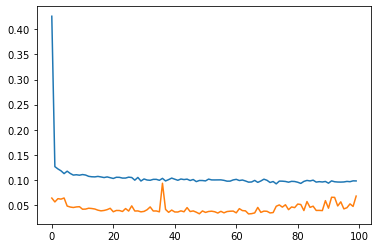

In [75]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])

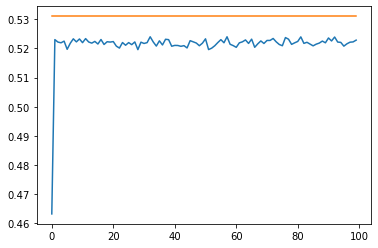

In [76]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])

# Model Performance

In [77]:
# importing performance metrics
from sklearn.metrics import mean_absolute_error,mean_squared_error,r2_score

In [78]:
# mean_absolute_error
## There is no correct value for MSE. Simply put, the lower the value the better and 0 means the model is perfect
print("MAE",mean_absolute_error(y_test,y_pred))

MAE 0.18963715409281054


In [79]:
# There is no correct value for MSE. Simply put, the lower the value the better and 0 means the model is perfect.
print("MSE",mean_squared_error(y_test,y_pred))

MSE 0.06358425662551687


In [80]:
# storing the r2 score  
r2 = r2_score(y_test,y_pred)
print(r2)

0.9701328359811431


In [81]:
# do direct function for RMSE so we use np.sqrt()
# when u have the outlier it is a better metrics 
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred)))

RMSE 0.25215918905627227
